# Imports and Data Reading

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
#import scipy as sp
from tabulate import tabulate
import matplotlib.dates as mdates

In [149]:
df = pd.read_excel("asgsdatatables20162021.xlsx","2",header=None)
df.sort_index(inplace=True)

In [150]:
df = df.iloc[7:20,:7]

df.columns = ["Sector"] + pd.date_range(start='2016', end='2022', freq='Y').tolist()
df = df.set_index("Sector")

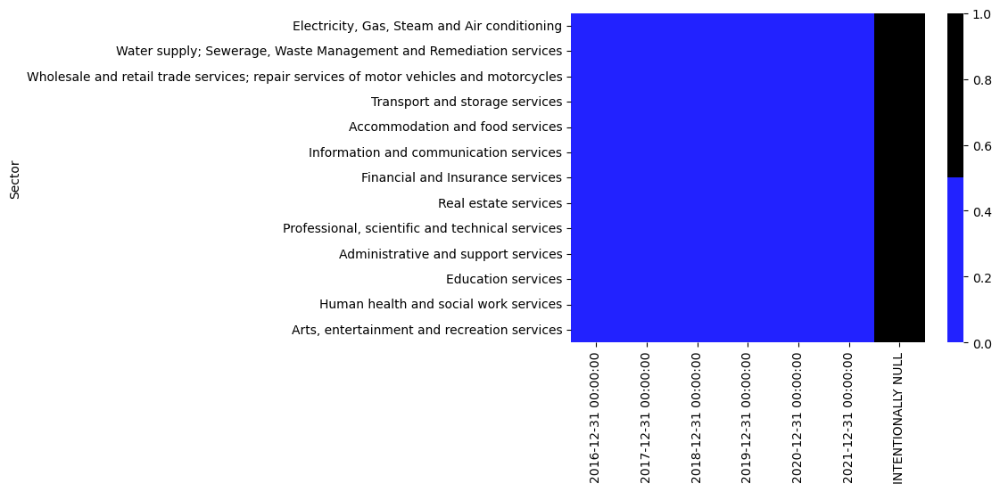

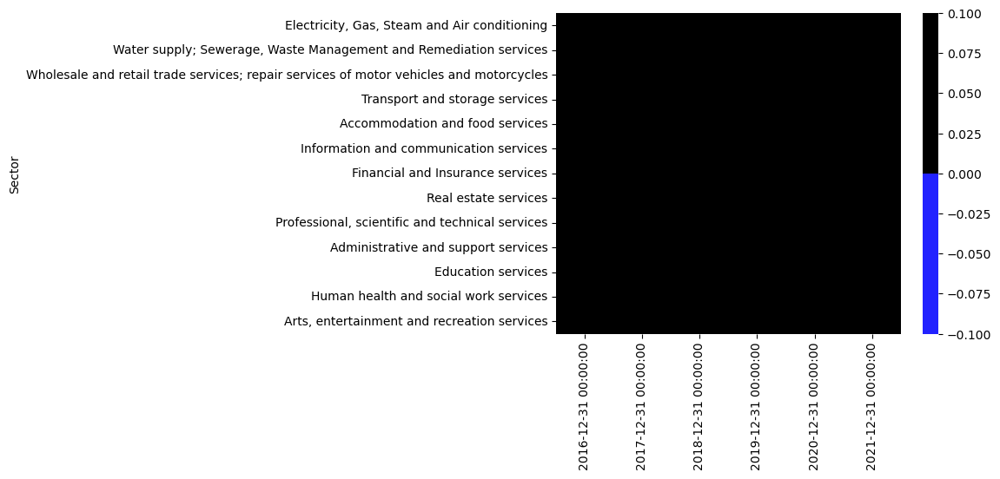

In [151]:
# Finding Null data

df["INTENTIONALLY NULL"] = np.nan # When all values are False (i.e. not null), the entire heatmap will go black for some reason. Adding this column for demonstrative purposes
colours = ['#2222ff', '#000000']
sns.heatmap(df.isnull(), cmap=sns.color_palette(colours))
plt.show()
df = df.drop("INTENTIONALLY NULL",axis=1) # After removing this the heatmap will go black
sns.heatmap(df.isnull(), cmap=sns.color_palette(colours))
plt.show()

# Blue = Data found, Black = Null Data

In [152]:
sf = pd.read_csv("series-150224.csv")
sf.sort_index(inplace=True)

In [153]:
sf = sf.iloc[0:1,2:]

In [154]:
y2016 = np.sum([sf.iloc[:,244:248]])
y2017 = np.sum([sf.iloc[:,248:252]])
y2018 = np.sum([sf.iloc[:,252:256]])
y2019 = np.sum([sf.iloc[:,256:260]])
y2020 = np.sum([sf.iloc[:,260:264]])
y2021 = np.sum([sf.iloc[:,264:268]])

In [155]:
c = 0
for x in df.iloc[:,0]:
    percentage = x / y2016
    df.iloc[c,0] = percentage
    c += 1

c = 0
for x in df.iloc[:,1]:
    percentage = x / y2017
    df.iloc[c,1] = percentage
    c += 1

c = 0
for x in df.iloc[:,2]:
    percentage = x / y2018
    df.iloc[c,2] = percentage
    c += 1

c = 0
for x in df.iloc[:,3]:
    percentage = x / y2019
    df.iloc[c,3] = percentage
    c += 1

c = 0
for x in df.iloc[:,4]:
    percentage = x / y2020
    df.iloc[c,4] = percentage
    c += 1

c = 0
for x in df.iloc[:,5]:
    percentage = x / y2021
    df.iloc[c,5] = percentage
    c += 1

In [138]:
df # MILLIONS

,2016-12-31 00:00:00,2017-12-31 00:00:00,2018-12-31 00:00:00,2019-12-31 00:00:00,2020-12-31 00:00:00,2021-12-31 00:00:00
Sector,,,,,,
"Electricity, Gas, Steam and Air conditioning",0.045321,0.043485,0.05743,0.070297,0.064815,0.068916
"Water supply; Sewerage, Waste Management and Remediation services",0.01413,0.01534,0.015889,0.015453,0.017228,0.01736
Wholesale and retail trade services; repair services of motor vehicles and motorcycles,0.522736,0.578543,0.597971,0.643801,0.570711,0.647407
Transport and storage services,0.069898,0.074446,0.081482,0.084149,0.068449,0.078364
Accommodation and food services,0.043218,0.046916,0.048634,0.047942,0.026369,0.038287
Information and communication services,0.102769,0.105854,0.113712,0.118643,0.125251,0.13413
Financial and Insurance services,0.072362,0.079014,0.100401,0.091912,0.082123,0.082119
Real estate services,0.017718,0.023206,0.017048,0.017418,0.019727,0.021113
"Professional, scientific and technical services",0.11511,0.116166,0.124608,0.132198,0.149448,0.146337


In [156]:
for x in range(1,14):
    sf.loc[x] = 0
sf.iloc[1:,244] = df.iloc[:,0]
sf.iloc[1:,248] = df.iloc[:,1]
sf.iloc[1:,252] = df.iloc[:,2]
sf.iloc[1:,256] = df.iloc[:,3]
sf.iloc[1:,260] = df.iloc[:,4]
sf.iloc[1:,264] = df.iloc[:,5]

In [157]:
for x in range(1,14):
    sf.iloc[x,246] = np.mean([sf.iloc[x,244],sf.iloc[x,248]])
    sf.iloc[x,250] = np.mean([sf.iloc[x,248],sf.iloc[x,252]])
    sf.iloc[x,254] = np.mean([sf.iloc[x,252],sf.iloc[x,256]])
    sf.iloc[x,258] = np.mean([sf.iloc[x,256],sf.iloc[x,260]])
    sf.iloc[x,262] = np.mean([sf.iloc[x,260],sf.iloc[x,264]])

for x in range(1,14):
    sf.iloc[x,245] = np.mean([sf.iloc[x,244],sf.iloc[x,246]])
    sf.iloc[x,247] = np.mean([sf.iloc[x,246],sf.iloc[x,248]])

    sf.iloc[x,249] = np.mean([sf.iloc[x,248],sf.iloc[x,250]])
    sf.iloc[x,251] = np.mean([sf.iloc[x,250],sf.iloc[x,252]])

    sf.iloc[x,253] = np.mean([sf.iloc[x,252],sf.iloc[x,254]])
    sf.iloc[x,255] = np.mean([sf.iloc[x,254],sf.iloc[x,256]])

    sf.iloc[x,257] = np.mean([sf.iloc[x,256],sf.iloc[x,258]])
    sf.iloc[x,259] = np.mean([sf.iloc[x,258],sf.iloc[x,260]])
    
    sf.iloc[x,261] = np.mean([sf.iloc[x,260],sf.iloc[x,262]])
    sf.iloc[x,263] = np.mean([sf.iloc[x,262],sf.iloc[x,264]])

In [158]:
for x in range(1,14):
    sf.iloc[x,:] = sf.iloc[x,264]
    sf.iloc[x,:244] = sf.iloc[x,244]

In [159]:
for x in range(1,14):
    for y in range(0,276):
        sf.iloc[x,y] = sf.iloc[x,y] * sf.iloc[0,y]

In [160]:
sf = sf.iloc[1:,:]

In [162]:
sf.reset_index(inplace=True)

In [168]:
sf = sf.iloc[:,1:]

In [169]:
sf

,1955 Q1.1,1955 Q2,1955 Q3,1955 Q4,1956 Q1,1956 Q2,1956 Q3,1956 Q4,1957 Q1,1957 Q2,...,2021 Q3,2021 Q4,2022 Q1,2022 Q2,2022 Q3,2022 Q4,2023 Q1,2023 Q2,2023 Q3,2023 Q4
0,8390.360675,8391.601170,8559.688184,8513.031804,8606.344563,8597.385435,8586.565566,8637.219094,8799.586050,8796.760479,...,38314.466553,38896.878753,39102.869767,39136.845535,39106.246669,39146.838408,39236.567515,39238.497173,39189.635471,39054.559395
1,2113.478460,2113.790933,2156.130982,2144.378537,2167.883427,2165.626680,2162.901224,2175.660525,2216.559728,2215.847985,...,9651.170304,9797.876230,9849.764056,9858.322336,9850.614676,9860.839477,9883.441668,9883.927737,9871.619785,9837.594981
2,78819.912862,78831.566196,80410.592927,79972.298094,80848.887760,80764.724794,80663.081826,81138.926290,82664.218205,82637.674500,...,359930.047353,365401.287577,367336.388398,367655.560263,367368.111362,367749.434340,368592.358819,368610.486228,368151.474357,366882.555786
3,9540.527536,9541.938080,9733.066787,9680.014661,9786.118912,9775.931650,9763.628572,9821.225784,10005.850316,10002.637410,...,43566.687694,44228.938084,44463.166745,44501.799977,44467.006559,44513.162692,44615.192039,44617.386218,44561.826459,44408.233894
4,4661.311486,4662.000650,4755.382324,4729.462114,4781.302535,4776.325242,4770.314203,4798.455052,4888.658916,4887.089155,...,21285.814752,21609.377085,21723.816537,21742.691964,21725.692594,21748.243560,21798.093064,21799.165096,21772.019706,21696.977442
5,16329.919046,16332.333385,16659.476334,16568.670357,16750.282310,16732.845417,16711.787014,16810.372528,17126.382690,17120.883362,...,74570.350590,75703.882799,76104.797220,76170.923285,76111.369587,76190.372128,76365.009323,76368.764962,76273.666827,76010.772125
6,9997.707534,9999.185671,10199.473224,10143.878852,10255.067596,10244.392162,10231.499524,10291.856781,10485.328480,10481.961613,...,45654.393865,46348.379149,46593.831996,46634.316524,46597.855814,46646.223738,46753.142309,46755.441633,46697.219462,46536.266775
7,2570.490625,2570.870666,2622.366198,2608.072440,2636.659956,2633.915217,2630.600416,2646.118750,2695.861873,2694.996224,...,11738.110062,11916.539233,11979.647125,11990.056021,11980.681680,11993.117461,12020.607081,12021.198256,12006.228870,11964.846646
8,17816.089709,17818.723775,18175.639697,18076.569554,18274.709840,18255.686032,18232.711124,18340.268813,18685.038765,18679.038948,...,81356.928469,82593.622384,83031.023652,83103.167789,83038.194164,83124.386652,83314.917415,83319.014851,83215.261924,82928.441421
9,9808.782319,9810.232524,10006.735272,9952.191459,10061.279086,10050.805384,10038.156376,10097.373071,10287.188764,10283.885520,...,44791.669472,45472.540618,45713.355179,45753.074676,45717.302958,45764.756882,45869.655028,45871.910902,45814.788947,45656.877759


In [170]:
sf.to_csv("Simulated Data.csv")

# Regression with LSTM

In [171]:
df = pd.read_csv("Simulated Data.csv",index_col=0)

In [172]:
from sklearn.preprocessing import MinMaxScaler
from tensorflow import keras
from tensorflow.keras.layers import Bidirectional, Dropout, Activation, Dense, LSTM, Input
from tensorflow.compat.v1.keras.layers import CuDNNLSTM
from tensorflow.keras.models import Sequential
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from math import *

import keras_tuner as kt

In [180]:
scaler = MinMaxScaler(feature_range=(-1,1))
scaler.fit(df.values.reshape(-1,1))

MinMaxScaler(feature_range=(-1, 1))

In [181]:
shapedItems = {}
for i in df.index:
    shapedItems[i] = scaler.transform(df.iloc[i,:].values.reshape(-1,1))

In [185]:
seq_len = 30

def split_into_sequences(data, seq_len):
    n_seq = len(data) - seq_len + 1
    return np.array([data[i:(i+seq_len)] for i in range(n_seq)])

for i in shapedItems:
    shapedItems[i] = split_into_sequences(shapedItems[i],seq_len)

In [191]:
def get_train_test_sets(data, train_frac):
    n_train = int(data.shape[0] * train_frac)
    x_train = data[:n_train, :-1, :]
    y_train = data[:n_train, -1, :]
    x_test = data[n_train:, :-1, :]
    y_test = data[n_train:, -1, :]
    return x_train, y_train, x_test, y_test

splitData = {}
for i in shapedItems:
    x_train, y_train, x_test, y_test = get_train_test_sets(shapedItems[i], train_frac=0.8)
    splitData[i] = {}
    splitData[i]["x_train"] = x_train
    splitData[i]["y_train"] = y_train
    splitData[i]["x_test"] = x_test
    splitData[i]["y_test"] = y_test

In [192]:
print(scaler.inverse_transform(splitData[0]["y_train"]))
print(scaler.inverse_transform(splitData[0]["y_test"]))

[[10234.08018462]
 [10296.65624393]
 [10259.57923962]
 [10306.44236774]
 [10752.81366306]
 [10800.29703847]
 [11045.43254834]
 [11118.48389511]
 [11326.19781886]
 [11367.89221961]
 [11538.66697179]
 [11507.31002577]
 [11514.13274589]
 [11607.16983848]
 [11681.46167982]
 [11698.48402194]
 [11767.12472136]
 [11805.58005296]
 [11758.64800848]
 [11915.77732041]
 [12082.0035925 ]
 [12130.72746247]
 [12196.68042366]
 [12644.49896264]
 [12592.1914417 ]
 [12837.53370067]
 [12887.22239975]
 [12861.17201382]
 [12957.44817556]
 [13027.26045318]
 [13089.90542886]
 [13007.82603829]
 [13318.63884389]
 [13445.51387164]
 [13567.70258657]
 [13503.61036723]
 [13745.78247342]
 [13982.02777223]
 [14037.36761322]
 [14065.69223919]
 [14436.7379477 ]
 [14475.1932793 ]
 [14701.10112338]
 [15422.10413275]
 [15451.94491874]
 [15307.84079978]
 [15248.84839144]
 [14825.42624562]
 [15038.58456219]
 [15128.31366927]
 [14906.67863981]
 [14912.81219629]
 [14671.05358829]
 [14623.50129652]
 [14788.41815768]
 [15036.17

In [344]:
# fraction of the input to drop; helps prevent overfitting
window_size = seq_len - 1
dropout = 0.2

def model_builder(hp):
    lmodel = keras.Sequential()
    

    lmodel.add(
        Input(shape=(window_size, x_train.shape[-1]))
    )

    lmodel.add(
        Bidirectional(LSTM(units=(window_size), return_sequences=True))
    )


    lmodel.add(Dropout(rate=dropout))
    lmodel.add(
        Bidirectional(LSTM(units=(window_size*2), return_sequences=True))
    )

    lmodel.add(Dropout(rate=dropout))
    lmodel.add(
        Bidirectional(LSTM(units=(window_size*2), return_sequences=True))
    )
    
    lmodel.add(Dropout(rate=dropout))
    lmodel.add(
        Bidirectional(LSTM(units=(window_size), return_sequences=False))
    )
    
    hp_units2 = hp.Int('units2', min_value=32, max_value=256, step=32)

    lmodel.add(Dense(units=hp_units2))
    lmodel.add(Dense(units=(hp_units2/4)))
    lmodel.add(Dense(1))

    lmodel.add(Activation('linear'))

    hp_learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4, 1e-5])
    hp_epsilon = hp.Choice('epsilon', values=[1e-4, 1e-5,1e-6,1e-7])

    lmodel.compile(
        loss='mean_squared_error',
        optimizer=keras.optimizers.Adam(learning_rate=hp_learning_rate,epsilon=hp_epsilon),
    )

    return lmodel

# The lengthy bit
Some exceptions have been added to save you time

In [ ]:
raise("The one below this can take a very long time: If theres a folder called 'untitled_project' you can run it to load that project, you can also delete it and rurun it afterwards (1h estimate).")
"RUN THE MODEL LOADER BEFORE IF THE .KERAS FILE IS IN fullData"
"Check for the all commentated code block"

In [346]:
tuner = kt.Hyperband(model_builder,
                     objective='val_loss',
                     max_epochs=50,
                     factor=3,
                     directory='turnoverLstm'
                     )
stop_early = keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
tuner.search(splitData[0]["x_train"], 
             splitData[0]["y_train"], 
             epochs=100,
             validation_split=0.2, 
             callbacks=[stop_early]
             )

best_hps=tuner.get_best_hyperparameters(num_trials=1)[0]


Trial 90 Complete [00h 00m 56s]
val_loss: 5.5009837524266914e-05

Best val_loss So Far: 1.9373635950614698e-05
Total elapsed time: 00h 47m 04s


In [361]:
lmodel = tuner.hypermodel.build(best_hps)
lmodel.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_12 (Bidirect  (None, 29, 58)            7192      
 ional)                                                          
                                                                 
 dropout_9 (Dropout)         (None, 29, 58)            0         
                                                                 
 bidirectional_13 (Bidirect  (None, 29, 116)           54288     
 ional)                                                          
                                                                 
 dropout_10 (Dropout)        (None, 29, 116)           0         
                                                                 
 bidirectional_14 (Bidirect  (None, 29, 116)           81200     
 ional)                                                          
                                                      

In [362]:
stop_early = keras.callbacks.EarlyStopping(monitor='val_loss', patience=20) # Exit early if loss rises too much

ltsmhistory = lmodel.fit(
    splitData[0]["x_train"],
    splitData[0]["y_train"],
    epochs=100,
    batch_size=8,
    shuffle=False,
    validation_split=0.2,
    callbacks=[stop_early]
)

Epoch 1/100
20/20 [==============================] - 12s 197ms/step - loss: 0.0738 - val_loss: 0.0119
Epoch 2/100
20/20 [==============================] - 2s 77ms/step - loss: 0.0032 - val_loss: 1.4500e-04
Epoch 3/100
20/20 [==============================] - 2s 75ms/step - loss: 0.0018 - val_loss: 2.1786e-05
Epoch 4/100
20/20 [==============================] - 2s 76ms/step - loss: 0.0017 - val_loss: 0.0017
Epoch 5/100
20/20 [==============================] - 2s 81ms/step - loss: 6.5517e-04 - val_loss: 5.4455e-04
Epoch 6/100
20/20 [==============================] - 2s 78ms/step - loss: 9.6335e-04 - val_loss: 3.7254e-04
Epoch 7/100
20/20 [==============================] - 2s 78ms/step - loss: 0.0011 - val_loss: 1.7667e-04
Epoch 8/100
20/20 [==============================] - 2s 78ms/step - loss: 0.0011 - val_loss: 4.7202e-04
Epoch 9/100
20/20 [==============================] - 2s 75ms/step - loss: 9.2709e-04 - val_loss: 5.2987e-05
Epoch 10/100
20/20 [==============================] - 2s 7

In [202]:
# MODEL LOADER - GET BEST MODEL HERE
#lmodel = keras.models.load_model('savedModels/zTurnoverLstm/A/Trial0/model.keras')
#lmodel.summary()

In [363]:
y_pred = lmodel.predict(splitData[0]["x_test"])
old_pred = lmodel.predict(splitData[0]["x_train"])

y_test_orig = scaler.inverse_transform(splitData[0]["y_test"].reshape(-1,1))
y_pred_orig = scaler.inverse_transform(y_pred.reshape(-1,1))
old_pred_orig = scaler.inverse_transform(old_pred.reshape(-1,1))

7/7 [==============================] - 0s 43ms/step


R²= -5.159
MAPE=14.535%
MAE=5361.550


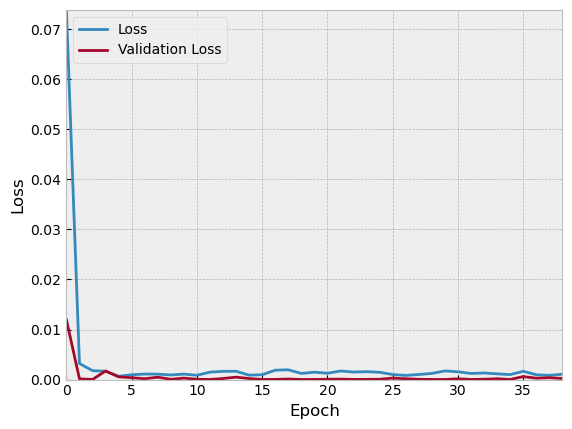

In [364]:
plt.style.use('bmh')

plt.plot(ltsmhistory.history['loss'], label='Loss')
plt.plot(ltsmhistory.history['val_loss'], label = 'Validation Loss') # Theres a lot of data so these start pretty low
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.ylim([0, max(ltsmhistory.history['loss'])])
plt.xlim([0, len(ltsmhistory.history['loss'])-1])
plt.legend(loc='upper left')


# make a prediction
mse = mean_squared_error(y_test_orig,y_pred_orig)
mae = mean_absolute_error(y_test_orig,y_pred_orig)
mape = mean_absolute_percentage_error(y_test_orig,y_pred_orig)*100
r2 = r2_score(y_test_orig,y_pred_orig)

#fig,ax = plt.subplots()
#ax.scatter(y_pred_orig,y_test_orig)

#ax.plot(y_test_orig,y_test_orig,color="black",linestyle=":")
#ax.plot((r2 * y_test_orig),y_test_orig,color="red",linestyle=":")


#ax.set_ylim([min(y_test_orig),max(y_test_orig)])
#ax.set_xlim([min(y_test_orig),max(y_pred_orig)])

#ax.annotate("R²= {:.3f}\nMAPE={:.3f}%\nMAE={:.3f}".format(r2,mape,mae),(min(y_test_orig),0.99*max(y_test_orig)))
#ax.set_title("Real against estimated Start Up Delay values")
#ax.set_ylabel("Real Value")
#ax.set_xlabel("Estimated Value")
#plt.show()

print("R²= {:.3f}\nMAPE={:.3f}%\nMAE={:.3f}".format(r2,mape,mae))


In [241]:
df.columns = pd.date_range(start='1955', end='2024', freq='Q').tolist()

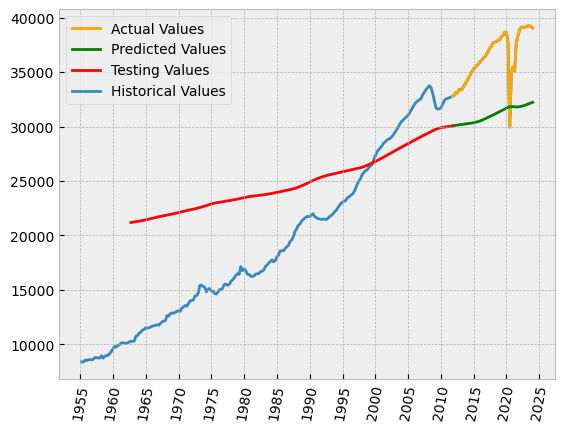

In [365]:
fig,ax = plt.subplots()

historical = df.iloc[0,:]

ax.plot(historical.tail(50).index, y_test_orig, color='orange', label='Actual Values',zorder=0)
ax.plot(historical.tail(50).index, y_pred_orig, color='green', label='Predicted Values',zorder=1)
ax.plot(historical.iloc[30:227].index, old_pred_orig, color='red', label='Testing Values',zorder=1)

ax.xaxis.set_major_locator(mdates.YearLocator(5))
ax.tick_params(axis='x', rotation=80)

ax.plot(historical.index,historical.values,zorder=-1,label="Historical Values")
ax.legend()
plt.show()

In [ ]:
raise("DO NOT RUN THE COMMAND BELOW WITHOUT CREATING A BACK UP")

In [366]:
lmodel.save('savedModels/zTurnoverLstm/A/Trial0/model.keras')

Epoch 1/100
20/20 [==============================] - 13s 194ms/step - loss: 0.1125 - val_loss: 0.0054
Epoch 2/100
20/20 [==============================] - 1s 71ms/step - loss: 0.0042 - val_loss: 0.0012
Epoch 3/100
20/20 [==============================] - 2s 81ms/step - loss: 8.7884e-04 - val_loss: 2.9795e-05
Epoch 4/100
20/20 [==============================] - 1s 75ms/step - loss: 0.0016 - val_loss: 2.3880e-04
Epoch 5/100
20/20 [==============================] - 1s 74ms/step - loss: 0.0012 - val_loss: 3.6749e-04
Epoch 6/100
20/20 [==============================] - 2s 78ms/step - loss: 0.0013 - val_loss: 5.6163e-04
Epoch 7/100
20/20 [==============================] - 1s 73ms/step - loss: 0.0010 - val_loss: 9.5492e-04
Epoch 8/100
20/20 [==============================] - 2s 76ms/step - loss: 8.1612e-04 - val_loss: 7.3262e-04
Epoch 9/100
20/20 [==============================] - 1s 71ms/step - loss: 8.3677e-04 - val_loss: 8.0922e-04
Epoch 10/100
20/20 [==============================] - 2s 7

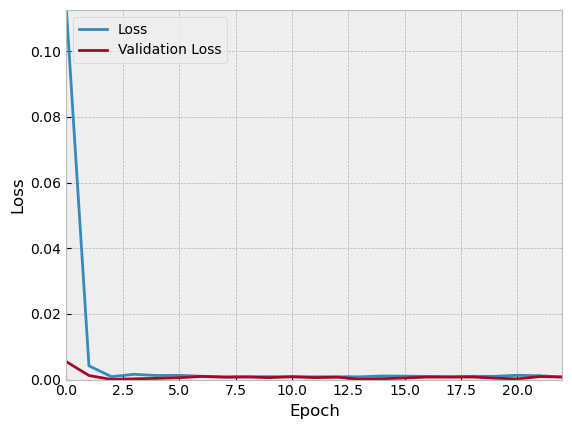

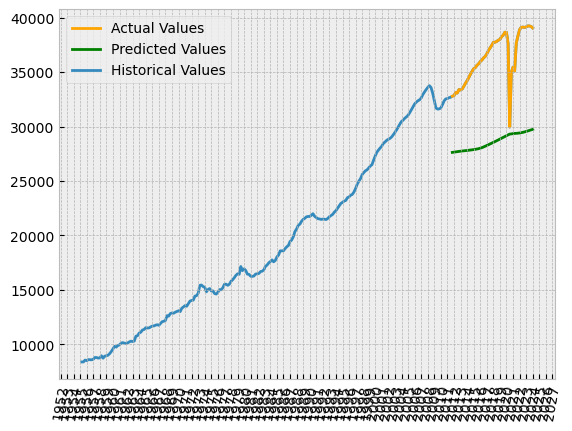

Epoch 1/100
20/20 [==============================] - 12s 188ms/step - loss: 0.1304 - val_loss: 0.0019
Epoch 2/100
20/20 [==============================] - 1s 67ms/step - loss: 0.0049 - val_loss: 3.8116e-04
Epoch 3/100
20/20 [==============================] - 1s 66ms/step - loss: 0.0013 - val_loss: 3.8883e-05
Epoch 4/100
20/20 [==============================] - 1s 67ms/step - loss: 0.0020 - val_loss: 5.9158e-05
Epoch 5/100
20/20 [==============================] - 1s 69ms/step - loss: 0.0018 - val_loss: 1.1350e-04
Epoch 6/100
20/20 [==============================] - 1s 69ms/step - loss: 0.0014 - val_loss: 3.3186e-04
Epoch 7/100
20/20 [==============================] - 1s 73ms/step - loss: 0.0013 - val_loss: 6.5817e-04
Epoch 8/100
20/20 [==============================] - 1s 73ms/step - loss: 0.0011 - val_loss: 6.7801e-04
Epoch 9/100
20/20 [==============================] - 1s 73ms/step - loss: 9.9059e-04 - val_loss: 5.3959e-04
Epoch 10/100
20/20 [==============================] - 1s 72ms/

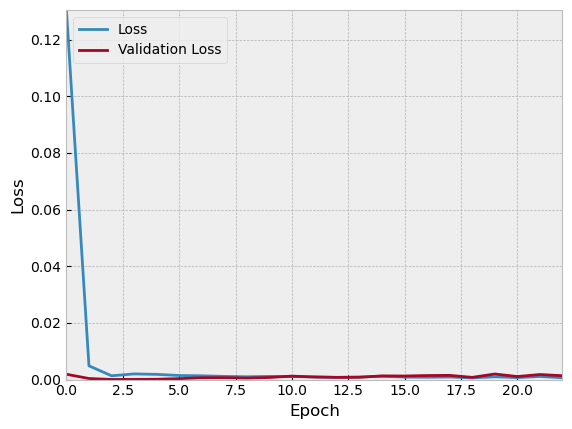

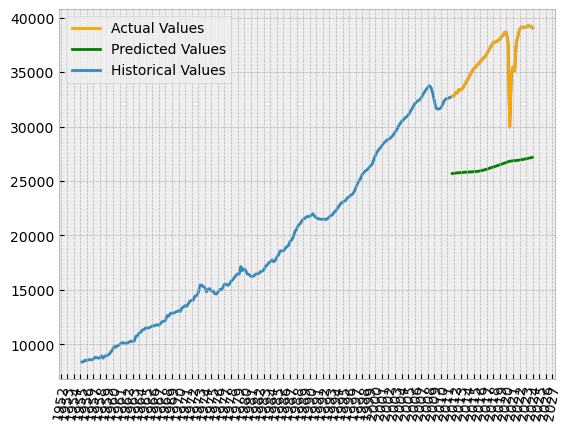

Epoch 1/100
20/20 [==============================] - 13s 194ms/step - loss: 0.0866 - val_loss: 0.0138
Epoch 2/100
20/20 [==============================] - 1s 68ms/step - loss: 0.0036 - val_loss: 0.0021
Epoch 3/100
20/20 [==============================] - 1s 67ms/step - loss: 8.7991e-04 - val_loss: 1.9697e-04
Epoch 4/100
20/20 [==============================] - 1s 65ms/step - loss: 0.0016 - val_loss: 3.8305e-05
Epoch 5/100
20/20 [==============================] - 1s 67ms/step - loss: 0.0018 - val_loss: 8.8565e-04
Epoch 6/100
20/20 [==============================] - 1s 67ms/step - loss: 0.0011 - val_loss: 9.1364e-04
Epoch 7/100
20/20 [==============================] - 1s 66ms/step - loss: 0.0011 - val_loss: 0.0013
Epoch 8/100
20/20 [==============================] - 1s 68ms/step - loss: 9.9986e-04 - val_loss: 0.0012
Epoch 9/100
20/20 [==============================] - 1s 67ms/step - loss: 9.6475e-04 - val_loss: 0.0010
Epoch 10/100
20/20 [==============================] - 1s 67ms/step - l

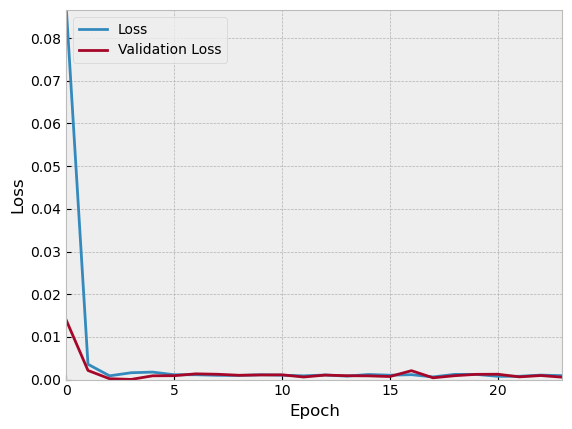

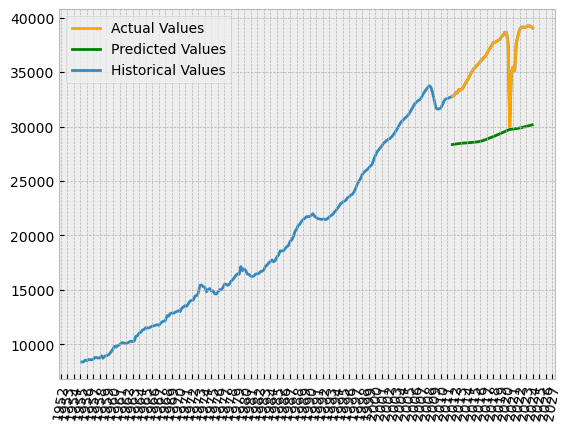

Epoch 1/100
20/20 [==============================] - 12s 185ms/step - loss: 0.1011 - val_loss: 0.0255
Epoch 2/100
20/20 [==============================] - 1s 64ms/step - loss: 0.0040 - val_loss: 0.0019
Epoch 3/100
20/20 [==============================] - 1s 65ms/step - loss: 7.9689e-04 - val_loss: 4.6711e-04
Epoch 4/100
20/20 [==============================] - 1s 65ms/step - loss: 9.5217e-04 - val_loss: 1.1798e-04
Epoch 5/100
20/20 [==============================] - 1s 67ms/step - loss: 0.0012 - val_loss: 3.2272e-04
Epoch 6/100
20/20 [==============================] - 1s 63ms/step - loss: 0.0010 - val_loss: 8.9635e-04
Epoch 7/100
20/20 [==============================] - 1s 63ms/step - loss: 7.9034e-04 - val_loss: 8.6295e-05
Epoch 8/100
20/20 [==============================] - 1s 64ms/step - loss: 0.0012 - val_loss: 4.9548e-04
Epoch 9/100
20/20 [==============================] - 1s 64ms/step - loss: 0.0010 - val_loss: 8.9142e-04
Epoch 10/100
20/20 [==============================] - 1s 6

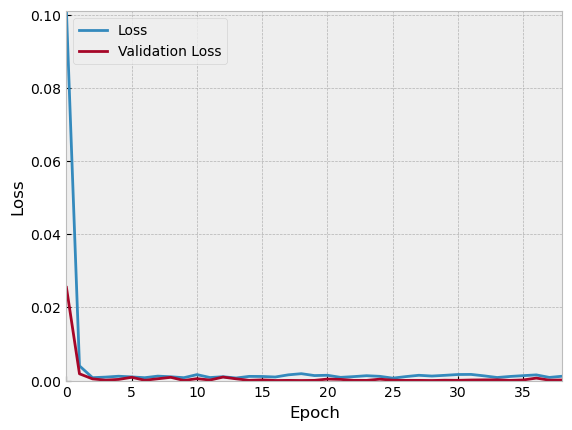

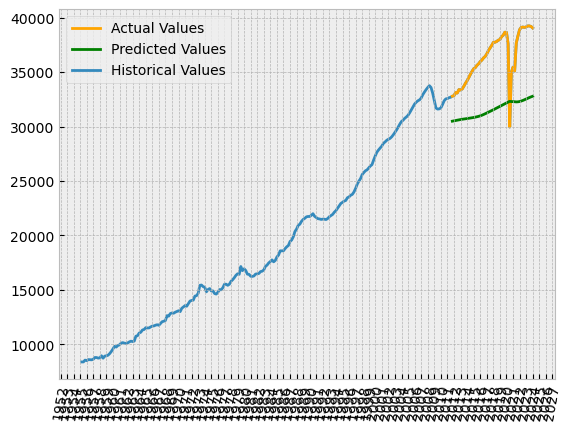

Epoch 1/100
20/20 [==============================] - 12s 182ms/step - loss: 0.0927 - val_loss: 0.0187
Epoch 2/100
20/20 [==============================] - 1s 63ms/step - loss: 0.0041 - val_loss: 0.0024
Epoch 3/100
20/20 [==============================] - 1s 63ms/step - loss: 6.7322e-04 - val_loss: 1.9104e-05
Epoch 4/100
20/20 [==============================] - 1s 64ms/step - loss: 0.0019 - val_loss: 2.5040e-04
Epoch 5/100
20/20 [==============================] - 1s 66ms/step - loss: 0.0010 - val_loss: 3.8702e-04
Epoch 6/100
20/20 [==============================] - 1s 65ms/step - loss: 8.8981e-04 - val_loss: 3.3457e-04
Epoch 7/100
20/20 [==============================] - 1s 67ms/step - loss: 0.0010 - val_loss: 2.8196e-04
Epoch 8/100
20/20 [==============================] - 1s 65ms/step - loss: 0.0010 - val_loss: 5.6336e-04
Epoch 9/100
20/20 [==============================] - 1s 65ms/step - loss: 8.1657e-04 - val_loss: 5.1434e-04
Epoch 10/100
20/20 [==============================] - 1s 6

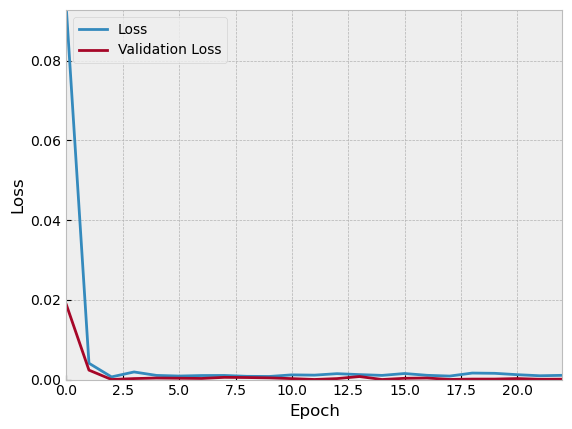

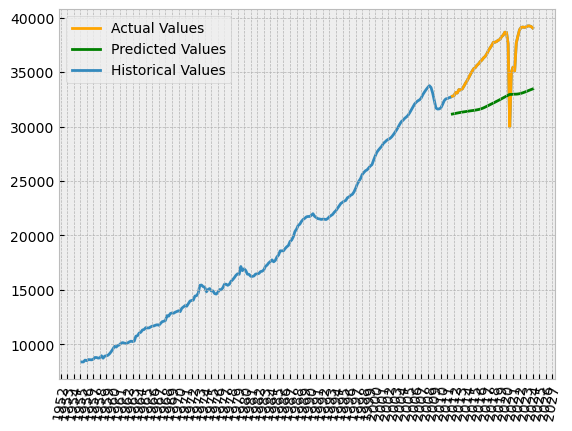

Epoch 1/100
20/20 [==============================] - 13s 193ms/step - loss: 0.1270 - val_loss: 0.0252
Epoch 2/100
20/20 [==============================] - 1s 63ms/step - loss: 0.0052 - val_loss: 0.0039
Epoch 3/100
20/20 [==============================] - 1s 66ms/step - loss: 0.0012 - val_loss: 2.4220e-05
Epoch 4/100
20/20 [==============================] - 1s 63ms/step - loss: 0.0018 - val_loss: 3.4920e-05
Epoch 5/100
20/20 [==============================] - 1s 62ms/step - loss: 0.0015 - val_loss: 3.9474e-04
Epoch 6/100
20/20 [==============================] - 1s 61ms/step - loss: 0.0011 - val_loss: 8.0627e-04
Epoch 7/100
20/20 [==============================] - 1s 61ms/step - loss: 0.0012 - val_loss: 2.6670e-04
Epoch 8/100
20/20 [==============================] - 1s 62ms/step - loss: 0.0011 - val_loss: 9.0663e-05
Epoch 9/100
20/20 [==============================] - 1s 61ms/step - loss: 0.0014 - val_loss: 2.4429e-04
Epoch 10/100
20/20 [==============================] - 1s 61ms/step - l

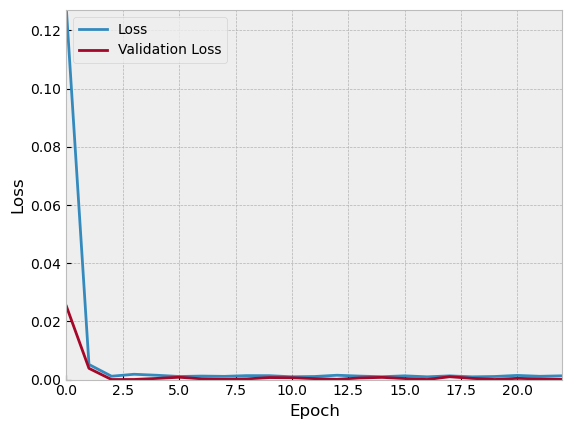

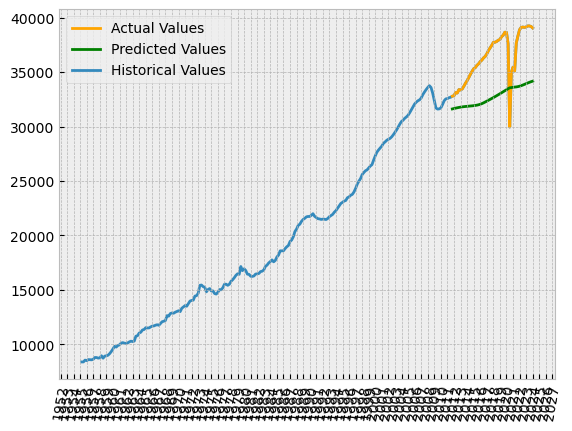

Epoch 1/100
20/20 [==============================] - 12s 189ms/step - loss: 0.1497 - val_loss: 0.0036
Epoch 2/100
20/20 [==============================] - 1s 66ms/step - loss: 0.0031 - val_loss: 4.3317e-04
Epoch 3/100
20/20 [==============================] - 1s 62ms/step - loss: 0.0014 - val_loss: 9.7604e-05
Epoch 4/100
20/20 [==============================] - 1s 61ms/step - loss: 0.0014 - val_loss: 8.3904e-05
Epoch 5/100
20/20 [==============================] - 1s 62ms/step - loss: 0.0017 - val_loss: 1.5889e-04
Epoch 6/100
20/20 [==============================] - 1s 63ms/step - loss: 0.0012 - val_loss: 4.5996e-04
Epoch 7/100
20/20 [==============================] - 1s 64ms/step - loss: 9.4573e-04 - val_loss: 1.5954e-04
Epoch 8/100
20/20 [==============================] - 1s 67ms/step - loss: 0.0014 - val_loss: 4.5846e-04
Epoch 9/100
20/20 [==============================] - 1s 64ms/step - loss: 0.0012 - val_loss: 8.4959e-04
Epoch 10/100
20/20 [==============================] - 1s 64ms/

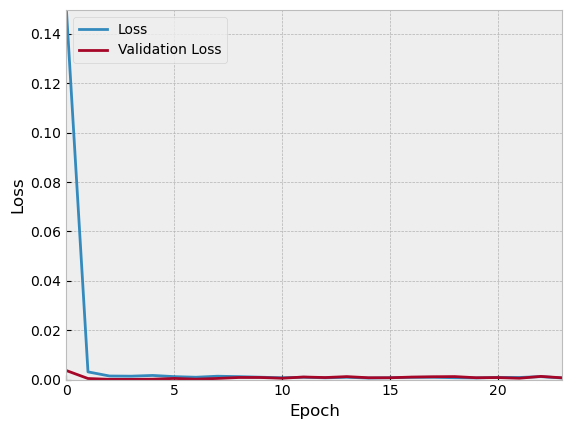

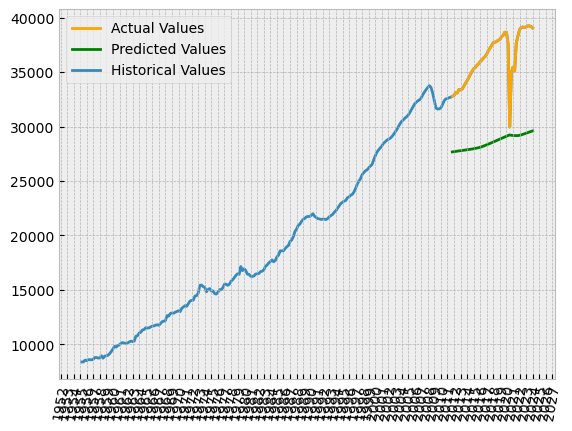

Epoch 1/100
20/20 [==============================] - 12s 181ms/step - loss: 0.0842 - val_loss: 0.0132
Epoch 2/100
20/20 [==============================] - 1s 59ms/step - loss: 0.0033 - val_loss: 2.7500e-04
Epoch 3/100
20/20 [==============================] - 1s 61ms/step - loss: 0.0023 - val_loss: 2.5164e-05
Epoch 4/100
20/20 [==============================] - 1s 63ms/step - loss: 0.0014 - val_loss: 8.5923e-04
Epoch 5/100
20/20 [==============================] - 1s 64ms/step - loss: 8.0735e-04 - val_loss: 7.4727e-04
Epoch 6/100
20/20 [==============================] - 1s 64ms/step - loss: 8.1880e-04 - val_loss: 9.0197e-05
Epoch 7/100
20/20 [==============================] - 1s 67ms/step - loss: 0.0013 - val_loss: 3.3268e-04
Epoch 8/100
20/20 [==============================] - 1s 65ms/step - loss: 0.0013 - val_loss: 0.0014
Epoch 9/100
20/20 [==============================] - 1s 63ms/step - loss: 7.3682e-04 - val_loss: 3.5063e-05
Epoch 10/100
20/20 [==============================] - 1s 6

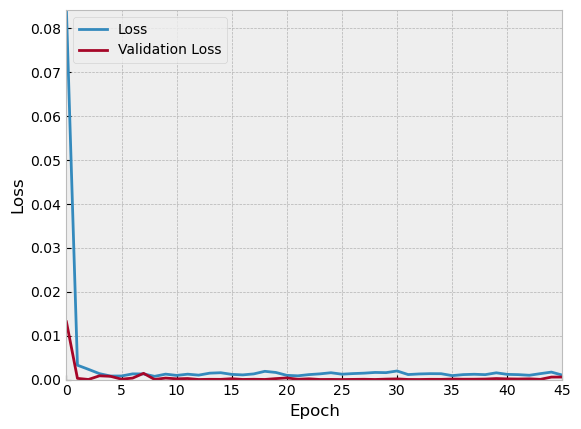

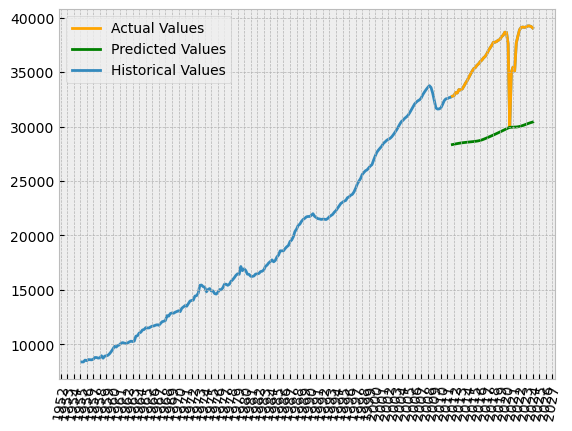

Epoch 1/100
20/20 [==============================] - 12s 179ms/step - loss: 0.1055 - val_loss: 0.0278
Epoch 2/100
20/20 [==============================] - 1s 60ms/step - loss: 0.0039 - val_loss: 0.0019
Epoch 3/100
20/20 [==============================] - 1s 59ms/step - loss: 9.4598e-04 - val_loss: 3.1356e-05
Epoch 4/100
20/20 [==============================] - 1s 59ms/step - loss: 0.0012 - val_loss: 3.6631e-05
Epoch 5/100
20/20 [==============================] - 1s 61ms/step - loss: 0.0015 - val_loss: 6.9030e-04
Epoch 6/100
20/20 [==============================] - 1s 62ms/step - loss: 8.2195e-04 - val_loss: 7.7197e-04
Epoch 7/100
20/20 [==============================] - 1s 64ms/step - loss: 9.5826e-04 - val_loss: 5.2065e-04
Epoch 8/100
20/20 [==============================] - 1s 63ms/step - loss: 8.6552e-04 - val_loss: 5.3313e-05
Epoch 9/100
20/20 [==============================] - 1s 61ms/step - loss: 0.0013 - val_loss: 2.3450e-04
Epoch 10/100
20/20 [==============================] - 

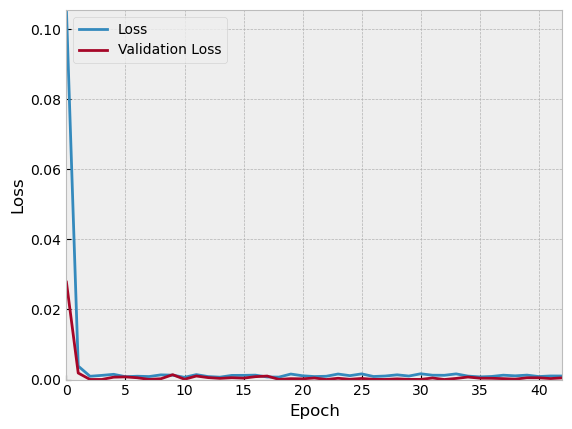

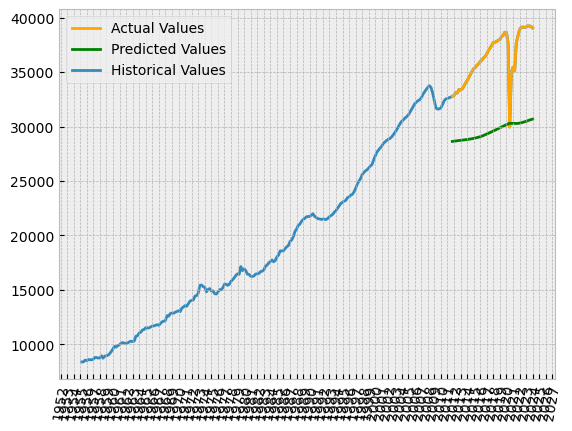

In [368]:
for iteration in range(1,10):
    lmodel = tuner.hypermodel.build(best_hps)
    #lmodel.summary()

    stop_early = keras.callbacks.EarlyStopping(monitor='val_loss', patience=20) # Exit early if loss rises too much

    ltsmhistory = lmodel.fit(
        splitData[0]["x_train"],
        splitData[0]["y_train"],
        epochs=100,
        batch_size=8,
        shuffle=False,
        validation_split=0.2,
        callbacks=[stop_early]
    )

    y_pred = lmodel.predict(splitData[0]["x_test"])
    old_pred = lmodel.predict(splitData[0]["x_train"])

    y_test_orig = scaler.inverse_transform(splitData[0]["y_test"].reshape(-1,1))
    y_pred_orig = scaler.inverse_transform(y_pred.reshape(-1,1))
    old_pred_orig = scaler.inverse_transform(old_pred.reshape(-1,1))

    plt.style.use('bmh')

    plt.plot(ltsmhistory.history['loss'], label='Loss')
    plt.plot(ltsmhistory.history['val_loss'], label = 'Validation Loss') # Theres a lot of data so these start pretty low
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.ylim([0, max(ltsmhistory.history['loss'])])
    plt.xlim([0, len(ltsmhistory.history['loss'])-1])
    plt.legend(loc='upper left')


    # make a prediction
    mse = mean_squared_error(y_test_orig,y_pred_orig)
    mae = mean_absolute_error(y_test_orig,y_pred_orig)
    mape = mean_absolute_percentage_error(y_test_orig,y_pred_orig)*100
    r2 = r2_score(y_test_orig,y_pred_orig)
    print("R²= {:.3f}\nMAPE={:.3f}%\nMAE={:.3f}".format(r2,mape,mae))

    fig,ax = plt.subplots()

    historical = df.iloc[0,:]

    ax.plot(historical.tail(50).index, y_test_orig, color='orange', label='Actual Values',zorder=0)
    ax.plot(historical.tail(50).index, y_pred_orig, color='green', label='Predicted Values',zorder=1)
    #ax.plot(historical.iloc[-20:-4].index, old_pred_orig, color='red', label='Testing Values',zorder=1)

    ax.xaxis.set_major_locator(mdates.YearLocator())
    ax.tick_params(axis='x', rotation=80)

    ax.plot(historical.index,historical.values,zorder=-1,label="Historical Values")
    ax.legend()
    plt.show()

    lmodel.save(f'savedModels/zTurnoverLstm/A/Trial{iteration}/model.keras')

Epoch 1/100
20/20 [==============================] - 12s 177ms/step - loss: 0.1492 - val_loss: 0.0108
Epoch 2/100
20/20 [==============================] - 1s 57ms/step - loss: 0.0066 - val_loss: 0.0034
Epoch 3/100
20/20 [==============================] - 1s 57ms/step - loss: 6.9498e-04 - val_loss: 5.2532e-05
Epoch 4/100
20/20 [==============================] - 1s 59ms/step - loss: 5.3681e-04 - val_loss: 1.5254e-05
Epoch 5/100
20/20 [==============================] - 1s 61ms/step - loss: 5.9722e-04 - val_loss: 2.9763e-04
Epoch 6/100
20/20 [==============================] - 1s 61ms/step - loss: 5.0893e-04 - val_loss: 6.8444e-06
Epoch 7/100
20/20 [==============================] - 1s 59ms/step - loss: 5.8265e-04 - val_loss: 3.6654e-05
Epoch 8/100
20/20 [==============================] - 1s 60ms/step - loss: 5.1127e-04 - val_loss: 4.7611e-04
Epoch 9/100
20/20 [==============================] - 1s 65ms/step - loss: 4.4048e-04 - val_loss: 1.3361e-04
Epoch 10/100
20/20 [======================

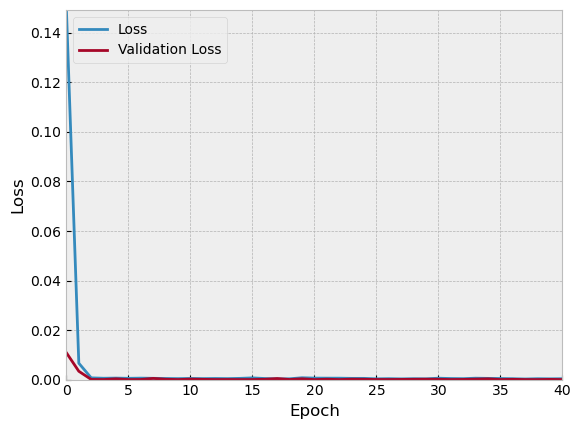

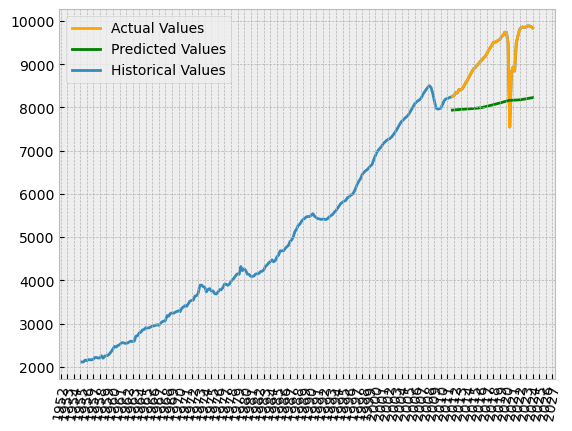

Epoch 1/100
20/20 [==============================] - 12s 188ms/step - loss: 0.1042 - val_loss: 0.0261
Epoch 2/100
20/20 [==============================] - 1s 57ms/step - loss: 0.0053 - val_loss: 4.9170e-04
Epoch 3/100
20/20 [==============================] - 1s 57ms/step - loss: 9.4776e-04 - val_loss: 2.1189e-05
Epoch 4/100
20/20 [==============================] - 1s 59ms/step - loss: 5.6520e-04 - val_loss: 3.2786e-04
Epoch 5/100
20/20 [==============================] - 1s 59ms/step - loss: 5.6757e-04 - val_loss: 1.8386e-06
Epoch 6/100
20/20 [==============================] - 1s 57ms/step - loss: 6.1902e-04 - val_loss: 4.2035e-04
Epoch 7/100
20/20 [==============================] - 1s 61ms/step - loss: 4.6258e-04 - val_loss: 3.0131e-06
Epoch 8/100
20/20 [==============================] - 1s 59ms/step - loss: 4.8377e-04 - val_loss: 6.8330e-05
Epoch 9/100
20/20 [==============================] - 1s 55ms/step - loss: 3.8643e-04 - val_loss: 7.6173e-06
Epoch 10/100
20/20 [==================

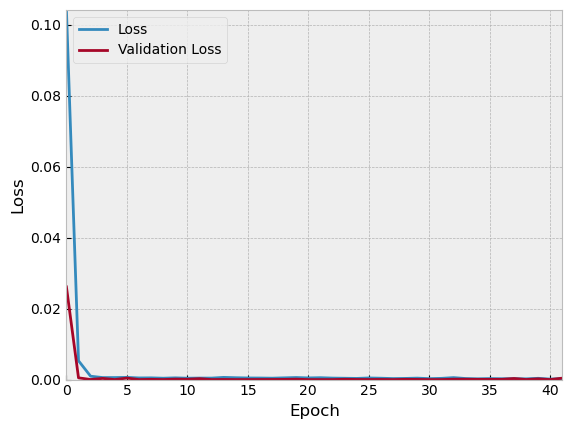

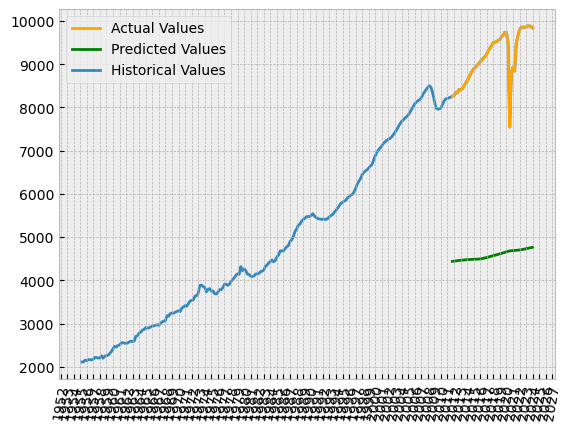

Epoch 1/100
20/20 [==============================] - 12s 183ms/step - loss: 0.1297 - val_loss: 0.0098
Epoch 2/100
20/20 [==============================] - 1s 53ms/step - loss: 0.0065 - val_loss: 0.0029
Epoch 3/100
20/20 [==============================] - 1s 53ms/step - loss: 9.9023e-04 - val_loss: 5.0443e-04
Epoch 4/100
20/20 [==============================] - 1s 54ms/step - loss: 5.5448e-04 - val_loss: 1.8799e-04
Epoch 5/100
20/20 [==============================] - 1s 55ms/step - loss: 6.1125e-04 - val_loss: 3.6909e-05
Epoch 6/100
20/20 [==============================] - 1s 55ms/step - loss: 5.1643e-04 - val_loss: 6.6171e-05
Epoch 7/100
20/20 [==============================] - 1s 55ms/step - loss: 7.2538e-04 - val_loss: 1.9092e-04
Epoch 8/100
20/20 [==============================] - 1s 57ms/step - loss: 4.3986e-04 - val_loss: 1.3193e-04
Epoch 9/100
20/20 [==============================] - 1s 56ms/step - loss: 4.8237e-04 - val_loss: 2.9333e-06
Epoch 10/100
20/20 [======================

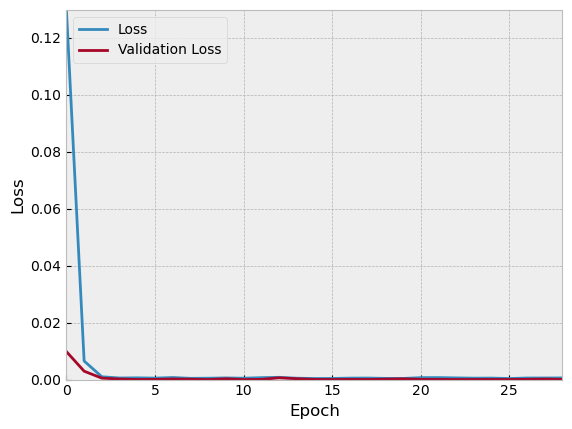

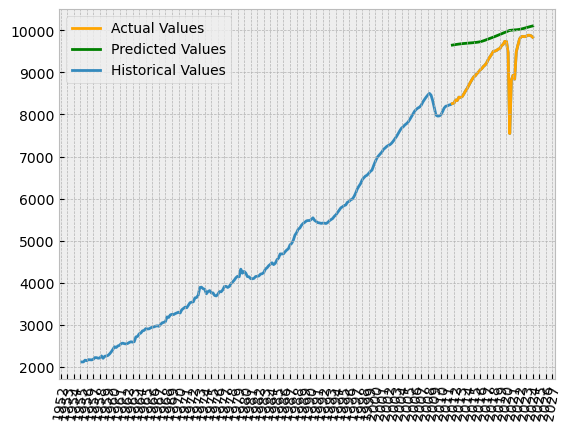

Epoch 1/100
20/20 [==============================] - 12s 178ms/step - loss: 0.0900 - val_loss: 0.0173
Epoch 2/100
20/20 [==============================] - 1s 52ms/step - loss: 0.0045 - val_loss: 1.3196e-04
Epoch 3/100
20/20 [==============================] - 1s 52ms/step - loss: 0.0011 - val_loss: 1.3478e-06
Epoch 4/100
20/20 [==============================] - 1s 56ms/step - loss: 8.3744e-04 - val_loss: 2.2830e-04
Epoch 5/100
20/20 [==============================] - 1s 53ms/step - loss: 6.8933e-04 - val_loss: 7.4497e-04
Epoch 6/100
20/20 [==============================] - 1s 57ms/step - loss: 5.1522e-04 - val_loss: 8.7535e-05
Epoch 7/100
20/20 [==============================] - 1s 56ms/step - loss: 6.0204e-04 - val_loss: 3.8700e-05
Epoch 8/100
20/20 [==============================] - 1s 56ms/step - loss: 6.3836e-04 - val_loss: 1.0295e-05
Epoch 9/100
20/20 [==============================] - 1s 54ms/step - loss: 6.6528e-04 - val_loss: 1.0345e-04
Epoch 10/100
20/20 [======================

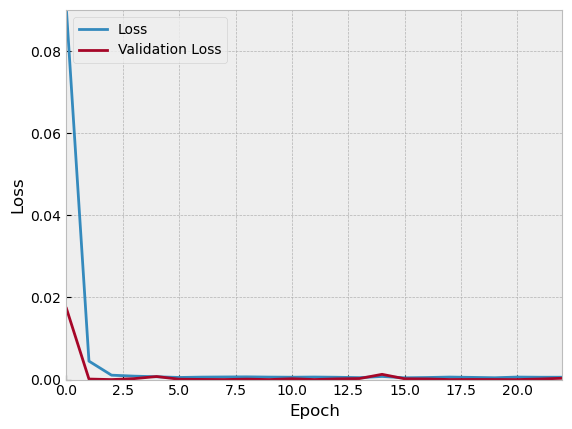

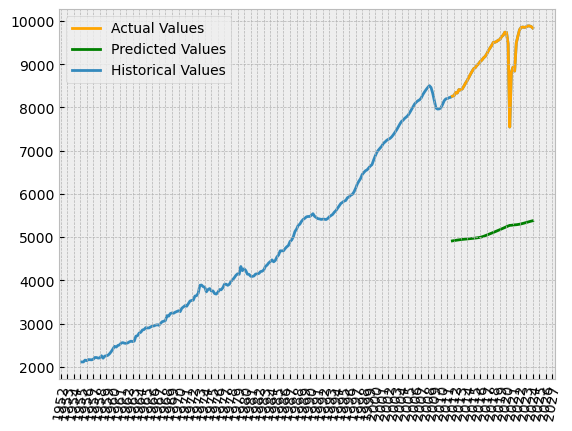

Epoch 1/100
20/20 [==============================] - 12s 167ms/step - loss: 0.1322 - val_loss: 0.0156
Epoch 2/100
20/20 [==============================] - 1s 52ms/step - loss: 0.0056 - val_loss: 0.0052
Epoch 3/100
20/20 [==============================] - 1s 50ms/step - loss: 0.0016 - val_loss: 6.3940e-04
Epoch 4/100
20/20 [==============================] - 1s 51ms/step - loss: 6.5911e-04 - val_loss: 1.6701e-05
Epoch 5/100
20/20 [==============================] - 1s 50ms/step - loss: 5.4083e-04 - val_loss: 1.1009e-04
Epoch 6/100
20/20 [==============================] - 1s 50ms/step - loss: 7.9591e-04 - val_loss: 4.5235e-05
Epoch 7/100
20/20 [==============================] - 1s 52ms/step - loss: 7.1994e-04 - val_loss: 3.0094e-04
Epoch 8/100
20/20 [==============================] - 1s 50ms/step - loss: 6.1706e-04 - val_loss: 5.0679e-05
Epoch 9/100
20/20 [==============================] - 1s 52ms/step - loss: 5.7295e-04 - val_loss: 4.0529e-04
Epoch 10/100
20/20 [==========================

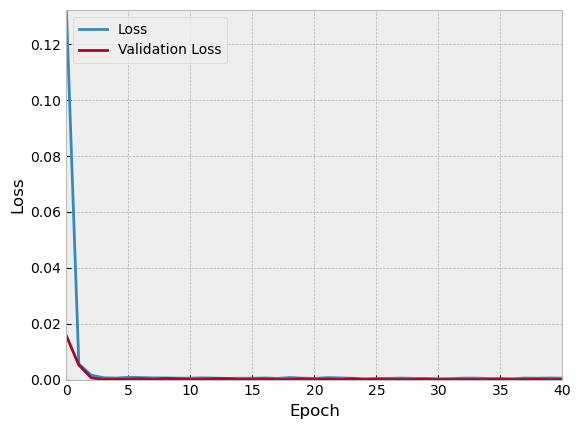

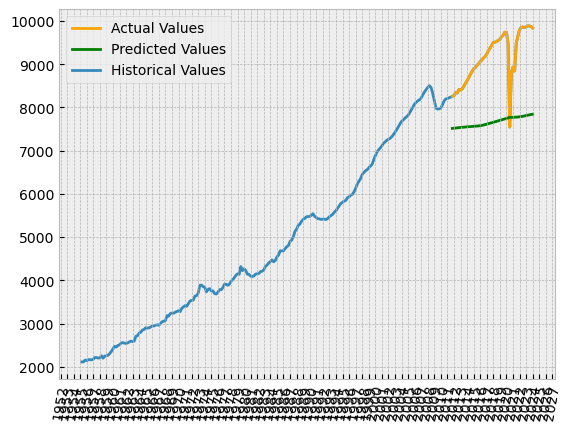

Epoch 1/100
20/20 [==============================] - 12s 168ms/step - loss: 0.1063 - val_loss: 0.0215
Epoch 2/100
20/20 [==============================] - 1s 59ms/step - loss: 0.0055 - val_loss: 4.4586e-04
Epoch 3/100
20/20 [==============================] - 1s 48ms/step - loss: 0.0013 - val_loss: 3.2506e-06
Epoch 4/100
20/20 [==============================] - 1s 47ms/step - loss: 9.9126e-04 - val_loss: 3.9512e-06
Epoch 5/100
20/20 [==============================] - 1s 48ms/step - loss: 8.2562e-04 - val_loss: 1.2636e-04
Epoch 6/100
20/20 [==============================] - 1s 49ms/step - loss: 7.2621e-04 - val_loss: 5.6722e-06
Epoch 7/100
20/20 [==============================] - 1s 48ms/step - loss: 7.0559e-04 - val_loss: 8.7145e-06
Epoch 8/100
20/20 [==============================] - 1s 47ms/step - loss: 0.0011 - val_loss: 1.2037e-04
Epoch 9/100
20/20 [==============================] - 1s 46ms/step - loss: 6.9547e-04 - val_loss: 6.3640e-06
Epoch 10/100
20/20 [==========================

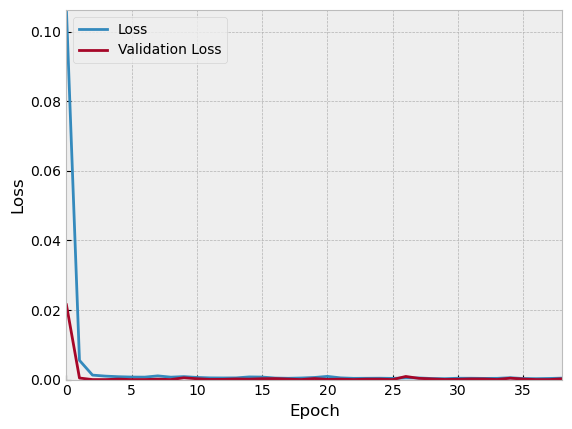

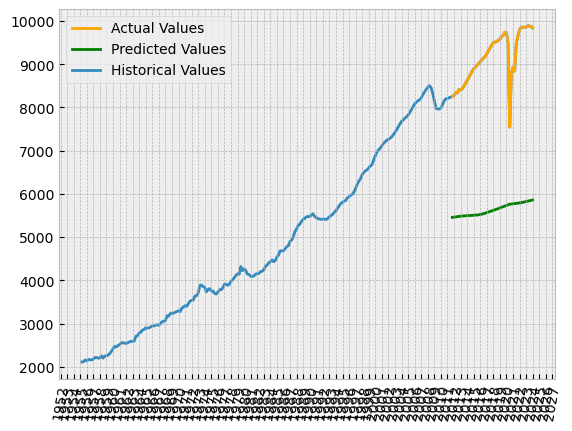

Epoch 1/100
20/20 [==============================] - 13s 178ms/step - loss: 0.0860 - val_loss: 0.0069
Epoch 2/100
20/20 [==============================] - 1s 48ms/step - loss: 0.0038 - val_loss: 2.2461e-04
Epoch 3/100
20/20 [==============================] - 1s 50ms/step - loss: 0.0012 - val_loss: 1.0753e-04
Epoch 4/100
20/20 [==============================] - 1s 47ms/step - loss: 9.8425e-04 - val_loss: 1.3270e-04
Epoch 5/100
20/20 [==============================] - 1s 45ms/step - loss: 8.9114e-04 - val_loss: 2.6963e-04
Epoch 6/100
20/20 [==============================] - 1s 46ms/step - loss: 6.6438e-04 - val_loss: 5.1385e-05
Epoch 7/100
20/20 [==============================] - 1s 48ms/step - loss: 6.8802e-04 - val_loss: 1.7515e-04
Epoch 8/100
20/20 [==============================] - 1s 49ms/step - loss: 7.5312e-04 - val_loss: 1.1345e-05
Epoch 9/100
20/20 [==============================] - 1s 50ms/step - loss: 9.7759e-04 - val_loss: 1.2934e-04
Epoch 10/100
20/20 [======================

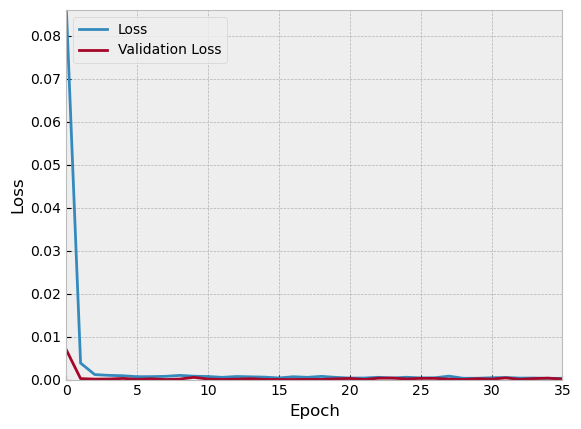

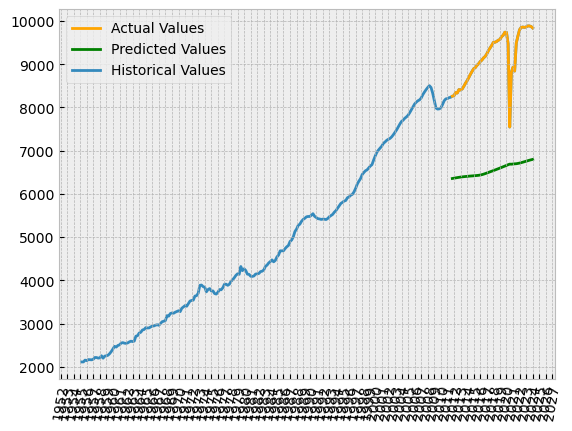

Epoch 1/100
20/20 [==============================] - 11s 160ms/step - loss: 0.1372 - val_loss: 0.0176
Epoch 2/100
20/20 [==============================] - 1s 45ms/step - loss: 0.0064 - val_loss: 0.0046
Epoch 3/100
20/20 [==============================] - 1s 47ms/step - loss: 0.0016 - val_loss: 4.4669e-04
Epoch 4/100
20/20 [==============================] - 1s 44ms/step - loss: 6.7890e-04 - val_loss: 3.1610e-05
Epoch 5/100
20/20 [==============================] - 1s 44ms/step - loss: 9.3335e-04 - val_loss: 1.3094e-04
Epoch 6/100
20/20 [==============================] - 1s 44ms/step - loss: 0.0010 - val_loss: 8.9421e-04
Epoch 7/100
20/20 [==============================] - 1s 47ms/step - loss: 4.8980e-04 - val_loss: 8.3214e-06
Epoch 8/100
20/20 [==============================] - 1s 47ms/step - loss: 6.1715e-04 - val_loss: 6.3392e-06
Epoch 9/100
20/20 [==============================] - 1s 44ms/step - loss: 9.5873e-04 - val_loss: 8.5398e-04
Epoch 10/100
20/20 [==============================

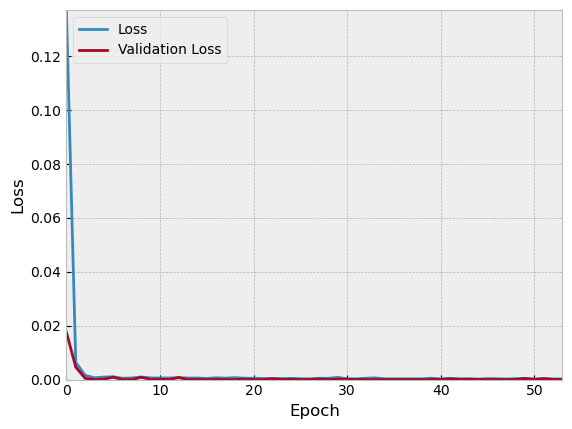

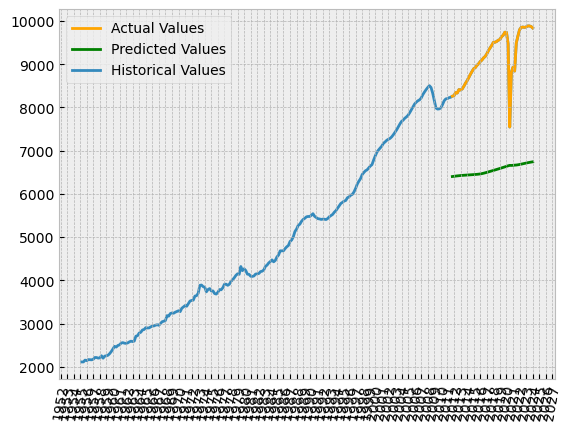

Epoch 1/100
20/20 [==============================] - 11s 155ms/step - loss: 0.0962 - val_loss: 0.0141
Epoch 2/100
20/20 [==============================] - 1s 42ms/step - loss: 0.0041 - val_loss: 0.0026
Epoch 3/100
20/20 [==============================] - 1s 42ms/step - loss: 5.9558e-04 - val_loss: 4.4996e-04
Epoch 4/100
20/20 [==============================] - 1s 41ms/step - loss: 5.6643e-04 - val_loss: 1.2145e-04
Epoch 5/100
20/20 [==============================] - 1s 41ms/step - loss: 5.7580e-04 - val_loss: 3.8572e-04
Epoch 6/100
20/20 [==============================] - 1s 41ms/step - loss: 4.1245e-04 - val_loss: 2.0940e-04
Epoch 7/100
20/20 [==============================] - 1s 41ms/step - loss: 3.4295e-04 - val_loss: 1.0846e-04
Epoch 8/100
20/20 [==============================] - 1s 42ms/step - loss: 4.3447e-04 - val_loss: 1.9138e-04
Epoch 9/100
20/20 [==============================] - 1s 44ms/step - loss: 3.2346e-04 - val_loss: 1.6038e-04
Epoch 10/100
20/20 [======================

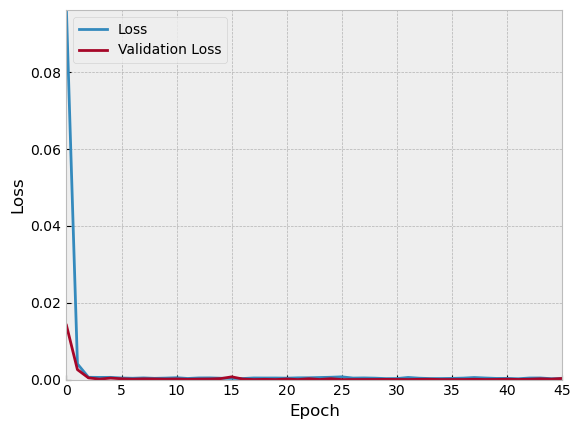

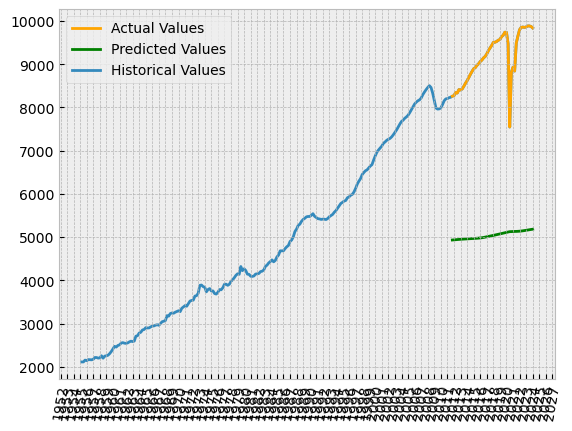

Epoch 1/100
20/20 [==============================] - 12s 171ms/step - loss: 0.1217 - val_loss: 0.0165
Epoch 2/100
20/20 [==============================] - 1s 41ms/step - loss: 0.0062 - val_loss: 0.0035
Epoch 3/100
20/20 [==============================] - 1s 39ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 4/100
20/20 [==============================] - 1s 40ms/step - loss: 7.3805e-04 - val_loss: 7.8015e-05
Epoch 5/100
20/20 [==============================] - 1s 42ms/step - loss: 6.1589e-04 - val_loss: 9.4804e-05
Epoch 6/100
20/20 [==============================] - 1s 41ms/step - loss: 5.0347e-04 - val_loss: 2.3199e-06
Epoch 7/100
20/20 [==============================] - 1s 42ms/step - loss: 5.5270e-04 - val_loss: 6.5695e-06
Epoch 8/100
20/20 [==============================] - 1s 41ms/step - loss: 6.1235e-04 - val_loss: 9.2656e-06
Epoch 9/100
20/20 [==============================] - 1s 46ms/step - loss: 5.4094e-04 - val_loss: 5.1193e-05
Epoch 10/100
20/20 [==============================

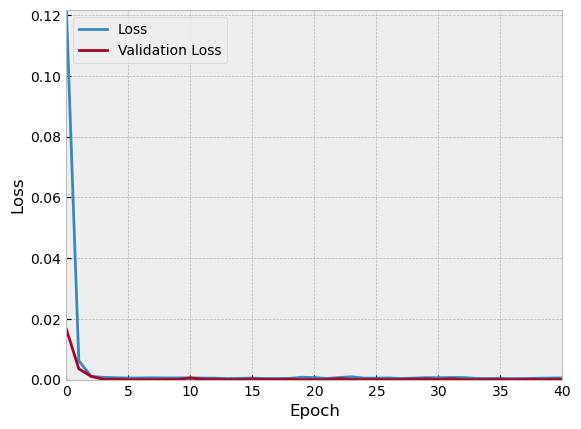

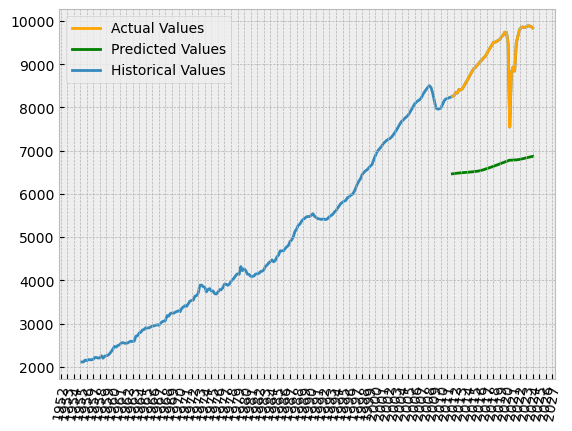

In [369]:
for iteration in range(0,10):
    lmodel = tuner.hypermodel.build(best_hps)
    #lmodel.summary()

    stop_early = keras.callbacks.EarlyStopping(monitor='val_loss', patience=20) # Exit early if loss rises too much

    ltsmhistory = lmodel.fit(
        splitData[1]["x_train"],
        splitData[1]["y_train"],
        epochs=100,
        batch_size=8,
        shuffle=False,
        validation_split=0.2,
        callbacks=[stop_early]
    )

    y_pred = lmodel.predict(splitData[1]["x_test"])
    old_pred = lmodel.predict(splitData[1]["x_train"])

    y_test_orig = scaler.inverse_transform(splitData[1]["y_test"].reshape(-1,1))
    y_pred_orig = scaler.inverse_transform(y_pred.reshape(-1,1))
    old_pred_orig = scaler.inverse_transform(old_pred.reshape(-1,1))

    plt.style.use('bmh')

    plt.plot(ltsmhistory.history['loss'], label='Loss')
    plt.plot(ltsmhistory.history['val_loss'], label = 'Validation Loss') # Theres a lot of data so these start pretty low
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.ylim([0, max(ltsmhistory.history['loss'])])
    plt.xlim([0, len(ltsmhistory.history['loss'])-1])
    plt.legend(loc='upper left')


    # make a prediction
    mse = mean_squared_error(y_test_orig,y_pred_orig)
    mae = mean_absolute_error(y_test_orig,y_pred_orig)
    mape = mean_absolute_percentage_error(y_test_orig,y_pred_orig)*100
    r2 = r2_score(y_test_orig,y_pred_orig)
    print("R²= {:.3f}\nMAPE={:.3f}%\nMAE={:.3f}".format(r2,mape,mae))

    fig,ax = plt.subplots()

    historical = df.iloc[1,:]

    ax.plot(historical.tail(50).index, y_test_orig, color='orange', label='Actual Values',zorder=0)
    ax.plot(historical.tail(50).index, y_pred_orig, color='green', label='Predicted Values',zorder=1)
    #ax.plot(historical.iloc[-20:-4].index, old_pred_orig, color='red', label='Testing Values',zorder=1)

    ax.xaxis.set_major_locator(mdates.YearLocator())
    ax.tick_params(axis='x', rotation=80)

    ax.plot(historical.index,historical.values,zorder=-1,label="Historical Values")
    ax.legend()
    plt.show()

    lmodel.save(f'savedModels/zTurnoverLstm/B/Trial{iteration}/model.keras')

Epoch 1/50
20/20 [==============================] - 12s 153ms/step - loss: 0.0308 - val_loss: 0.1113
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0487 - val_loss: 0.0175
Epoch 3/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0068 - val_loss: 0.0043
Epoch 4/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0054 - val_loss: 0.0110
Epoch 5/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0063 - val_loss: 0.0026
Epoch 6/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0021 - val_loss: 0.0022
Epoch 7/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0102 - val_loss: 0.0114
Epoch 8/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0240 - val_loss: 0.2292
Epoch 9/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0422 - val_loss: 0.0021
Epoch 10/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0185 - val_loss: 0.0102
Epoch 1

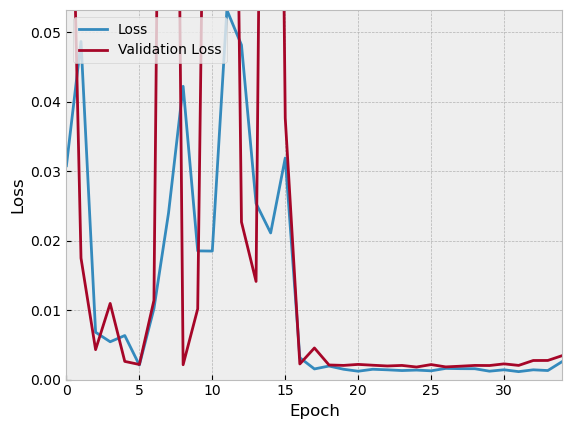

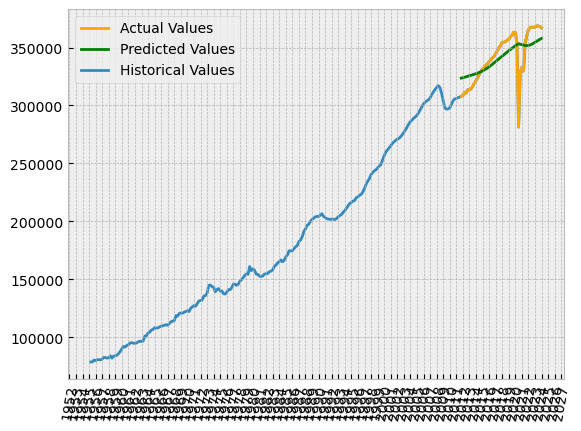

Epoch 1/50
20/20 [==============================] - 11s 152ms/step - loss: 0.0340 - val_loss: 0.1306
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0612 - val_loss: 0.0055
Epoch 3/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0110 - val_loss: 0.0051
Epoch 4/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0029 - val_loss: 0.0021
Epoch 5/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0054 - val_loss: 0.0056
Epoch 6/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0088 - val_loss: 0.0268
Epoch 7/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0226 - val_loss: 0.0285
Epoch 8/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0273 - val_loss: 0.2872
Epoch 9/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0481 - val_loss: 0.1428
Epoch 10/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0263 - val_loss: 0.0209
Epoch 1

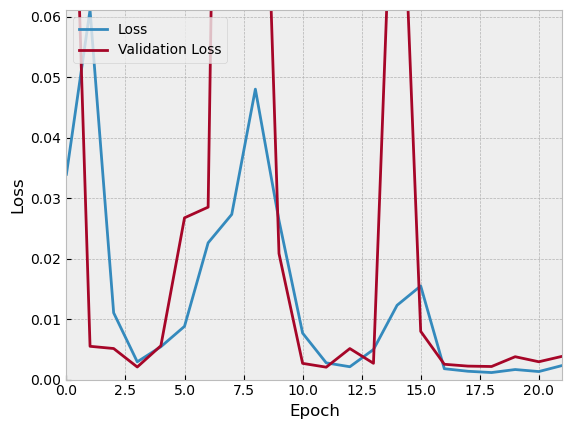

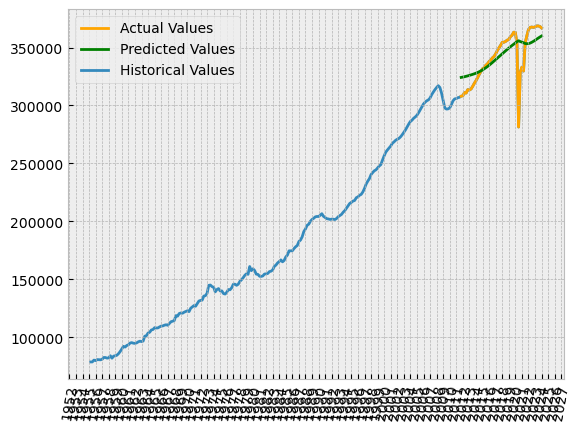

Epoch 1/50
20/20 [==============================] - 11s 154ms/step - loss: 0.0254 - val_loss: 0.1241
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0477 - val_loss: 0.0284
Epoch 3/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0082 - val_loss: 0.0049
Epoch 4/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0059 - val_loss: 0.0044
Epoch 5/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0149 - val_loss: 0.1034
Epoch 6/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0203 - val_loss: 0.0044
Epoch 7/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0163 - val_loss: 0.0723
Epoch 8/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0196 - val_loss: 0.0113
Epoch 9/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0137 - val_loss: 0.0486
Epoch 10/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0227 - val_loss: 0.0099
Epoch 1

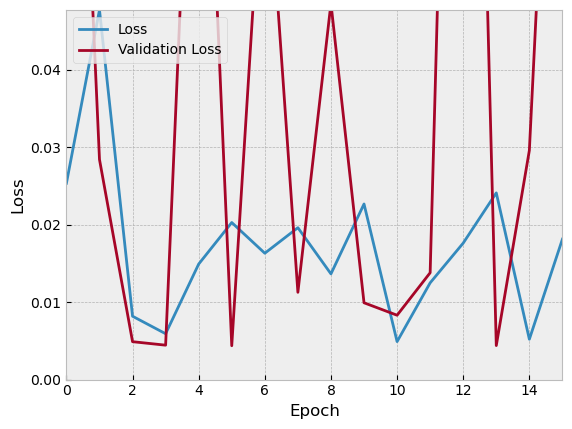

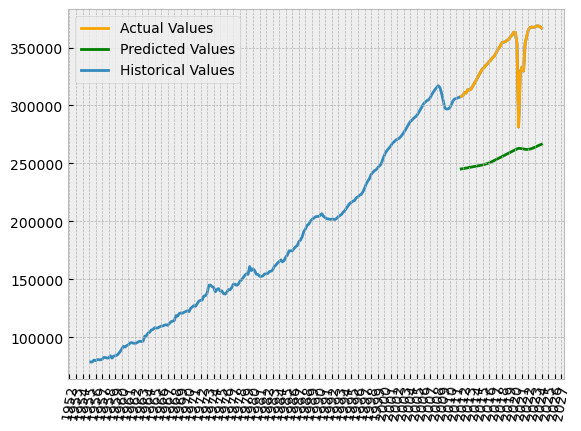

Epoch 1/50
20/20 [==============================] - 11s 153ms/step - loss: 0.0354 - val_loss: 0.1495
Epoch 2/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0485 - val_loss: 0.0176
Epoch 3/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0147 - val_loss: 0.0249
Epoch 4/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0165 - val_loss: 0.0076
Epoch 5/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0237 - val_loss: 0.2106
Epoch 6/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0240 - val_loss: 0.0128
Epoch 7/50
20/20 [==============================] - 1s 31ms/step - loss: 0.0033 - val_loss: 0.0040
Epoch 8/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0020 - val_loss: 0.0028
Epoch 9/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0057 - val_loss: 0.0053
Epoch 10/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0116 - val_loss: 0.0802
Epoch 1

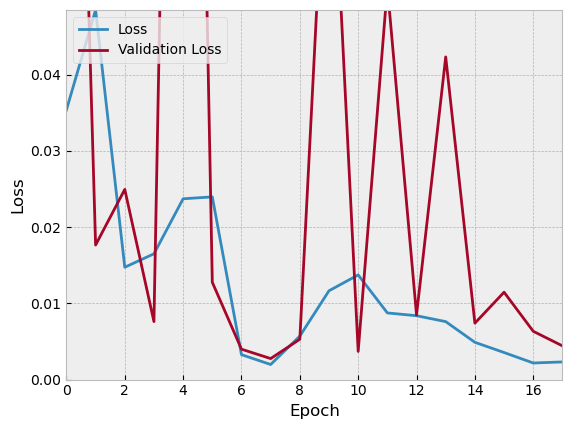

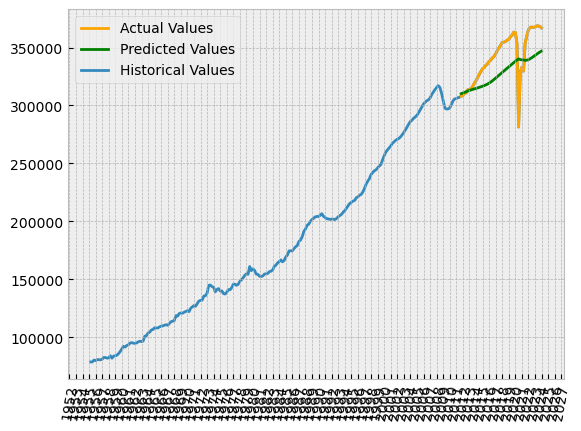

Epoch 1/50
20/20 [==============================] - 11s 149ms/step - loss: 0.0419 - val_loss: 0.1129
Epoch 2/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0517 - val_loss: 0.0131
Epoch 3/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0145 - val_loss: 0.0284
Epoch 4/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0263 - val_loss: 0.0290
Epoch 5/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0314 - val_loss: 0.3357
Epoch 6/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0571 - val_loss: 0.0634
Epoch 7/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0091 - val_loss: 0.0041
Epoch 8/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0104 - val_loss: 0.0887
Epoch 9/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0060 - val_loss: 0.0018
Epoch 10/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0017 - val_loss: 0.0023
Epoch 1

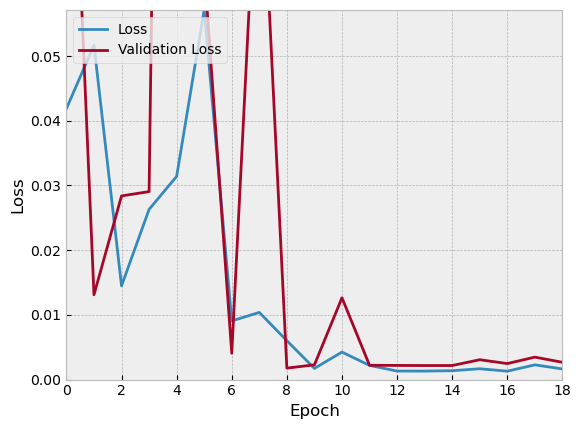

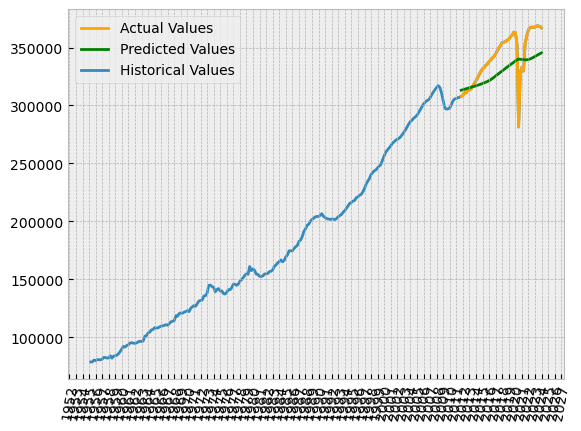

Epoch 1/50
20/20 [==============================] - 11s 143ms/step - loss: 0.0340 - val_loss: 0.1189
Epoch 2/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0570 - val_loss: 0.0148
Epoch 3/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0088 - val_loss: 0.0032
Epoch 4/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0030 - val_loss: 0.0035
Epoch 5/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0154 - val_loss: 0.0166
Epoch 6/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0239 - val_loss: 0.2288
Epoch 7/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0332 - val_loss: 0.0024
Epoch 8/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0090 - val_loss: 0.0041
Epoch 9/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0203 - val_loss: 0.1983
Epoch 10/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0199 - val_loss: 0.0091
Epoch 1

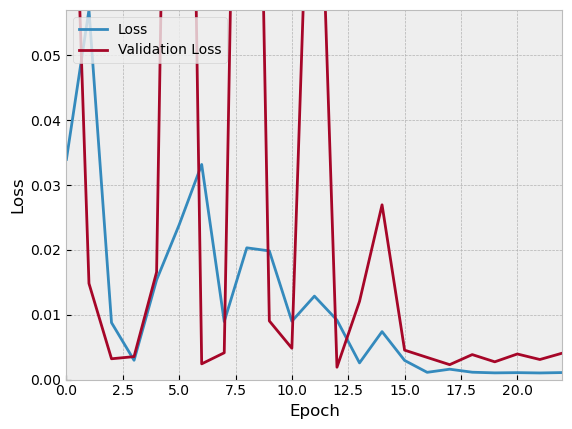

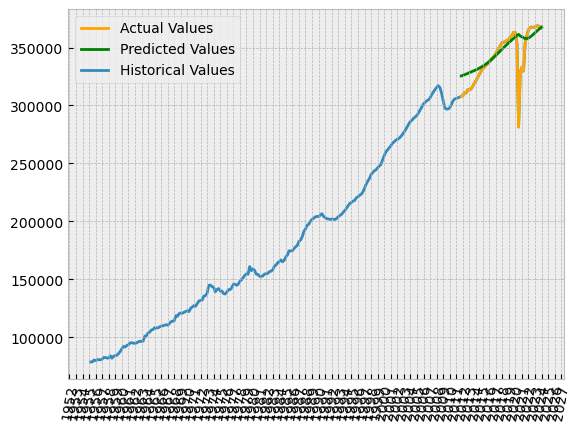

Epoch 1/50
20/20 [==============================] - 12s 157ms/step - loss: 0.0240 - val_loss: 0.1212
Epoch 2/50
20/20 [==============================] - 1s 28ms/step - loss: 0.0383 - val_loss: 0.0214
Epoch 3/50
20/20 [==============================] - 1s 27ms/step - loss: 0.0196 - val_loss: 0.0512
Epoch 4/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0174 - val_loss: 0.0083
Epoch 5/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0240 - val_loss: 0.2403
Epoch 6/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0275 - val_loss: 0.0035
Epoch 7/50
20/20 [==============================] - 1s 28ms/step - loss: 0.0066 - val_loss: 0.0023
Epoch 8/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0085 - val_loss: 0.0659
Epoch 9/50
20/20 [==============================] - 1s 26ms/step - loss: 0.0089 - val_loss: 0.0021
Epoch 10/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0026 - val_loss: 0.0026
Epoch 1

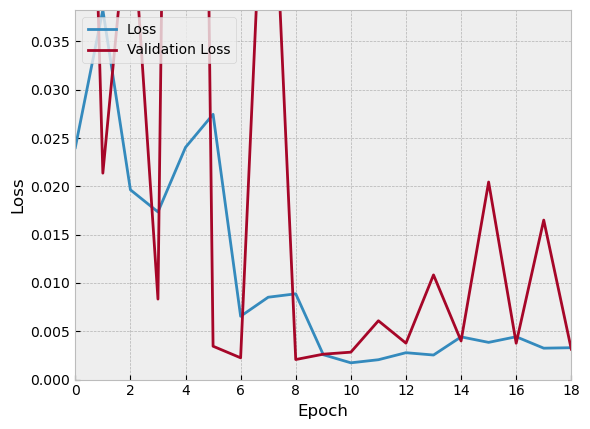

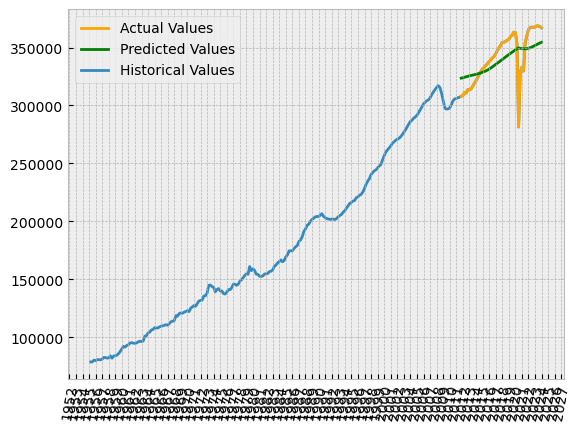

Epoch 1/50
20/20 [==============================] - 11s 142ms/step - loss: 0.0428 - val_loss: 0.1327
Epoch 2/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0260 - val_loss: 0.0015
Epoch 3/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0245 - val_loss: 0.2612
Epoch 4/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0301 - val_loss: 0.0095
Epoch 5/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0070 - val_loss: 0.0089
Epoch 6/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0088 - val_loss: 0.0317
Epoch 7/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0061 - val_loss: 0.0028
Epoch 8/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0050 - val_loss: 0.0431
Epoch 9/50
20/20 [==============================] - 0s 25ms/step - loss: 0.0044 - val_loss: 0.0035
Epoch 10/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0023 - val_loss: 0.0215
Epoch 1

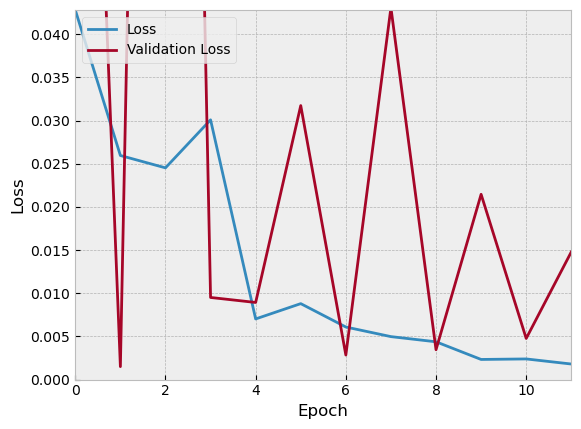

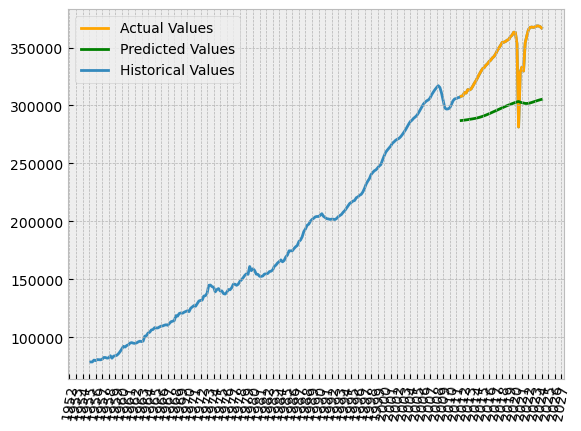

Epoch 1/50
20/20 [==============================] - 11s 137ms/step - loss: 0.0350 - val_loss: 0.1247
Epoch 2/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0446 - val_loss: 0.0256
Epoch 3/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0159 - val_loss: 0.0208
Epoch 4/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0238 - val_loss: 0.0321
Epoch 5/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0301 - val_loss: 0.3180
Epoch 6/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0453 - val_loss: 0.0387
Epoch 7/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0129 - val_loss: 0.0029
Epoch 8/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0163 - val_loss: 0.1677
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0210 - val_loss: 0.0079
Epoch 10/50
20/20 [==============================] - 0s 25ms/step - loss: 0.0036 - val_loss: 0.0118
Epoch 1

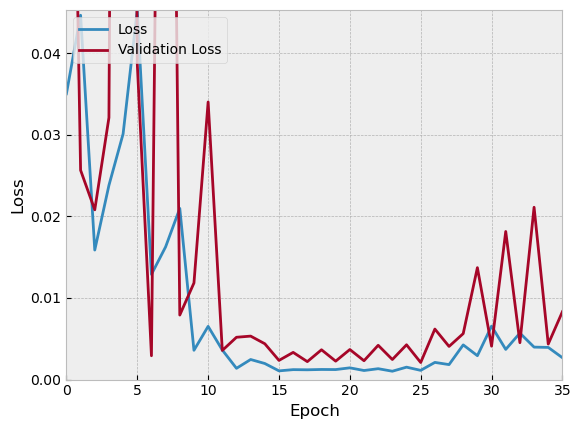

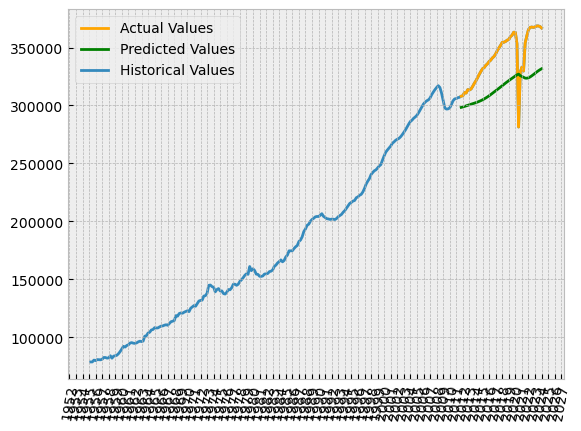

Epoch 1/50
20/20 [==============================] - 12s 217ms/step - loss: 0.0263 - val_loss: 0.0982
Epoch 2/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0523 - val_loss: 0.0298
Epoch 3/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0109 - val_loss: 0.0029
Epoch 4/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0079 - val_loss: 0.0065
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0150 - val_loss: 0.0835
Epoch 6/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0186 - val_loss: 0.0048
Epoch 7/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0242 - val_loss: 0.1860
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0204 - val_loss: 0.0025
Epoch 9/50
20/20 [==============================] - 1s 25ms/step - loss: 0.0121 - val_loss: 0.0063
Epoch 10/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0193 - val_loss: 0.1696
Epoch 1

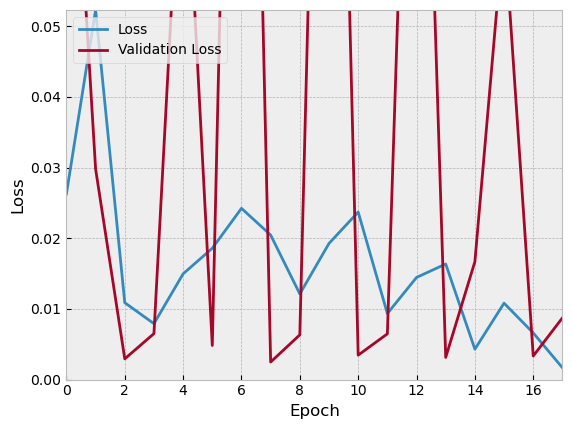

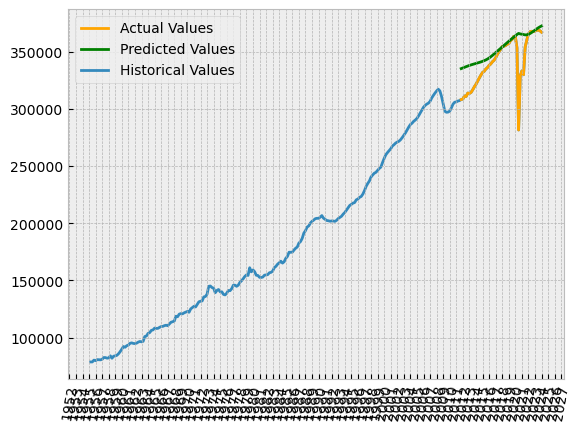

Epoch 1/50
20/20 [==============================] - 11s 140ms/step - loss: 0.0725 - val_loss: 0.0200
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0023 - val_loss: 6.4130e-04
Epoch 3/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0016 - val_loss: 7.3076e-05
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0014 - val_loss: 4.0822e-04
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 0.0017
Epoch 6/50
20/20 [==============================] - 0s 22ms/step - loss: 7.7774e-04 - val_loss: 4.0768e-04
Epoch 7/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0015 - val_loss: 7.3502e-04
Epoch 8/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0013 - val_loss: 7.2570e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 9.8975e-04 - val_loss: 9.5207e-04
Epoch 10/50
20/20 [==============================] - 0s 23ms/step - los

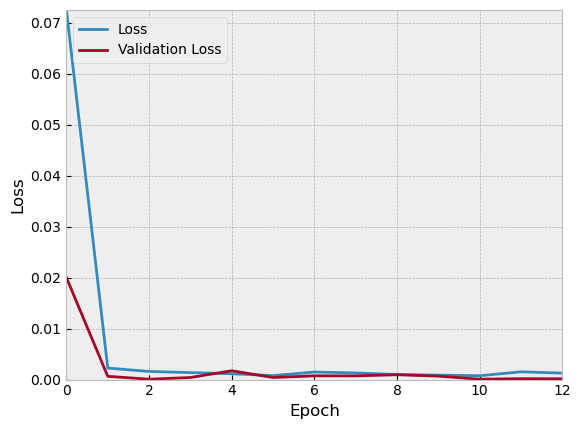

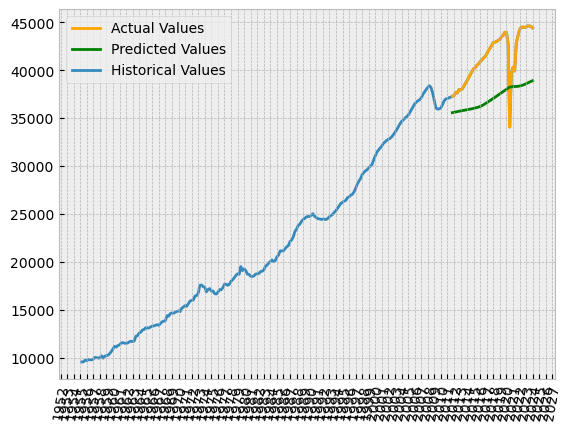

Epoch 1/50
20/20 [==============================] - 11s 144ms/step - loss: 0.1050 - val_loss: 0.0241
Epoch 2/50
20/20 [==============================] - 0s 21ms/step - loss: 0.0050 - val_loss: 0.0038
Epoch 3/50
20/20 [==============================] - 0s 22ms/step - loss: 5.7311e-04 - val_loss: 4.5590e-04
Epoch 4/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0013 - val_loss: 1.0219e-04
Epoch 5/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0015 - val_loss: 3.4469e-04
Epoch 6/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 4.6069e-04
Epoch 7/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 8.3141e-04
Epoch 8/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0010 - val_loss: 0.0012
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 7.9751e-04 - val_loss: 4.3841e-04
Epoch 10/50
20/20 [==============================] - 0s 22ms/step - loss: 0

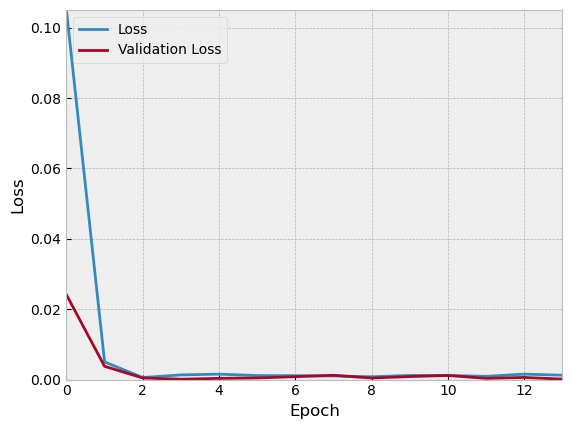

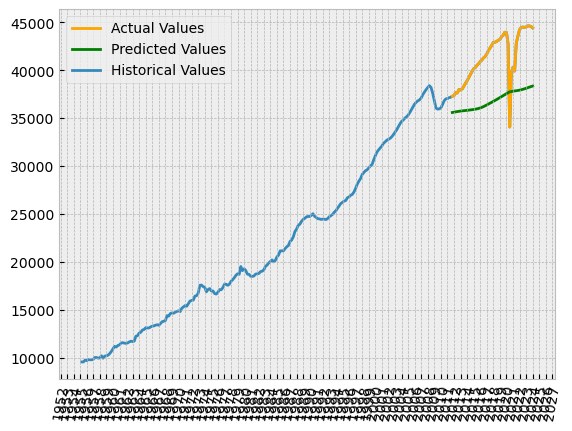

Epoch 1/50
20/20 [==============================] - 11s 136ms/step - loss: 0.0837 - val_loss: 0.0167
Epoch 2/50
20/20 [==============================] - 0s 21ms/step - loss: 0.0023 - val_loss: 6.0045e-05
Epoch 3/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0023 - val_loss: 4.4647e-05
Epoch 4/50
20/20 [==============================] - 0s 21ms/step - loss: 0.0017 - val_loss: 4.6648e-04
Epoch 5/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 8.0425e-04
Epoch 6/50
20/20 [==============================] - 0s 21ms/step - loss: 8.7553e-04 - val_loss: 3.3950e-04
Epoch 7/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0013 - val_loss: 8.8935e-04
Epoch 8/50
20/20 [==============================] - 0s 22ms/step - loss: 8.9993e-04 - val_loss: 8.4409e-04
Epoch 9/50
20/20 [==============================] - 0s 21ms/step - loss: 0.0010 - val_loss: 3.2976e-04
Epoch 10/50
20/20 [==============================] - 0s 23ms/step -

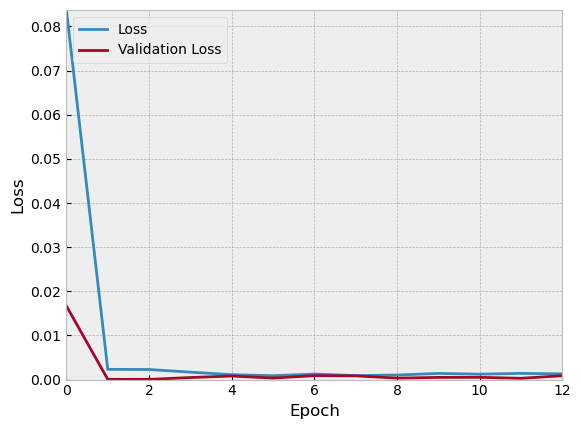

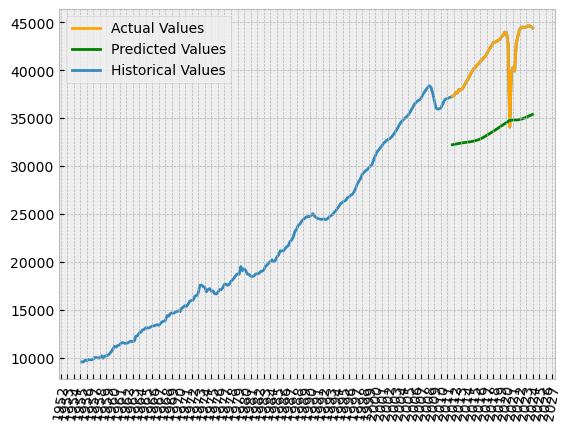

Epoch 1/50
20/20 [==============================] - 11s 141ms/step - loss: 0.1273 - val_loss: 0.0050
Epoch 2/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0044 - val_loss: 3.5830e-04
Epoch 3/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0013 - val_loss: 1.5712e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0031 - val_loss: 4.9558e-05
Epoch 5/50
20/20 [==============================] - 1s 25ms/step - loss: 0.0032 - val_loss: 1.4469e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0022 - val_loss: 4.9741e-04
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0015 - val_loss: 0.0010
Epoch 8/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 3.6497e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0017 - val_loss: 7.7194e-04
Epoch 10/50
20/20 [==============================] - 0s 22ms/step - loss: 0.001

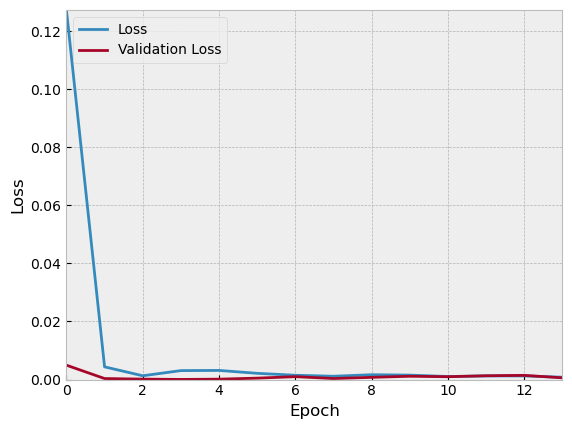

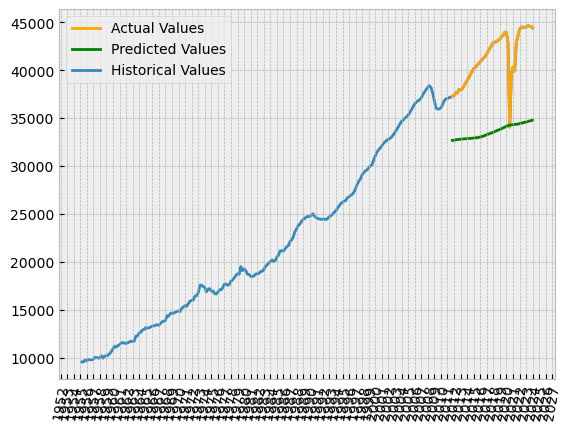

Epoch 1/50
20/20 [==============================] - 11s 146ms/step - loss: 0.1187 - val_loss: 0.0152
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0045 - val_loss: 0.0036
Epoch 3/50
20/20 [==============================] - 0s 24ms/step - loss: 5.8576e-04 - val_loss: 2.2256e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0015 - val_loss: 3.0089e-04
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0010 - val_loss: 4.4131e-04
Epoch 6/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 7/50
20/20 [==============================] - 0s 22ms/step - loss: 7.2146e-04 - val_loss: 4.6733e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 6.5780e-04
Epoch 9/50
20/20 [==============================] - 1s 25ms/step - loss: 0.0012 - val_loss: 0.0014
Epoch 10/50
20/20 [==============================] - 0s 23ms/step - loss: 7.266

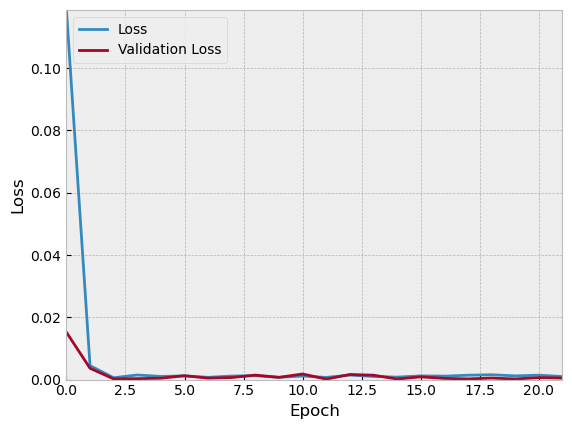

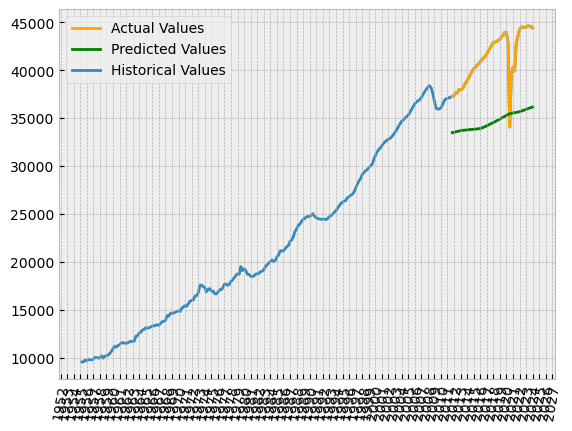

Epoch 1/50
20/20 [==============================] - 11s 149ms/step - loss: 0.0948 - val_loss: 0.0159
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0031 - val_loss: 0.0038
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 6.5348e-04 - val_loss: 9.1661e-05
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0019 - val_loss: 7.0332e-04
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0012 - val_loss: 7.0962e-04
Epoch 6/50
20/20 [==============================] - 0s 22ms/step - loss: 0.0015 - val_loss: 7.8859e-04
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 9.6793e-04 - val_loss: 4.5255e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 9.9895e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 9.6242e-04
Epoch 10/50
20/20 [==============================] - 0s 24ms/step - los

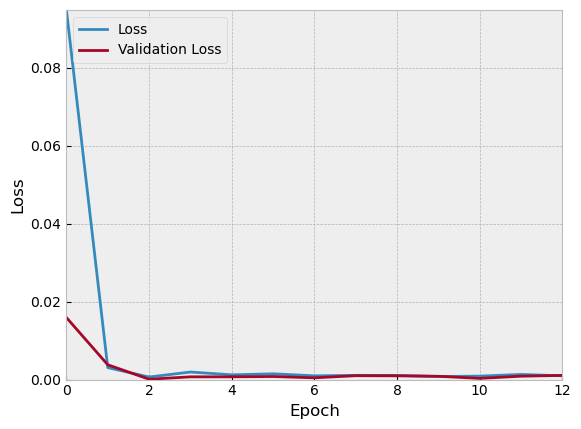

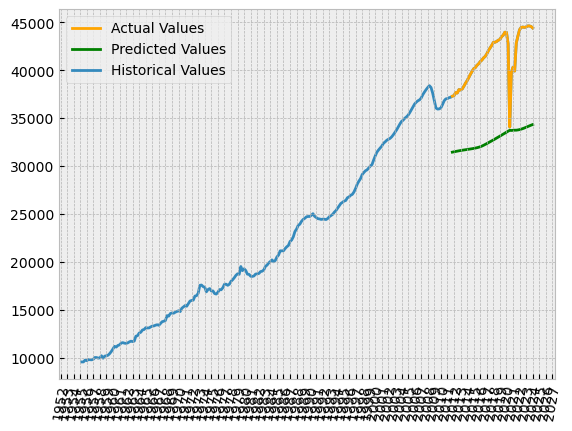

Epoch 1/50
20/20 [==============================] - 12s 176ms/step - loss: 0.1088 - val_loss: 0.0093
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0029 - val_loss: 0.0017
Epoch 3/50
20/20 [==============================] - 1s 51ms/step - loss: 7.5523e-04 - val_loss: 1.8746e-04
Epoch 4/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0014 - val_loss: 7.6477e-05
Epoch 5/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0015 - val_loss: 1.9228e-04
Epoch 6/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0015 - val_loss: 0.0010
Epoch 7/50
20/20 [==============================] - 1s 55ms/step - loss: 8.4805e-04 - val_loss: 8.9694e-04
Epoch 8/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0011 - val_loss: 9.4611e-04
Epoch 9/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 10/50
20/20 [==============================] - 1s 54ms/step - loss: 9.431

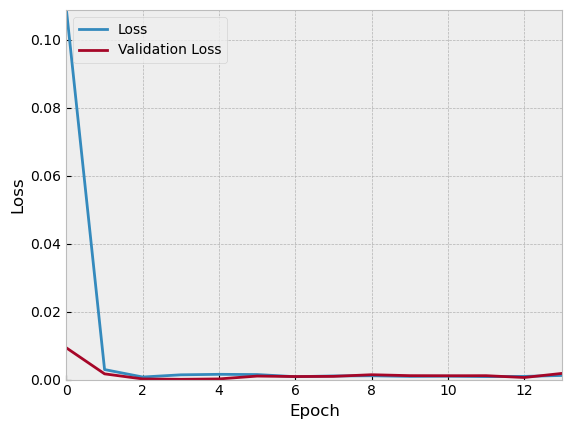

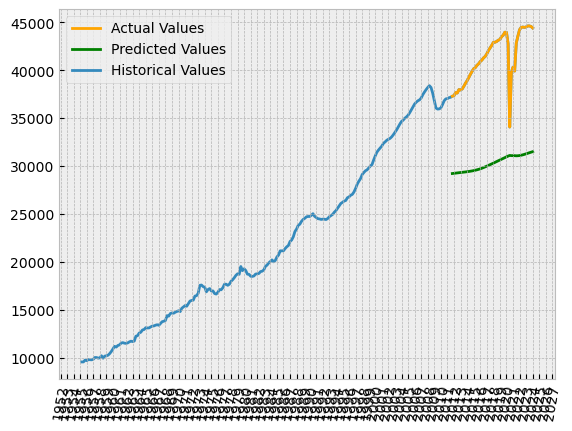

Epoch 1/50
20/20 [==============================] - 11s 170ms/step - loss: 0.0829 - val_loss: 0.0207
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0026 - val_loss: 8.8690e-04
Epoch 3/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0016 - val_loss: 3.8232e-05
Epoch 4/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0020 - val_loss: 6.3228e-04
Epoch 5/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0012 - val_loss: 0.0013
Epoch 6/50
20/20 [==============================] - 1s 51ms/step - loss: 9.6047e-04 - val_loss: 4.1919e-04
Epoch 7/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0013 - val_loss: 6.1811e-04
Epoch 8/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0012 - val_loss: 8.0244e-04
Epoch 9/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 10/50
20/20 [==============================] - 1s 54ms/step - loss: 0.001

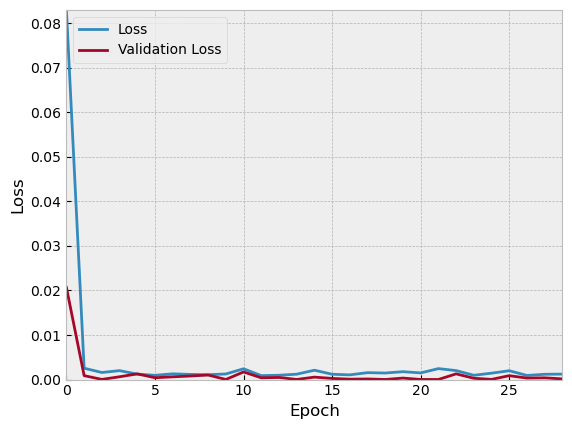

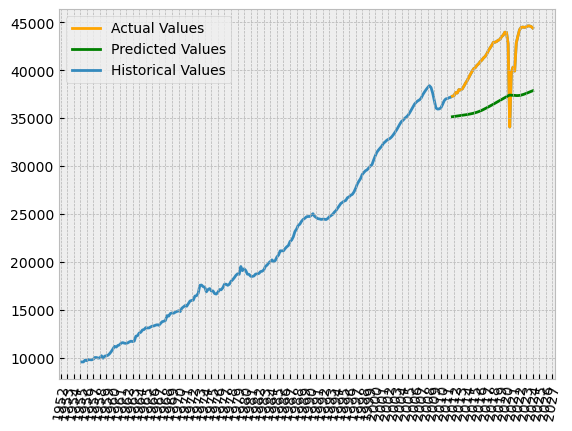

Epoch 1/50
20/20 [==============================] - 12s 169ms/step - loss: 0.1293 - val_loss: 0.0013
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0043 - val_loss: 2.4355e-04
Epoch 3/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0020 - val_loss: 1.4648e-04
Epoch 4/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0021 - val_loss: 3.3720e-05
Epoch 5/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0022 - val_loss: 1.1861e-04
Epoch 6/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0024 - val_loss: 7.4854e-04
Epoch 7/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0016 - val_loss: 0.0010
Epoch 8/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0014 - val_loss: 8.4105e-04
Epoch 9/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0015 - val_loss: 0.0013
Epoch 10/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0012 - 

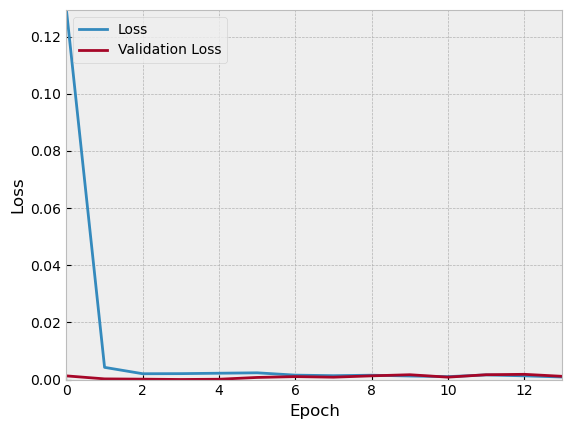

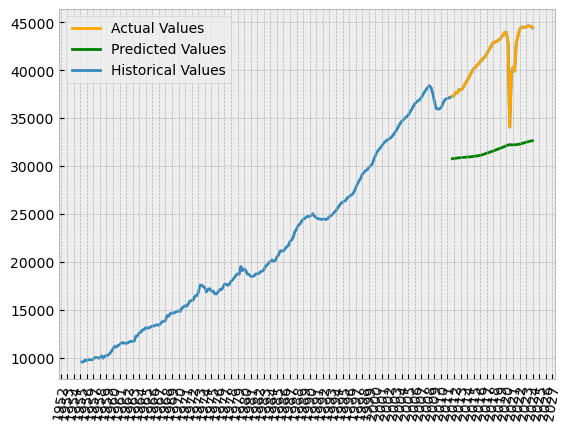

Epoch 1/50
20/20 [==============================] - 12s 167ms/step - loss: 0.0907 - val_loss: 0.0156
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0030 - val_loss: 0.0023
Epoch 3/50
20/20 [==============================] - 1s 51ms/step - loss: 6.0734e-04 - val_loss: 5.1249e-05
Epoch 4/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0013 - val_loss: 3.8914e-04
Epoch 5/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0011 - val_loss: 9.3437e-04
Epoch 6/50
20/20 [==============================] - 1s 52ms/step - loss: 8.4485e-04 - val_loss: 5.6861e-04
Epoch 7/50
20/20 [==============================] - 1s 53ms/step - loss: 8.9399e-04 - val_loss: 8.2277e-04
Epoch 8/50
20/20 [==============================] - 1s 50ms/step - loss: 7.9630e-04 - val_loss: 7.5108e-04
Epoch 9/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0012 - val_loss: 9.4659e-04
Epoch 10/50
20/20 [==============================] - 1s 50ms/st

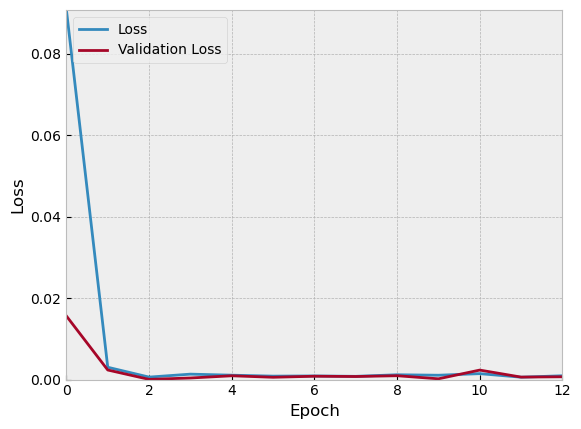

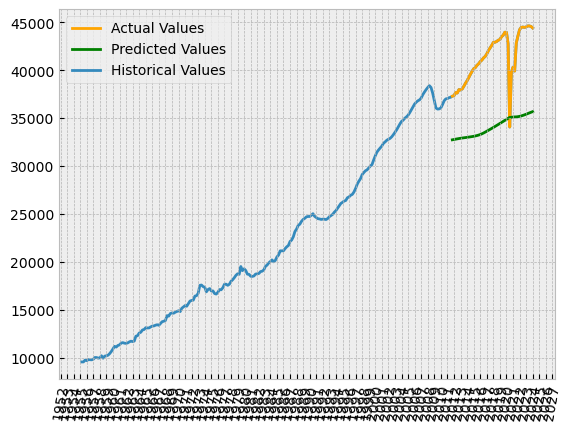

Epoch 1/50
20/20 [==============================] - 12s 173ms/step - loss: 0.1311 - val_loss: 0.0186
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0057 - val_loss: 0.0042
Epoch 3/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0011 - val_loss: 2.4367e-04
Epoch 4/50
20/20 [==============================] - 1s 51ms/step - loss: 7.3943e-04 - val_loss: 5.4407e-05
Epoch 5/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0011 - val_loss: 2.8194e-04
Epoch 6/50
20/20 [==============================] - 1s 47ms/step - loss: 6.4895e-04 - val_loss: 6.6259e-04
Epoch 7/50
20/20 [==============================] - 1s 48ms/step - loss: 7.2667e-04 - val_loss: 2.8732e-04
Epoch 8/50
20/20 [==============================] - 1s 47ms/step - loss: 8.0735e-04 - val_loss: 4.3557e-04
Epoch 9/50
20/20 [==============================] - 1s 47ms/step - loss: 6.1832e-04 - val_loss: 8.9271e-05
Epoch 10/50
20/20 [==============================] - 1s 47m

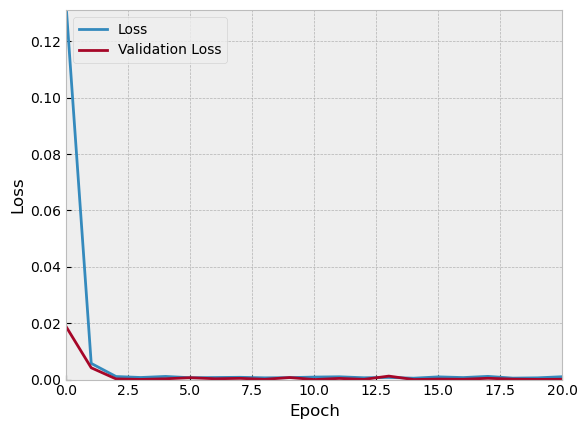

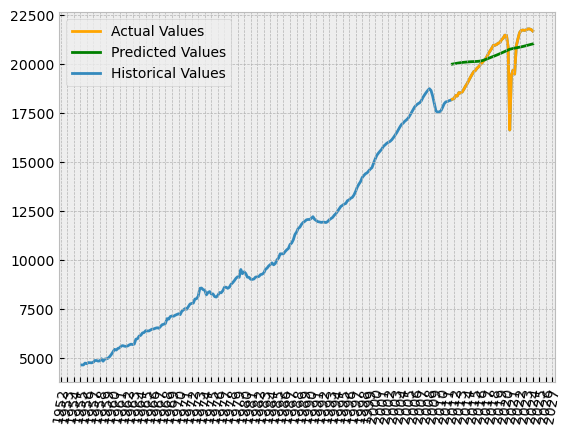

Epoch 1/50
20/20 [==============================] - 11s 169ms/step - loss: 0.1426 - val_loss: 4.8637e-04
Epoch 2/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0064 - val_loss: 6.6446e-04
Epoch 3/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0012 - val_loss: 6.1510e-04
Epoch 4/50
20/20 [==============================] - 1s 47ms/step - loss: 7.7164e-04 - val_loss: 2.5141e-04
Epoch 5/50
20/20 [==============================] - 1s 46ms/step - loss: 8.2190e-04 - val_loss: 2.3595e-04
Epoch 6/50
20/20 [==============================] - 1s 46ms/step - loss: 7.8565e-04 - val_loss: 4.0642e-04
Epoch 7/50
20/20 [==============================] - 1s 46ms/step - loss: 7.7496e-04 - val_loss: 8.8384e-04
Epoch 8/50
20/20 [==============================] - 1s 47ms/step - loss: 6.3554e-04 - val_loss: 7.8683e-06
Epoch 9/50
20/20 [==============================] - 1s 46ms/step - loss: 8.9636e-04 - val_loss: 5.4116e-04
Epoch 10/50
20/20 [============================

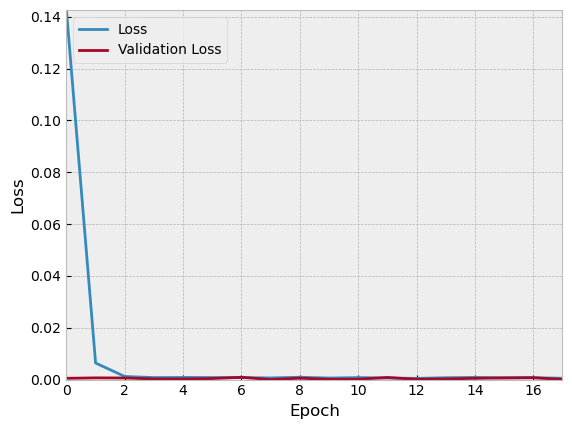

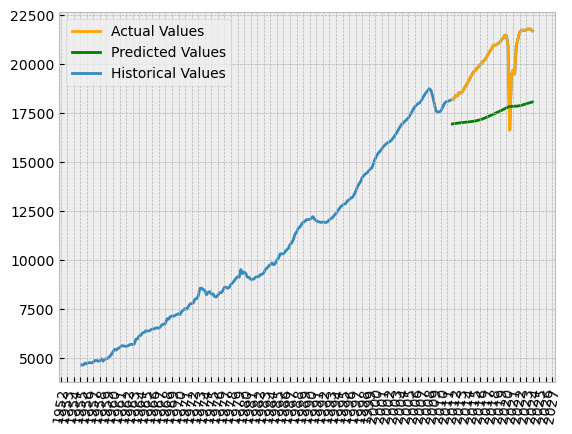

Epoch 1/50
20/20 [==============================] - 11s 161ms/step - loss: 0.1264 - val_loss: 0.0168
Epoch 2/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0063 - val_loss: 0.0051
Epoch 3/50
20/20 [==============================] - 1s 46ms/step - loss: 9.9625e-04 - val_loss: 7.1394e-05
Epoch 4/50
20/20 [==============================] - 1s 48ms/step - loss: 9.5702e-04 - val_loss: 2.0826e-05
Epoch 5/50
20/20 [==============================] - 1s 47ms/step - loss: 9.5103e-04 - val_loss: 1.9544e-04
Epoch 6/50
20/20 [==============================] - 1s 47ms/step - loss: 4.0935e-04 - val_loss: 1.4470e-05
Epoch 7/50
20/20 [==============================] - 1s 51ms/step - loss: 7.5165e-04 - val_loss: 3.1120e-04
Epoch 8/50
20/20 [==============================] - 1s 47ms/step - loss: 6.6044e-04 - val_loss: 2.0264e-04
Epoch 9/50
20/20 [==============================] - 1s 47ms/step - loss: 4.0067e-04 - val_loss: 8.9201e-05
Epoch 10/50
20/20 [==============================] 

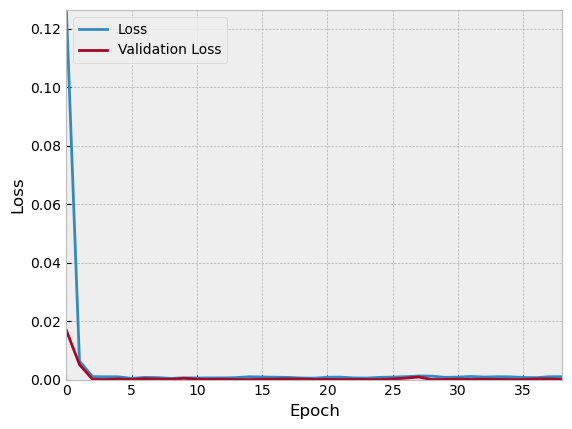

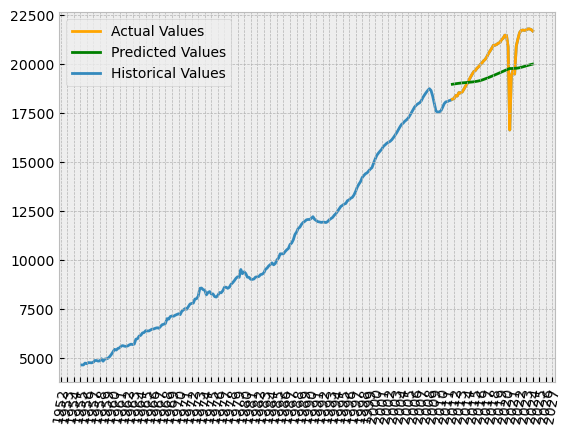

Epoch 1/50
20/20 [==============================] - 11s 171ms/step - loss: 0.0936 - val_loss: 0.0253
Epoch 2/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0058 - val_loss: 0.0010
Epoch 3/50
20/20 [==============================] - 1s 50ms/step - loss: 9.7974e-04 - val_loss: 1.5879e-05
Epoch 4/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0011 - val_loss: 2.6255e-04
Epoch 5/50
20/20 [==============================] - 1s 45ms/step - loss: 9.1222e-04 - val_loss: 4.6140e-04
Epoch 6/50
20/20 [==============================] - 1s 45ms/step - loss: 6.5318e-04 - val_loss: 1.5241e-05
Epoch 7/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0012 - val_loss: 9.3581e-04
Epoch 8/50
20/20 [==============================] - 1s 45ms/step - loss: 6.7315e-04 - val_loss: 2.7545e-04
Epoch 9/50
20/20 [==============================] - 1s 45ms/step - loss: 7.4160e-04 - val_loss: 9.1420e-05
Epoch 10/50
20/20 [==============================] - 1s 46m

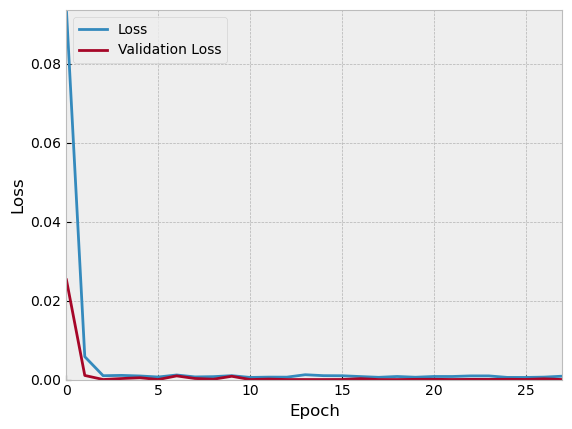

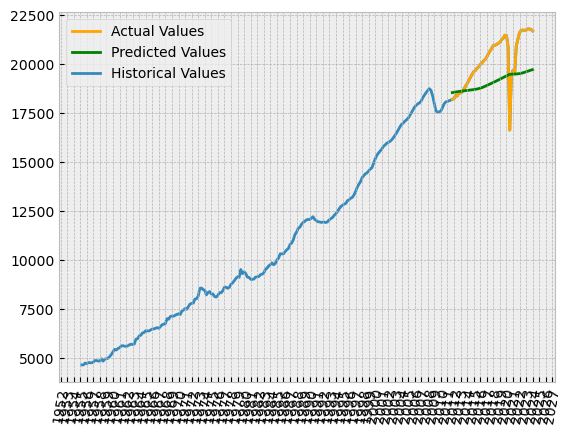

Epoch 1/50
20/20 [==============================] - 12s 161ms/step - loss: 0.1150 - val_loss: 0.0277
Epoch 2/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0061 - val_loss: 0.0028
Epoch 3/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0010 - val_loss: 1.0790e-04
Epoch 4/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0011 - val_loss: 6.0457e-06
Epoch 5/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0012 - val_loss: 7.2438e-06
Epoch 6/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0011 - val_loss: 2.4392e-04
Epoch 7/50
20/20 [==============================] - 1s 47ms/step - loss: 8.3541e-04 - val_loss: 5.1003e-04
Epoch 8/50
20/20 [==============================] - 1s 45ms/step - loss: 7.3729e-04 - val_loss: 1.7312e-05
Epoch 9/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0010 - val_loss: 5.5796e-04
Epoch 10/50
20/20 [==============================] - 1s 46ms/step - los

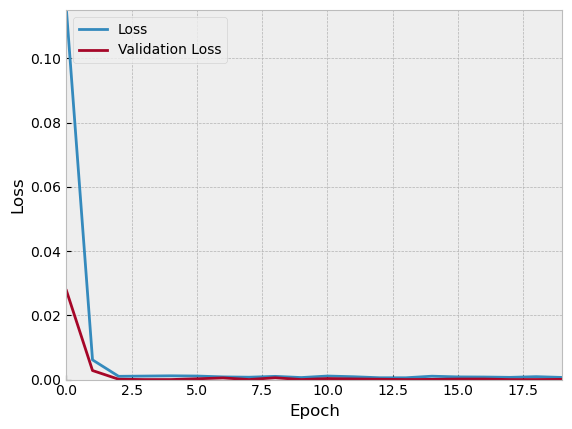

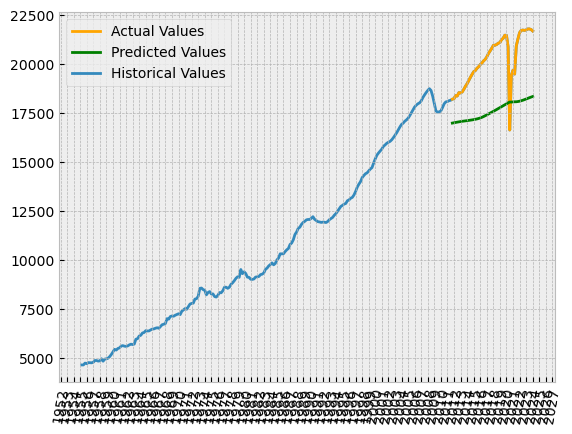

Epoch 1/50
20/20 [==============================] - 12s 164ms/step - loss: 0.1484 - val_loss: 0.0059
Epoch 2/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0063 - val_loss: 9.9535e-04
Epoch 3/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0021 - val_loss: 6.6133e-04
Epoch 4/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0017 - val_loss: 1.3450e-04
Epoch 5/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0013 - val_loss: 5.2157e-05
Epoch 6/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0012 - val_loss: 1.7092e-05
Epoch 7/50
20/20 [==============================] - 1s 44ms/step - loss: 8.4871e-04 - val_loss: 1.6306e-04
Epoch 8/50
20/20 [==============================] - 1s 45ms/step - loss: 6.7650e-04 - val_loss: 2.1338e-05
Epoch 9/50
20/20 [==============================] - 1s 44ms/step - loss: 9.6110e-04 - val_loss: 2.6535e-04
Epoch 10/50
20/20 [==============================] - 1s 45ms/st

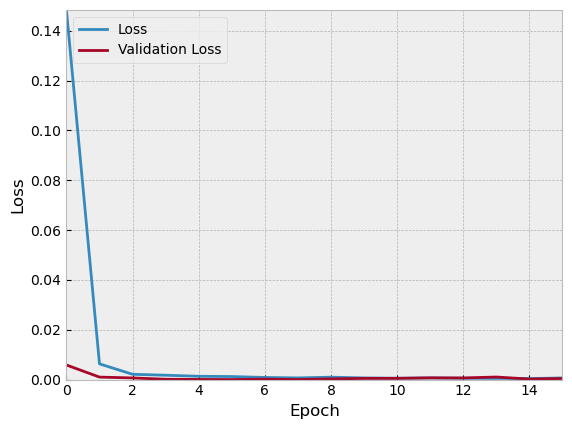

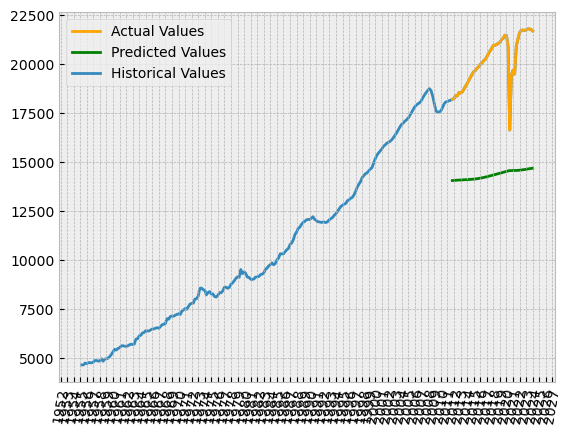

Epoch 1/50
20/20 [==============================] - 11s 160ms/step - loss: 0.1311 - val_loss: 0.0189
Epoch 2/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0063 - val_loss: 0.0041
Epoch 3/50
20/20 [==============================] - 1s 44ms/step - loss: 7.1055e-04 - val_loss: 5.8882e-05
Epoch 4/50
20/20 [==============================] - 1s 45ms/step - loss: 9.9368e-04 - val_loss: 6.9073e-05
Epoch 5/50
20/20 [==============================] - 1s 44ms/step - loss: 8.5153e-04 - val_loss: 6.4161e-04
Epoch 6/50
20/20 [==============================] - 1s 44ms/step - loss: 5.9244e-04 - val_loss: 7.7468e-05
Epoch 7/50
20/20 [==============================] - 1s 45ms/step - loss: 7.8271e-04 - val_loss: 2.5348e-05
Epoch 8/50
20/20 [==============================] - 1s 43ms/step - loss: 9.8975e-04 - val_loss: 0.0017
Epoch 9/50
20/20 [==============================] - 1s 44ms/step - loss: 5.7613e-04 - val_loss: 2.4656e-04
Epoch 10/50
20/20 [==============================] - 1s

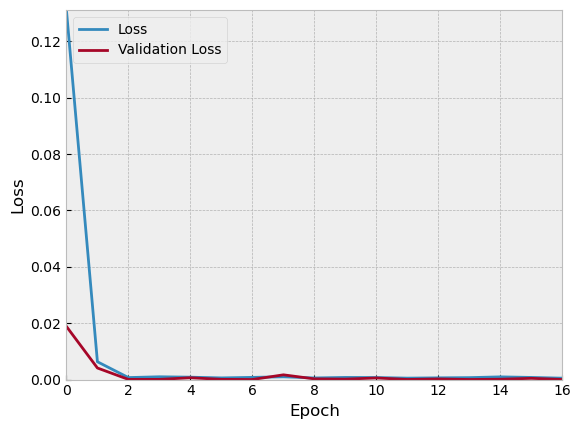

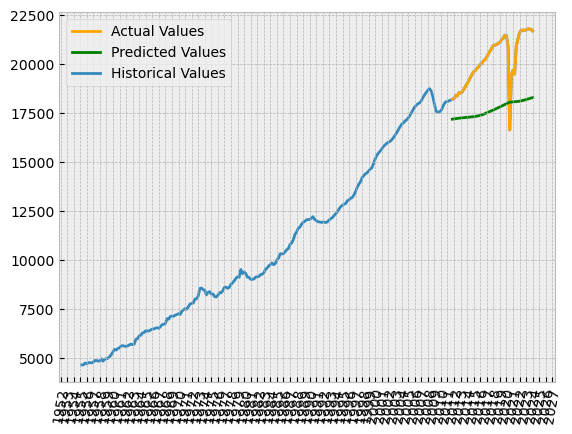

Epoch 1/50
20/20 [==============================] - 12s 171ms/step - loss: 0.1432 - val_loss: 0.0254
Epoch 2/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0055 - val_loss: 0.0034
Epoch 3/50
20/20 [==============================] - 1s 48ms/step - loss: 9.2640e-04 - val_loss: 2.3494e-04
Epoch 4/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0011 - val_loss: 1.9433e-04
Epoch 5/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0011 - val_loss: 3.6604e-05
Epoch 6/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0012 - val_loss: 4.9676e-04
Epoch 7/50
20/20 [==============================] - 1s 45ms/step - loss: 8.4653e-04 - val_loss: 3.9363e-04
Epoch 8/50
20/20 [==============================] - 1s 43ms/step - loss: 7.7151e-04 - val_loss: 1.8090e-04
Epoch 9/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0011 - val_loss: 1.3084e-04
Epoch 10/50
20/20 [==============================] - 1s 42ms/step -

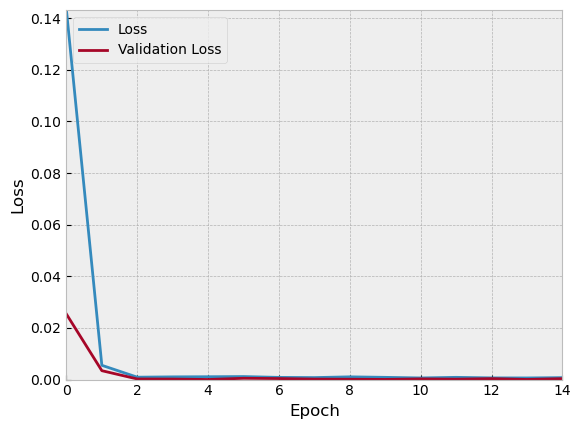

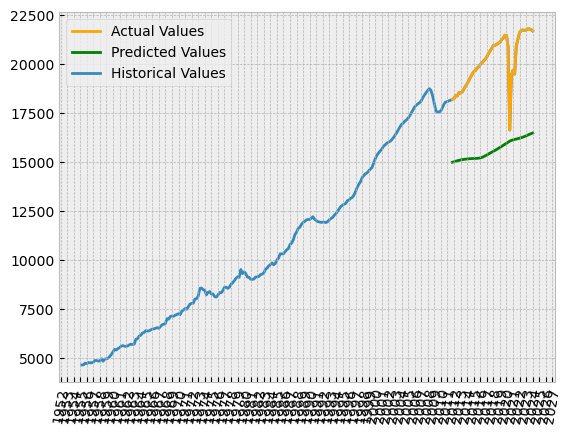

Epoch 1/50
20/20 [==============================] - 12s 160ms/step - loss: 0.1345 - val_loss: 0.0070
Epoch 2/50
20/20 [==============================] - 1s 42ms/step - loss: 0.0044 - val_loss: 0.0018
Epoch 3/50
20/20 [==============================] - 1s 42ms/step - loss: 5.1810e-04 - val_loss: 5.6171e-04
Epoch 4/50
20/20 [==============================] - 1s 42ms/step - loss: 5.0463e-04 - val_loss: 1.3838e-04
Epoch 5/50
20/20 [==============================] - 1s 42ms/step - loss: 7.4368e-04 - val_loss: 6.3877e-04
Epoch 6/50
20/20 [==============================] - 1s 42ms/step - loss: 4.1370e-04 - val_loss: 6.5859e-05
Epoch 7/50
20/20 [==============================] - 1s 42ms/step - loss: 6.0939e-04 - val_loss: 4.3832e-04
Epoch 8/50
20/20 [==============================] - 1s 44ms/step - loss: 5.1272e-04 - val_loss: 6.1325e-04
Epoch 9/50
20/20 [==============================] - 1s 44ms/step - loss: 4.3793e-04 - val_loss: 1.9086e-04
Epoch 10/50
20/20 [==============================] 

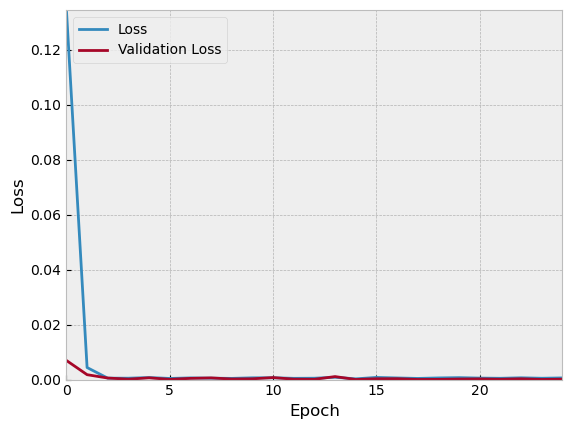

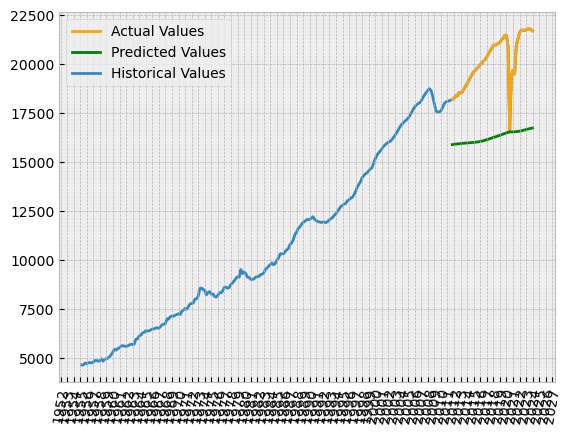

Epoch 1/50
20/20 [==============================] - 11s 161ms/step - loss: 0.1282 - val_loss: 0.0018
Epoch 2/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0048 - val_loss: 2.9399e-04
Epoch 3/50
20/20 [==============================] - 1s 44ms/step - loss: 9.8387e-04 - val_loss: 1.2870e-04
Epoch 4/50
20/20 [==============================] - 1s 41ms/step - loss: 5.7374e-04 - val_loss: 9.0975e-06
Epoch 5/50
20/20 [==============================] - 1s 41ms/step - loss: 7.9805e-04 - val_loss: 3.2342e-05
Epoch 6/50
20/20 [==============================] - 1s 42ms/step - loss: 8.3088e-04 - val_loss: 2.6362e-04
Epoch 7/50
20/20 [==============================] - 1s 43ms/step - loss: 8.2287e-04 - val_loss: 4.1067e-04
Epoch 8/50
20/20 [==============================] - 1s 43ms/step - loss: 4.7590e-04 - val_loss: 1.7205e-04
Epoch 9/50
20/20 [==============================] - 1s 46ms/step - loss: 7.1977e-04 - val_loss: 4.4541e-04
Epoch 10/50
20/20 [============================

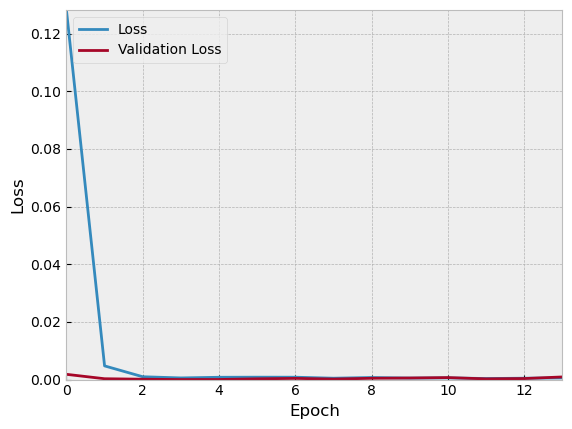

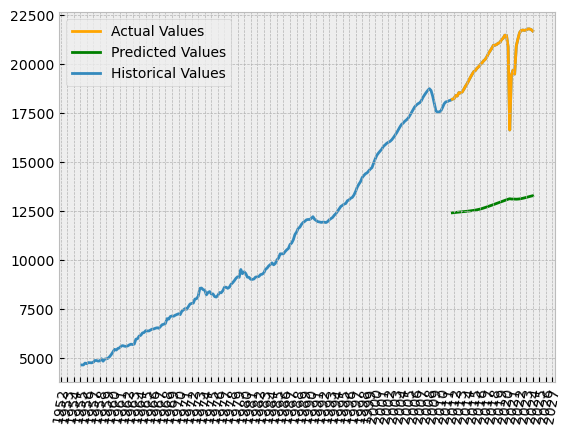

Epoch 1/50
20/20 [==============================] - 11s 161ms/step - loss: 0.0899 - val_loss: 0.0198
Epoch 2/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0015 - val_loss: 0.0018
Epoch 3/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0019 - val_loss: 7.4676e-05
Epoch 4/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0044 - val_loss: 0.0015
Epoch 5/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0026 - val_loss: 0.0017
Epoch 6/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0019 - val_loss: 0.0013
Epoch 7/50
20/20 [==============================] - 1s 42ms/step - loss: 0.0024 - val_loss: 0.0030
Epoch 8/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0016 - val_loss: 0.0012
Epoch 9/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0023 - val_loss: 0.0020
Epoch 10/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0023 - val_loss: 0.0028
Epo

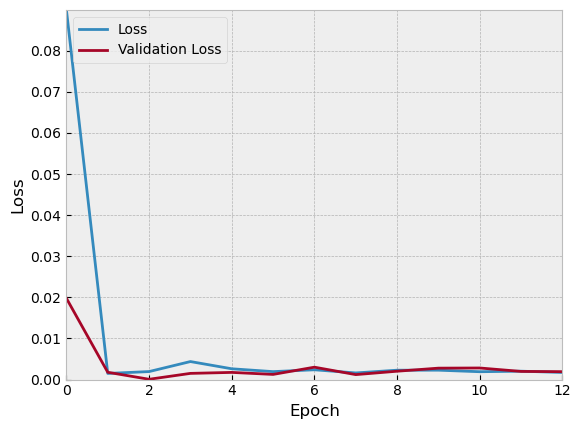

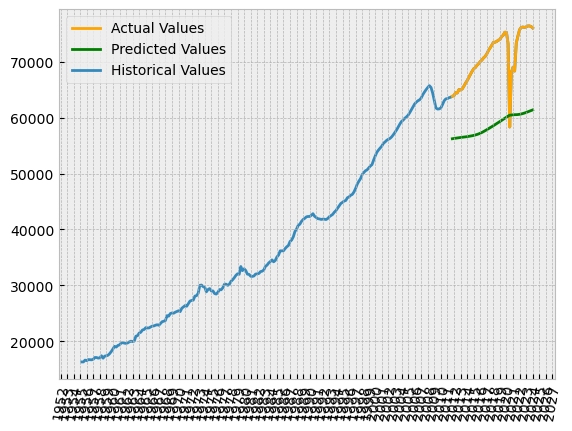

Epoch 1/50
20/20 [==============================] - 11s 157ms/step - loss: 0.1066 - val_loss: 0.0098
Epoch 2/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0030 - val_loss: 0.0013
Epoch 3/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0017 - val_loss: 1.1708e-04
Epoch 4/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0032 - val_loss: 1.6903e-04
Epoch 5/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0027 - val_loss: 1.4123e-04
Epoch 6/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0033 - val_loss: 4.1303e-04
Epoch 7/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0030 - val_loss: 0.0011
Epoch 8/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0023 - val_loss: 0.0021
Epoch 9/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0021 - val_loss: 0.0014
Epoch 10/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0020 - val_loss

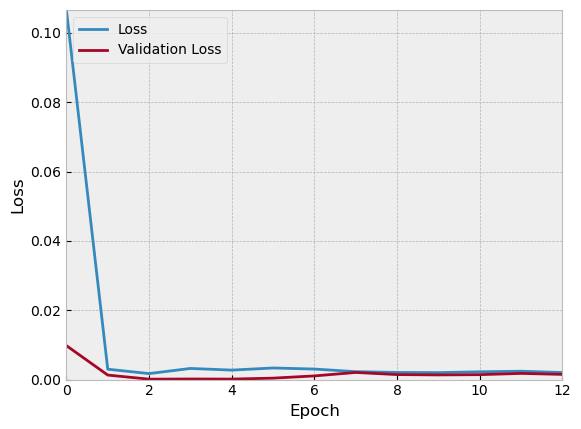

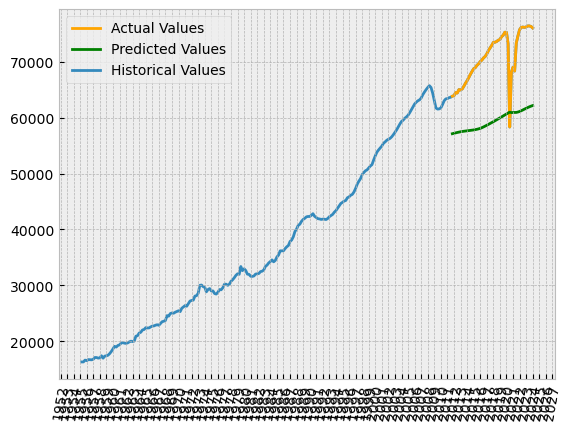

Epoch 1/50
20/20 [==============================] - 11s 165ms/step - loss: 0.1074 - val_loss: 0.0126
Epoch 2/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0021 - val_loss: 0.0016
Epoch 3/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0020 - val_loss: 7.4494e-05
Epoch 4/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0036 - val_loss: 2.4763e-04
Epoch 5/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0036 - val_loss: 0.0011
Epoch 6/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0020 - val_loss: 8.3864e-04
Epoch 7/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0027 - val_loss: 0.0015
Epoch 8/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0019 - val_loss: 0.0010
Epoch 9/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0025 - val_loss: 0.0015
Epoch 10/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0021 - val_loss: 0.

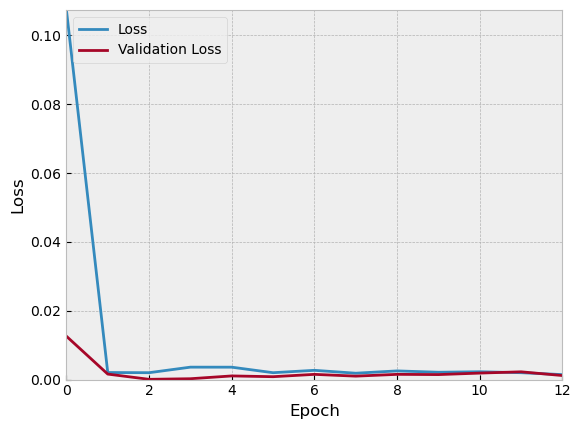

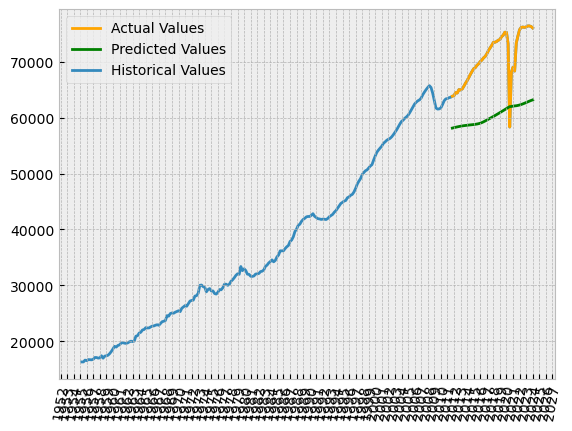

Epoch 1/50
20/20 [==============================] - 11s 156ms/step - loss: 0.0976 - val_loss: 0.0029
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0037 - val_loss: 2.8825e-04
Epoch 3/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0043 - val_loss: 1.4368e-04
Epoch 4/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0060 - val_loss: 9.3303e-05
Epoch 5/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0057 - val_loss: 8.4602e-05
Epoch 6/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0055 - val_loss: 8.7483e-05
Epoch 7/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0053 - val_loss: 9.1166e-05
Epoch 8/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0056 - val_loss: 9.6675e-05
Epoch 9/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0058 - val_loss: 1.0336e-04
Epoch 10/50
20/20 [==============================] - 1s 39ms/step - loss: 0

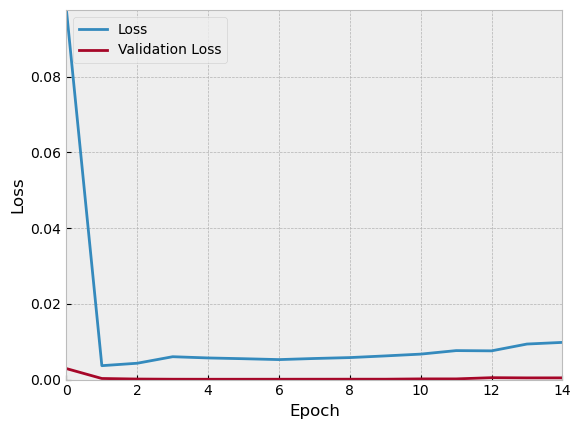

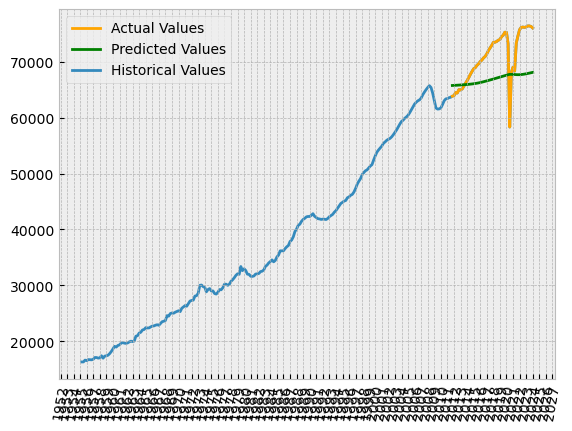

Epoch 1/50
20/20 [==============================] - 12s 161ms/step - loss: 0.1469 - val_loss: 0.0143
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0212 - val_loss: 5.7701e-04
Epoch 3/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0139 - val_loss: 0.0024
Epoch 4/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0077 - val_loss: 0.0028
Epoch 5/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0062 - val_loss: 9.4064e-04
Epoch 6/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0077 - val_loss: 5.0716e-04
Epoch 7/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0081 - val_loss: 2.9714e-04
Epoch 8/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0083 - val_loss: 3.4045e-04
Epoch 9/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0084 - val_loss: 4.5852e-04
Epoch 10/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0089 - 

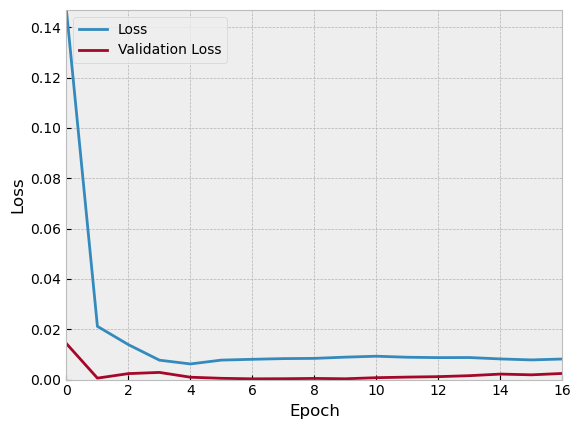

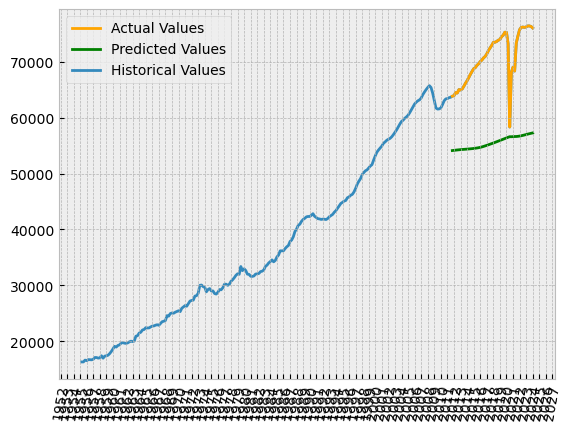

Epoch 1/50
20/20 [==============================] - 11s 156ms/step - loss: 0.0602 - val_loss: 0.0134
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 9.8656e-04 - val_loss: 2.0646e-04
Epoch 3/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0025 - val_loss: 1.4375e-04
Epoch 4/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0030 - val_loss: 0.0012
Epoch 5/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0015 - val_loss: 7.3112e-04
Epoch 6/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0019 - val_loss: 0.0021
Epoch 7/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0016 - val_loss: 0.0014
Epoch 8/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0024 - val_loss: 0.0024
Epoch 9/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0015 - val_loss: 9.6303e-04
Epoch 10/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0021 - val_

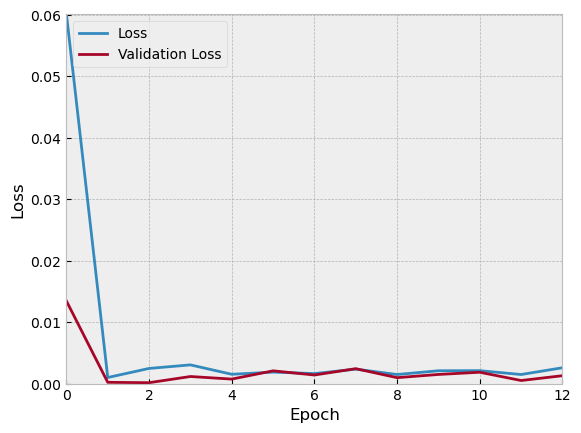

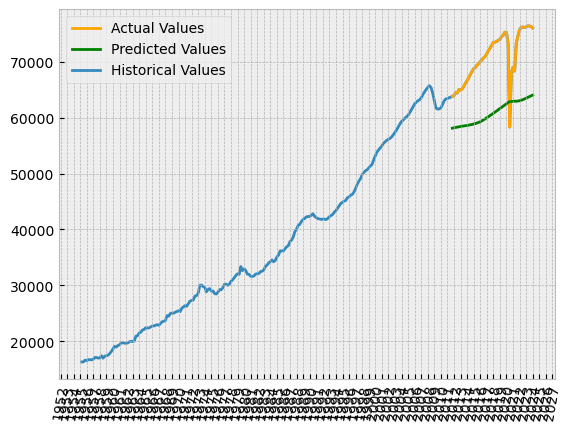

Epoch 1/50
20/20 [==============================] - 11s 158ms/step - loss: 0.0986 - val_loss: 0.0202
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0017 - val_loss: 0.0018
Epoch 3/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0027 - val_loss: 2.3451e-04
Epoch 4/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0037 - val_loss: 5.1500e-04
Epoch 5/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0025 - val_loss: 7.8243e-04
Epoch 6/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0029 - val_loss: 0.0012
Epoch 7/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0024 - val_loss: 7.3191e-04
Epoch 8/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0026 - val_loss: 8.1300e-04
Epoch 9/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0027 - val_loss: 0.0012
Epoch 10/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0029 - val_

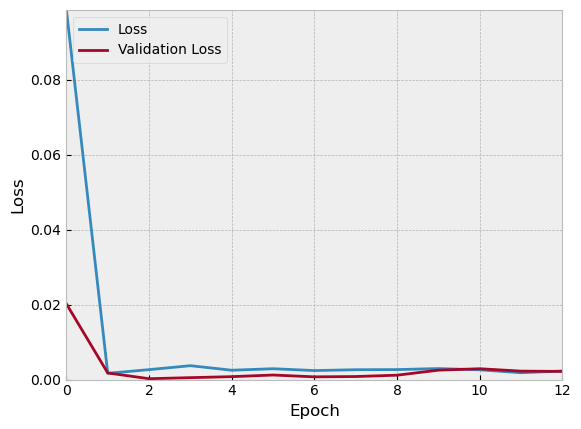

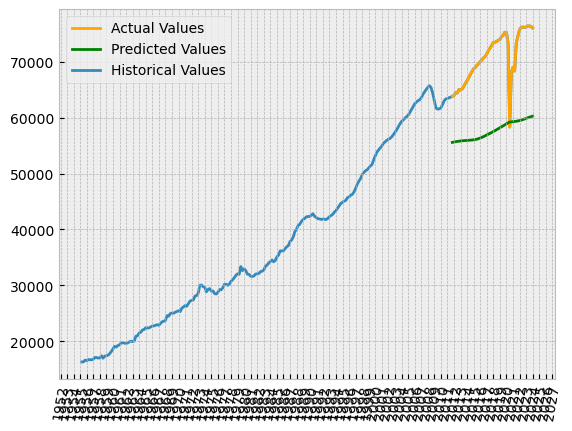

Epoch 1/50
20/20 [==============================] - 12s 153ms/step - loss: 0.1373 - val_loss: 0.0031
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0094 - val_loss: 0.0015
Epoch 3/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0092 - val_loss: 4.7870e-04
Epoch 4/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0081 - val_loss: 3.4073e-04
Epoch 5/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0083 - val_loss: 3.8933e-04
Epoch 6/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0082 - val_loss: 4.1773e-04
Epoch 7/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0081 - val_loss: 3.0039e-04
Epoch 8/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0084 - val_loss: 3.6700e-04
Epoch 9/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0077 - val_loss: 3.2342e-04
Epoch 10/50
20/20 [==============================] - 1s 37ms/step - loss: 0.008

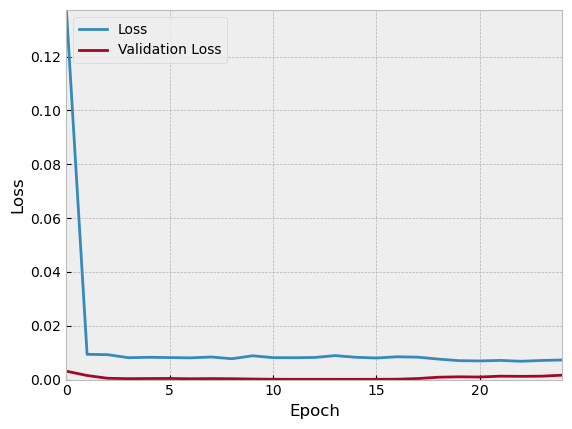

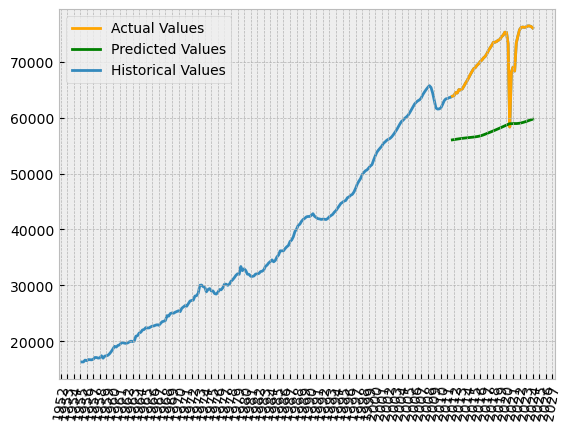

Epoch 1/50
20/20 [==============================] - 12s 163ms/step - loss: 0.0925 - val_loss: 0.0173
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0018 - val_loss: 0.0016
Epoch 3/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0017 - val_loss: 6.8057e-05
Epoch 4/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0040 - val_loss: 3.1034e-04
Epoch 5/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0029 - val_loss: 8.2742e-04
Epoch 6/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0027 - val_loss: 0.0011
Epoch 7/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0021 - val_loss: 0.0015
Epoch 8/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0018 - val_loss: 0.0012
Epoch 9/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0020 - val_loss: 0.0014
Epoch 10/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0023 - val_loss: 0.

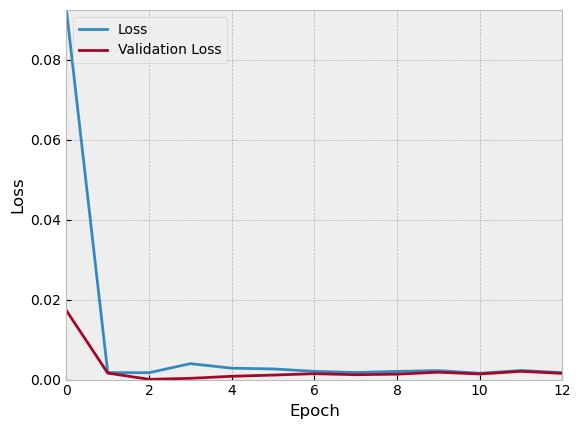

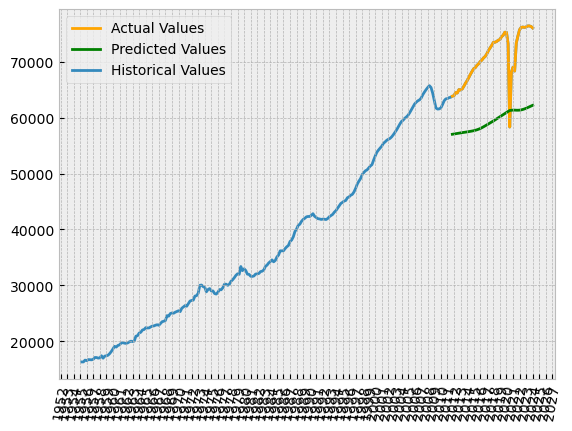

Epoch 1/50
20/20 [==============================] - 11s 158ms/step - loss: 0.0693 - val_loss: 0.0211
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0012 - val_loss: 8.6599e-04
Epoch 3/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0031 - val_loss: 2.0300e-04
Epoch 4/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0046 - val_loss: 3.8037e-04
Epoch 5/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0032 - val_loss: 0.0019
Epoch 6/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0021 - val_loss: 0.0019
Epoch 7/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0016 - val_loss: 0.0015
Epoch 8/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0023 - val_loss: 0.0020
Epoch 9/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0020 - val_loss: 0.0019
Epoch 10/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0021 - val_loss: 0.

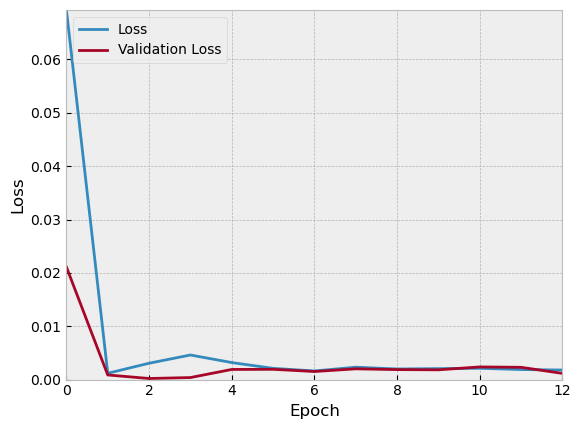

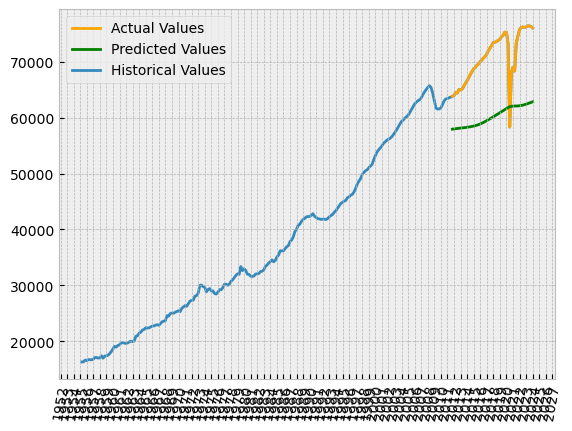

Epoch 1/50
20/20 [==============================] - 11s 158ms/step - loss: 0.1057 - val_loss: 0.0250
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0039 - val_loss: 0.0022
Epoch 3/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0014 - val_loss: 2.5631e-05
Epoch 4/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0016 - val_loss: 5.9370e-04
Epoch 5/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0010 - val_loss: 3.6244e-04
Epoch 6/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0013 - val_loss: 4.9902e-04
Epoch 7/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0013 - val_loss: 7.5421e-04
Epoch 8/50
20/20 [==============================] - 1s 38ms/step - loss: 9.1913e-04 - val_loss: 0.0012
Epoch 9/50
20/20 [==============================] - 1s 38ms/step - loss: 7.7133e-04 - val_loss: 5.5203e-04
Epoch 10/50
20/20 [==============================] - 1s 38ms/step - loss: 0

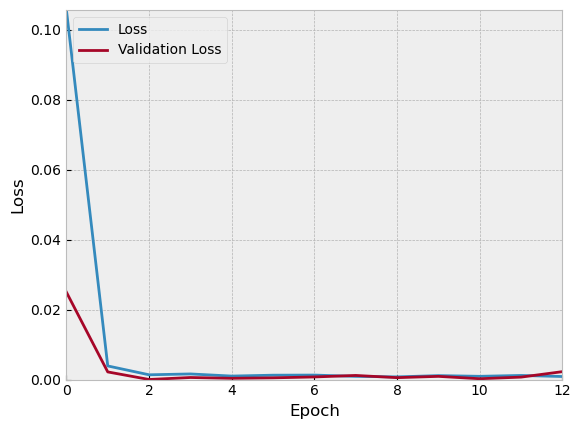

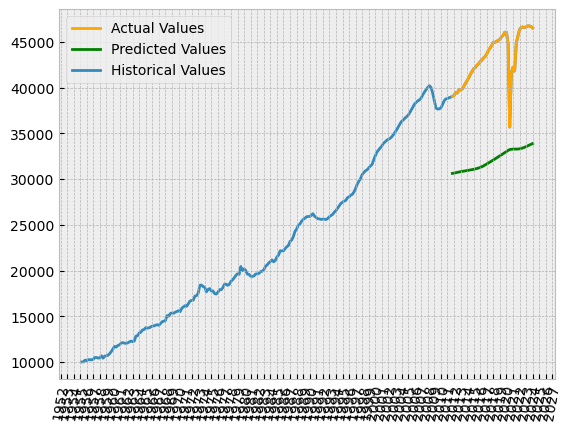

Epoch 1/50
20/20 [==============================] - 12s 173ms/step - loss: 0.0862 - val_loss: 0.0235
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0032 - val_loss: 3.3942e-04
Epoch 3/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0020 - val_loss: 2.9306e-05
Epoch 4/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0020 - val_loss: 7.7617e-04
Epoch 5/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0011 - val_loss: 2.9504e-04
Epoch 6/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0014 - val_loss: 6.7605e-04
Epoch 7/50
20/20 [==============================] - 1s 38ms/step - loss: 8.4781e-04 - val_loss: 8.3772e-04
Epoch 8/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0011 - val_loss: 7.3052e-04
Epoch 9/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0011 - val_loss: 9.9641e-04
Epoch 10/50
20/20 [==============================] - 1s 38ms/step - los

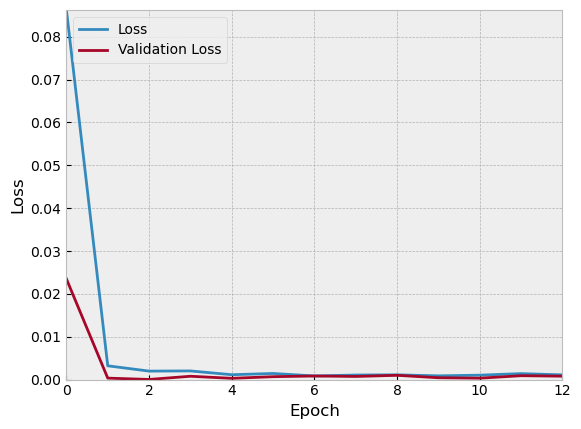

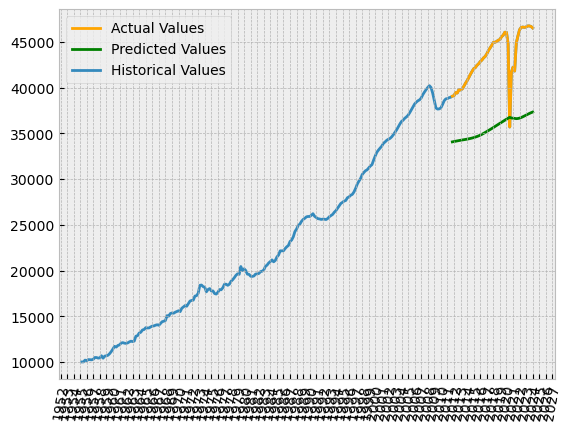

Epoch 1/50
20/20 [==============================] - 11s 157ms/step - loss: 0.1104 - val_loss: 0.0055
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0030 - val_loss: 0.0014
Epoch 3/50
20/20 [==============================] - 1s 38ms/step - loss: 9.1276e-04 - val_loss: 3.2483e-05
Epoch 4/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0017 - val_loss: 3.6664e-05
Epoch 5/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0018 - val_loss: 5.2752e-04
Epoch 6/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0014 - val_loss: 0.0014
Epoch 7/50
20/20 [==============================] - 1s 39ms/step - loss: 8.1668e-04 - val_loss: 5.8938e-04
Epoch 8/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0013 - val_loss: 8.8939e-04
Epoch 9/50
20/20 [==============================] - 1s 38ms/step - loss: 8.7533e-04 - val_loss: 5.6076e-04
Epoch 10/50
20/20 [==============================] - 1s 38ms/step - los

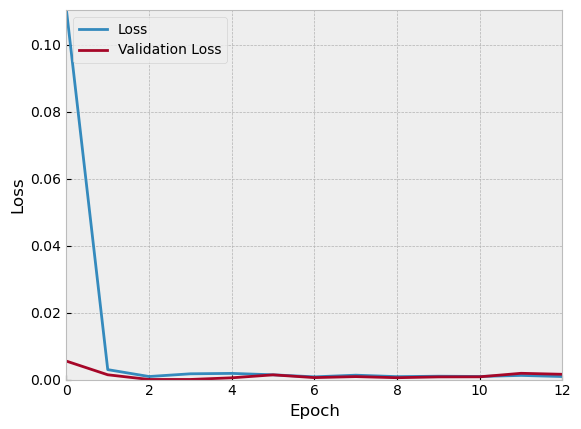

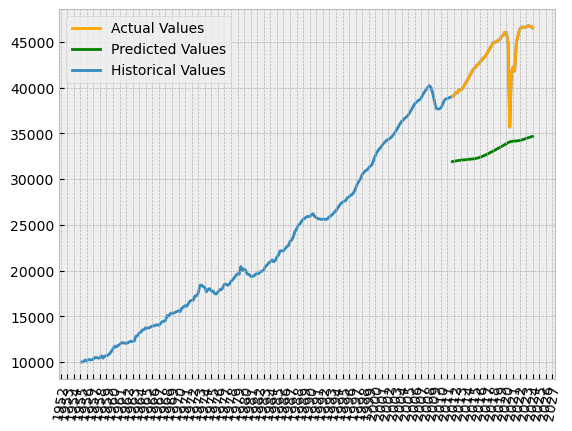

Epoch 1/50
20/20 [==============================] - 11s 160ms/step - loss: 0.1072 - val_loss: 0.0173
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0024 - val_loss: 0.0014
Epoch 3/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0014 - val_loss: 1.6907e-04
Epoch 4/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0019 - val_loss: 5.1115e-04
Epoch 5/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0016 - val_loss: 0.0012
Epoch 6/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0013 - val_loss: 5.6204e-04
Epoch 7/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0017 - val_loss: 0.0013
Epoch 8/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0012 - val_loss: 0.0015
Epoch 9/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0010 - val_loss: 0.0017
Epoch 10/50
20/20 [==============================] - 1s 39ms/step - loss: 9.5241e-04 - val_loss

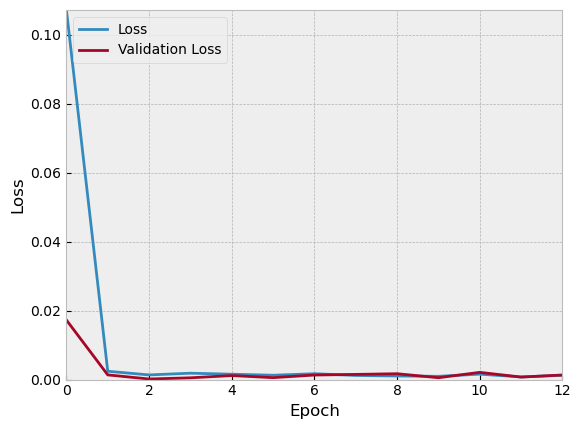

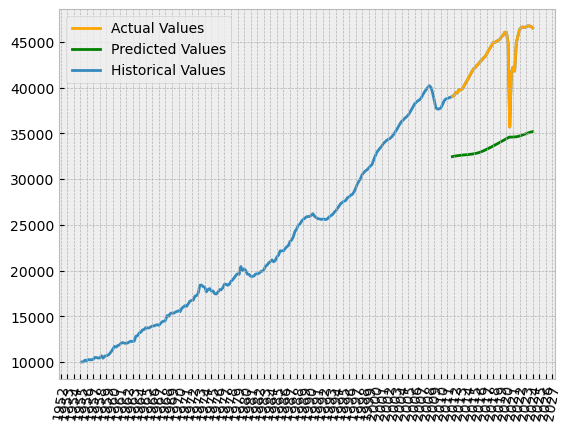

Epoch 1/50
20/20 [==============================] - 11s 157ms/step - loss: 0.1364 - val_loss: 0.0022
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0047 - val_loss: 8.9837e-04
Epoch 3/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0014 - val_loss: 3.7339e-04
Epoch 4/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0015 - val_loss: 1.6348e-04
Epoch 5/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0020 - val_loss: 2.3507e-04
Epoch 6/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0015 - val_loss: 8.5354e-04
Epoch 7/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0013 - val_loss: 0.0014
Epoch 8/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 9/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0012 - val_loss: 0.0014
Epoch 10/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0012 - val_

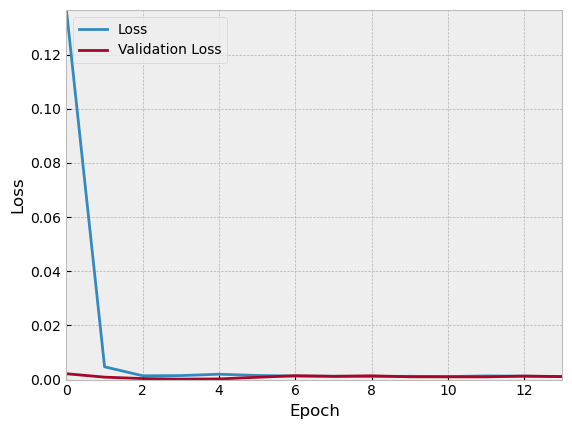

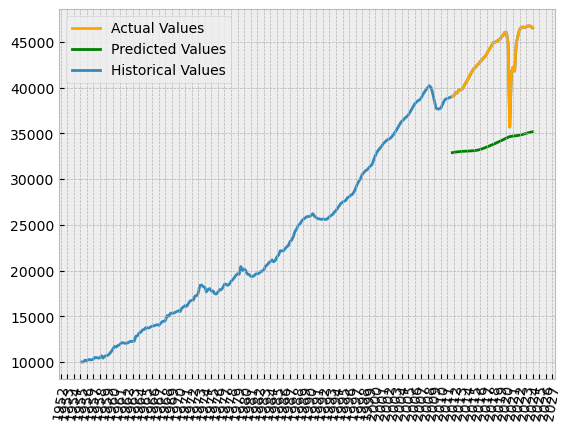

Epoch 1/50
20/20 [==============================] - 11s 153ms/step - loss: 0.1087 - val_loss: 0.0297
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0045 - val_loss: 0.0021
Epoch 3/50
20/20 [==============================] - 1s 34ms/step - loss: 9.7981e-04 - val_loss: 9.3411e-05
Epoch 4/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0014 - val_loss: 5.4092e-04
Epoch 5/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0011 - val_loss: 2.1612e-04
Epoch 6/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0012 - val_loss: 4.7296e-04
Epoch 7/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0012 - val_loss: 6.1701e-04
Epoch 8/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0015 - val_loss: 0.0011
Epoch 9/50
20/20 [==============================] - 1s 34ms/step - loss: 7.9291e-04 - val_loss: 2.4372e-04
Epoch 10/50
20/20 [==============================] - 1s 34ms/step - loss: 8

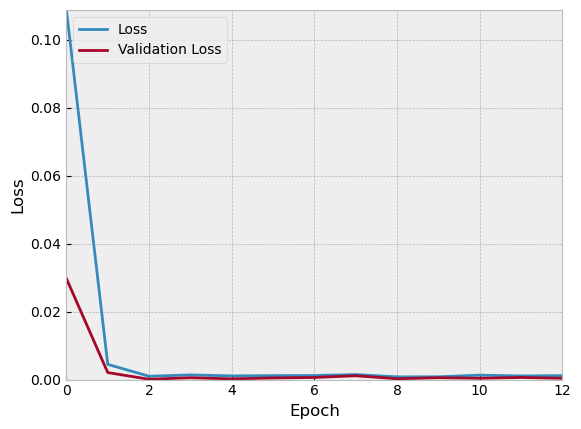

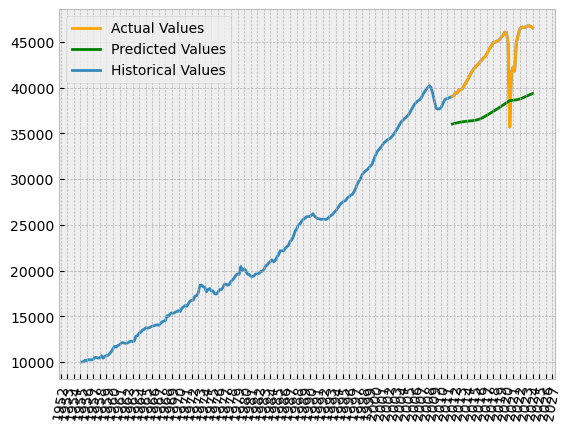

Epoch 1/50
20/20 [==============================] - 12s 153ms/step - loss: 0.0879 - val_loss: 0.0195
Epoch 2/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0022 - val_loss: 0.0016
Epoch 3/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0011 - val_loss: 5.8791e-05
Epoch 4/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0020 - val_loss: 1.7731e-04
Epoch 5/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0016 - val_loss: 7.9070e-04
Epoch 6/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0016 - val_loss: 0.0020
Epoch 7/50
20/20 [==============================] - 1s 34ms/step - loss: 8.6744e-04 - val_loss: 7.0055e-04
Epoch 8/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0013 - val_loss: 9.8579e-04
Epoch 9/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0013 - val_loss: 0.0017
Epoch 10/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0011 - 

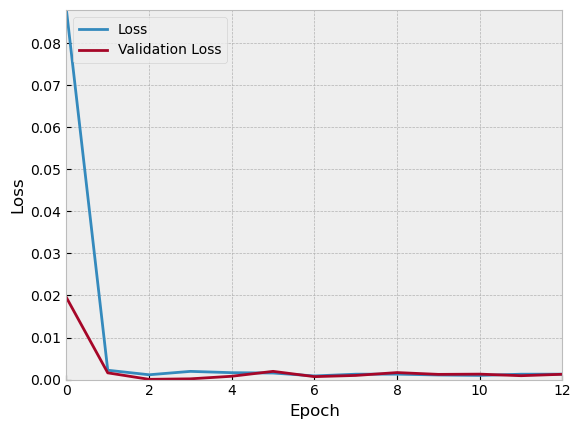

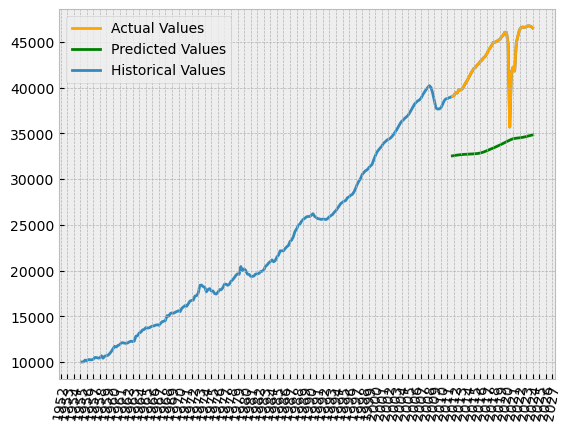

Epoch 1/50
20/20 [==============================] - 11s 151ms/step - loss: 0.0956 - val_loss: 0.0188
Epoch 2/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0031 - val_loss: 0.0037
Epoch 3/50
20/20 [==============================] - 1s 31ms/step - loss: 5.7395e-04 - val_loss: 3.7167e-04
Epoch 4/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0011 - val_loss: 2.3441e-04
Epoch 5/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0013 - val_loss: 8.7937e-04
Epoch 6/50
20/20 [==============================] - 1s 35ms/step - loss: 9.0641e-04 - val_loss: 0.0012
Epoch 7/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0011 - val_loss: 6.8265e-04
Epoch 8/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0011 - val_loss: 0.0018
Epoch 9/50
20/20 [==============================] - 1s 35ms/step - loss: 6.3413e-04 - val_loss: 8.3449e-04
Epoch 10/50
20/20 [==============================] - 1s 32ms/step - loss: 8

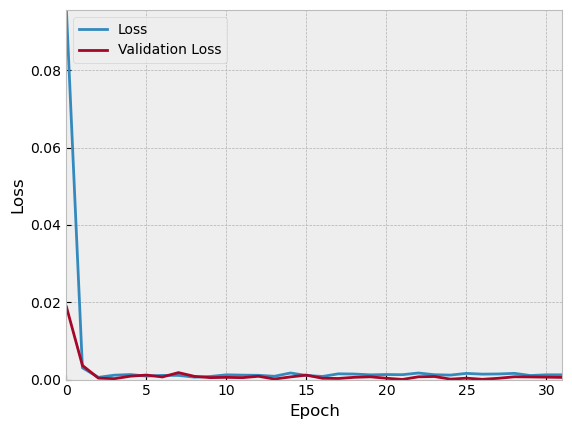

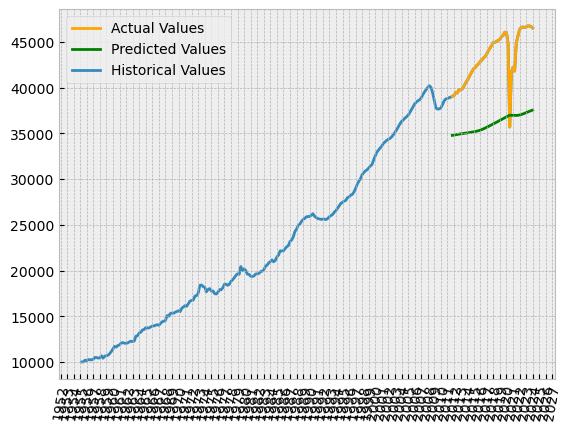

Epoch 1/50
20/20 [==============================] - 11s 153ms/step - loss: 0.1536 - val_loss: 3.2143e-04
Epoch 2/50
20/20 [==============================] - 1s 31ms/step - loss: 0.0065 - val_loss: 4.2944e-05
Epoch 3/50
20/20 [==============================] - 1s 31ms/step - loss: 0.0019 - val_loss: 3.6459e-05
Epoch 4/50
20/20 [==============================] - 1s 31ms/step - loss: 0.0020 - val_loss: 4.1698e-05
Epoch 5/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0021 - val_loss: 1.4189e-04
Epoch 6/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0015 - val_loss: 8.6767e-04
Epoch 7/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0012 - val_loss: 0.0013
Epoch 8/50
20/20 [==============================] - 1s 33ms/step - loss: 9.2000e-04 - val_loss: 4.6505e-04
Epoch 9/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0013 - val_loss: 0.0012
Epoch 10/50
20/20 [==============================] - 1s 32ms/step - loss: 9

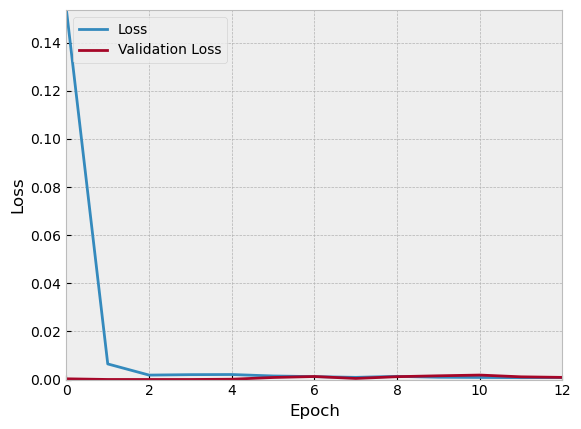

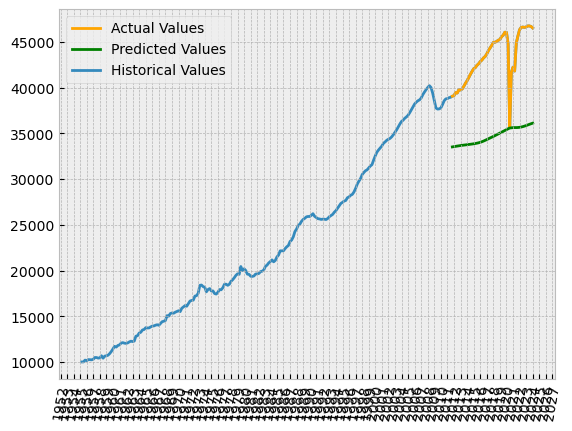

Epoch 1/50
20/20 [==============================] - 11s 155ms/step - loss: 0.0943 - val_loss: 0.0101
Epoch 2/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0025 - val_loss: 0.0019
Epoch 3/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0010 - val_loss: 3.0374e-04
Epoch 4/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0020 - val_loss: 4.9720e-04
Epoch 5/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0017 - val_loss: 0.0010
Epoch 6/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 7/50
20/20 [==============================] - 1s 31ms/step - loss: 0.0013 - val_loss: 0.0024
Epoch 8/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0010 - val_loss: 0.0014
Epoch 9/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0013 - val_loss: 0.0012
Epoch 10/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0013 - val_loss: 0.0019

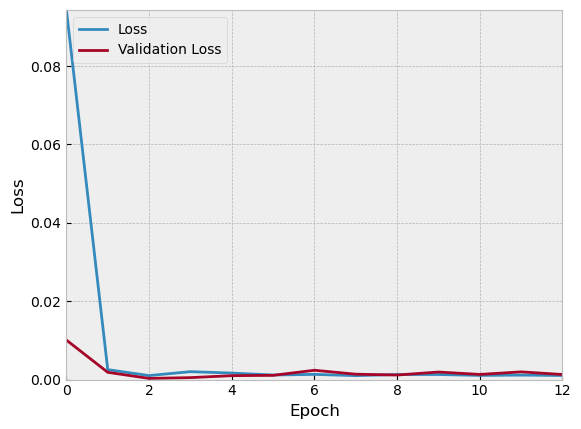

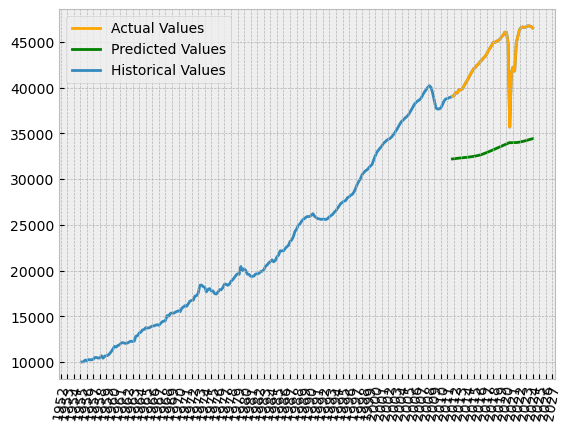

Epoch 1/50
20/20 [==============================] - 12s 159ms/step - loss: 0.1695 - val_loss: 0.0018
Epoch 2/50
20/20 [==============================] - 1s 31ms/step - loss: 0.0068 - val_loss: 2.7923e-06
Epoch 3/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0013 - val_loss: 1.0614e-05
Epoch 4/50
20/20 [==============================] - 1s 30ms/step - loss: 5.9552e-04 - val_loss: 1.3217e-04
Epoch 5/50
20/20 [==============================] - 1s 30ms/step - loss: 4.1256e-04 - val_loss: 3.5406e-05
Epoch 6/50
20/20 [==============================] - 1s 30ms/step - loss: 4.4516e-04 - val_loss: 1.6141e-04
Epoch 7/50
20/20 [==============================] - 1s 29ms/step - loss: 4.8212e-04 - val_loss: 2.2423e-04
Epoch 8/50
20/20 [==============================] - 1s 30ms/step - loss: 3.6762e-04 - val_loss: 9.7316e-05
Epoch 9/50
20/20 [==============================] - 1s 29ms/step - loss: 4.8654e-04 - val_loss: 4.4849e-04
Epoch 10/50
20/20 [==============================] 

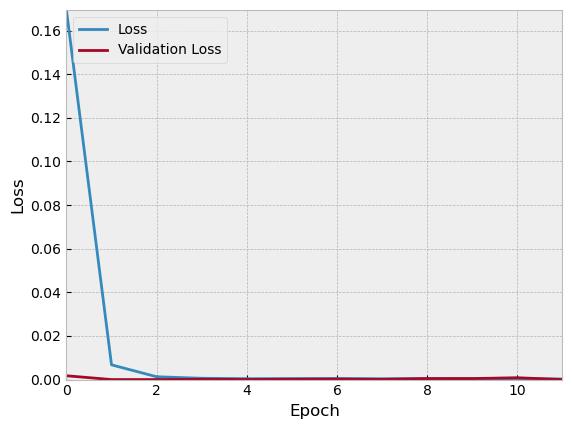

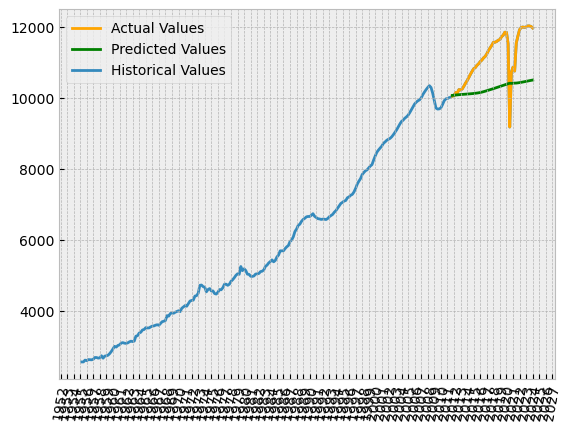

Epoch 1/50
20/20 [==============================] - 11s 149ms/step - loss: 0.0884 - val_loss: 0.0142
Epoch 2/50
20/20 [==============================] - 1s 28ms/step - loss: 0.0045 - val_loss: 5.9641e-05
Epoch 3/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0020 - val_loss: 2.0422e-06
Epoch 4/50
20/20 [==============================] - 1s 29ms/step - loss: 7.9466e-04 - val_loss: 9.5441e-05
Epoch 5/50
20/20 [==============================] - 1s 29ms/step - loss: 8.8860e-04 - val_loss: 8.3348e-05
Epoch 6/50
20/20 [==============================] - 1s 28ms/step - loss: 8.5263e-04 - val_loss: 1.3061e-04
Epoch 7/50
20/20 [==============================] - 1s 30ms/step - loss: 0.0010 - val_loss: 2.3486e-04
Epoch 8/50
20/20 [==============================] - 1s 31ms/step - loss: 9.7650e-04 - val_loss: 1.4717e-04
Epoch 9/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0010 - val_loss: 0.0011
Epoch 10/50
20/20 [==============================] - 1s 28ms/st

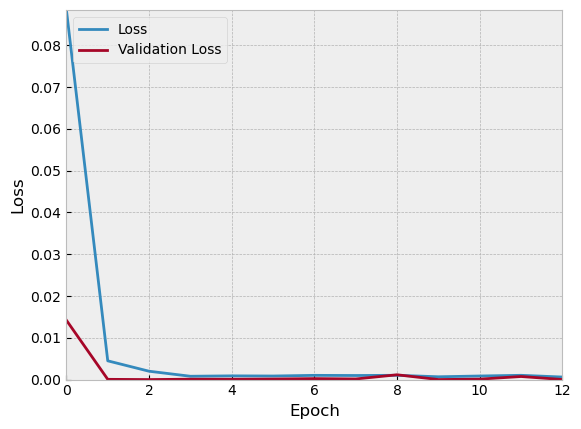

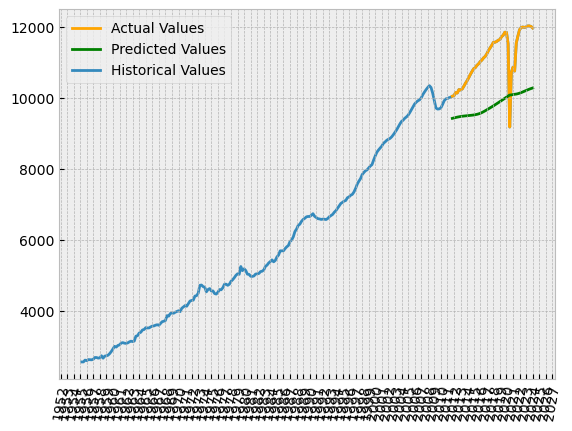

Epoch 1/50
20/20 [==============================] - 12s 152ms/step - loss: 0.1205 - val_loss: 0.0231
Epoch 2/50
20/20 [==============================] - 1s 27ms/step - loss: 0.0056 - val_loss: 0.0028
Epoch 3/50
20/20 [==============================] - 1s 27ms/step - loss: 0.0012 - val_loss: 3.5680e-06
Epoch 4/50
20/20 [==============================] - 1s 27ms/step - loss: 0.0014 - val_loss: 3.3774e-04
Epoch 5/50
20/20 [==============================] - 1s 27ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 6/50
20/20 [==============================] - 1s 27ms/step - loss: 7.4603e-04 - val_loss: 6.3427e-05
Epoch 7/50
20/20 [==============================] - 1s 28ms/step - loss: 7.6781e-04 - val_loss: 2.1417e-05
Epoch 8/50
20/20 [==============================] - 1s 28ms/step - loss: 8.1377e-04 - val_loss: 1.4849e-05
Epoch 9/50
20/20 [==============================] - 1s 29ms/step - loss: 7.7641e-04 - val_loss: 1.0479e-05
Epoch 10/50
20/20 [==============================] - 1s 28ms/step -

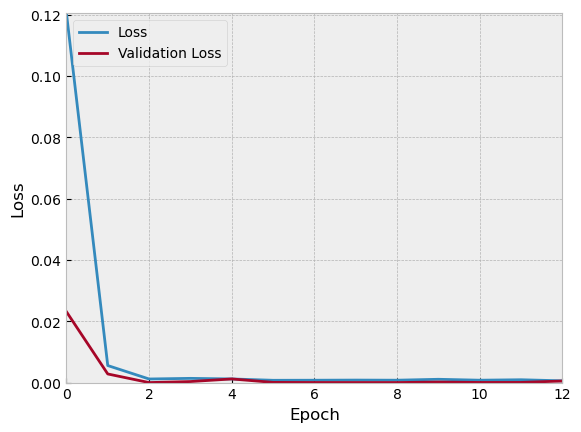

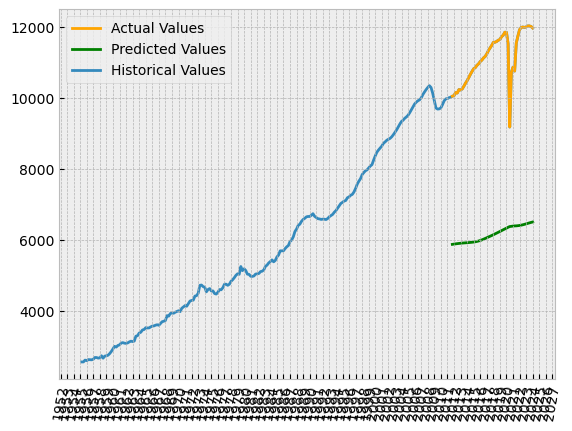

Epoch 1/50
20/20 [==============================] - 11s 148ms/step - loss: 0.1013 - val_loss: 0.0242
Epoch 2/50
20/20 [==============================] - 1s 25ms/step - loss: 0.0058 - val_loss: 0.0023
Epoch 3/50
20/20 [==============================] - 0s 25ms/step - loss: 7.5547e-04 - val_loss: 1.1772e-04
Epoch 4/50
20/20 [==============================] - 0s 25ms/step - loss: 6.2869e-04 - val_loss: 3.7672e-05
Epoch 5/50
20/20 [==============================] - 0s 25ms/step - loss: 8.7090e-04 - val_loss: 1.8975e-04
Epoch 6/50
20/20 [==============================] - 1s 25ms/step - loss: 6.2293e-04 - val_loss: 2.4160e-04
Epoch 7/50
20/20 [==============================] - 0s 25ms/step - loss: 5.5760e-04 - val_loss: 2.4005e-05
Epoch 8/50
20/20 [==============================] - 0s 25ms/step - loss: 7.9826e-04 - val_loss: 8.2509e-05
Epoch 9/50
20/20 [==============================] - 1s 26ms/step - loss: 5.5929e-04 - val_loss: 4.5020e-04
Epoch 10/50
20/20 [==============================] 

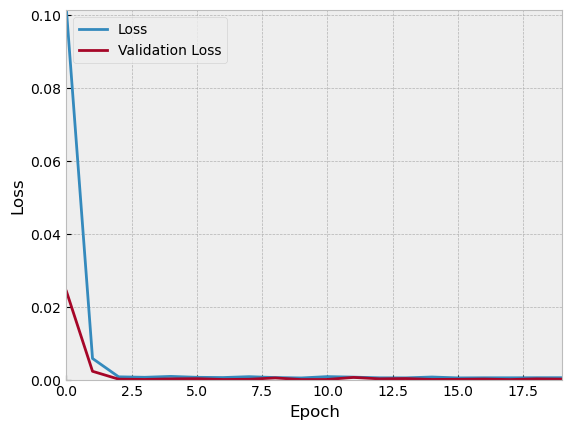

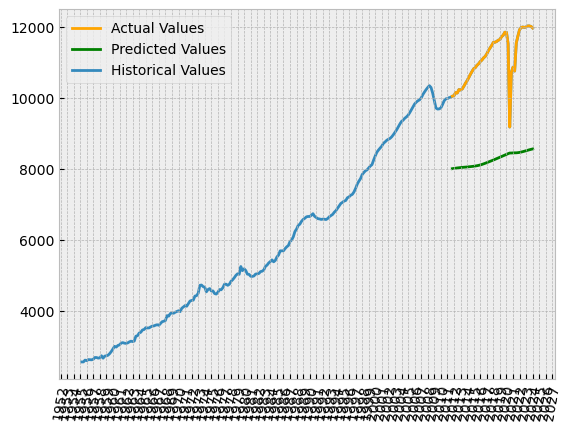

Epoch 1/50
20/20 [==============================] - 11s 145ms/step - loss: 0.0971 - val_loss: 0.0222
Epoch 2/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0056 - val_loss: 1.7357e-05
Epoch 3/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0015 - val_loss: 4.8012e-04
Epoch 4/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0013 - val_loss: 6.8869e-06
Epoch 5/50
20/20 [==============================] - 1s 26ms/step - loss: 8.3511e-04 - val_loss: 2.1007e-04
Epoch 6/50
20/20 [==============================] - 1s 26ms/step - loss: 7.8011e-04 - val_loss: 9.5596e-05
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 6.2621e-04 - val_loss: 1.2539e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 6.8135e-04 - val_loss: 2.3820e-05
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 9.0480e-04 - val_loss: 1.5871e-04
Epoch 10/50
20/20 [==============================] - 0s

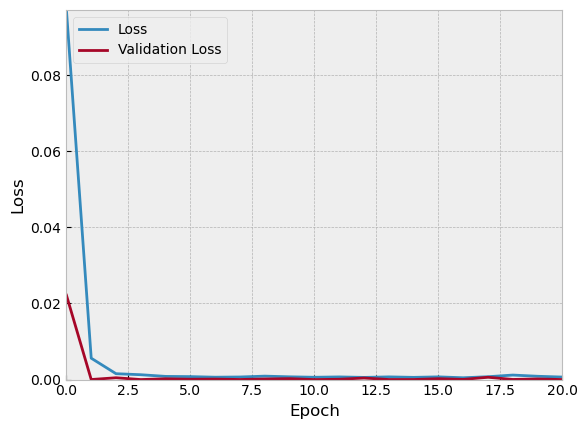

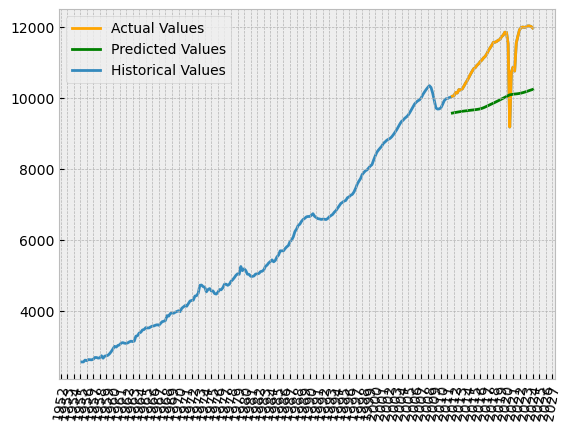

Epoch 1/50
20/20 [==============================] - 11s 142ms/step - loss: 0.1048 - val_loss: 0.0211
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0061 - val_loss: 0.0033
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 9.2682e-04 - val_loss: 2.6662e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 6.6322e-04 - val_loss: 3.5225e-05
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 7.5297e-04 - val_loss: 3.0648e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 6.4720e-04 - val_loss: 1.4286e-05
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 8.2971e-04 - val_loss: 3.0277e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 6.0727e-04 - val_loss: 5.7463e-05
Epoch 9/50
20/20 [==============================] - 0s 24ms/step - loss: 5.1505e-04 - val_loss: 9.4220e-06
Epoch 10/50
20/20 [==============================] 

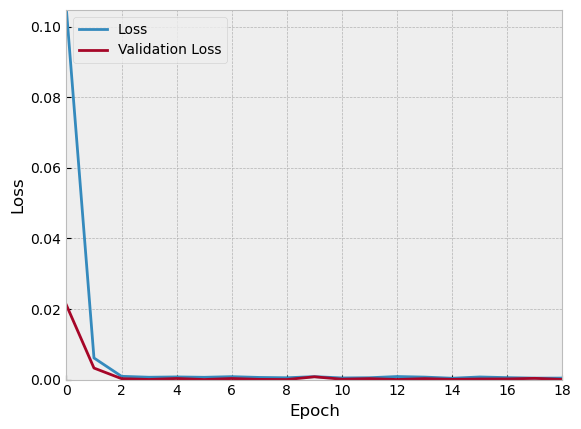

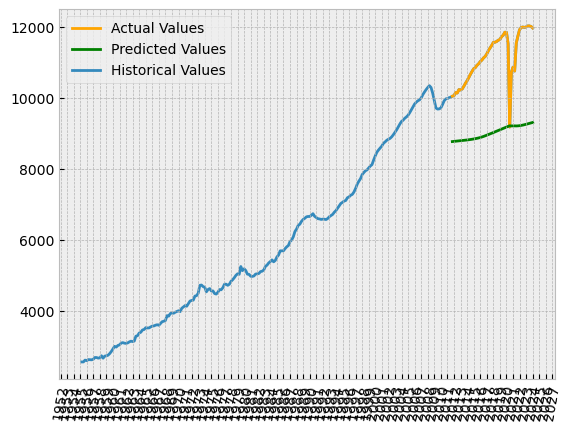

Epoch 1/50
20/20 [==============================] - 11s 147ms/step - loss: 0.1532 - val_loss: 0.0066
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0062 - val_loss: 0.0018
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 8.2149e-04 - val_loss: 1.6308e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 4.8559e-04 - val_loss: 1.2305e-04
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 5.5391e-04 - val_loss: 1.1152e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 4.9257e-04 - val_loss: 1.4432e-04
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 5.5119e-04 - val_loss: 1.6217e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 5.9637e-04 - val_loss: 1.4529e-04
Epoch 9/50
20/20 [==============================] - 0s 24ms/step - loss: 5.6057e-04 - val_loss: 1.6445e-04
Epoch 10/50
20/20 [==============================] 

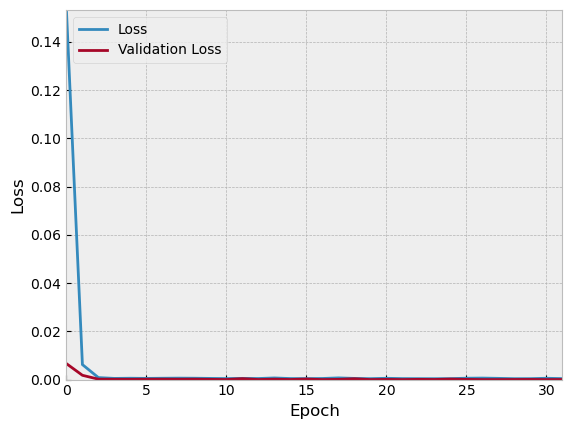

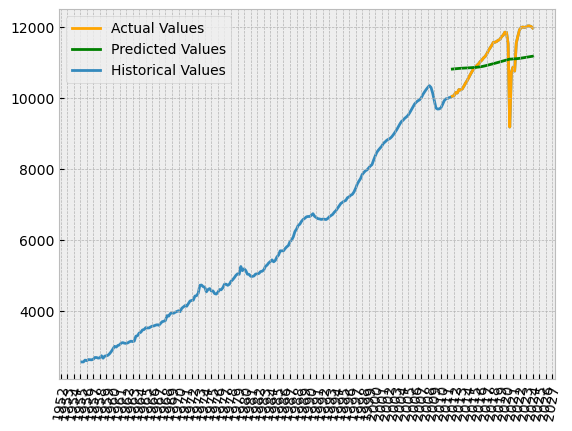

Epoch 1/50
20/20 [==============================] - 11s 150ms/step - loss: 0.1178 - val_loss: 0.0154
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0062 - val_loss: 0.0028
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 7.8734e-04 - val_loss: 1.6366e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 5.4167e-04 - val_loss: 4.0156e-04
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 4.5947e-04 - val_loss: 2.2257e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 4.7588e-04 - val_loss: 8.4944e-05
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 4.5103e-04 - val_loss: 1.5197e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 4.3354e-04 - val_loss: 6.9512e-05
Epoch 9/50
20/20 [==============================] - 0s 25ms/step - loss: 4.6478e-04 - val_loss: 3.7123e-04
Epoch 10/50
20/20 [==============================] 

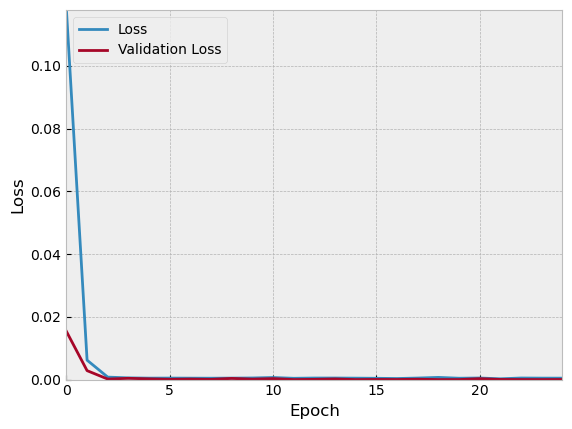

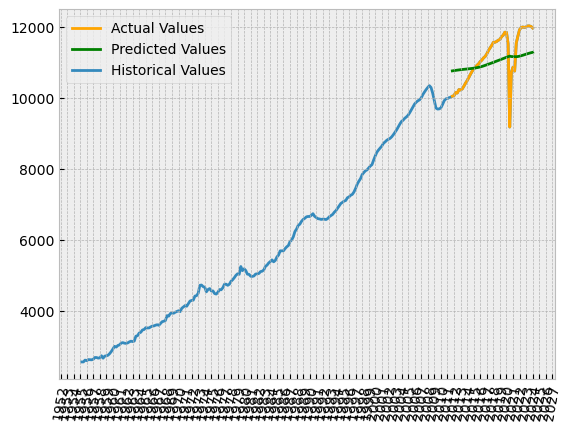

Epoch 1/50
20/20 [==============================] - 12s 152ms/step - loss: 0.1244 - val_loss: 0.0106
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0054 - val_loss: 0.0023
Epoch 3/50
20/20 [==============================] - 0s 24ms/step - loss: 7.7346e-04 - val_loss: 7.8521e-04
Epoch 4/50
20/20 [==============================] - 1s 27ms/step - loss: 3.8718e-04 - val_loss: 1.7965e-05
Epoch 5/50
20/20 [==============================] - 1s 26ms/step - loss: 5.3154e-04 - val_loss: 5.3058e-06
Epoch 6/50
20/20 [==============================] - 0s 25ms/step - loss: 7.2539e-04 - val_loss: 2.7688e-04
Epoch 7/50
20/20 [==============================] - 0s 24ms/step - loss: 3.8500e-04 - val_loss: 3.9194e-05
Epoch 8/50
20/20 [==============================] - 0s 25ms/step - loss: 5.6029e-04 - val_loss: 6.2237e-05
Epoch 9/50
20/20 [==============================] - 0s 25ms/step - loss: 5.0747e-04 - val_loss: 2.7600e-04
Epoch 10/50
20/20 [==============================] 

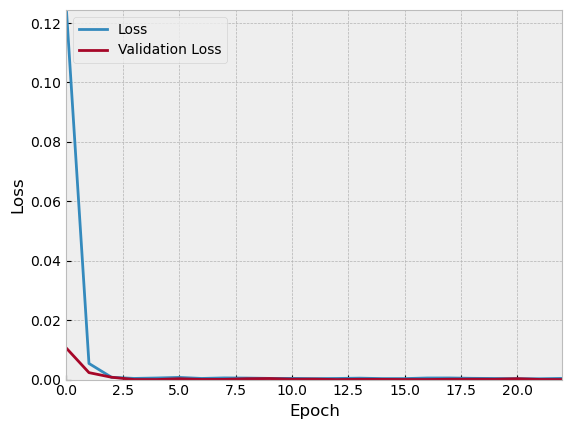

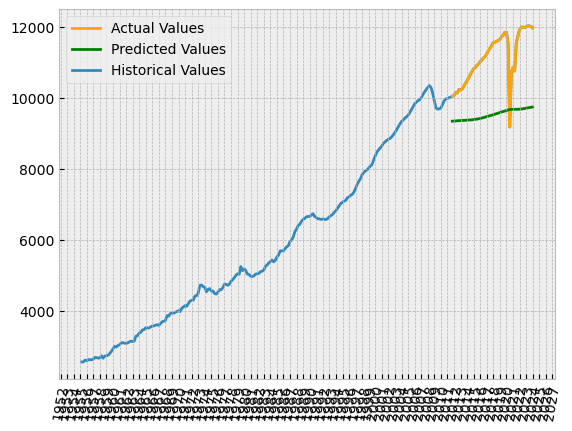

Epoch 1/50
20/20 [==============================] - 11s 149ms/step - loss: 0.1031 - val_loss: 0.0158
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0051 - val_loss: 0.0032
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 8.0504e-04 - val_loss: 1.6676e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 6.5794e-04 - val_loss: 1.0421e-04
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 6.2092e-04 - val_loss: 2.7676e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 5.3565e-04 - val_loss: 1.4584e-04
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 6.0359e-04 - val_loss: 2.3924e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 6.3002e-04 - val_loss: 8.9251e-04
Epoch 9/50
20/20 [==============================] - 0s 24ms/step - loss: 3.9052e-04 - val_loss: 6.1573e-04
Epoch 10/50
20/20 [==============================] 

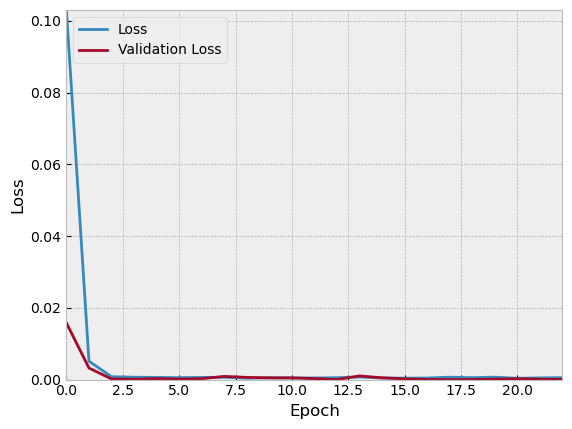

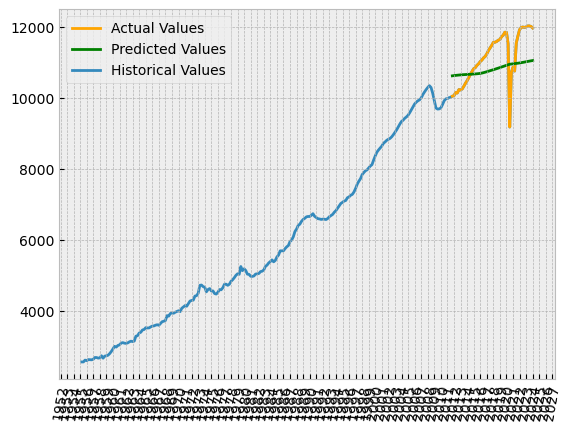

Epoch 1/50
20/20 [==============================] - 11s 152ms/step - loss: 0.1015 - val_loss: 0.0103
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0022 - val_loss: 0.0013
Epoch 3/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0026 - val_loss: 8.4996e-05
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0049 - val_loss: 1.2452e-04
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0043 - val_loss: 6.8155e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0034 - val_loss: 9.8381e-04
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0032 - val_loss: 7.8846e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0036 - val_loss: 6.6354e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0040 - val_loss: 0.0010
Epoch 10/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0033 - 

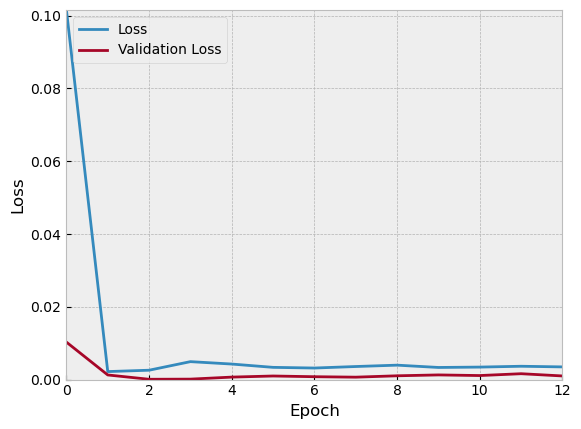

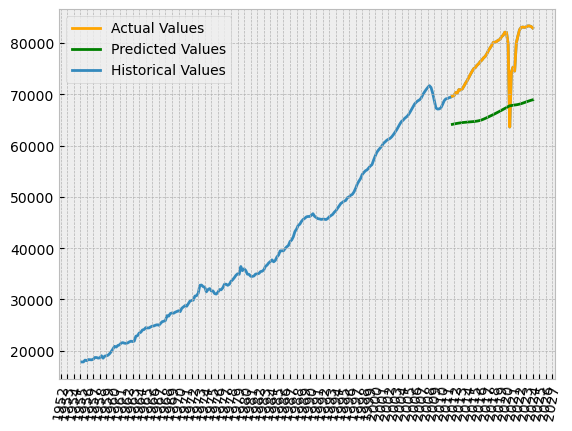

Epoch 1/50
20/20 [==============================] - 76s 182ms/step - loss: 0.1051 - val_loss: 0.0046
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0034 - val_loss: 2.5938e-04
Epoch 3/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0042 - val_loss: 1.4283e-04
Epoch 4/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0056 - val_loss: 1.5360e-04
Epoch 5/50
20/20 [==============================] - 1s 64ms/step - loss: 0.0064 - val_loss: 1.7415e-04
Epoch 6/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0056 - val_loss: 1.2750e-04
Epoch 7/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0054 - val_loss: 9.3114e-05
Epoch 8/50
20/20 [==============================] - 1s 60ms/step - loss: 0.0060 - val_loss: 1.4944e-04
Epoch 9/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0064 - val_loss: 1.6442e-04
Epoch 10/50
20/20 [==============================] - 1s 59ms/step - loss: 0

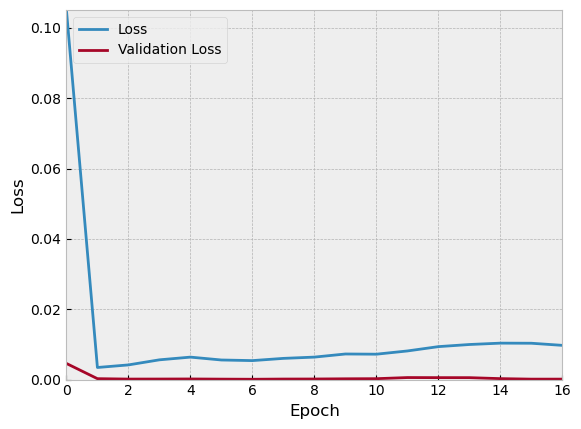

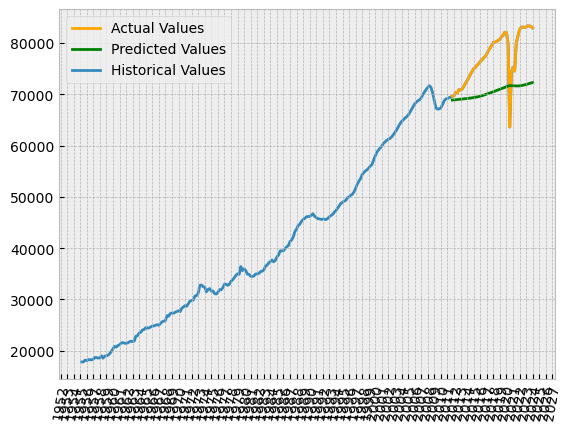

Epoch 1/50
20/20 [==============================] - 13s 206ms/step - loss: 0.0810 - val_loss: 0.0180
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0012 - val_loss: 0.0014
Epoch 3/50
20/20 [==============================] - 1s 65ms/step - loss: 0.0023 - val_loss: 2.5414e-04
Epoch 4/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0029 - val_loss: 3.7745e-04
Epoch 5/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0030 - val_loss: 0.0010
Epoch 6/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0022 - val_loss: 0.0013
Epoch 7/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0024 - val_loss: 0.0016
Epoch 8/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0025 - val_loss: 0.0015
Epoch 9/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0027 - val_loss: 0.0025
Epoch 10/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0020 - val_loss: 0.0019

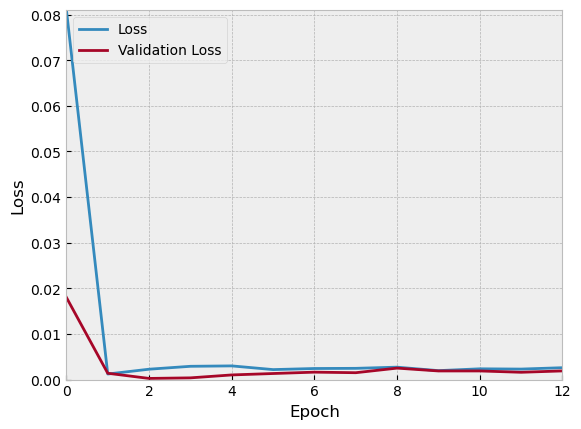

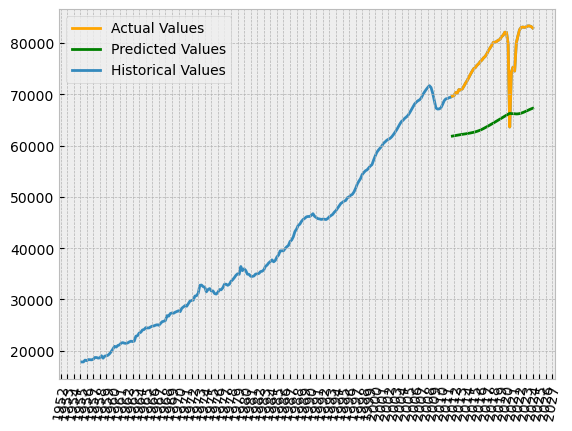

Epoch 1/50
20/20 [==============================] - 12s 185ms/step - loss: 0.1047 - val_loss: 1.7541e-04
Epoch 2/50
20/20 [==============================] - 1s 62ms/step - loss: 0.0052 - val_loss: 1.1093e-04
Epoch 3/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0059 - val_loss: 1.3214e-04
Epoch 4/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0062 - val_loss: 3.3743e-04
Epoch 5/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0072 - val_loss: 2.6819e-04
Epoch 6/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0073 - val_loss: 3.8224e-04
Epoch 7/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0079 - val_loss: 9.5258e-04
Epoch 8/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0098 - val_loss: 6.6267e-04
Epoch 9/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0095 - val_loss: 4.5572e-04
Epoch 10/50
20/20 [==============================] - 1s 56ms/step - los

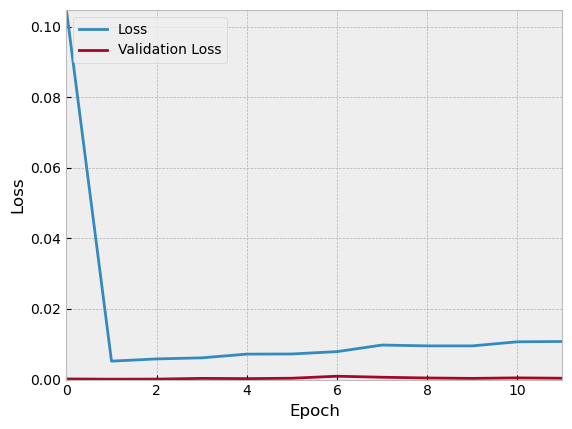

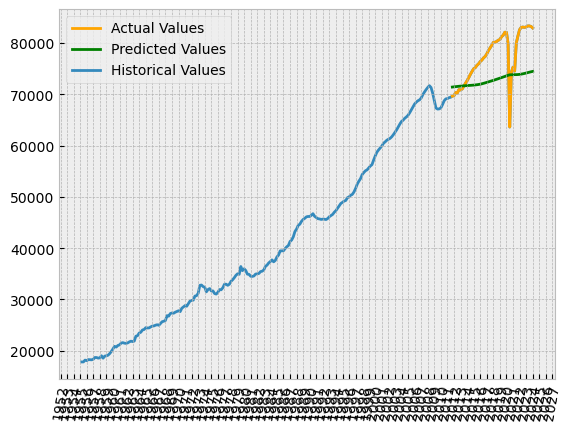

Epoch 1/50
20/20 [==============================] - 12s 180ms/step - loss: 0.0983 - val_loss: 0.0046
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0029 - val_loss: 7.4943e-04
Epoch 3/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0039 - val_loss: 9.0453e-05
Epoch 4/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0064 - val_loss: 9.8938e-05
Epoch 5/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0053 - val_loss: 1.2280e-04
Epoch 6/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0063 - val_loss: 1.8021e-04
Epoch 7/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0072 - val_loss: 1.5570e-04
Epoch 8/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0071 - val_loss: 2.4377e-04
Epoch 9/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0073 - val_loss: 1.3059e-04
Epoch 10/50
20/20 [==============================] - 1s 55ms/step - loss: 0

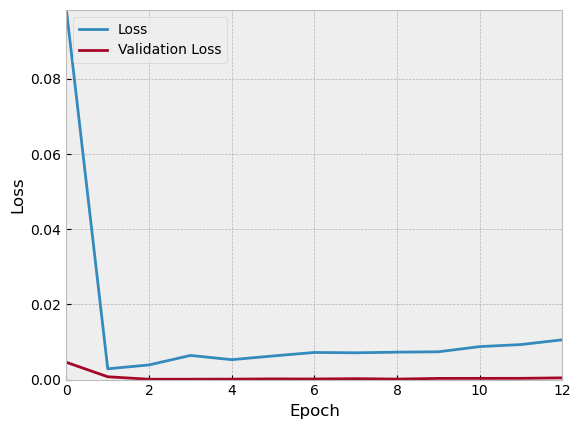

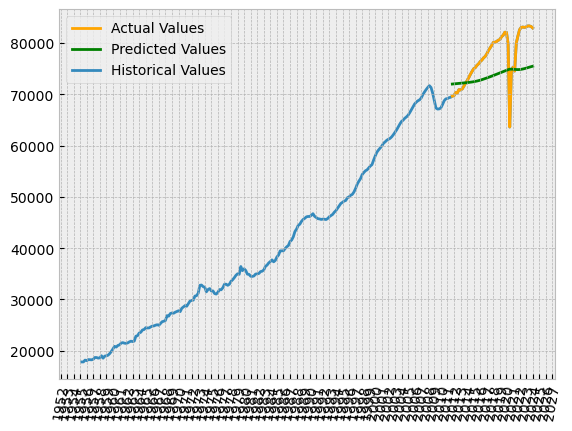

Epoch 1/50
20/20 [==============================] - 12s 175ms/step - loss: 0.0800 - val_loss: 0.0225
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0015 - val_loss: 0.0010
Epoch 3/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0023 - val_loss: 8.1653e-05
Epoch 4/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0037 - val_loss: 6.5852e-04
Epoch 5/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0030 - val_loss: 0.0018
Epoch 6/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0019 - val_loss: 0.0011
Epoch 7/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0020 - val_loss: 0.0015
Epoch 8/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0022 - val_loss: 0.0020
Epoch 9/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0017 - val_loss: 7.1115e-04
Epoch 10/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0029 - val_loss: 0.

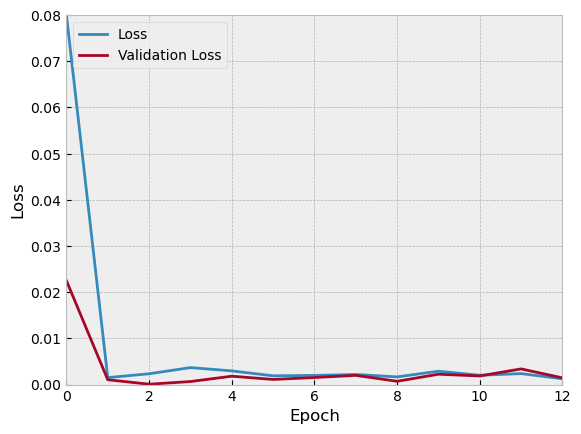

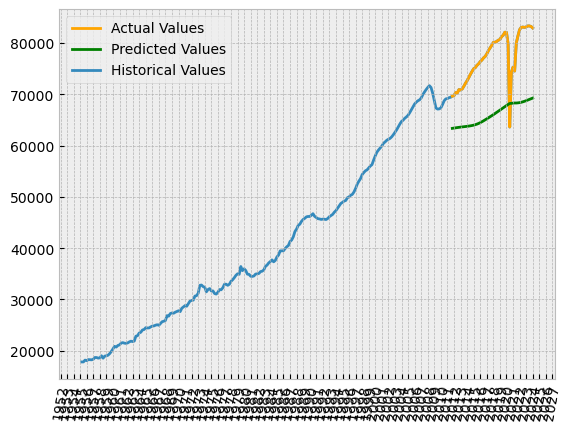

Epoch 1/50
20/20 [==============================] - 12s 174ms/step - loss: 0.1026 - val_loss: 0.0051
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0038 - val_loss: 0.0012
Epoch 3/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0033 - val_loss: 2.1604e-04
Epoch 4/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0052 - val_loss: 1.0442e-04
Epoch 5/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0055 - val_loss: 1.0045e-04
Epoch 6/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0061 - val_loss: 1.4341e-04
Epoch 7/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0057 - val_loss: 1.2118e-04
Epoch 8/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0064 - val_loss: 1.4519e-04
Epoch 9/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0071 - val_loss: 2.1069e-04
Epoch 10/50
20/20 [==============================] - 1s 51ms/step - loss: 0.008

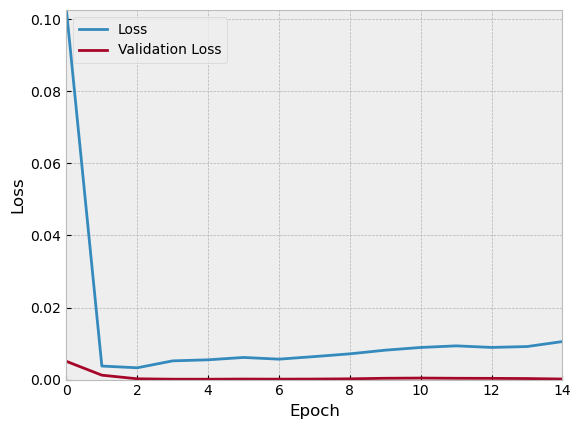

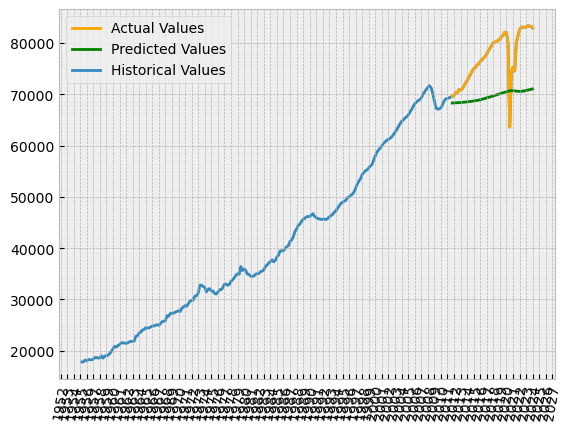

Epoch 1/50
20/20 [==============================] - 12s 175ms/step - loss: 0.1345 - val_loss: 0.0101
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0150 - val_loss: 0.0014
Epoch 3/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0128 - val_loss: 1.0166e-04
Epoch 4/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0107 - val_loss: 1.9091e-04
Epoch 5/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0095 - val_loss: 1.3856e-04
Epoch 6/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0093 - val_loss: 1.0188e-04
Epoch 7/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0096 - val_loss: 1.3041e-04
Epoch 8/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0104 - val_loss: 2.1075e-04
Epoch 9/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0108 - val_loss: 1.3323e-04
Epoch 10/50
20/20 [==============================] - 1s 52ms/step - loss: 0.010

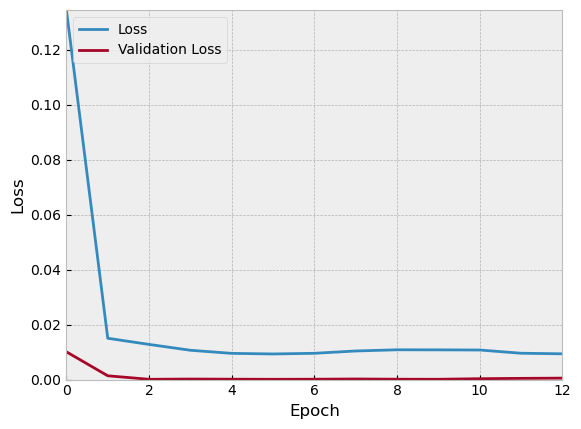

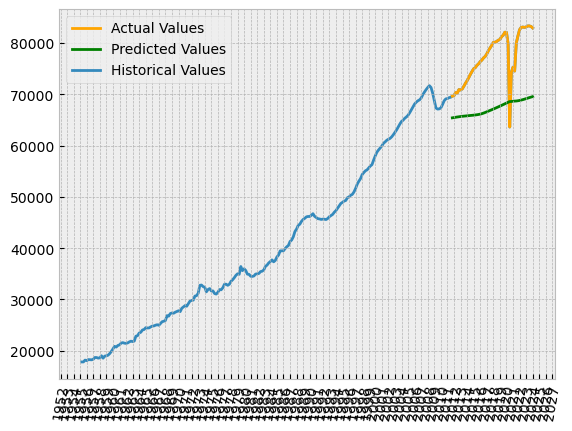

Epoch 1/50
20/20 [==============================] - 12s 181ms/step - loss: 0.1120 - val_loss: 2.8252e-04
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0066 - val_loss: 1.0175e-04
Epoch 3/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0074 - val_loss: 3.4010e-04
Epoch 4/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0085 - val_loss: 2.8831e-04
Epoch 5/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0091 - val_loss: 3.7760e-04
Epoch 6/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0100 - val_loss: 2.8915e-04
Epoch 7/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0103 - val_loss: 4.4315e-04
Epoch 8/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0114 - val_loss: 5.2833e-04
Epoch 9/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0118 - val_loss: 1.8779e-04
Epoch 10/50
20/20 [==============================] - 1s 50ms/step - los

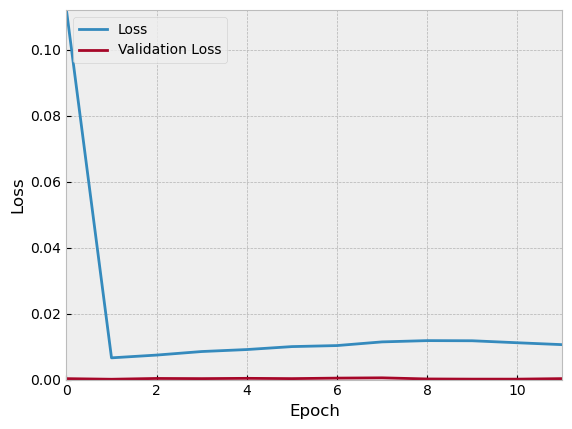

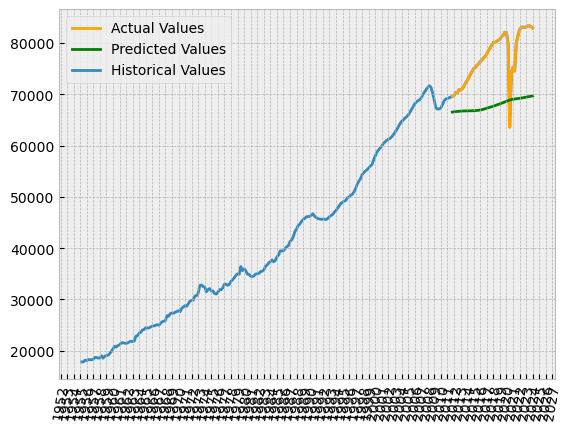

Epoch 1/50
20/20 [==============================] - 12s 171ms/step - loss: 0.0985 - val_loss: 0.0103
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0023 - val_loss: 0.0016
Epoch 3/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0021 - val_loss: 1.1150e-04
Epoch 4/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0038 - val_loss: 2.8891e-04
Epoch 5/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0031 - val_loss: 6.2730e-04
Epoch 6/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0028 - val_loss: 0.0019
Epoch 7/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0019 - val_loss: 9.8227e-04
Epoch 8/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0028 - val_loss: 0.0016
Epoch 9/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0019 - val_loss: 0.0013
Epoch 10/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0024 - val_loss

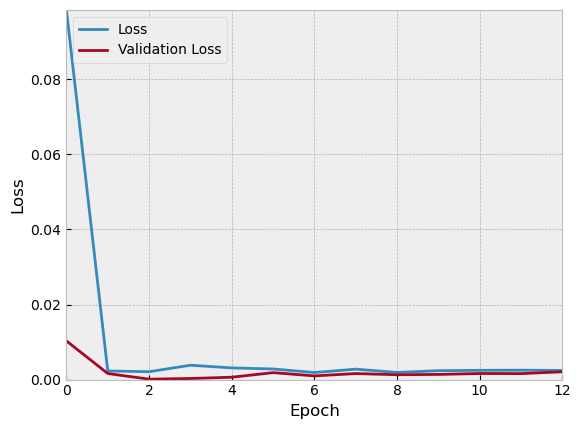

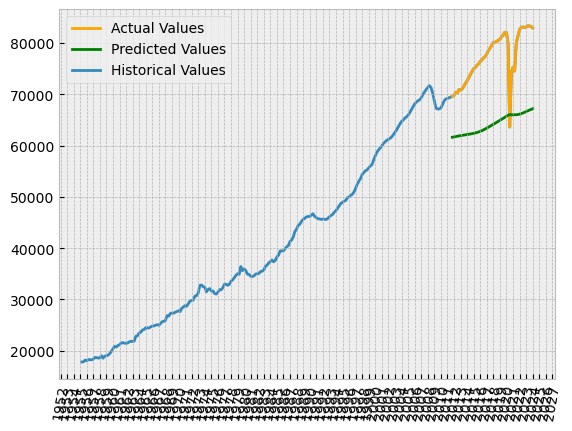

Epoch 1/50
20/20 [==============================] - 12s 172ms/step - loss: 0.1208 - val_loss: 0.0013
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0035 - val_loss: 4.1300e-04
Epoch 3/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0014 - val_loss: 4.5811e-05
Epoch 4/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0020 - val_loss: 4.6615e-05
Epoch 5/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0019 - val_loss: 1.1199e-04
Epoch 6/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0018 - val_loss: 3.2280e-04
Epoch 7/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0015 - val_loss: 7.3917e-04
Epoch 8/50
20/20 [==============================] - 1s 54ms/step - loss: 8.8943e-04 - val_loss: 4.2692e-04
Epoch 9/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0017 - val_loss: 0.0015
Epoch 10/50
20/20 [==============================] - 1s 54ms/step - loss: 8

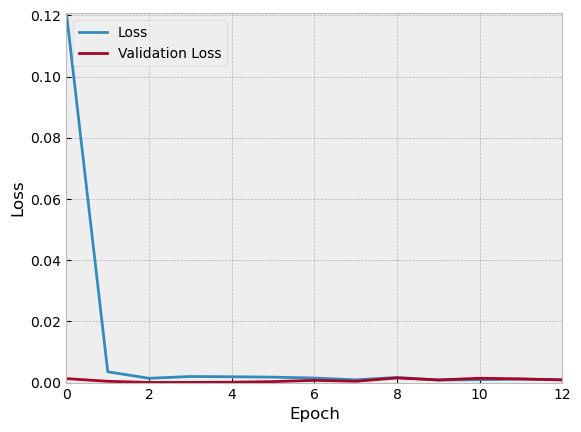

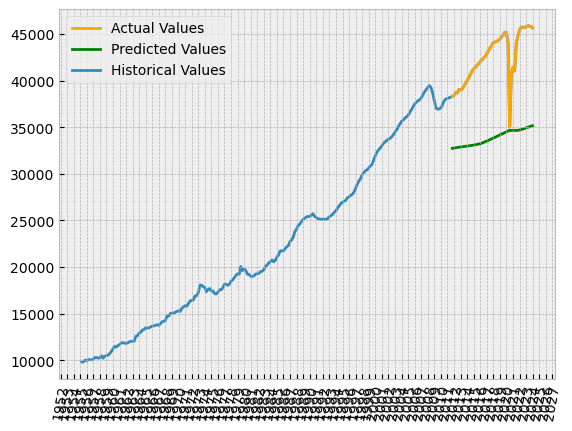

Epoch 1/50
20/20 [==============================] - 12s 175ms/step - loss: 0.1214 - val_loss: 8.9217e-04
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0053 - val_loss: 9.6389e-04
Epoch 3/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0017 - val_loss: 2.9765e-04
Epoch 4/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0018 - val_loss: 1.8505e-04
Epoch 5/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0017 - val_loss: 3.7420e-04
Epoch 6/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0015 - val_loss: 2.3336e-04
Epoch 7/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0016 - val_loss: 9.7121e-04
Epoch 8/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0013 - val_loss: 9.2644e-04
Epoch 9/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0016 - val_loss: 0.0016
Epoch 10/50
20/20 [==============================] - 1s 49ms/step - loss: 9

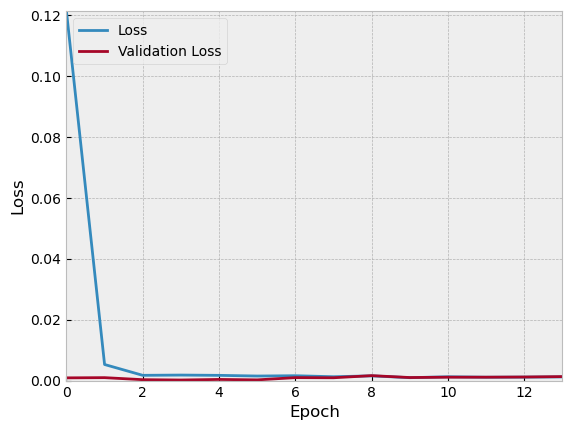

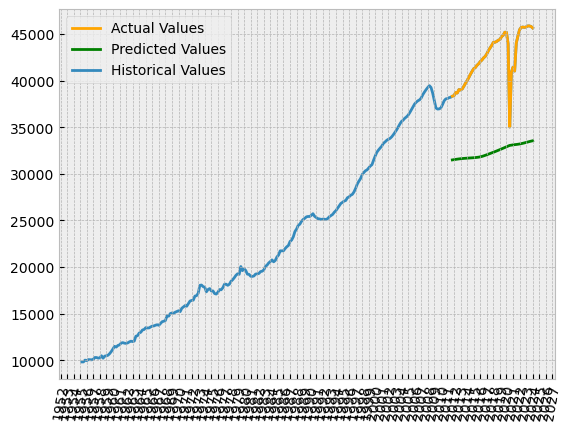

Epoch 1/50
20/20 [==============================] - 12s 171ms/step - loss: 0.1224 - val_loss: 2.4864e-04
Epoch 2/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0052 - val_loss: 9.2044e-05
Epoch 3/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0020 - val_loss: 5.9106e-05
Epoch 4/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0023 - val_loss: 5.6604e-05
Epoch 5/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0028 - val_loss: 3.6064e-05
Epoch 6/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0027 - val_loss: 3.5372e-05
Epoch 7/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0026 - val_loss: 4.2057e-04
Epoch 8/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0016 - val_loss: 3.2570e-04
Epoch 9/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0020 - val_loss: 6.2217e-04
Epoch 10/50
20/20 [==============================] - 1s 49ms/step - los

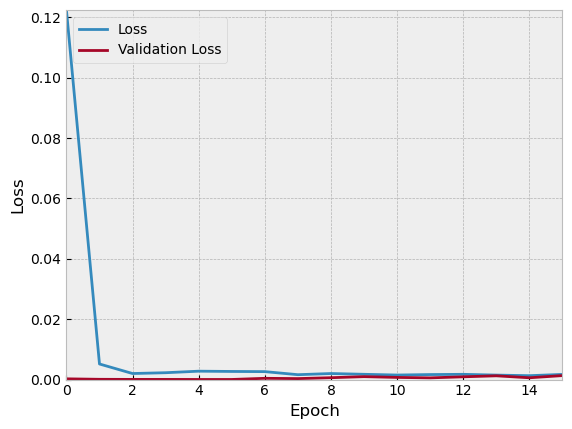

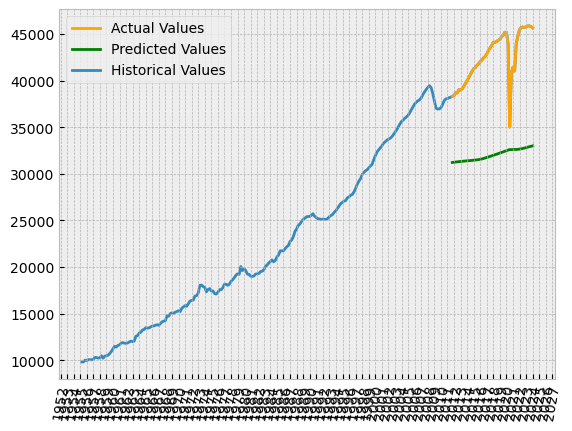

Epoch 1/50
20/20 [==============================] - 12s 173ms/step - loss: 0.1100 - val_loss: 0.0207
Epoch 2/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0037 - val_loss: 0.0029
Epoch 3/50
20/20 [==============================] - 1s 47ms/step - loss: 6.4452e-04 - val_loss: 1.4174e-04
Epoch 4/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0014 - val_loss: 1.8333e-04
Epoch 5/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0013 - val_loss: 0.0014
Epoch 6/50
20/20 [==============================] - 1s 47ms/step - loss: 7.0879e-04 - val_loss: 8.6900e-04
Epoch 7/50
20/20 [==============================] - 1s 48ms/step - loss: 9.1535e-04 - val_loss: 9.5336e-04
Epoch 8/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0012 - val_loss: 9.7708e-04
Epoch 9/50
20/20 [==============================] - 1s 50ms/step - loss: 9.9574e-04 - val_loss: 3.8013e-04
Epoch 10/50
20/20 [==============================] - 1s 49ms/step -

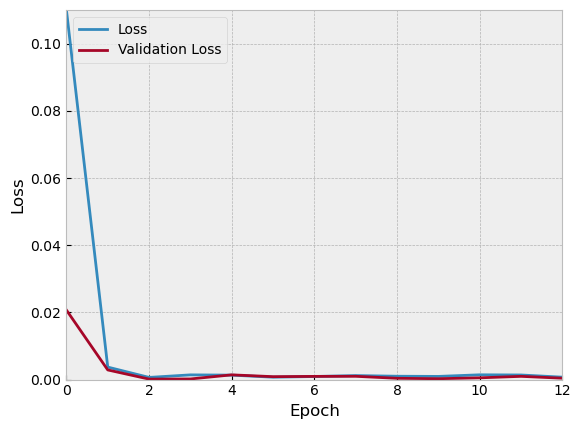

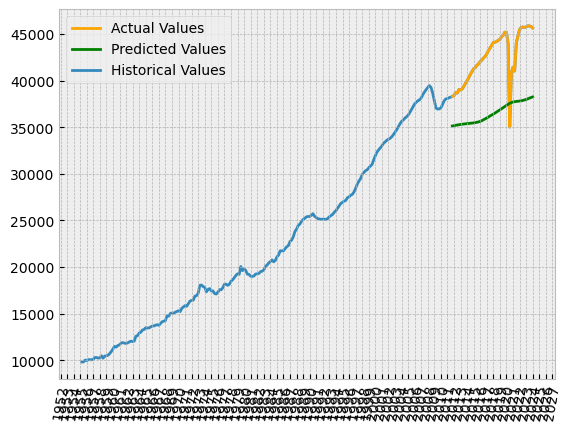

Epoch 1/50
20/20 [==============================] - 12s 171ms/step - loss: 0.0897 - val_loss: 0.0235
Epoch 2/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0030 - val_loss: 0.0012
Epoch 3/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0013 - val_loss: 5.6989e-05
Epoch 4/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0022 - val_loss: 4.1712e-04
Epoch 5/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0012 - val_loss: 5.7883e-04
Epoch 6/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0011 - val_loss: 1.0835e-04
Epoch 7/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 8/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0017 - val_loss: 0.0013
Epoch 9/50
20/20 [==============================] - 1s 49ms/step - loss: 8.8795e-04 - val_loss: 3.5236e-04
Epoch 10/50
20/20 [==============================] - 1s 47ms/step - loss: 9.7937e-0

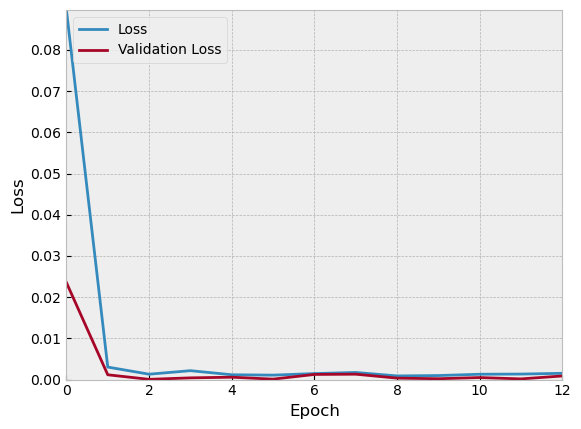

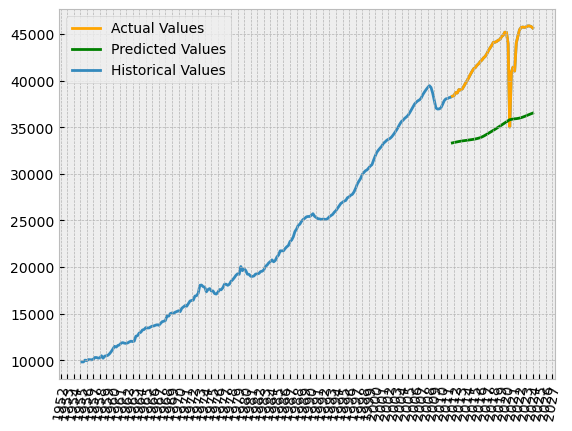

Epoch 1/50
20/20 [==============================] - 12s 175ms/step - loss: 0.1287 - val_loss: 0.0121
Epoch 2/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0026 - val_loss: 0.0032
Epoch 3/50
20/20 [==============================] - 1s 46ms/step - loss: 8.5311e-04 - val_loss: 2.9128e-05
Epoch 4/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0017 - val_loss: 4.6882e-05
Epoch 5/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0021 - val_loss: 0.0015
Epoch 6/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 7/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0011 - val_loss: 9.7642e-04
Epoch 8/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 9/50
20/20 [==============================] - 1s 47ms/step - loss: 9.3367e-04 - val_loss: 1.0929e-04
Epoch 10/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0017 - 

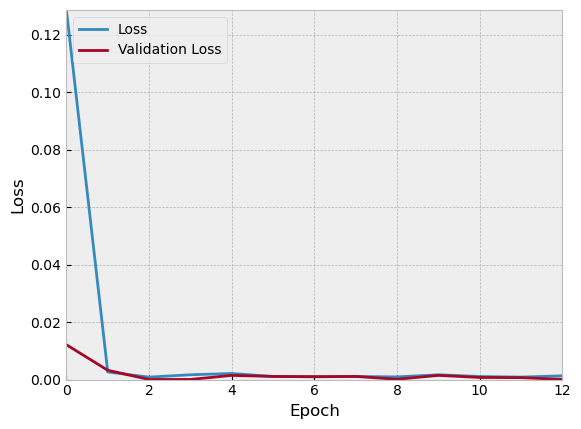

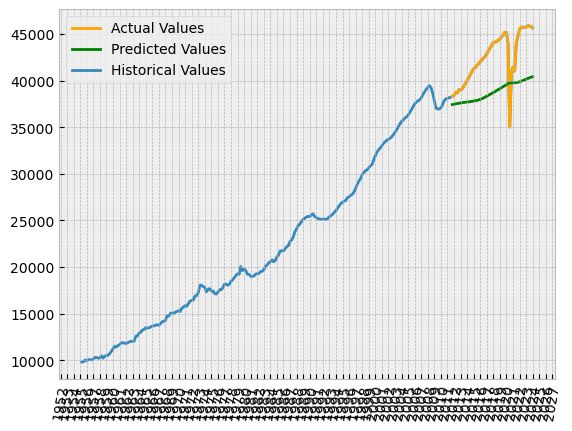

Epoch 1/50
20/20 [==============================] - 12s 172ms/step - loss: 0.1262 - val_loss: 0.0033
Epoch 2/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0042 - val_loss: 0.0010
Epoch 3/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0013 - val_loss: 1.0953e-04
Epoch 4/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0021 - val_loss: 1.1669e-04
Epoch 5/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0017 - val_loss: 4.4552e-04
Epoch 6/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0014 - val_loss: 4.8264e-04
Epoch 7/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0018 - val_loss: 0.0011
Epoch 8/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0010 - val_loss: 8.1784e-04
Epoch 9/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0014 - val_loss: 0.0016
Epoch 10/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0010 - val_

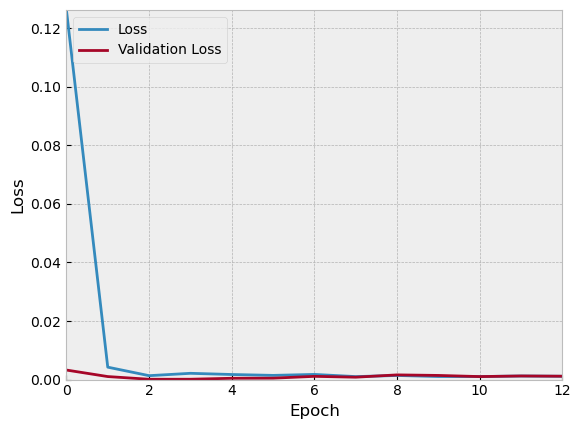

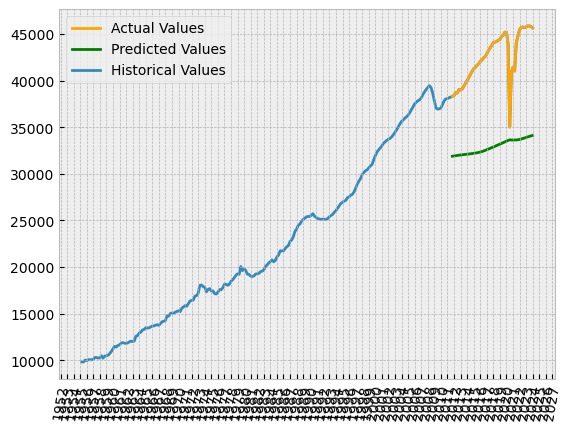

Epoch 1/50
20/20 [==============================] - 12s 171ms/step - loss: 0.0987 - val_loss: 2.5562e-04
Epoch 2/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0045 - val_loss: 6.0909e-05
Epoch 3/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0025 - val_loss: 4.7165e-05
Epoch 4/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0030 - val_loss: 6.2697e-05
Epoch 5/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0032 - val_loss: 8.0254e-05
Epoch 6/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0024 - val_loss: 1.3717e-04
Epoch 7/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0023 - val_loss: 4.5838e-04
Epoch 8/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0020 - val_loss: 5.5910e-04
Epoch 9/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0019 - val_loss: 6.6825e-04
Epoch 10/50
20/20 [==============================] - 1s 44ms/step - los

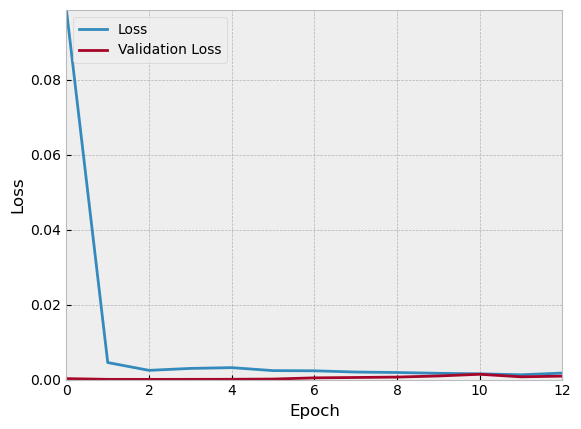

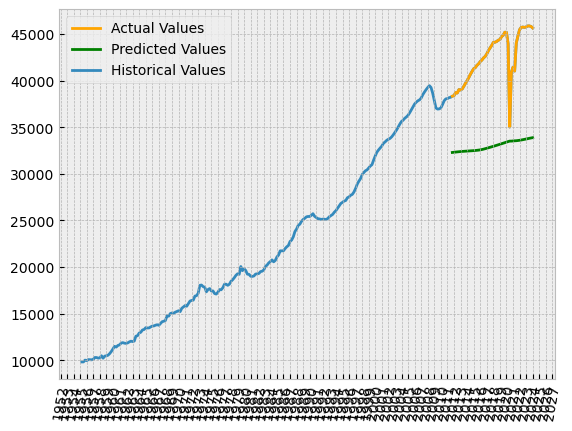

Epoch 1/50
20/20 [==============================] - 11s 163ms/step - loss: 0.1100 - val_loss: 0.0068
Epoch 2/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0045 - val_loss: 0.0021
Epoch 3/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0011 - val_loss: 6.7598e-04
Epoch 4/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0011 - val_loss: 2.5501e-04
Epoch 5/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0016 - val_loss: 2.7443e-04
Epoch 6/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0015 - val_loss: 5.2556e-04
Epoch 7/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0012 - val_loss: 5.5500e-04
Epoch 8/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0017 - val_loss: 0.0015
Epoch 9/50
20/20 [==============================] - 1s 44ms/step - loss: 9.0315e-04 - val_loss: 9.7291e-04
Epoch 10/50
20/20 [==============================] - 1s 44ms/step - loss: 0.001

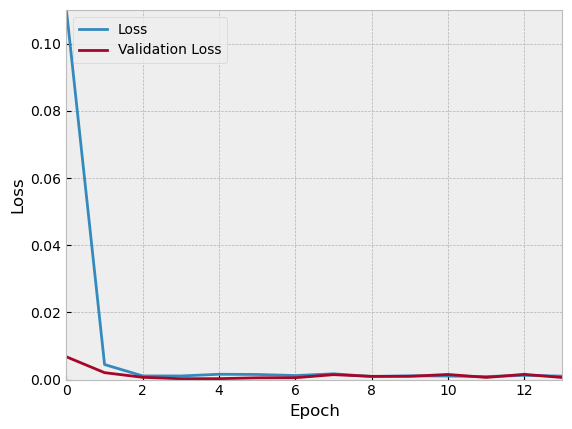

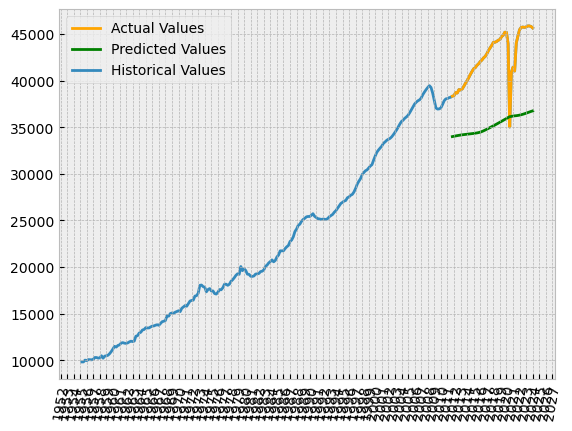

Epoch 1/50
20/20 [==============================] - 11s 163ms/step - loss: 0.0804 - val_loss: 0.0057
Epoch 2/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0041 - val_loss: 4.2779e-04
Epoch 3/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0031 - val_loss: 3.7887e-04
Epoch 4/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0024 - val_loss: 0.0012
Epoch 5/50
20/20 [==============================] - 1s 43ms/step - loss: 8.4421e-04 - val_loss: 2.6347e-04
Epoch 6/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0011 - val_loss: 7.2882e-04
Epoch 7/50
20/20 [==============================] - 1s 48ms/step - loss: 7.9120e-04 - val_loss: 2.9568e-04
Epoch 8/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0010 - val_loss: 5.1423e-04
Epoch 9/50
20/20 [==============================] - 1s 43ms/step - loss: 8.2799e-04 - val_loss: 5.9343e-04
Epoch 10/50
20/20 [==============================] - 1s 45ms/step -

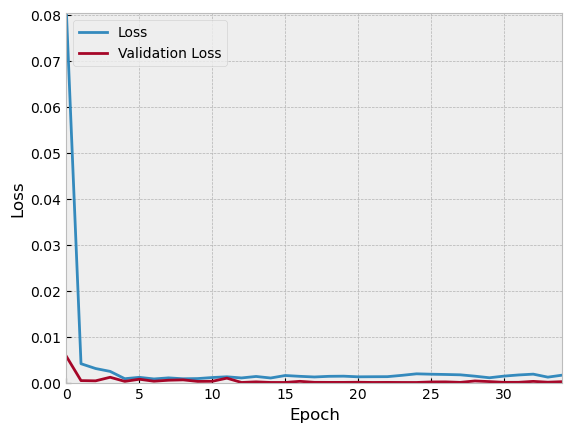

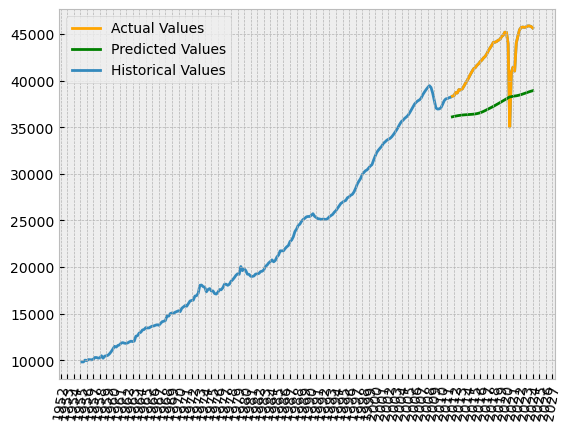

Epoch 1/50
20/20 [==============================] - 12s 171ms/step - loss: 0.1273 - val_loss: 0.0133
Epoch 2/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0074 - val_loss: 0.0045
Epoch 3/50
20/20 [==============================] - 1s 45ms/step - loss: 0.0015 - val_loss: 1.5116e-04
Epoch 4/50
20/20 [==============================] - 1s 45ms/step - loss: 7.1223e-04 - val_loss: 6.2452e-05
Epoch 5/50
20/20 [==============================] - 1s 45ms/step - loss: 5.1529e-04 - val_loss: 8.0393e-06
Epoch 6/50
20/20 [==============================] - 1s 44ms/step - loss: 4.7748e-04 - val_loss: 1.9961e-06
Epoch 7/50
20/20 [==============================] - 1s 44ms/step - loss: 4.9210e-04 - val_loss: 3.6964e-05
Epoch 8/50
20/20 [==============================] - 1s 45ms/step - loss: 5.3398e-04 - val_loss: 2.4665e-04
Epoch 9/50
20/20 [==============================] - 1s 45ms/step - loss: 4.8954e-04 - val_loss: 2.6311e-05
Epoch 10/50
20/20 [==============================] - 1s

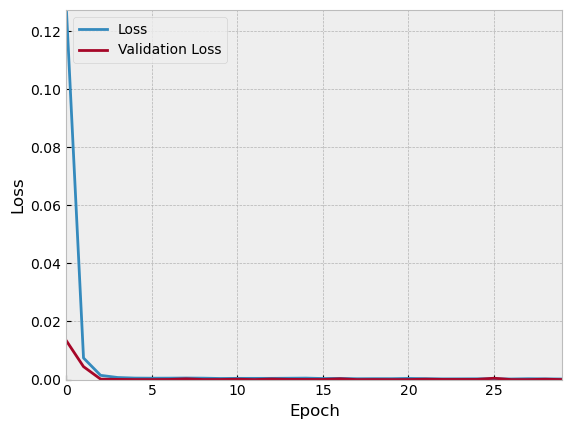

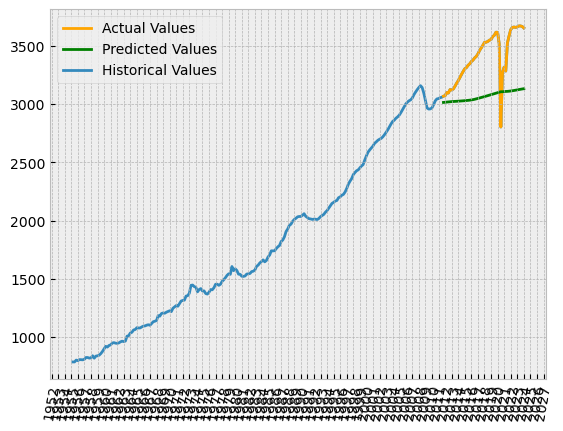

Epoch 1/50
20/20 [==============================] - 11s 161ms/step - loss: 0.1236 - val_loss: 0.0251
Epoch 2/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0078 - val_loss: 0.0038
Epoch 3/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0011 - val_loss: 1.0442e-04
Epoch 4/50
20/20 [==============================] - 1s 43ms/step - loss: 7.0157e-04 - val_loss: 1.3320e-05
Epoch 5/50
20/20 [==============================] - 1s 43ms/step - loss: 5.9897e-04 - val_loss: 2.8928e-05
Epoch 6/50
20/20 [==============================] - 1s 43ms/step - loss: 7.6706e-04 - val_loss: 1.4082e-05
Epoch 7/50
20/20 [==============================] - 1s 44ms/step - loss: 5.7673e-04 - val_loss: 3.4658e-05
Epoch 8/50
20/20 [==============================] - 1s 43ms/step - loss: 5.1778e-04 - val_loss: 2.3949e-07
Epoch 9/50
20/20 [==============================] - 1s 43ms/step - loss: 4.8127e-04 - val_loss: 1.4636e-04
Epoch 10/50
20/20 [==============================] - 1s

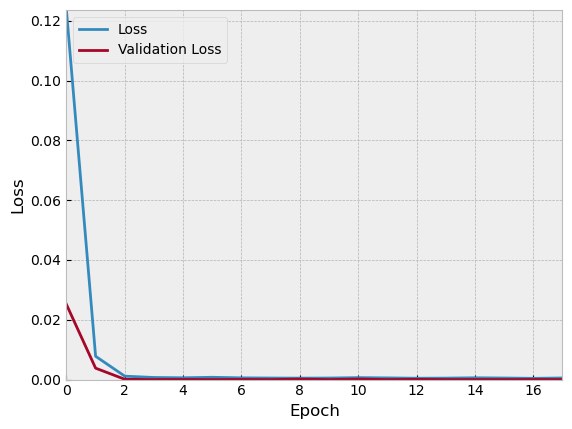

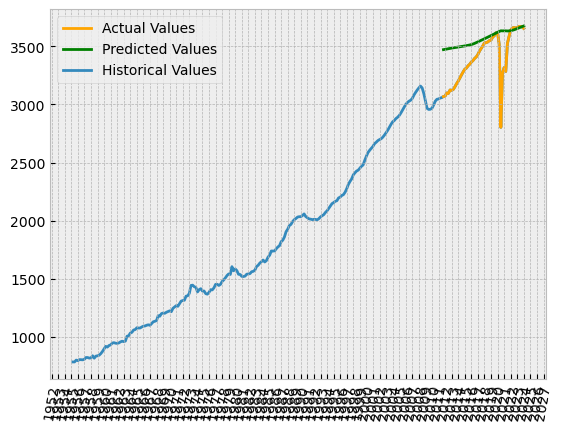

Epoch 1/50
20/20 [==============================] - 11s 163ms/step - loss: 0.1193 - val_loss: 0.0274
Epoch 2/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0073 - val_loss: 0.0032
Epoch 3/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0011 - val_loss: 4.5729e-06
Epoch 4/50
20/20 [==============================] - 1s 43ms/step - loss: 7.0468e-04 - val_loss: 5.0627e-06
Epoch 5/50
20/20 [==============================] - 1s 43ms/step - loss: 6.9679e-04 - val_loss: 2.6414e-04
Epoch 6/50
20/20 [==============================] - 1s 43ms/step - loss: 5.1570e-04 - val_loss: 3.8960e-05
Epoch 7/50
20/20 [==============================] - 1s 44ms/step - loss: 6.5612e-04 - val_loss: 3.5992e-06
Epoch 8/50
20/20 [==============================] - 1s 45ms/step - loss: 5.4713e-04 - val_loss: 1.2063e-06
Epoch 9/50
20/20 [==============================] - 1s 43ms/step - loss: 5.9836e-04 - val_loss: 1.2783e-04
Epoch 10/50
20/20 [==============================] - 1s

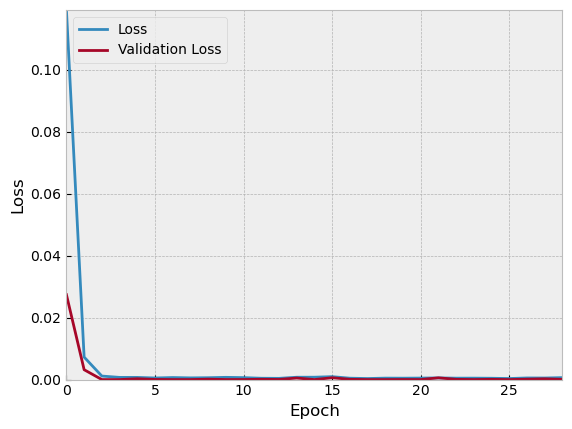

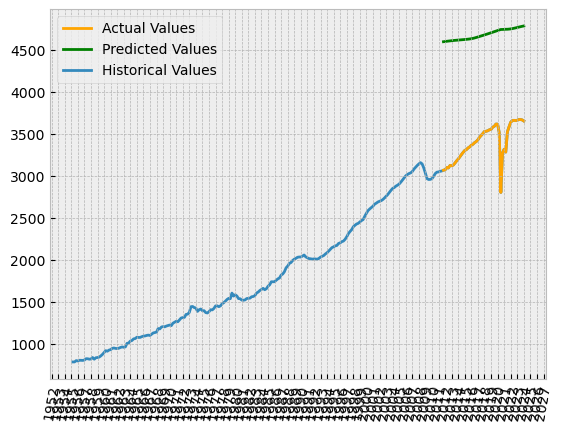

Epoch 1/50
20/20 [==============================] - 11s 161ms/step - loss: 0.1038 - val_loss: 0.0241
Epoch 2/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0065 - val_loss: 0.0037
Epoch 3/50
20/20 [==============================] - 1s 43ms/step - loss: 0.0014 - val_loss: 8.3651e-05
Epoch 4/50
20/20 [==============================] - 1s 43ms/step - loss: 7.2658e-04 - val_loss: 5.0197e-06
Epoch 5/50
20/20 [==============================] - 1s 43ms/step - loss: 7.3861e-04 - val_loss: 3.4583e-05
Epoch 6/50
20/20 [==============================] - 1s 43ms/step - loss: 5.6243e-04 - val_loss: 9.1534e-07
Epoch 7/50
20/20 [==============================] - 1s 43ms/step - loss: 5.8536e-04 - val_loss: 2.2639e-05
Epoch 8/50
20/20 [==============================] - 1s 44ms/step - loss: 6.7686e-04 - val_loss: 4.6583e-04
Epoch 9/50
20/20 [==============================] - 1s 42ms/step - loss: 7.4767e-04 - val_loss: 9.1130e-04
Epoch 10/50
20/20 [==============================] - 1s

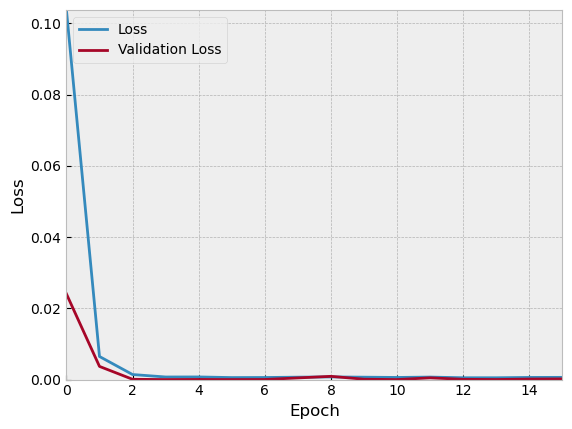

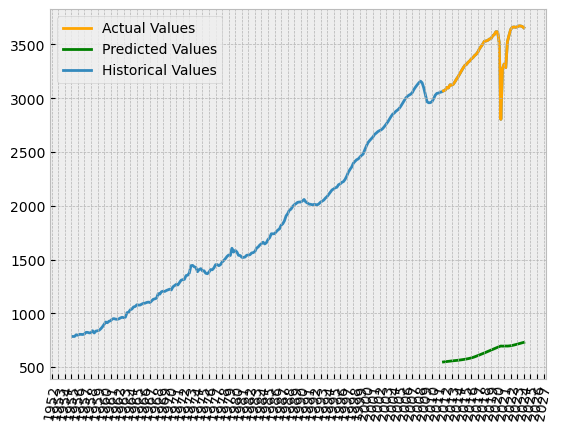

Epoch 1/50
20/20 [==============================] - 11s 160ms/step - loss: 0.1350 - val_loss: 0.0066
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0080 - val_loss: 0.0037
Epoch 3/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0021 - val_loss: 0.0013
Epoch 4/50
20/20 [==============================] - 1s 40ms/step - loss: 6.8083e-04 - val_loss: 1.9749e-04
Epoch 5/50
20/20 [==============================] - 1s 40ms/step - loss: 6.3143e-04 - val_loss: 8.3476e-06
Epoch 6/50
20/20 [==============================] - 1s 40ms/step - loss: 6.2488e-04 - val_loss: 9.0887e-05
Epoch 7/50
20/20 [==============================] - 1s 40ms/step - loss: 5.3166e-04 - val_loss: 1.2353e-04
Epoch 8/50
20/20 [==============================] - 1s 40ms/step - loss: 5.1299e-04 - val_loss: 3.2656e-07
Epoch 9/50
20/20 [==============================] - 1s 40ms/step - loss: 5.0713e-04 - val_loss: 4.4130e-04
Epoch 10/50
20/20 [==============================] - 1s 40m

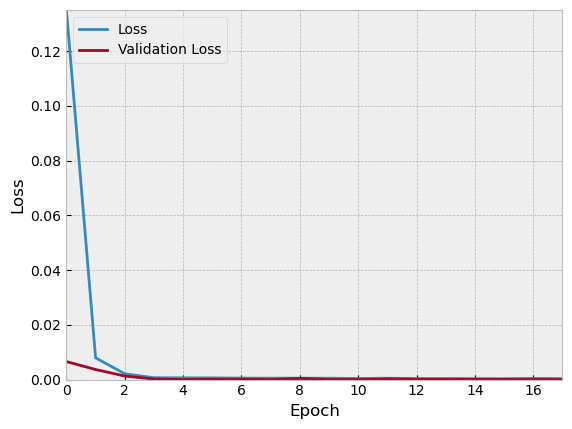

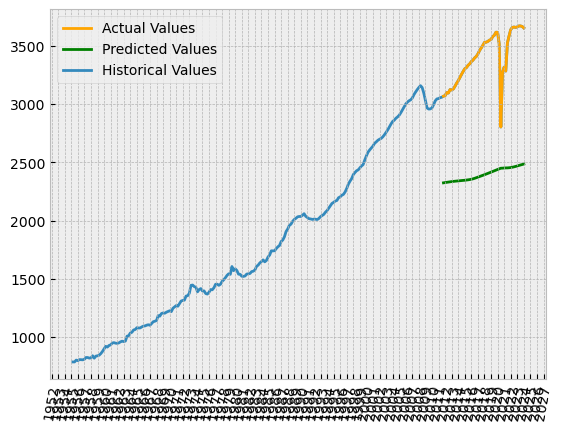

Epoch 1/50
20/20 [==============================] - 11s 159ms/step - loss: 0.1233 - val_loss: 0.0175
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0057 - val_loss: 0.0034
Epoch 3/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0011 - val_loss: 1.2545e-04
Epoch 4/50
20/20 [==============================] - 1s 36ms/step - loss: 9.0291e-04 - val_loss: 2.6902e-06
Epoch 5/50
20/20 [==============================] - 1s 37ms/step - loss: 7.0322e-04 - val_loss: 1.0542e-04
Epoch 6/50
20/20 [==============================] - 1s 37ms/step - loss: 5.4059e-04 - val_loss: 1.3520e-04
Epoch 7/50
20/20 [==============================] - 1s 36ms/step - loss: 6.3185e-04 - val_loss: 4.0782e-05
Epoch 8/50
20/20 [==============================] - 1s 37ms/step - loss: 5.5185e-04 - val_loss: 4.2917e-05
Epoch 9/50
20/20 [==============================] - 1s 36ms/step - loss: 5.7782e-04 - val_loss: 1.6261e-05
Epoch 10/50
20/20 [==============================] - 1s

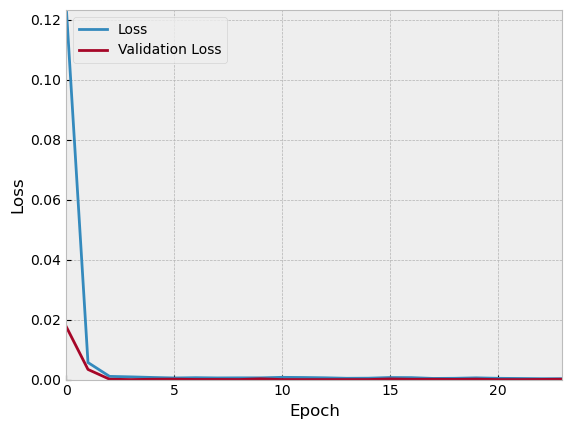

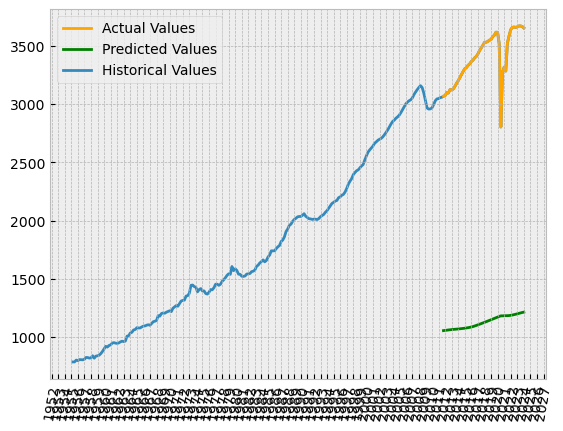

Epoch 1/50
20/20 [==============================] - 11s 156ms/step - loss: 0.1018 - val_loss: 0.0292
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0078 - val_loss: 0.0012
Epoch 3/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0020 - val_loss: 8.9646e-04
Epoch 4/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0012 - val_loss: 9.7149e-05
Epoch 5/50
20/20 [==============================] - 1s 35ms/step - loss: 9.0157e-04 - val_loss: 8.2779e-07
Epoch 6/50
20/20 [==============================] - 1s 35ms/step - loss: 7.1754e-04 - val_loss: 4.6402e-05
Epoch 7/50
20/20 [==============================] - 1s 35ms/step - loss: 8.9943e-04 - val_loss: 3.9263e-04
Epoch 8/50
20/20 [==============================] - 1s 35ms/step - loss: 9.6511e-04 - val_loss: 3.6589e-05
Epoch 9/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0011 - val_loss: 6.2474e-05
Epoch 10/50
20/20 [==============================] - 1s 35ms/st

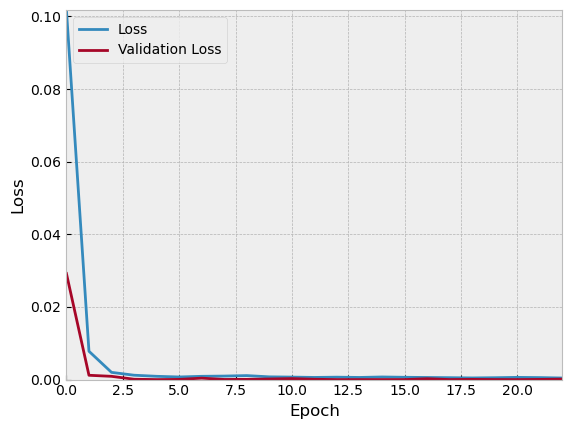

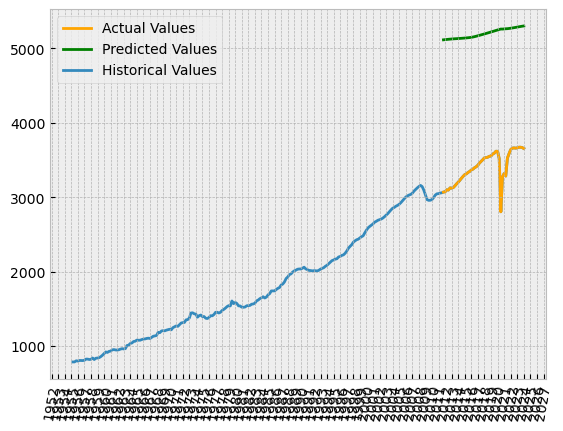

Epoch 1/50
20/20 [==============================] - 11s 154ms/step - loss: 0.1962 - val_loss: 0.0060
Epoch 2/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0067 - val_loss: 9.1530e-04
Epoch 3/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0013 - val_loss: 1.9457e-04
Epoch 4/50
20/20 [==============================] - 1s 33ms/step - loss: 6.2158e-04 - val_loss: 2.7803e-05
Epoch 5/50
20/20 [==============================] - 1s 35ms/step - loss: 5.2955e-04 - val_loss: 9.6996e-06
Epoch 6/50
20/20 [==============================] - 1s 33ms/step - loss: 4.7454e-04 - val_loss: 2.1268e-06
Epoch 7/50
20/20 [==============================] - 1s 34ms/step - loss: 6.8520e-04 - val_loss: 6.3882e-04
Epoch 8/50
20/20 [==============================] - 1s 35ms/step - loss: 5.1377e-04 - val_loss: 4.0068e-06
Epoch 9/50
20/20 [==============================] - 1s 34ms/step - loss: 4.9419e-04 - val_loss: 1.7071e-04
Epoch 10/50
20/20 [==============================] 

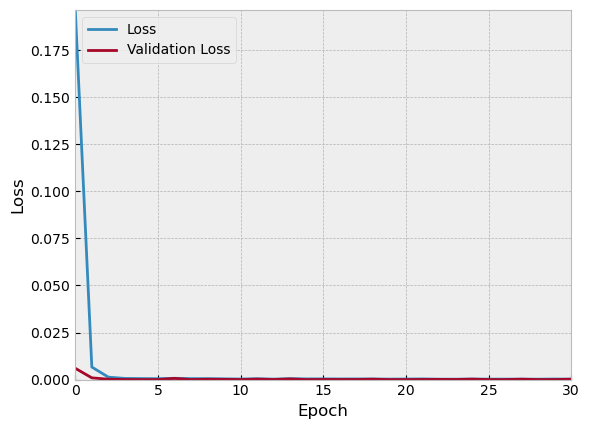

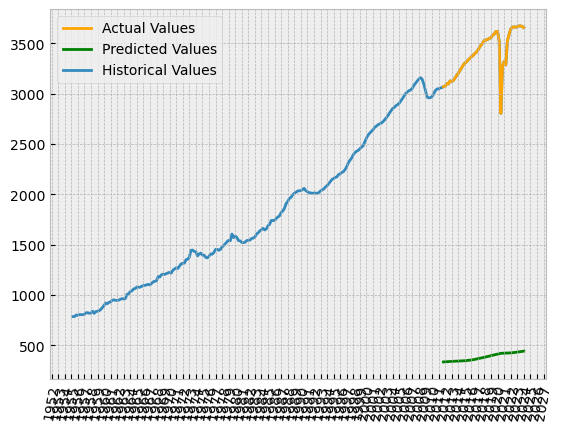

Epoch 1/50
20/20 [==============================] - 11s 159ms/step - loss: 0.1249 - val_loss: 0.0214
Epoch 2/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0064 - val_loss: 0.0036
Epoch 3/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0012 - val_loss: 2.1767e-04
Epoch 4/50
20/20 [==============================] - 1s 33ms/step - loss: 6.2234e-04 - val_loss: 6.1617e-07
Epoch 5/50
20/20 [==============================] - 1s 32ms/step - loss: 5.8092e-04 - val_loss: 3.6919e-06
Epoch 6/50
20/20 [==============================] - 1s 32ms/step - loss: 5.4541e-04 - val_loss: 6.0189e-05
Epoch 7/50
20/20 [==============================] - 1s 32ms/step - loss: 6.5148e-04 - val_loss: 7.5088e-07
Epoch 8/50
20/20 [==============================] - 1s 34ms/step - loss: 5.5790e-04 - val_loss: 2.6257e-04
Epoch 9/50
20/20 [==============================] - 1s 33ms/step - loss: 5.4584e-04 - val_loss: 7.5696e-06
Epoch 10/50
20/20 [==============================] - 1s

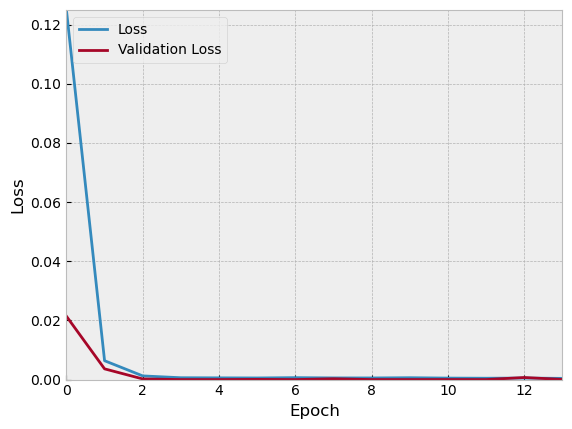

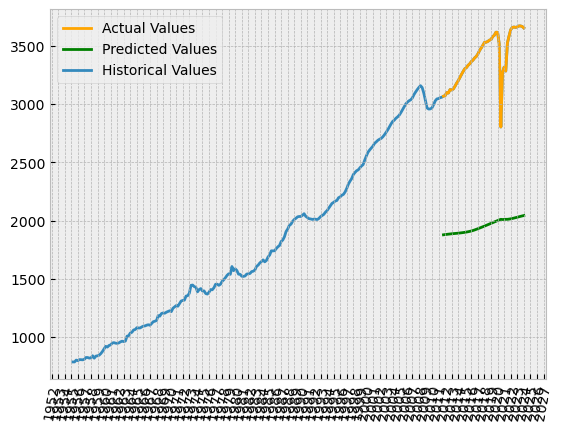

Epoch 1/50
20/20 [==============================] - 11s 153ms/step - loss: 0.0949 - val_loss: 0.0200
Epoch 2/50
20/20 [==============================] - 1s 31ms/step - loss: 0.0057 - val_loss: 1.3954e-04
Epoch 3/50
20/20 [==============================] - 1s 31ms/step - loss: 0.0011 - val_loss: 1.9467e-06
Epoch 4/50
20/20 [==============================] - 1s 31ms/step - loss: 6.5292e-04 - val_loss: 5.0894e-06
Epoch 5/50
20/20 [==============================] - 1s 31ms/step - loss: 6.5402e-04 - val_loss: 4.0226e-04
Epoch 6/50
20/20 [==============================] - 1s 31ms/step - loss: 6.6149e-04 - val_loss: 6.5555e-05
Epoch 7/50
20/20 [==============================] - 1s 31ms/step - loss: 8.5880e-04 - val_loss: 1.2309e-04
Epoch 8/50
20/20 [==============================] - 1s 32ms/step - loss: 6.4134e-04 - val_loss: 2.8240e-06
Epoch 9/50
20/20 [==============================] - 1s 31ms/step - loss: 6.4359e-04 - val_loss: 2.2331e-04
Epoch 10/50
20/20 [==============================] 

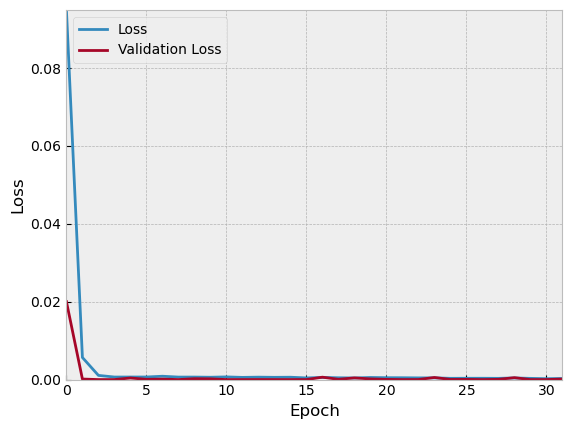

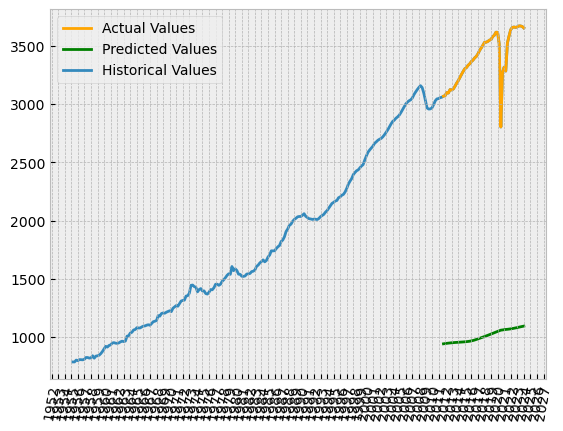

Epoch 1/50
20/20 [==============================] - 11s 154ms/step - loss: 0.1067 - val_loss: 0.0262
Epoch 2/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0052 - val_loss: 0.0022
Epoch 3/50
20/20 [==============================] - 1s 28ms/step - loss: 0.0014 - val_loss: 1.7818e-05
Epoch 4/50
20/20 [==============================] - 1s 28ms/step - loss: 9.7180e-04 - val_loss: 6.7673e-06
Epoch 5/50
20/20 [==============================] - 1s 28ms/step - loss: 9.5010e-04 - val_loss: 7.0660e-05
Epoch 6/50
20/20 [==============================] - 1s 28ms/step - loss: 8.9958e-04 - val_loss: 9.0817e-05
Epoch 7/50
20/20 [==============================] - 1s 28ms/step - loss: 9.7944e-04 - val_loss: 1.1813e-04
Epoch 8/50
20/20 [==============================] - 1s 29ms/step - loss: 8.8891e-04 - val_loss: 5.2524e-05
Epoch 9/50
20/20 [==============================] - 1s 30ms/step - loss: 7.1275e-04 - val_loss: 1.4880e-06
Epoch 10/50
20/20 [==============================] - 1s

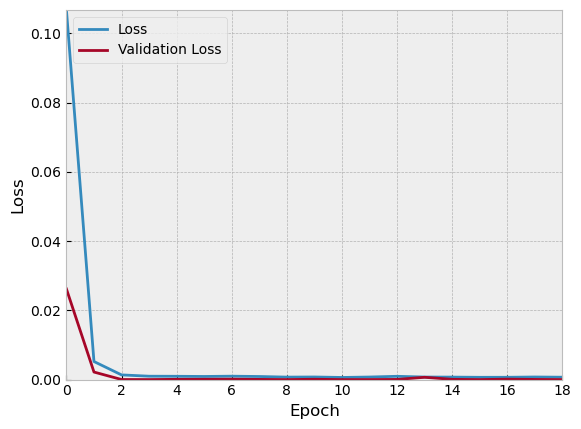

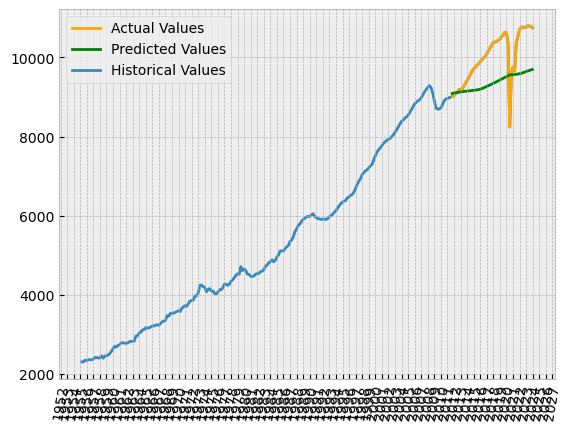

Epoch 1/50
20/20 [==============================] - 11s 146ms/step - loss: 0.0939 - val_loss: 0.0180
Epoch 2/50
20/20 [==============================] - 1s 26ms/step - loss: 0.0040 - val_loss: 5.4196e-06
Epoch 3/50
20/20 [==============================] - 1s 26ms/step - loss: 0.0013 - val_loss: 1.6586e-04
Epoch 4/50
20/20 [==============================] - 1s 26ms/step - loss: 0.0010 - val_loss: 1.4679e-04
Epoch 5/50
20/20 [==============================] - 1s 26ms/step - loss: 7.0588e-04 - val_loss: 1.8310e-04
Epoch 6/50
20/20 [==============================] - 1s 26ms/step - loss: 8.2751e-04 - val_loss: 1.4312e-06
Epoch 7/50
20/20 [==============================] - 1s 26ms/step - loss: 8.1723e-04 - val_loss: 6.0988e-06
Epoch 8/50
20/20 [==============================] - 1s 26ms/step - loss: 8.5129e-04 - val_loss: 1.1820e-04
Epoch 9/50
20/20 [==============================] - 1s 27ms/step - loss: 6.1618e-04 - val_loss: 2.8087e-04
Epoch 10/50
20/20 [==============================] - 1s

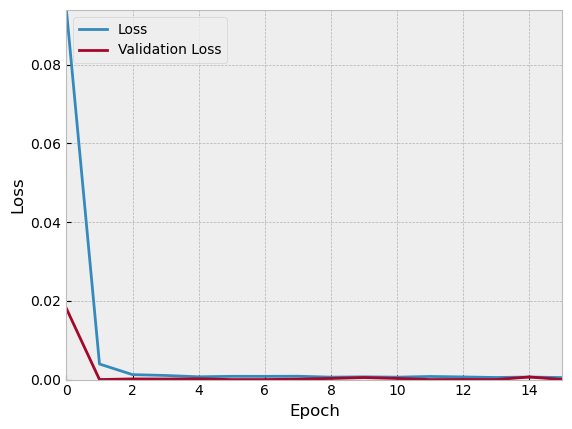

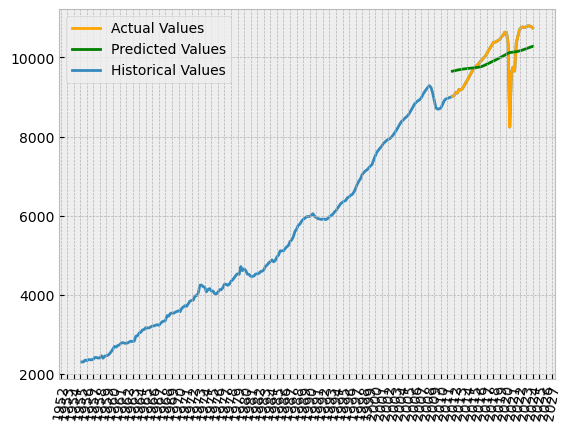

Epoch 1/50
20/20 [==============================] - 11s 147ms/step - loss: 0.1476 - val_loss: 2.9799e-04
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0054 - val_loss: 2.5968e-05
Epoch 3/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0012 - val_loss: 2.7895e-04
Epoch 4/50
20/20 [==============================] - 0s 24ms/step - loss: 5.8734e-04 - val_loss: 4.6297e-04
Epoch 5/50
20/20 [==============================] - 0s 24ms/step - loss: 4.9749e-04 - val_loss: 8.6115e-06
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 6.2487e-04 - val_loss: 3.4989e-04
Epoch 7/50
20/20 [==============================] - 0s 22ms/step - loss: 4.9269e-04 - val_loss: 9.1593e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 4.6069e-04 - val_loss: 2.9730e-04
Epoch 9/50
20/20 [==============================] - 0s 24ms/step - loss: 5.2198e-04 - val_loss: 1.8205e-04
Epoch 10/50
20/20 [============================

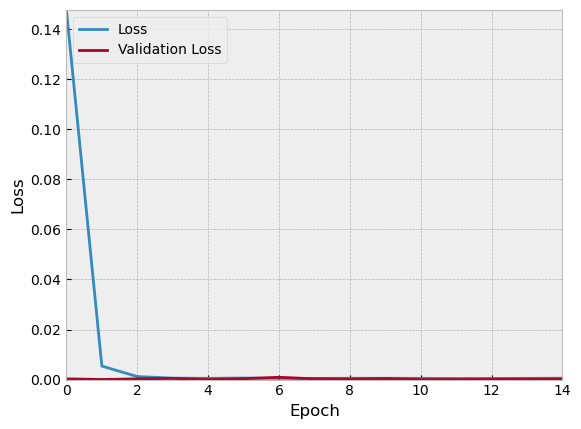

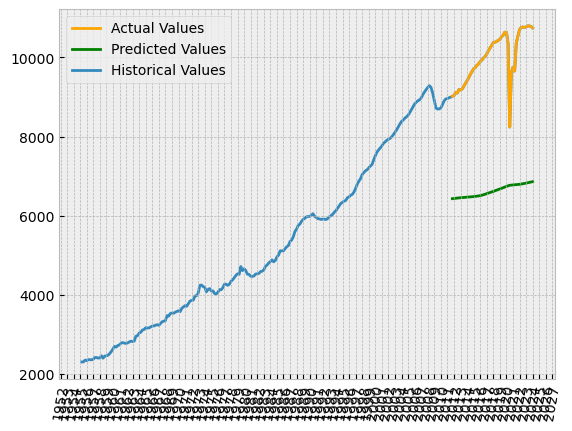

Epoch 1/50
20/20 [==============================] - 11s 146ms/step - loss: 0.1462 - val_loss: 0.0096
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0064 - val_loss: 0.0035
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 9.7079e-04 - val_loss: 9.3154e-04
Epoch 4/50
20/20 [==============================] - 0s 24ms/step - loss: 6.2344e-04 - val_loss: 1.6541e-04
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 5.5723e-04 - val_loss: 5.2851e-06
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 6.4003e-04 - val_loss: 7.3369e-05
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 7.8245e-04 - val_loss: 5.5467e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 4.0706e-04 - val_loss: 1.0099e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 6.2233e-04 - val_loss: 2.0532e-04
Epoch 10/50
20/20 [==============================] 

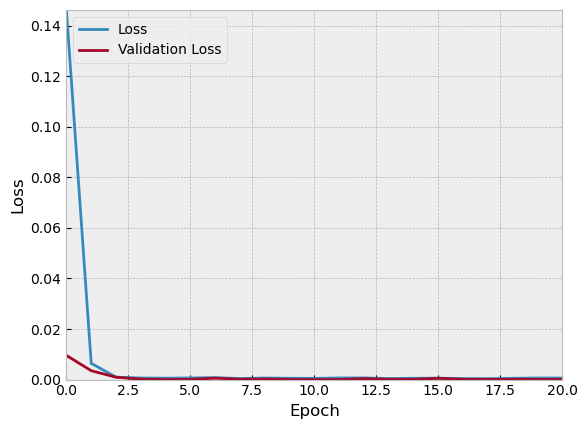

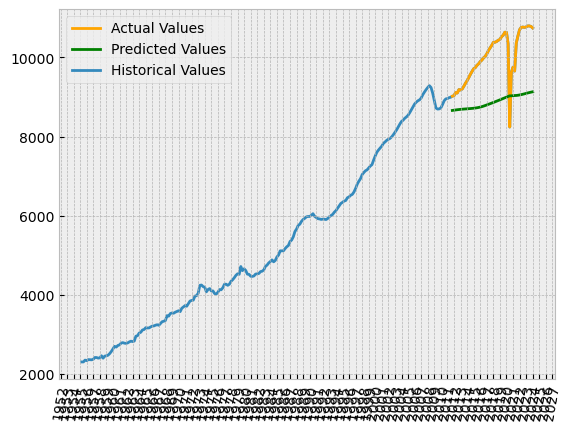

Epoch 1/50
20/20 [==============================] - 11s 146ms/step - loss: 0.0857 - val_loss: 0.0073
Epoch 2/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0044 - val_loss: 7.6271e-04
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0020 - val_loss: 1.7059e-05
Epoch 4/50
20/20 [==============================] - 0s 24ms/step - loss: 8.6407e-04 - val_loss: 1.7881e-04
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 5.9257e-04 - val_loss: 3.5676e-05
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 7.7110e-04 - val_loss: 3.6016e-04
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 5.2405e-04 - val_loss: 1.6967e-06
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 8.0358e-04 - val_loss: 2.9755e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 5.9833e-04 - val_loss: 2.5534e-04
Epoch 10/50
20/20 [==============================] 

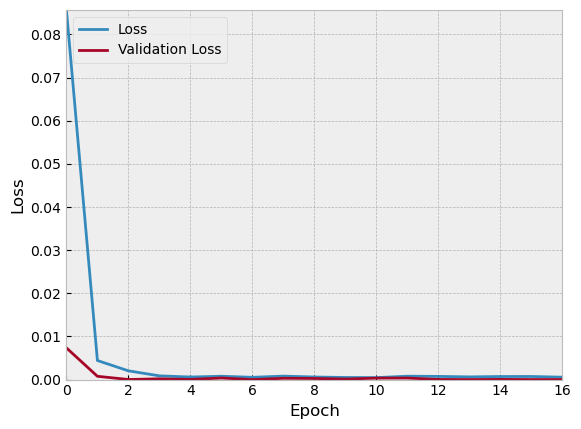

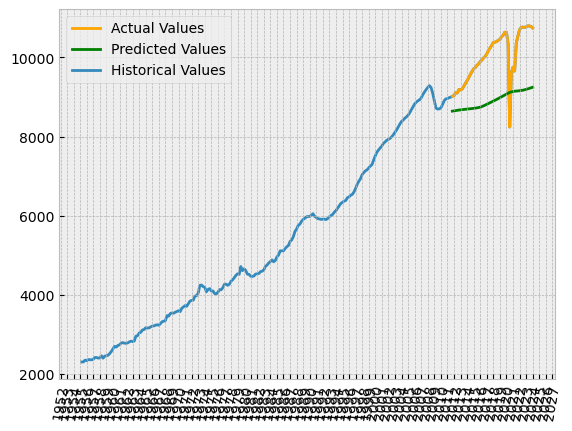

Epoch 1/50
20/20 [==============================] - 11s 149ms/step - loss: 0.1783 - val_loss: 0.0065
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0067 - val_loss: 9.4479e-04
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0019 - val_loss: 5.5022e-05
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 5.7642e-05
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 9.8326e-04 - val_loss: 3.7138e-04
Epoch 6/50
20/20 [==============================] - 0s 22ms/step - loss: 4.8484e-04 - val_loss: 2.3186e-04
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 5.5410e-04 - val_loss: 5.6853e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 4.4148e-04 - val_loss: 2.8454e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 4.6928e-04 - val_loss: 1.1545e-05
Epoch 10/50
20/20 [==============================] - 0s

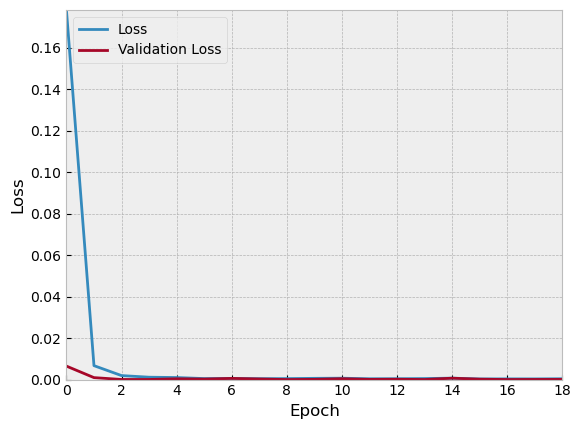

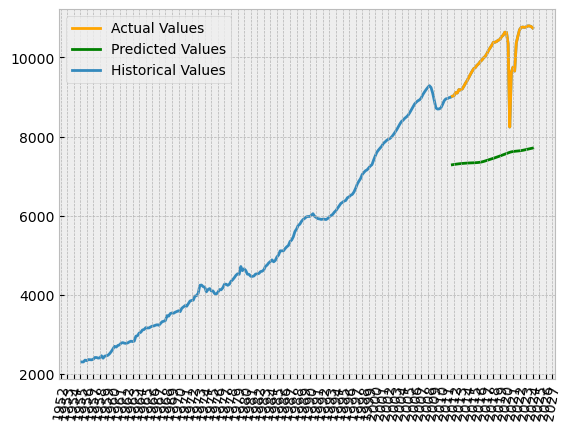

Epoch 1/50
20/20 [==============================] - 11s 144ms/step - loss: 0.1345 - val_loss: 0.0017
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0054 - val_loss: 0.0012
Epoch 3/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0011 - val_loss: 4.1298e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 3.8385e-04 - val_loss: 1.1031e-05
Epoch 5/50
20/20 [==============================] - 0s 25ms/step - loss: 6.3545e-04 - val_loss: 4.1965e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 5.1243e-04 - val_loss: 1.3844e-04
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 5.1384e-04 - val_loss: 2.4950e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 4.3197e-04 - val_loss: 4.0915e-04
Epoch 9/50
20/20 [==============================] - 0s 24ms/step - loss: 4.3719e-04 - val_loss: 1.9629e-04
Epoch 10/50
20/20 [==============================] - 0s

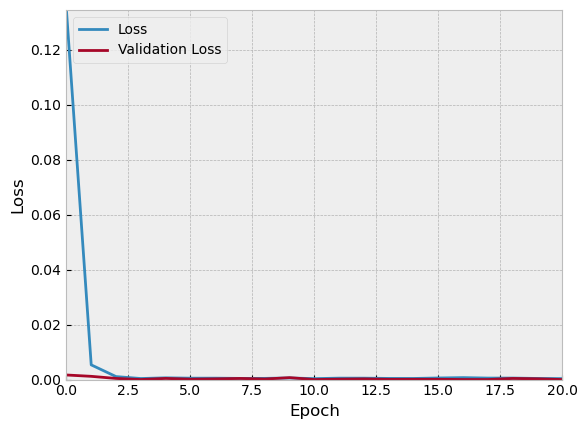

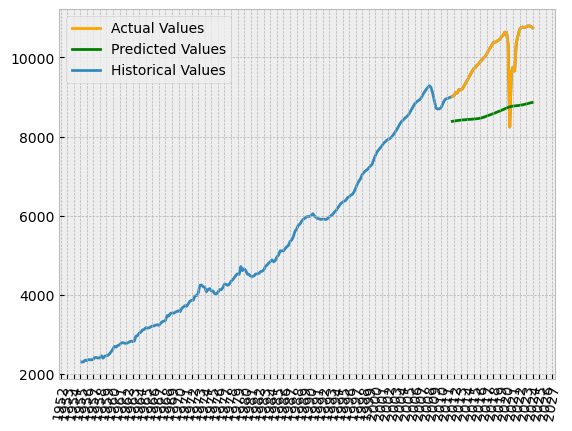

Epoch 1/50
20/20 [==============================] - 12s 154ms/step - loss: 0.0837 - val_loss: 0.0223
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0045 - val_loss: 5.6191e-04
Epoch 3/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0012 - val_loss: 2.1206e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0010 - val_loss: 9.4910e-05
Epoch 5/50
20/20 [==============================] - 0s 25ms/step - loss: 6.1850e-04 - val_loss: 1.2973e-05
Epoch 6/50
20/20 [==============================] - 1s 25ms/step - loss: 0.0012 - val_loss: 3.2509e-04
Epoch 7/50
20/20 [==============================] - 0s 25ms/step - loss: 7.5361e-04 - val_loss: 6.7014e-04
Epoch 8/50
20/20 [==============================] - 1s 26ms/step - loss: 5.6822e-04 - val_loss: 1.4321e-04
Epoch 9/50
20/20 [==============================] - 0s 24ms/step - loss: 6.7438e-04 - val_loss: 5.6702e-04
Epoch 10/50
20/20 [==============================] - 0s 24m

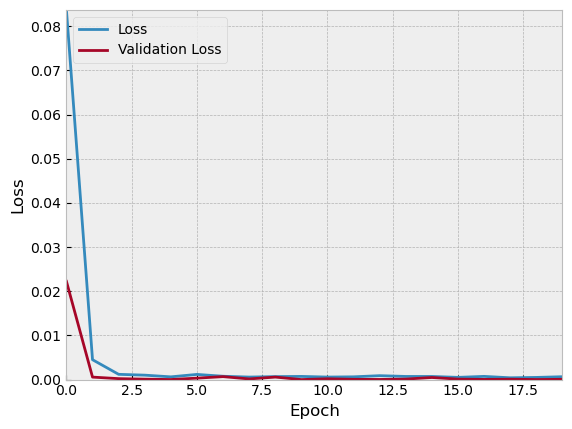

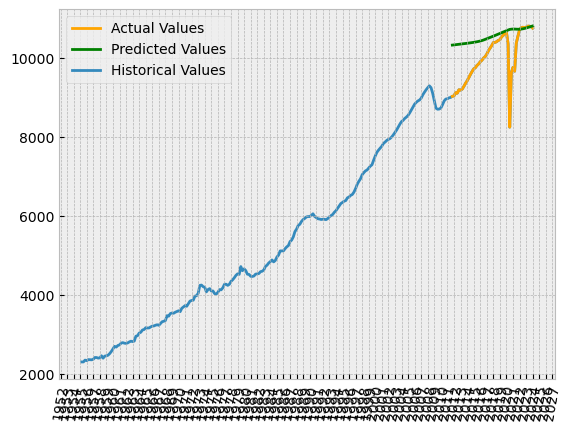

Epoch 1/50
20/20 [==============================] - 15s 159ms/step - loss: 0.1104 - val_loss: 0.0223
Epoch 2/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0062 - val_loss: 0.0036
Epoch 3/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0015 - val_loss: 1.1646e-04
Epoch 4/50
20/20 [==============================] - 0s 25ms/step - loss: 0.0011 - val_loss: 5.7037e-04
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0013 - val_loss: 5.1160e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 7.3258e-04 - val_loss: 4.3085e-05
Epoch 7/50
20/20 [==============================] - 0s 24ms/step - loss: 7.2995e-04 - val_loss: 1.7299e-04
Epoch 8/50
20/20 [==============================] - 0s 24ms/step - loss: 7.0412e-04 - val_loss: 3.5186e-05
Epoch 9/50
20/20 [==============================] - 1s 25ms/step - loss: 5.9537e-04 - val_loss: 2.7630e-05
Epoch 10/50
20/20 [==============================] - 0s 24ms/st

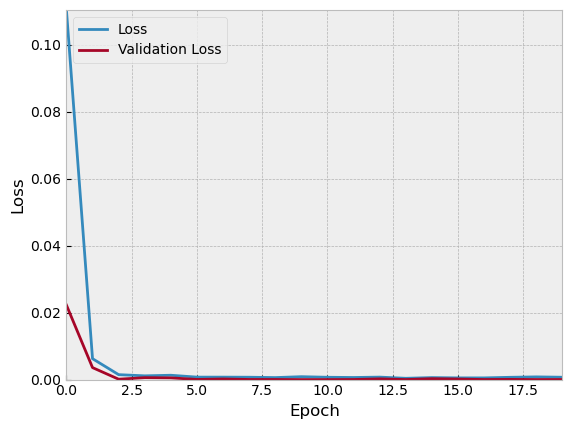

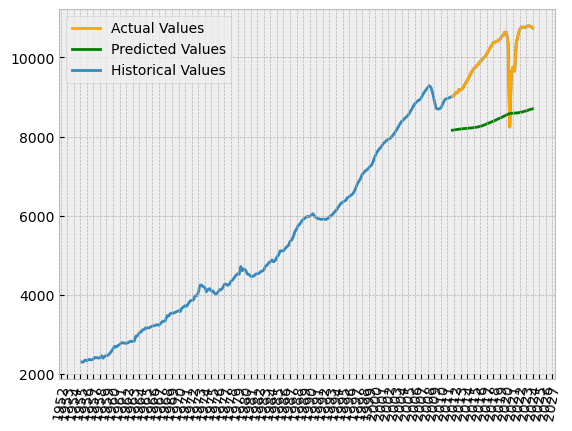

Epoch 1/50
20/20 [==============================] - 11s 147ms/step - loss: 0.1846 - val_loss: 0.0204
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0079 - val_loss: 0.0030
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0017 - val_loss: 1.4343e-04
Epoch 4/50
20/20 [==============================] - 0s 22ms/step - loss: 8.0576e-04 - val_loss: 1.8441e-04
Epoch 5/50
20/20 [==============================] - 0s 25ms/step - loss: 6.8854e-04 - val_loss: 5.1447e-05
Epoch 6/50
20/20 [==============================] - 0s 24ms/step - loss: 6.3702e-04 - val_loss: 3.2180e-06
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 5.0986e-04 - val_loss: 2.0630e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 5.4556e-04 - val_loss: 4.2095e-04
Epoch 9/50
20/20 [==============================] - 0s 22ms/step - loss: 2.9805e-04 - val_loss: 2.5675e-05
Epoch 10/50
20/20 [==============================] - 0s

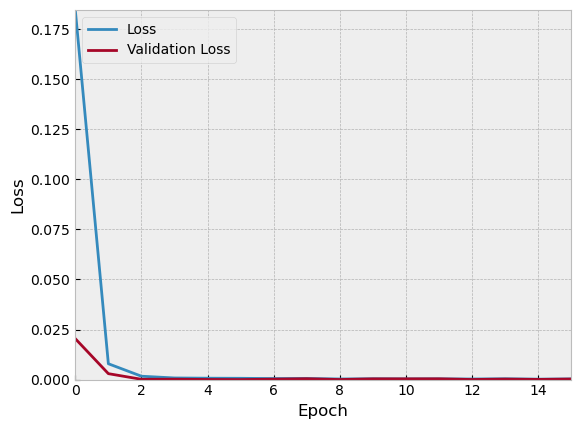

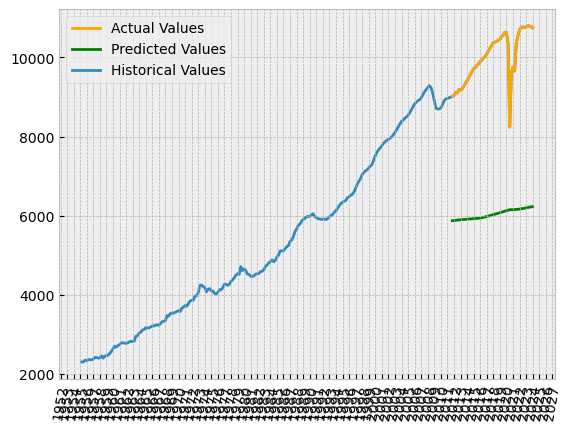

Epoch 1/50
20/20 [==============================] - 11s 149ms/step - loss: 0.1562 - val_loss: 0.0025
Epoch 2/50
20/20 [==============================] - 1s 26ms/step - loss: 0.0052 - val_loss: 3.3109e-05
Epoch 3/50
20/20 [==============================] - 0s 24ms/step - loss: 9.2551e-04 - val_loss: 3.8767e-06
Epoch 4/50
20/20 [==============================] - 0s 25ms/step - loss: 4.8455e-04 - val_loss: 7.0712e-05
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 6.3965e-04 - val_loss: 2.2942e-04
Epoch 6/50
20/20 [==============================] - 0s 25ms/step - loss: 3.8464e-04 - val_loss: 6.2839e-05
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 3.8051e-04 - val_loss: 1.8111e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 4.2192e-04 - val_loss: 3.1731e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 3.0968e-04 - val_loss: 5.4889e-04
Epoch 10/50
20/20 [============================

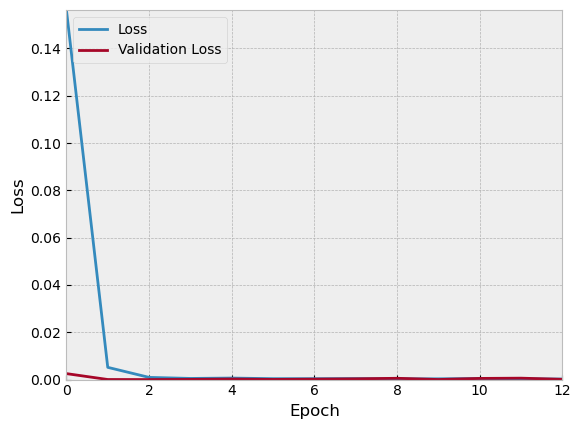

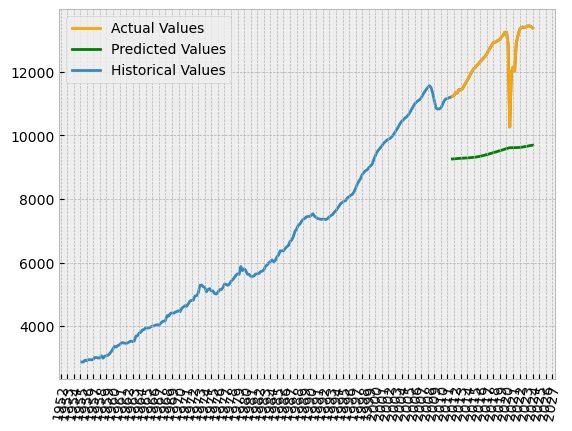

Epoch 1/50
20/20 [==============================] - 11s 151ms/step - loss: 0.1443 - val_loss: 0.0105
Epoch 2/50
20/20 [==============================] - 0s 24ms/step - loss: 0.0069 - val_loss: 0.0029
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 8.8911e-04 - val_loss: 8.6246e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 5.3221e-04 - val_loss: 2.9664e-06
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 7.5795e-04 - val_loss: 4.4632e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 4.1560e-04 - val_loss: 6.8564e-05
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 6.0434e-04 - val_loss: 6.5811e-06
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 6.2290e-04 - val_loss: 3.9812e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 4.3518e-04 - val_loss: 2.2530e-04
Epoch 10/50
20/20 [==============================] 

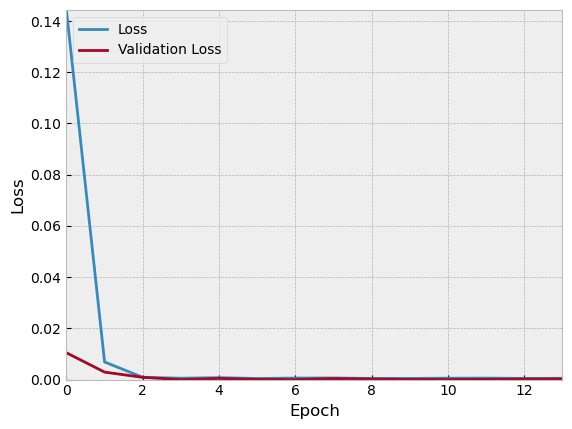

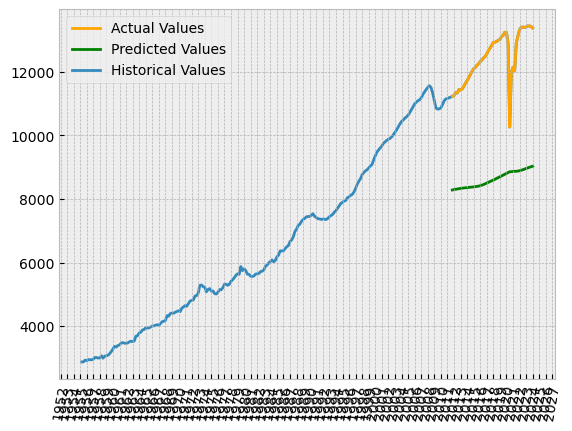

Epoch 1/50
20/20 [==============================] - 11s 141ms/step - loss: 0.1744 - val_loss: 0.0207
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0079 - val_loss: 0.0023
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0021 - val_loss: 3.9176e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0013 - val_loss: 8.4930e-05
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 7.8289e-04 - val_loss: 3.9959e-06
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 6.9274e-04 - val_loss: 3.0144e-05
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 6.7200e-04 - val_loss: 8.9220e-05
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 4.0679e-04 - val_loss: 4.4535e-05
Epoch 9/50
20/20 [==============================] - 0s 24ms/step - loss: 5.3708e-04 - val_loss: 2.2034e-04
Epoch 10/50
20/20 [==============================] - 0s 24m

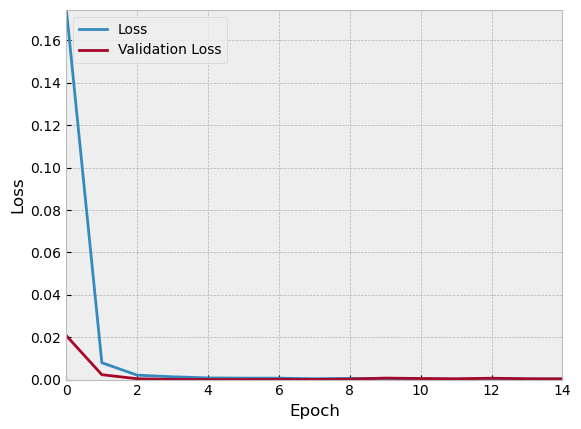

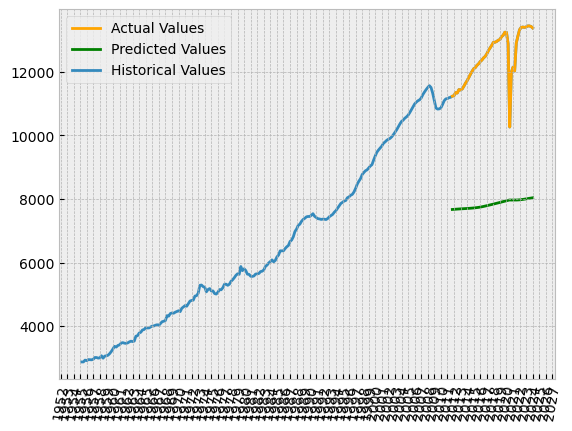

Epoch 1/50
20/20 [==============================] - 11s 148ms/step - loss: 0.1579 - val_loss: 0.0012
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0058 - val_loss: 6.4803e-05
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0014 - val_loss: 3.9073e-06
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 4.8911e-04 - val_loss: 8.2678e-06
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 5.7993e-04 - val_loss: 4.4135e-05
Epoch 6/50
20/20 [==============================] - 0s 22ms/step - loss: 7.3109e-04 - val_loss: 2.7045e-05
Epoch 7/50
20/20 [==============================] - 0s 22ms/step - loss: 4.6702e-04 - val_loss: 5.0655e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 4.5303e-04 - val_loss: 1.9728e-04
Epoch 9/50
20/20 [==============================] - 0s 22ms/step - loss: 4.0173e-04 - val_loss: 3.7687e-04
Epoch 10/50
20/20 [==============================] 

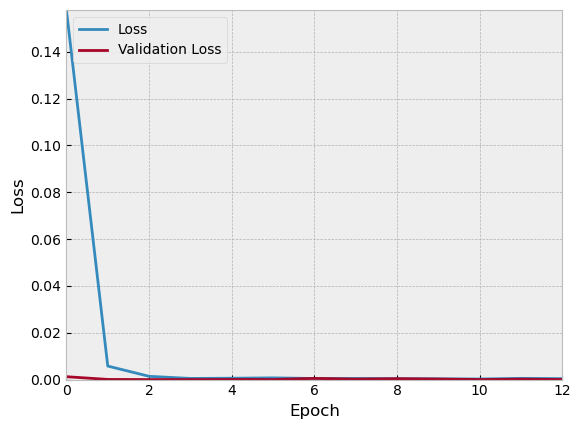

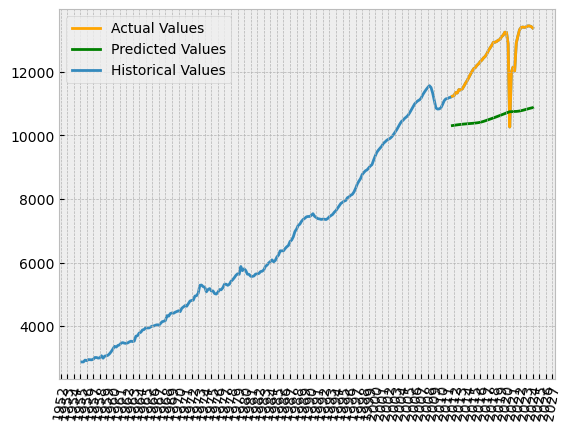

Epoch 1/50
20/20 [==============================] - 11s 155ms/step - loss: 0.1059 - val_loss: 0.0247
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0056 - val_loss: 0.0018
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 9.3941e-04 - val_loss: 3.1516e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 7.4072e-04 - val_loss: 2.2380e-06
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 8.4609e-04 - val_loss: 2.7495e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 8.1550e-04 - val_loss: 7.8878e-05
Epoch 7/50
20/20 [==============================] - 1s 26ms/step - loss: 8.9194e-04 - val_loss: 6.0891e-06
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0012 - val_loss: 7.6928e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 6.5718e-04 - val_loss: 1.4127e-04
Epoch 10/50
20/20 [==============================] - 0s

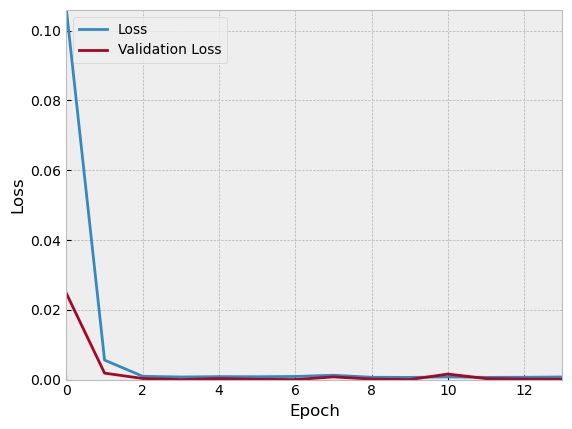

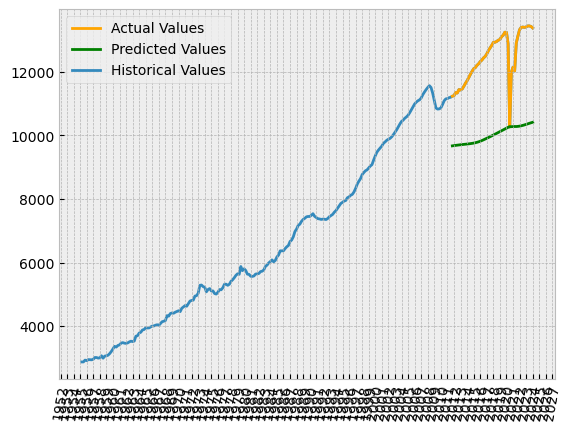

Epoch 1/50
20/20 [==============================] - 11s 148ms/step - loss: 0.1170 - val_loss: 0.0186
Epoch 2/50
20/20 [==============================] - 0s 25ms/step - loss: 0.0042 - val_loss: 0.0018
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 8.0707e-04 - val_loss: 7.1659e-06
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 7.6239e-04 - val_loss: 4.0067e-05
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 7.6769e-04 - val_loss: 2.4461e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 5.0909e-04 - val_loss: 1.1590e-05
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 8.5231e-04 - val_loss: 2.2157e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 5.0661e-04 - val_loss: 5.8075e-06
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 7.9946e-04 - val_loss: 4.8681e-04
Epoch 10/50
20/20 [==============================] 

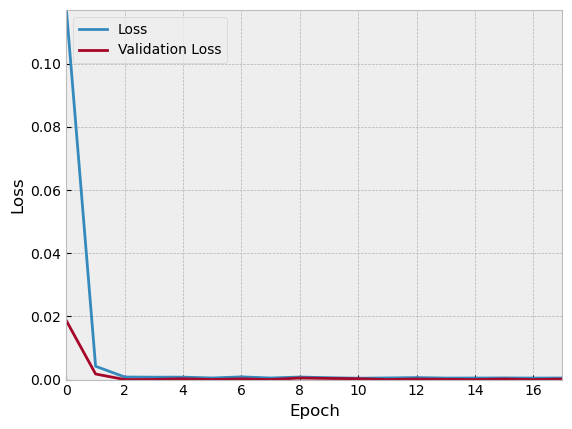

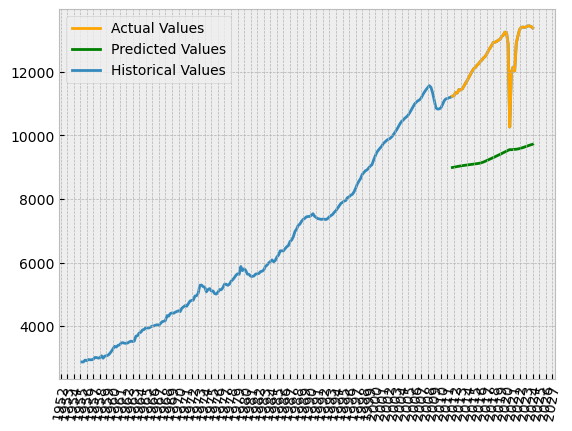

Epoch 1/50
20/20 [==============================] - 11s 144ms/step - loss: 0.0688 - val_loss: 0.0013
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0053 - val_loss: 0.0022
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0019 - val_loss: 7.3077e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0010 - val_loss: 5.0445e-05
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 9.8651e-06
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 7/50
20/20 [==============================] - 0s 22ms/step - loss: 8.9878e-04 - val_loss: 7.8056e-06
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 9.4232e-04 - val_loss: 8.0351e-05
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 9.4070e-04 - val_loss: 2.9172e-04
Epoch 10/50
20/20 [==============================] - 0s 23ms/step - los

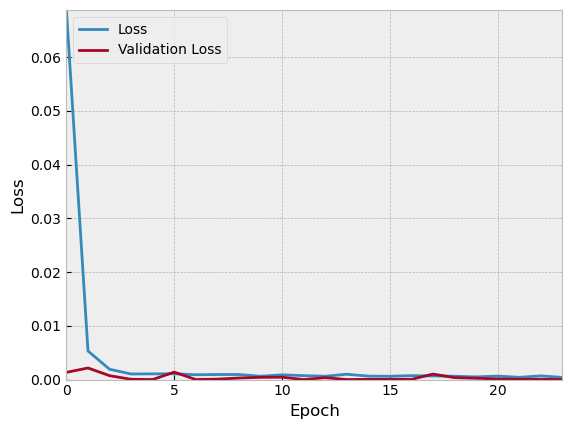

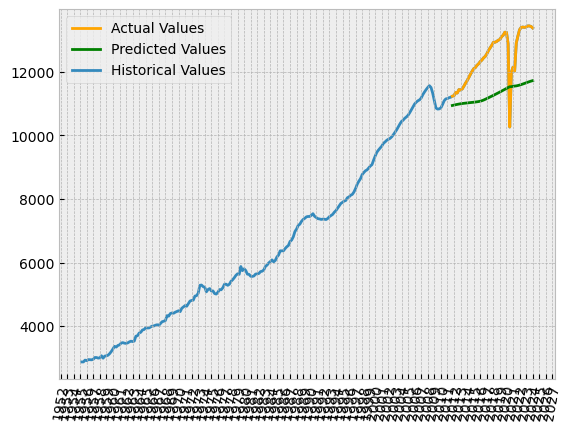

Epoch 1/50
20/20 [==============================] - 11s 144ms/step - loss: 0.1275 - val_loss: 0.0058
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0057 - val_loss: 0.0021
Epoch 3/50
20/20 [==============================] - 0s 23ms/step - loss: 6.7835e-04 - val_loss: 2.0904e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 5.1814e-04 - val_loss: 2.7865e-05
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 7.1477e-04 - val_loss: 4.0441e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 4.1303e-04 - val_loss: 6.1011e-05
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 5.8381e-04 - val_loss: 5.8550e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 4.5341e-04 - val_loss: 3.3843e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 3.9296e-04 - val_loss: 7.1175e-04
Epoch 10/50
20/20 [==============================] 

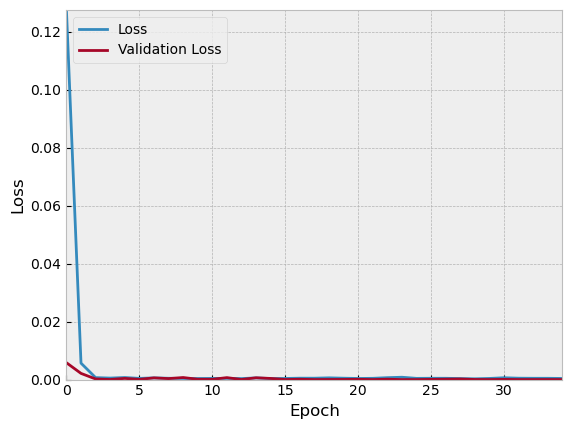

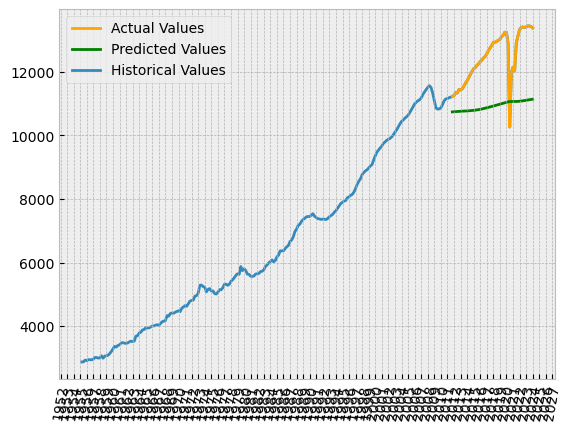

Epoch 1/50
20/20 [==============================] - 11s 145ms/step - loss: 0.1282 - val_loss: 0.0286
Epoch 2/50
20/20 [==============================] - 1s 29ms/step - loss: 0.0055 - val_loss: 0.0031
Epoch 3/50
20/20 [==============================] - 1s 26ms/step - loss: 0.0010 - val_loss: 3.4239e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 6.8741e-04 - val_loss: 8.4250e-06
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 8.3853e-04 - val_loss: 8.8832e-05
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 6.6950e-04 - val_loss: 5.2715e-04
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 7.6636e-04 - val_loss: 1.9123e-04
Epoch 8/50
20/20 [==============================] - 0s 23ms/step - loss: 6.8235e-04 - val_loss: 5.4405e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 5.5725e-04 - val_loss: 1.0245e-04
Epoch 10/50
20/20 [==============================] - 0s

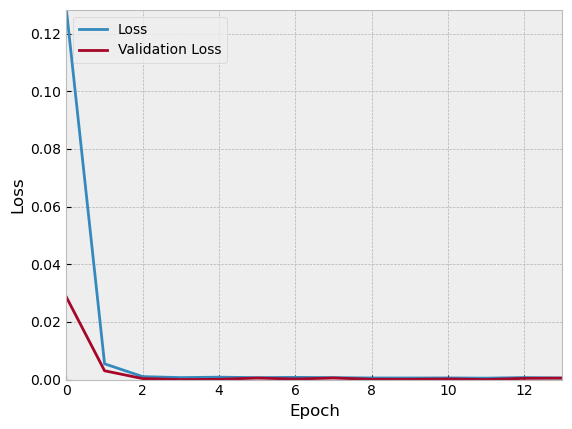

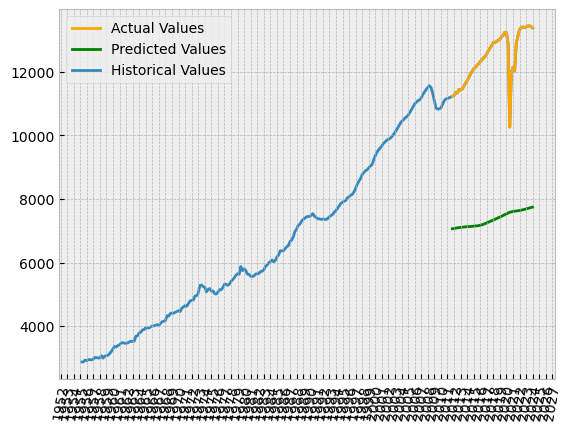

Epoch 1/50
20/20 [==============================] - 11s 148ms/step - loss: 0.1203 - val_loss: 0.0053
Epoch 2/50
20/20 [==============================] - 0s 23ms/step - loss: 0.0051 - val_loss: 0.0015
Epoch 3/50
20/20 [==============================] - 0s 24ms/step - loss: 9.3678e-04 - val_loss: 3.1804e-04
Epoch 4/50
20/20 [==============================] - 0s 23ms/step - loss: 6.1486e-04 - val_loss: 4.2924e-06
Epoch 5/50
20/20 [==============================] - 0s 23ms/step - loss: 5.4661e-04 - val_loss: 1.0005e-04
Epoch 6/50
20/20 [==============================] - 0s 23ms/step - loss: 5.7111e-04 - val_loss: 2.3353e-04
Epoch 7/50
20/20 [==============================] - 0s 23ms/step - loss: 5.6390e-04 - val_loss: 1.6234e-04
Epoch 8/50
20/20 [==============================] - 1s 27ms/step - loss: 6.5370e-04 - val_loss: 5.6145e-04
Epoch 9/50
20/20 [==============================] - 0s 23ms/step - loss: 4.6408e-04 - val_loss: 3.3125e-05
Epoch 10/50
20/20 [==============================] 

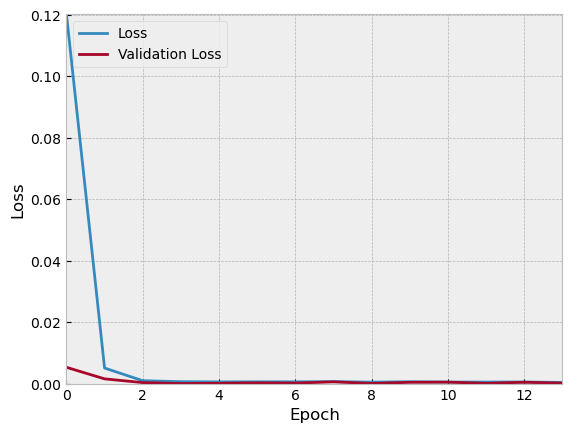

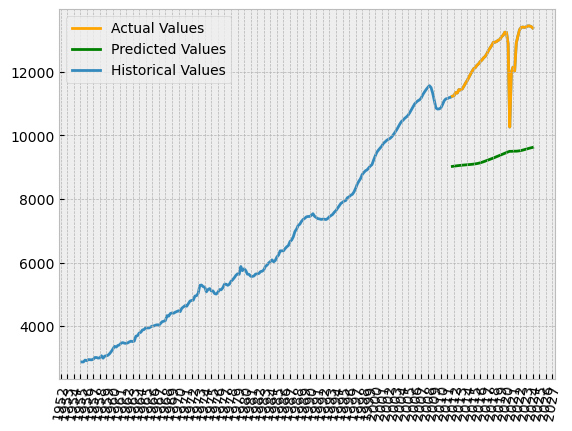

In [370]:
findFolder = ["A","B","C","D","E","F","G","H","I","J","K","L","M","N","O","P","Q","R","S"]

for fideration in range(2,13):
    for iteration in range(0,10):
        lmodel = tuner.hypermodel.build(best_hps)
        #lmodel.summary()

        stop_early = keras.callbacks.EarlyStopping(monitor='val_loss', patience=10) # Exit early if loss rises too much

        ltsmhistory = lmodel.fit(
            splitData[fideration]["x_train"],
            splitData[fideration]["y_train"],
            epochs=50,
            batch_size=8,
            shuffle=False,
            validation_split=0.2,
            callbacks=[stop_early]
        )

        y_pred = lmodel.predict(splitData[fideration]["x_test"])
        old_pred = lmodel.predict(splitData[fideration]["x_train"])

        y_test_orig = scaler.inverse_transform(splitData[fideration]["y_test"].reshape(-1,1))
        y_pred_orig = scaler.inverse_transform(y_pred.reshape(-1,1))
        old_pred_orig = scaler.inverse_transform(old_pred.reshape(-1,1))

        plt.style.use('bmh')

        plt.plot(ltsmhistory.history['loss'], label='Loss')
        plt.plot(ltsmhistory.history['val_loss'], label = 'Validation Loss') # Theres a lot of data so these start pretty low
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.ylim([0, max(ltsmhistory.history['loss'])])
        plt.xlim([0, len(ltsmhistory.history['loss'])-1])
        plt.legend(loc='upper left')


        # make a prediction
        mse = mean_squared_error(y_test_orig,y_pred_orig)
        mae = mean_absolute_error(y_test_orig,y_pred_orig)
        mape = mean_absolute_percentage_error(y_test_orig,y_pred_orig)*100
        r2 = r2_score(y_test_orig,y_pred_orig)
        print("R²= {:.3f}\nMAPE={:.3f}%\nMAE={:.3f}".format(r2,mape,mae))

        fig,ax = plt.subplots()

        historical = df.iloc[fideration,:]

        ax.plot(historical.tail(50).index, y_test_orig, color='orange', label='Actual Values',zorder=0)
        ax.plot(historical.tail(50).index, y_pred_orig, color='green', label='Predicted Values',zorder=1)
        #ax.plot(historical.iloc[-20:-4].index, old_pred_orig, color='red', label='Testing Values',zorder=1)

        ax.xaxis.set_major_locator(mdates.YearLocator())
        ax.tick_params(axis='x', rotation=80)

        ax.plot(historical.index,historical.values,zorder=-1,label="Historical Values")
        ax.legend()
        plt.show()

        lmodel.save(f'savedModels/zTurnoverLstm/{findFolder[fideration]}/Trial{iteration}/model.keras')

# SVM

In [286]:
from sklearn import svm
from sklearn.model_selection import GridSearchCV
from joblib import dump, load

In [290]:
parameters = {
    "kernel": ["rbf"],
    "C": [0.1,1,10,100,1000],
    "gamma": [1e-8, 1e-7, 1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1],
    "epsilon": [0.1,0.01,0.001,0.0001,0.00001]
    }

svre = GridSearchCV(svm.SVR(), parameters, cv=5, verbose=2)
svre.fit(splitData[0]["x_train"].reshape(197,29),splitData[0]["y_train"].reshape(197))

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
[CV] END ........C=0.1, epsilon=0.1, gamma=1e-08, kernel=rbf; total time=   0.0s
[CV] END ........C=0.1, epsilon=0.1, gamma=1e-08, kernel=rbf; total time=   0.0s
[CV] END ........C=0.1, epsilon=0.1, gamma=1e-08, kernel=rbf; total time=   0.0s
[CV] END ........C=0.1, epsilon=0.1, gamma=1e-08, kernel=rbf; total time=   0.0s
[CV] END ........C=0.1, epsilon=0.1, gamma=1e-08, kernel=rbf; total time=   0.0s
[CV] END ........C=0.1, epsilon=0.1, gamma=1e-07, kernel=rbf; total time=   0.0s
[CV] END ........C=0.1, epsilon=0.1, gamma=1e-07, kernel=rbf; total time=   0.0s
[CV] END ........C=0.1, epsilon=0.1, gamma=1e-07, kernel=rbf; total time=   0.0s
[CV] END ........C=0.1, epsilon=0.1, gamma=1e-07, kernel=rbf; total time=   0.0s
[CV] END ........C=0.1, epsilon=0.1, gamma=1e-07, kernel=rbf; total time=   0.0s
[CV] END ........C=0.1, epsilon=0.1, gamma=1e-06, kernel=rbf; total time=   0.0s
[CV] END ........C=0.1, epsilon=0.1, gamma=1e

GridSearchCV(cv=5, estimator=SVR(),
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'epsilon': [0.1, 0.01, 0.001, 0.0001, 1e-05],
                         'gamma': [1e-08, 1e-07, 1e-06, 1e-05, 0.0001, 0.001,
                                   0.01, 0.1],
                         'kernel': ['rbf']},
             verbose=2)

In [291]:
svre.best_params_

{'C': 1000, 'epsilon': 1e-05, 'gamma': 0.1, 'kernel': 'rbf'}

In [292]:
y_pred = svre.predict(splitData[0]["x_test"].reshape(50,29))
old_pred = svre.predict(splitData[0]["x_train"].reshape(197,29))

y_test_orig = scaler.inverse_transform(splitData[0]["y_test"].reshape(-1,1))
y_pred_orig = scaler.inverse_transform(y_pred.reshape(-1,1))
old_pred_orig = scaler.inverse_transform(old_pred.reshape(-1,1))

In [293]:
plt.style.use('bmh')

# make a prediction
mse = mean_squared_error(y_test_orig,y_pred_orig)
mae = mean_absolute_error(y_test_orig,y_pred_orig)
mape = mean_absolute_percentage_error(y_test_orig,y_pred_orig)*100
r2 = r2_score(y_test_orig,y_pred_orig)

#fig,ax = plt.subplots()
#ax.scatter(y_pred_orig,y_test_orig)

#ax.plot(y_test_orig,y_test_orig,color="black",linestyle=":")
#ax.plot((r2 * y_test_orig),y_test_orig,color="red",linestyle=":")


#ax.set_ylim([min(y_test_orig),max(y_test_orig)])
#ax.set_xlim([min(y_test_orig),max(y_pred_orig)])

#ax.annotate("R²= {:.3f}\nMAPE={:.3f}%\nMAE={:.3f}".format(r2,mape,mae),(min(y_test_orig),0.99*max(y_test_orig)))
#ax.set_title("Real against estimated Start Up Delay values")
#ax.set_ylabel("Real Value")
#ax.set_xlabel("Estimated Value")
#plt.show()

print("R²= {:.3f}\nMAPE={:.3f}%\nMAE={:.3f}".format(r2,mape,mae))

R²= 0.559
MAPE=1.900%
MAE=657.939


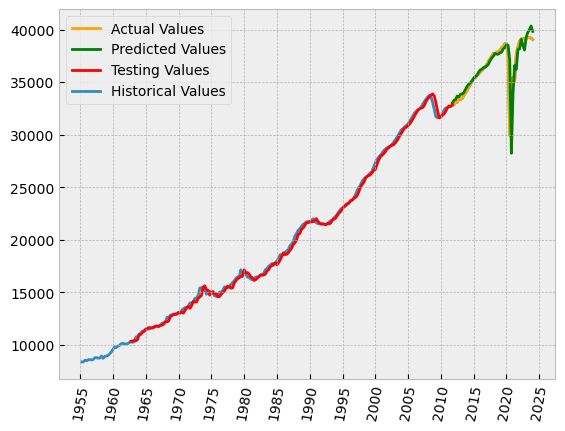

In [295]:
fig,ax = plt.subplots()

historical = df.iloc[0,:]

ax.plot(historical.tail(50).index, y_test_orig, color='orange', label='Actual Values',zorder=0)
ax.plot(historical.tail(50).index, y_pred_orig, color='green', label='Predicted Values',zorder=1)
ax.plot(historical.iloc[30:227].index, old_pred_orig, color='red', label='Testing Values',zorder=1)

ax.xaxis.set_major_locator(mdates.YearLocator(5))
ax.tick_params(axis='x', rotation=80)

ax.plot(historical.index,historical.values,zorder=-1,label="Historical Values")
ax.legend()
plt.show()

In [296]:
dump(svre,f'savedModels/zTurnoverSvm/A/Trial0/model.joblib')

['savedModels/zTurnoverSvm/A/Trial0/model.joblib']

In [297]:
clf = load('savedModels/zTurnoverSvm/A/Trial0/model.joblib')

R²= 0.559
MAPE=1.900%
MAE=657.939


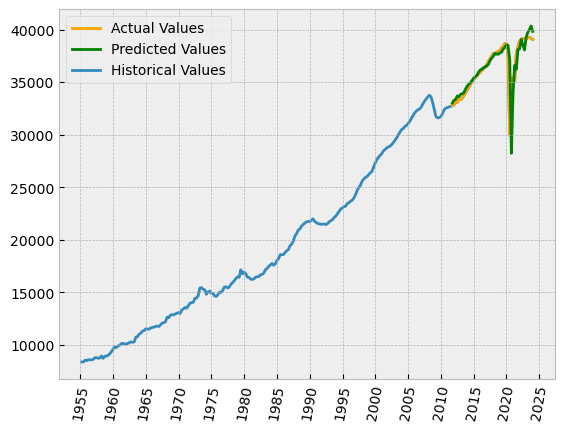

R²= 0.559
MAPE=1.900%
MAE=657.939


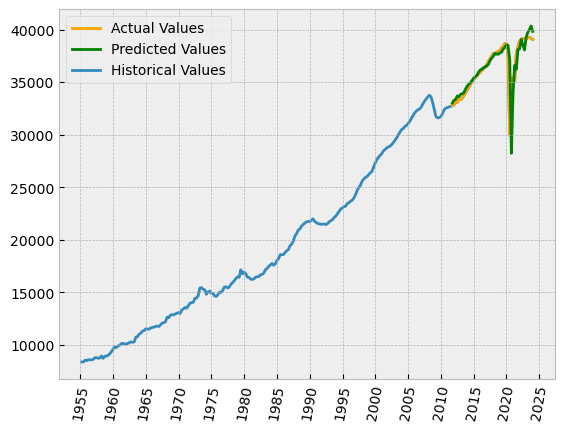

R²= 0.559
MAPE=1.900%
MAE=657.939


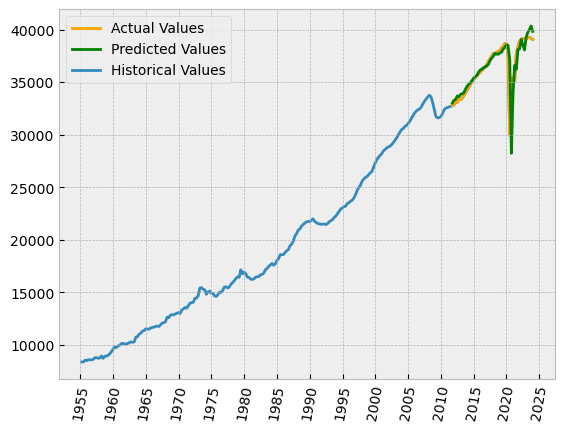

R²= 0.559
MAPE=1.900%
MAE=657.939


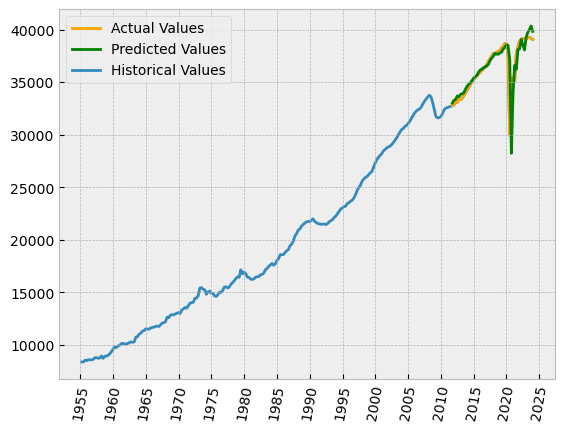

R²= 0.559
MAPE=1.900%
MAE=657.939


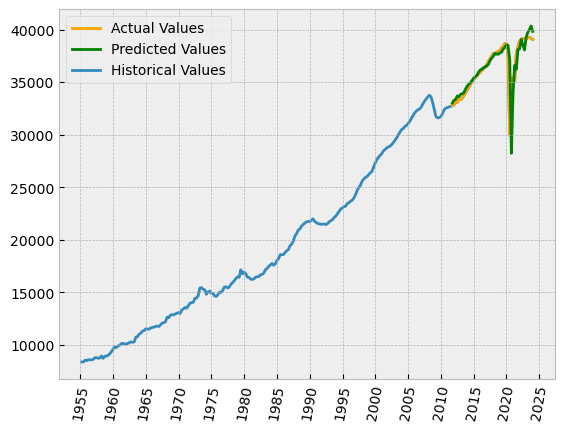

R²= 0.559
MAPE=1.900%
MAE=657.939


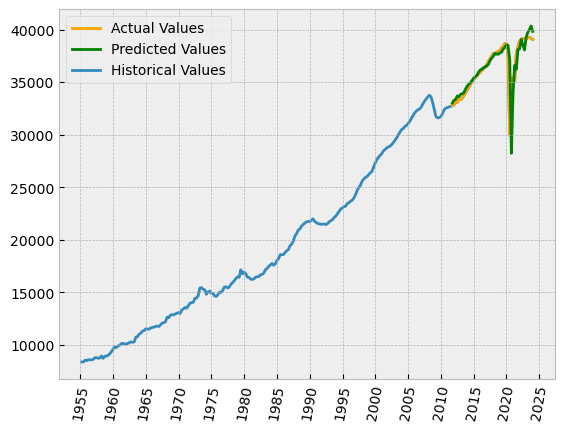

R²= 0.559
MAPE=1.900%
MAE=657.939


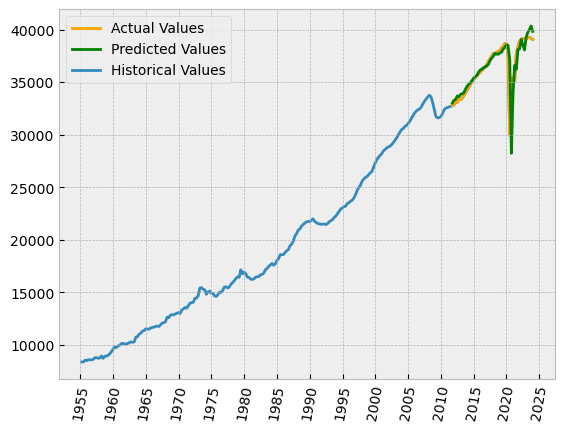

R²= 0.559
MAPE=1.900%
MAE=657.939


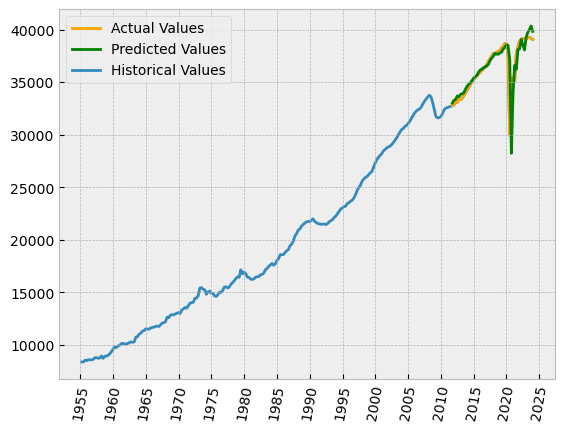

R²= 0.559
MAPE=1.900%
MAE=657.939


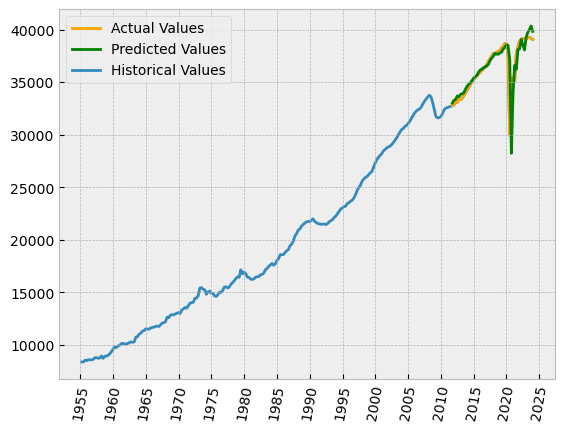

R²= 0.559
MAPE=1.900%
MAE=657.939


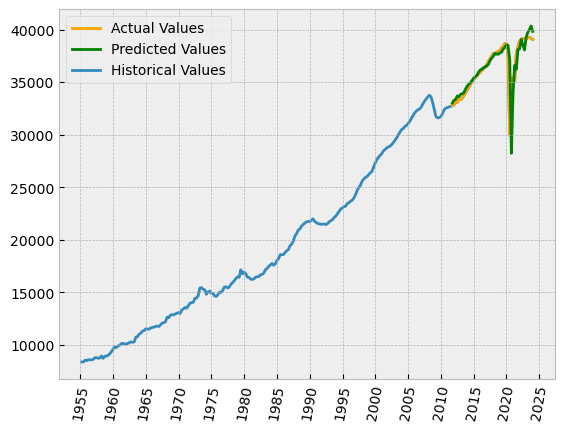

R²= 0.668
MAPE=1.331%
MAE=113.590


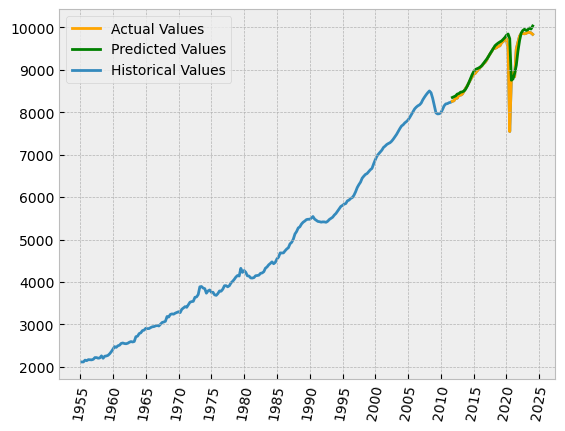

R²= 0.668
MAPE=1.331%
MAE=113.590


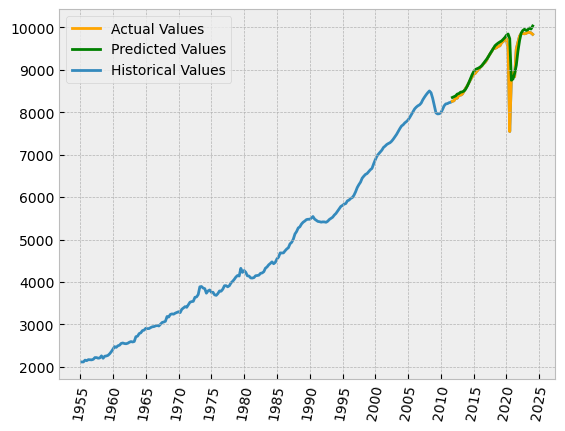

R²= 0.668
MAPE=1.331%
MAE=113.590


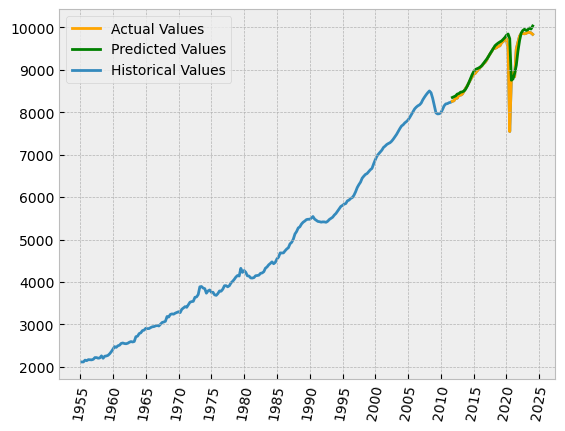

R²= 0.668
MAPE=1.331%
MAE=113.590


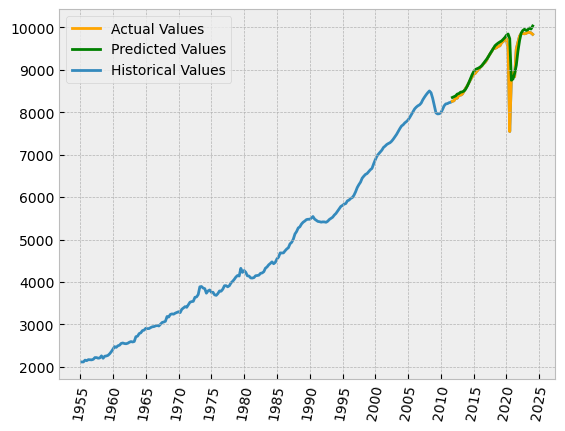

R²= 0.668
MAPE=1.331%
MAE=113.590


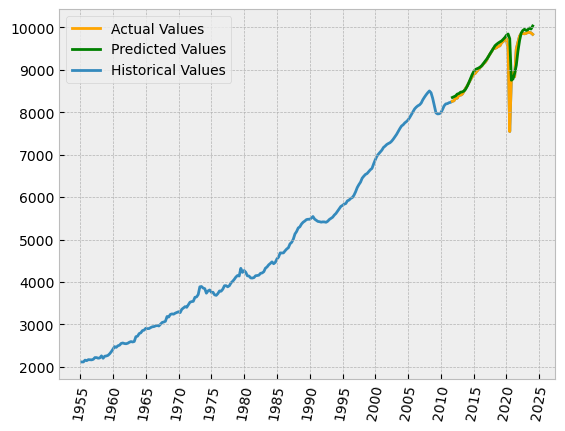

R²= 0.668
MAPE=1.331%
MAE=113.590


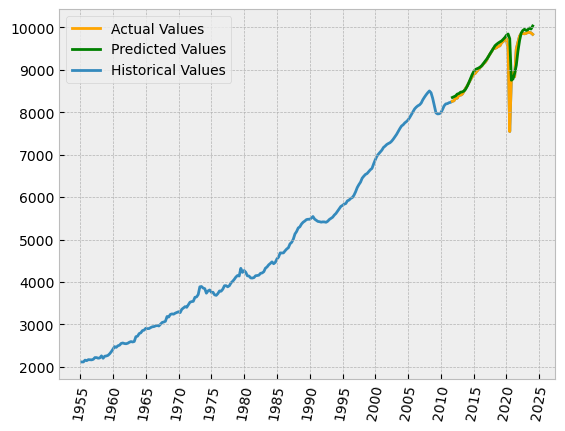

R²= 0.668
MAPE=1.331%
MAE=113.590


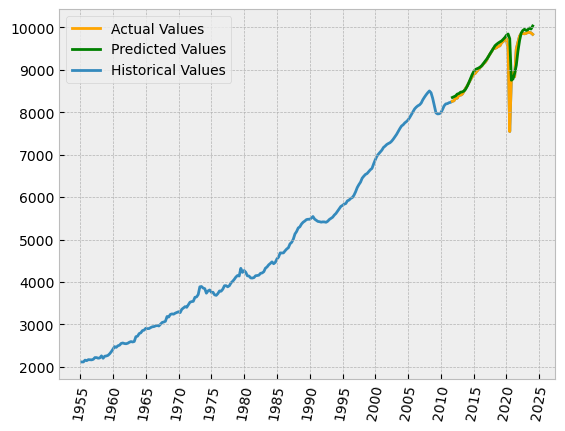

R²= 0.668
MAPE=1.331%
MAE=113.590


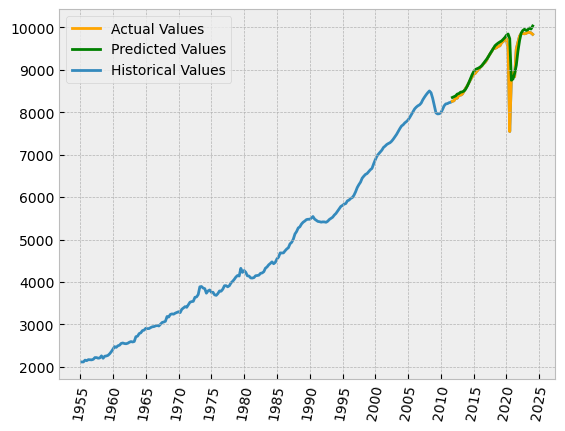

R²= 0.668
MAPE=1.331%
MAE=113.590


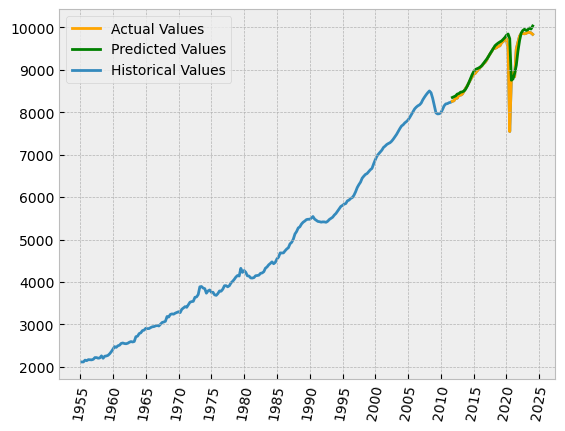

R²= 0.668
MAPE=1.331%
MAE=113.590


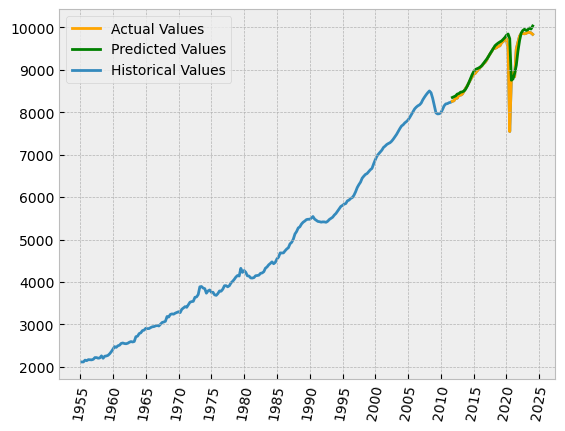

R²= 0.638
MAPE=1.413%
MAE=4511.841


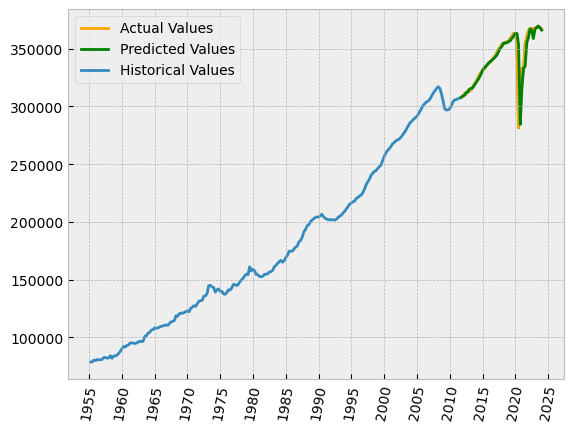

R²= 0.638
MAPE=1.413%
MAE=4511.841


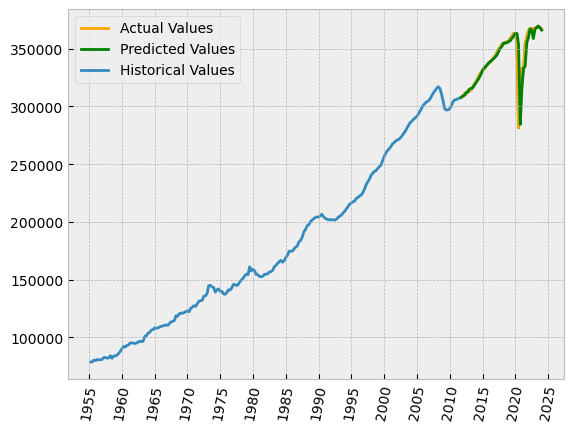

R²= 0.638
MAPE=1.413%
MAE=4511.841


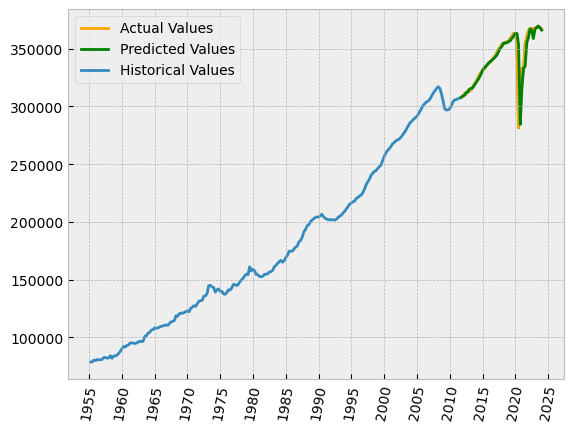

R²= 0.638
MAPE=1.413%
MAE=4511.841


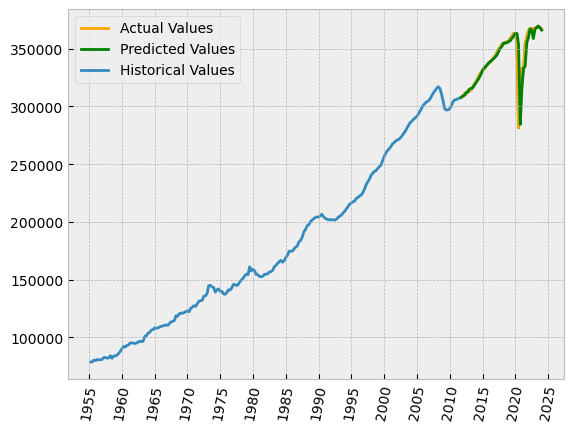

R²= 0.638
MAPE=1.413%
MAE=4511.841


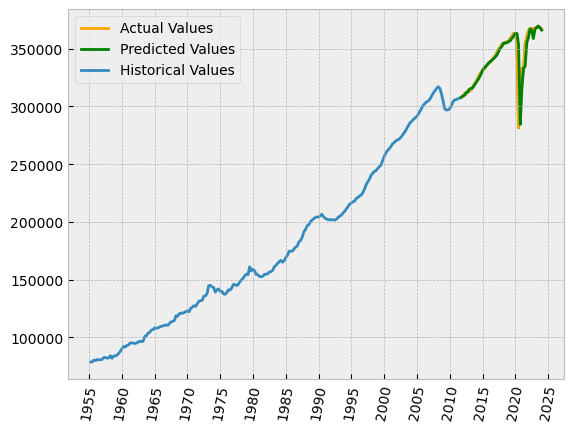

R²= 0.638
MAPE=1.413%
MAE=4511.841


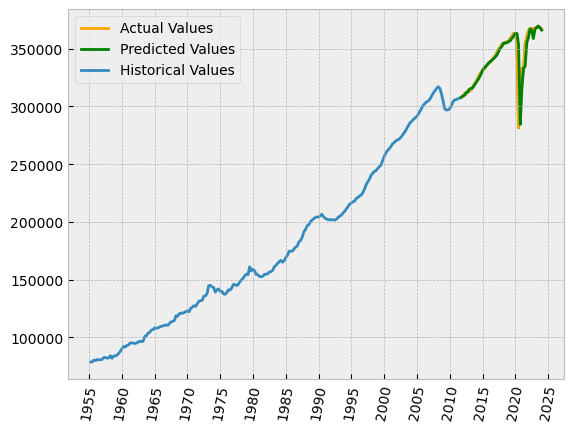

R²= 0.638
MAPE=1.413%
MAE=4511.841


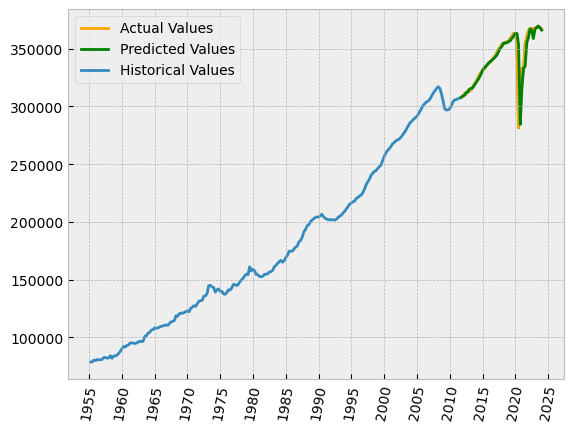

R²= 0.638
MAPE=1.413%
MAE=4511.841


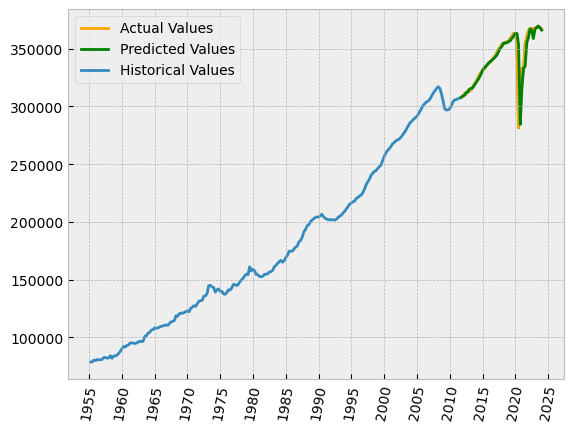

R²= 0.638
MAPE=1.413%
MAE=4511.841


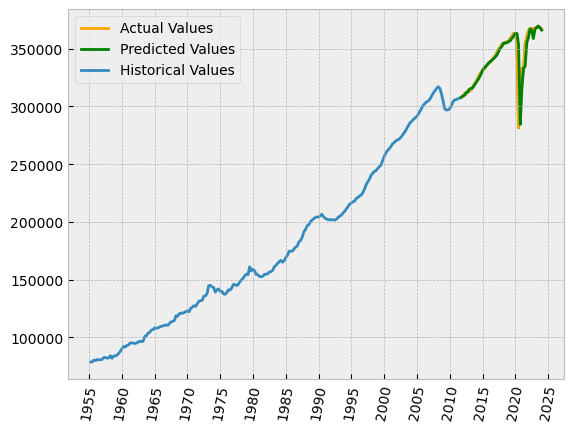

R²= 0.638
MAPE=1.413%
MAE=4511.841


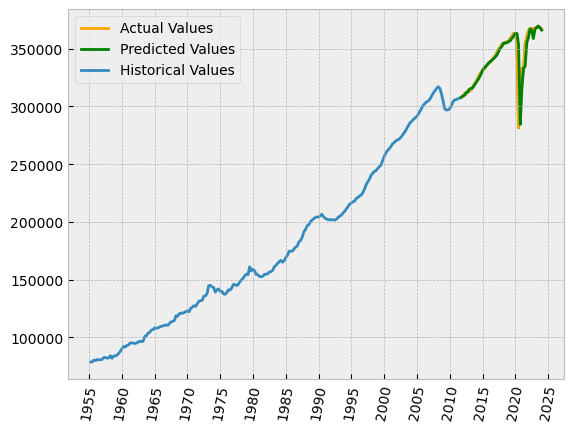

R²= 0.557
MAPE=1.700%
MAE=671.154


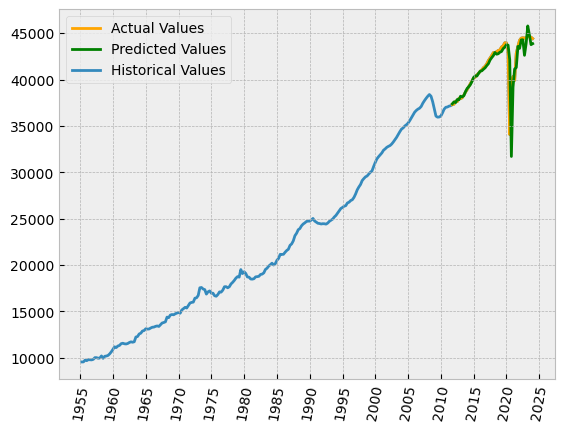

R²= 0.557
MAPE=1.700%
MAE=671.154


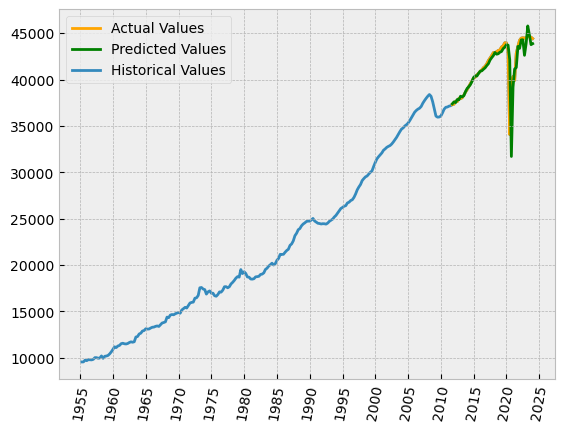

R²= 0.557
MAPE=1.700%
MAE=671.154


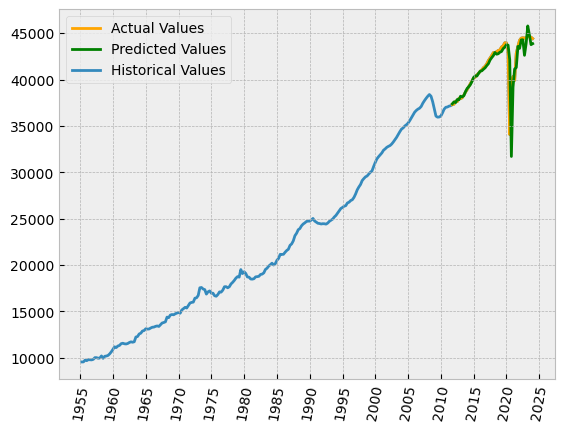

R²= 0.557
MAPE=1.700%
MAE=671.154


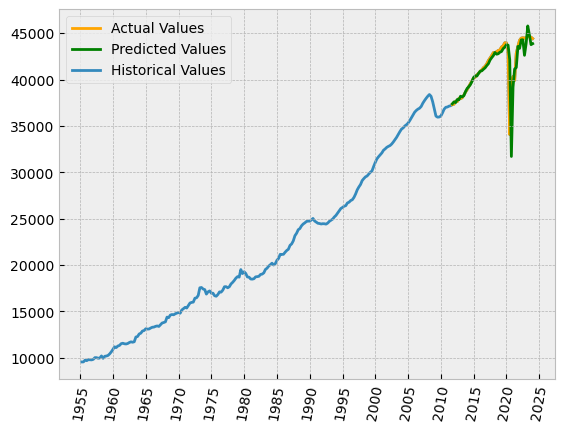

R²= 0.557
MAPE=1.700%
MAE=671.154


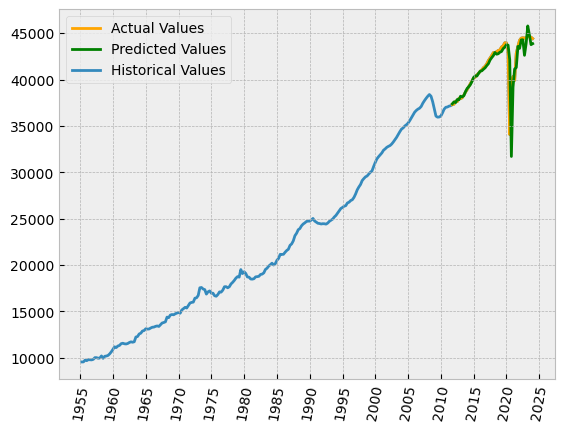

R²= 0.557
MAPE=1.700%
MAE=671.154


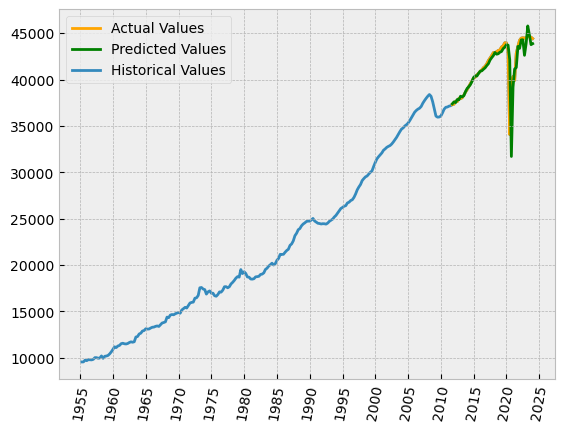

R²= 0.557
MAPE=1.700%
MAE=671.154


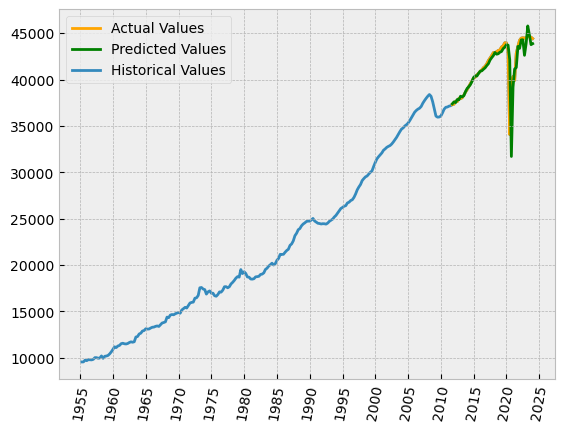

R²= 0.557
MAPE=1.700%
MAE=671.154


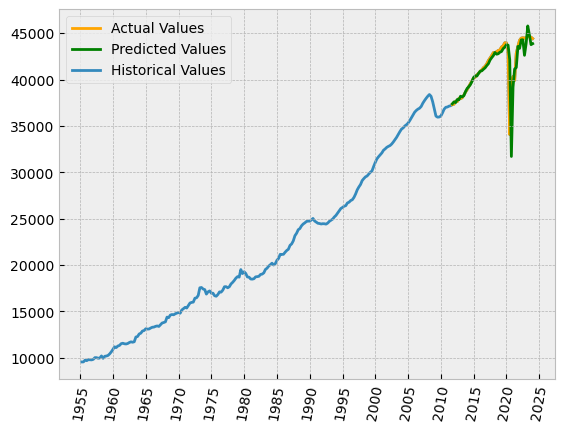

R²= 0.557
MAPE=1.700%
MAE=671.154


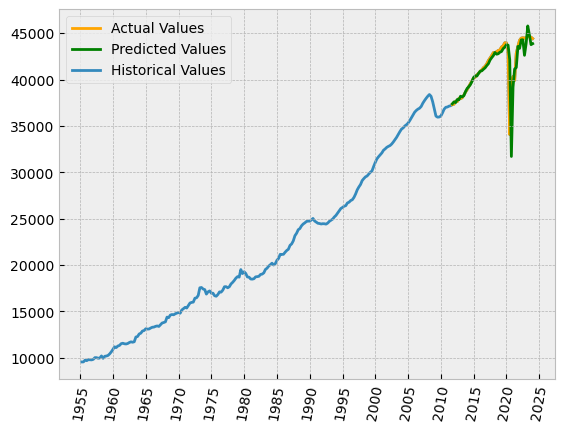

R²= 0.557
MAPE=1.700%
MAE=671.154


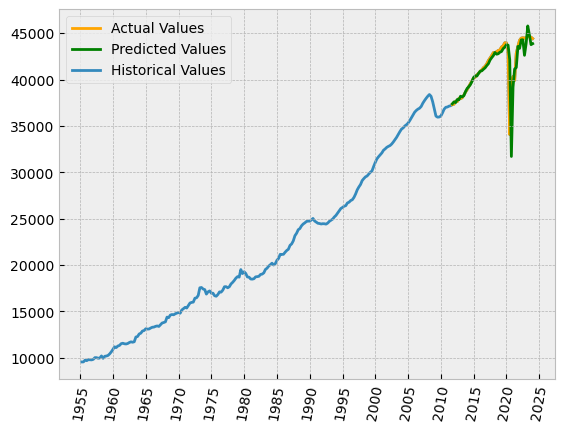

R²= 0.614
MAPE=1.879%
MAE=362.230


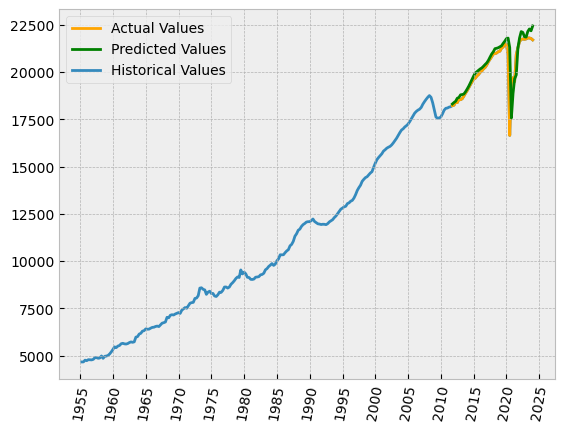

R²= 0.614
MAPE=1.879%
MAE=362.230


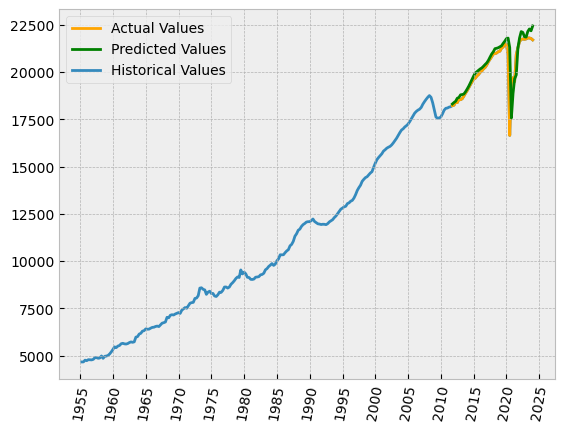

R²= 0.614
MAPE=1.879%
MAE=362.230


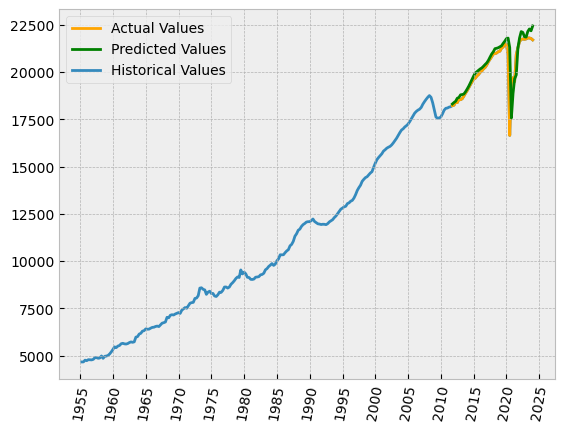

R²= 0.614
MAPE=1.879%
MAE=362.230


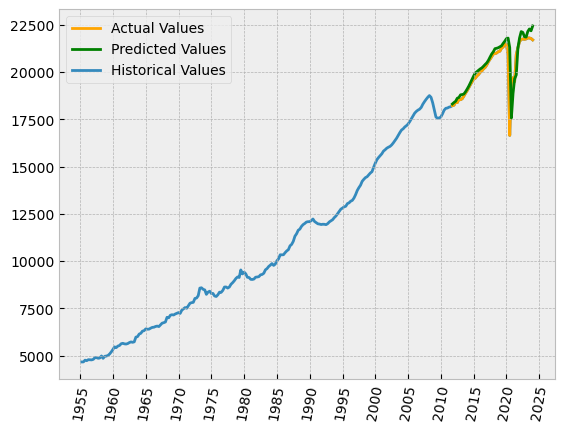

R²= 0.614
MAPE=1.879%
MAE=362.230


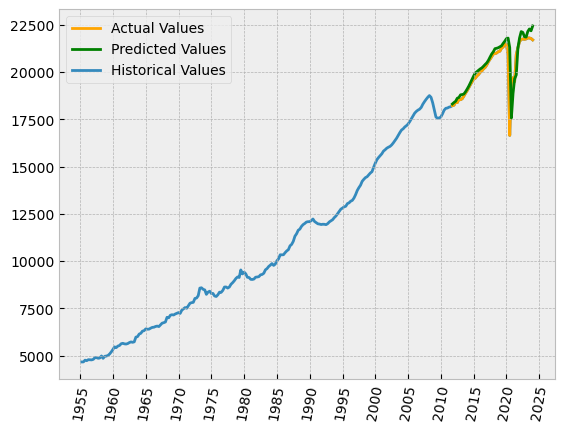

R²= 0.614
MAPE=1.879%
MAE=362.230


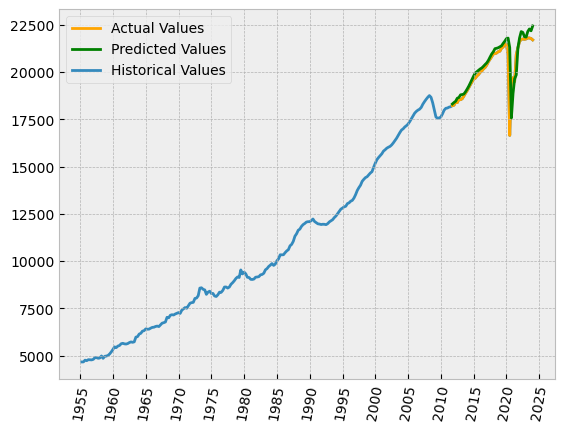

R²= 0.614
MAPE=1.879%
MAE=362.230


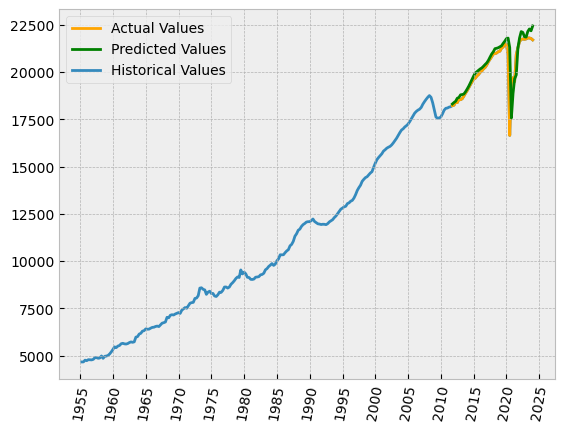

R²= 0.614
MAPE=1.879%
MAE=362.230


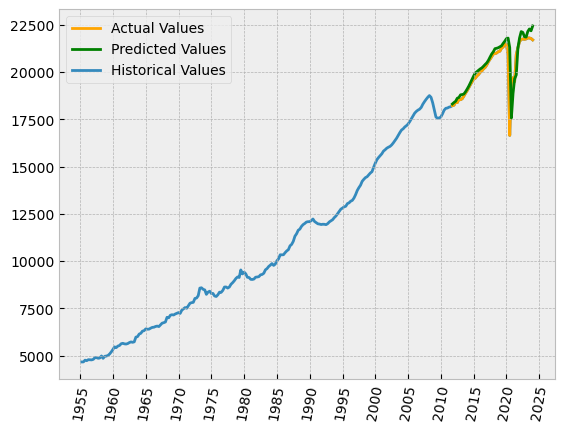

R²= 0.614
MAPE=1.879%
MAE=362.230


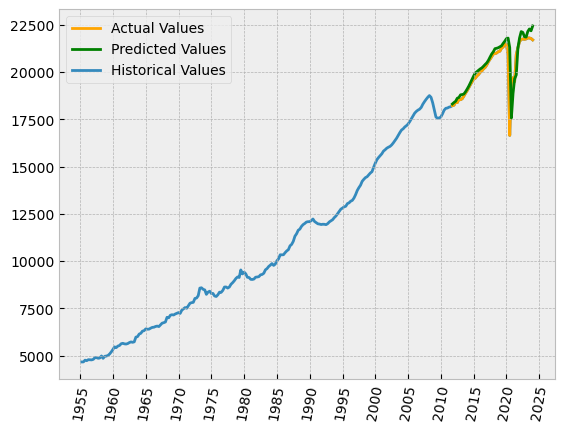

R²= 0.614
MAPE=1.879%
MAE=362.230


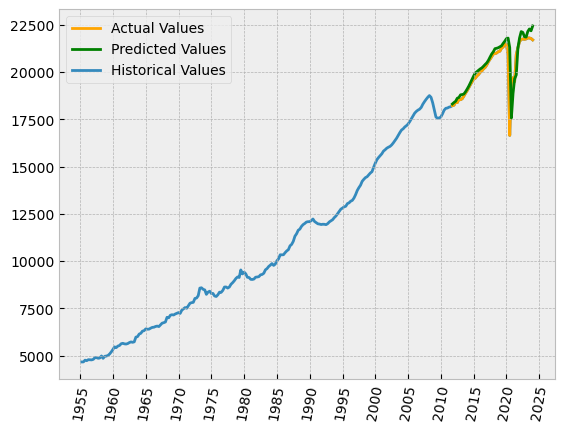

R²= 0.411
MAPE=2.178%
MAE=1495.981


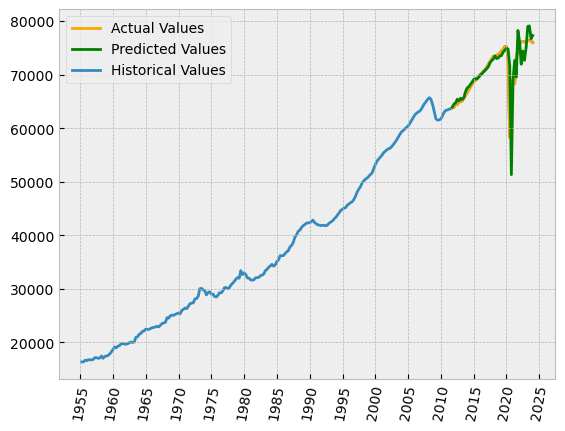

R²= 0.411
MAPE=2.178%
MAE=1495.981


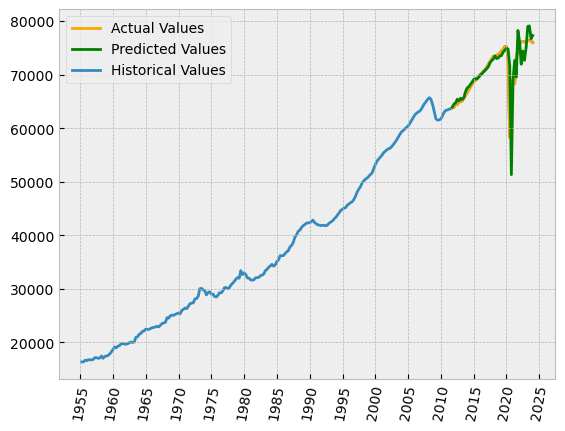

R²= 0.411
MAPE=2.178%
MAE=1495.981


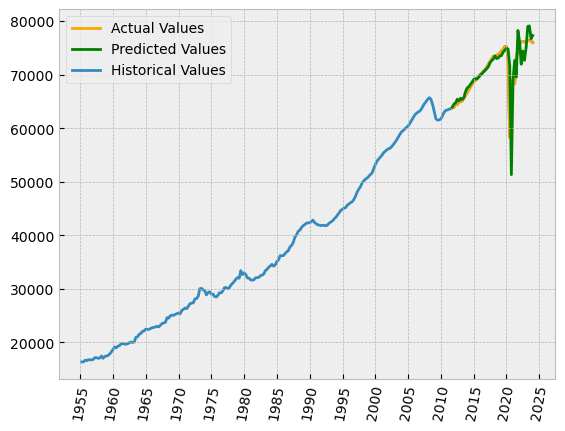

R²= 0.411
MAPE=2.178%
MAE=1495.981


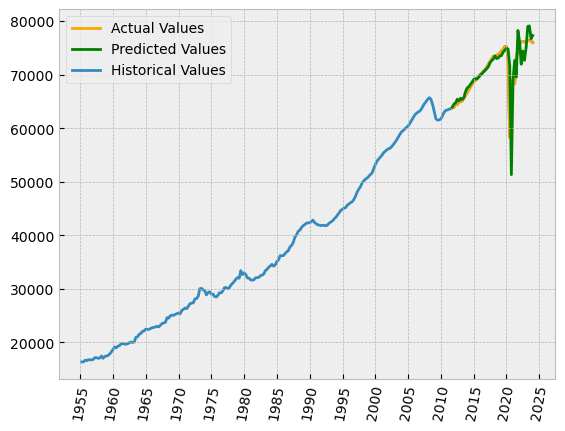

R²= 0.411
MAPE=2.178%
MAE=1495.981


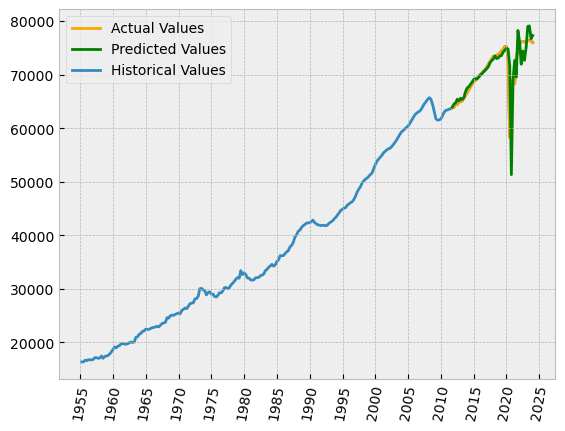

R²= 0.411
MAPE=2.178%
MAE=1495.981


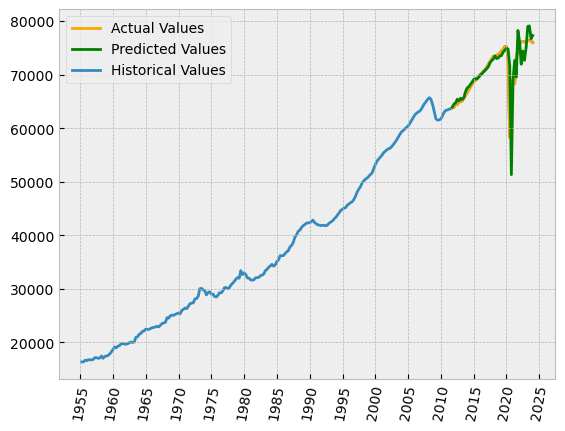

R²= 0.411
MAPE=2.178%
MAE=1495.981


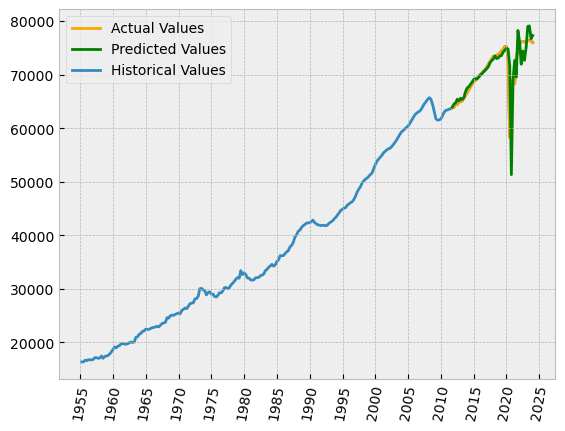

R²= 0.411
MAPE=2.178%
MAE=1495.981


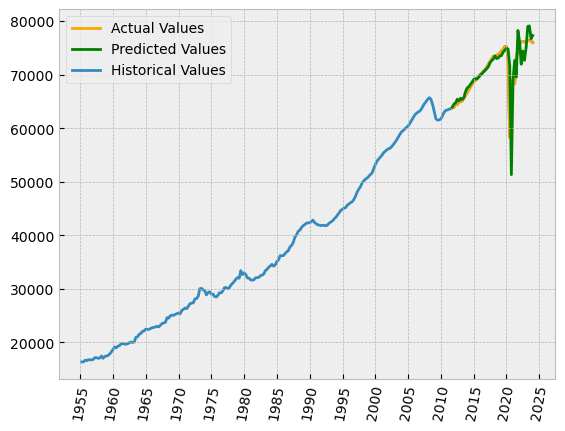

R²= 0.411
MAPE=2.178%
MAE=1495.981


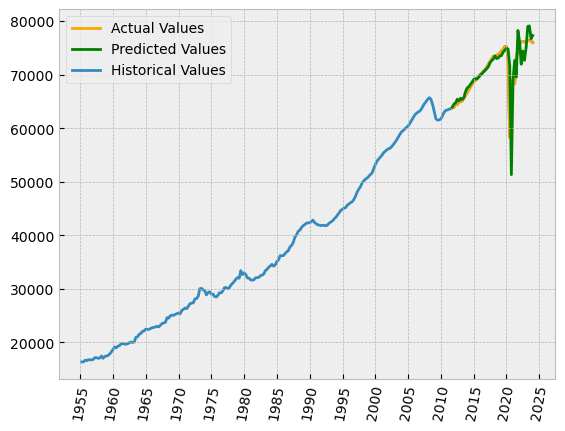

R²= 0.411
MAPE=2.178%
MAE=1495.981


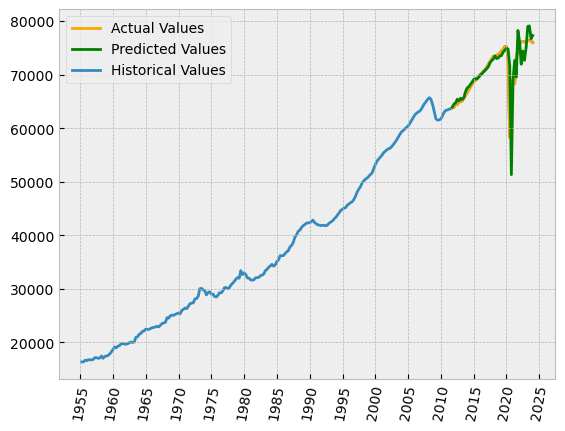

R²= 0.532
MAPE=1.744%
MAE=717.987


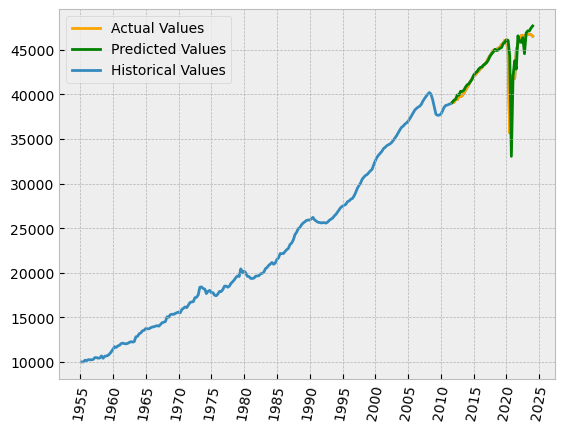

R²= 0.532
MAPE=1.744%
MAE=717.987


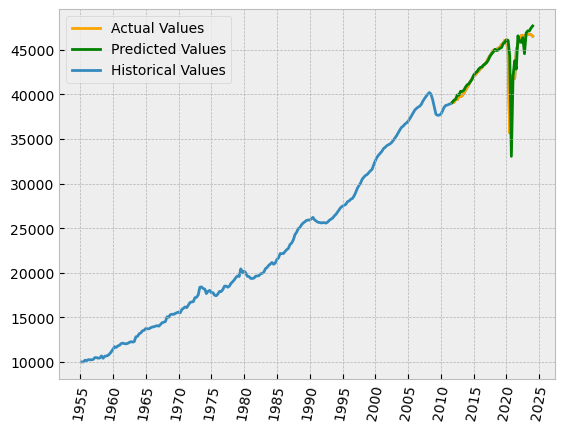

R²= 0.532
MAPE=1.744%
MAE=717.987


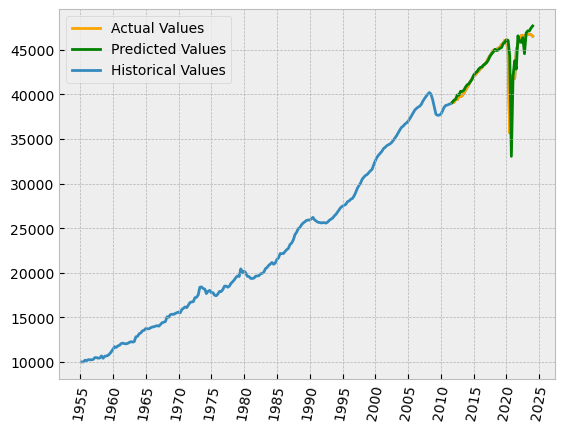

R²= 0.532
MAPE=1.744%
MAE=717.987


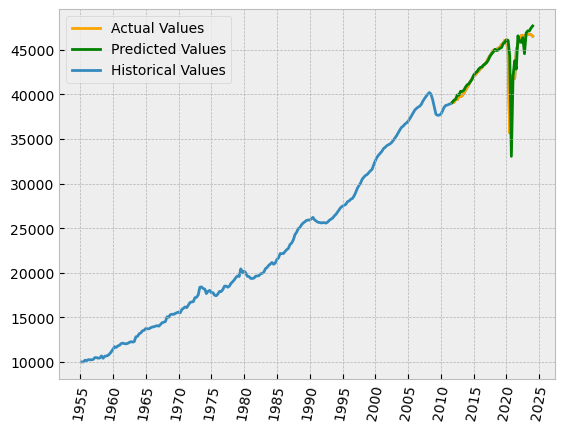

R²= 0.532
MAPE=1.744%
MAE=717.987


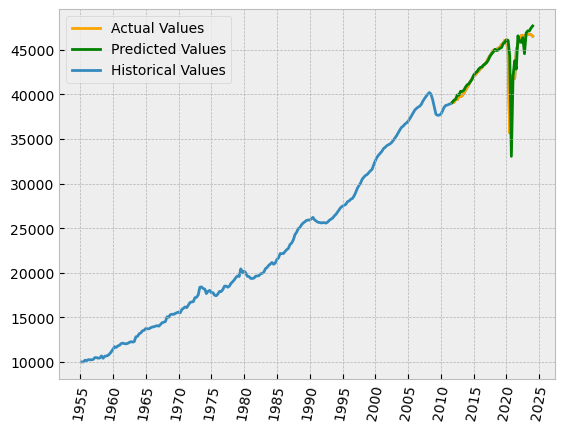

R²= 0.532
MAPE=1.744%
MAE=717.987


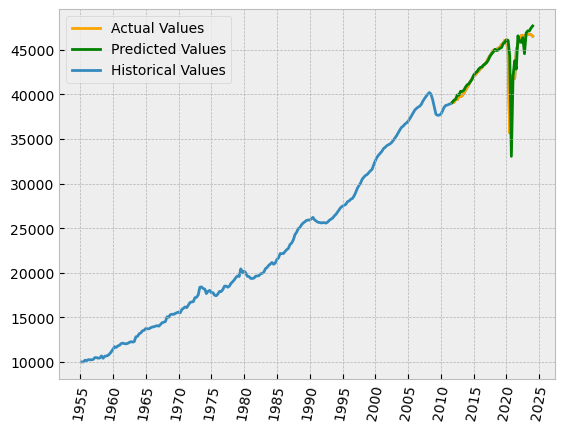

R²= 0.532
MAPE=1.744%
MAE=717.987


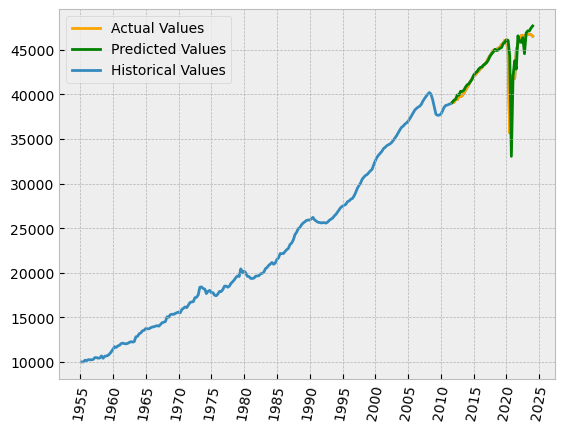

R²= 0.532
MAPE=1.744%
MAE=717.987


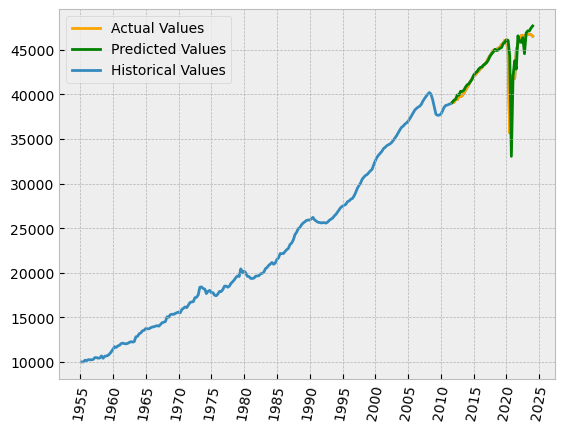

R²= 0.532
MAPE=1.744%
MAE=717.987


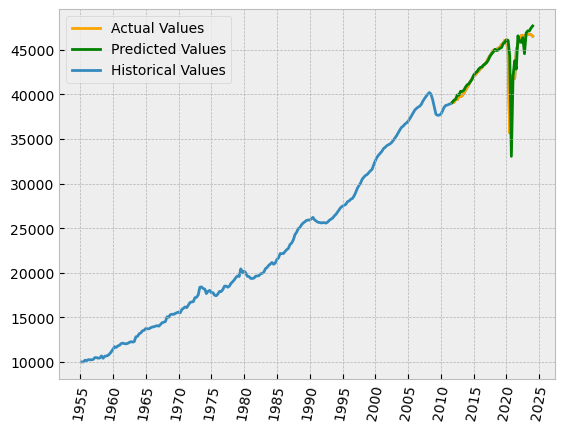

R²= 0.532
MAPE=1.744%
MAE=717.987


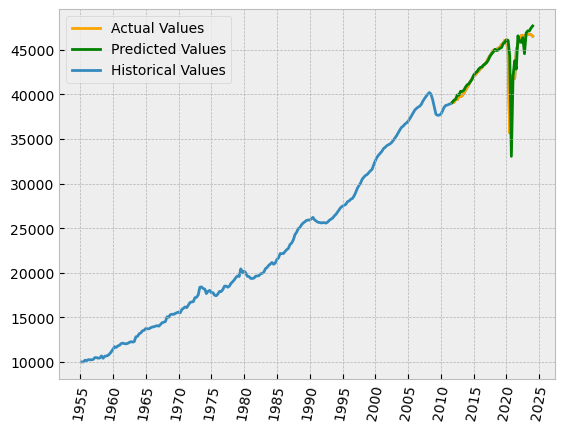

R²= 0.659
MAPE=1.374%
MAE=142.477


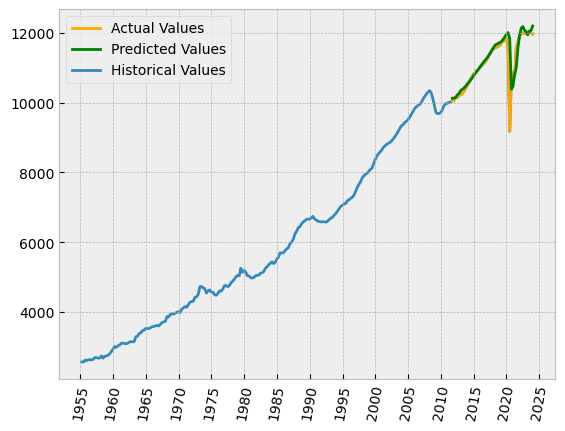

R²= 0.659
MAPE=1.374%
MAE=142.477


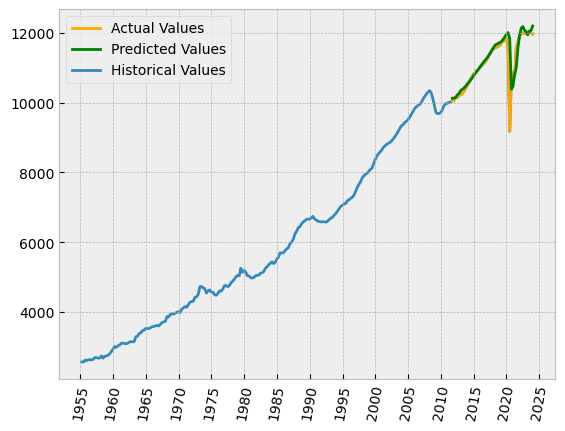

R²= 0.659
MAPE=1.374%
MAE=142.477


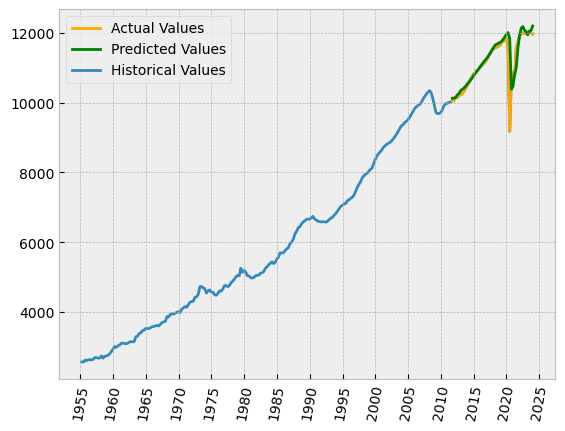

R²= 0.659
MAPE=1.374%
MAE=142.477


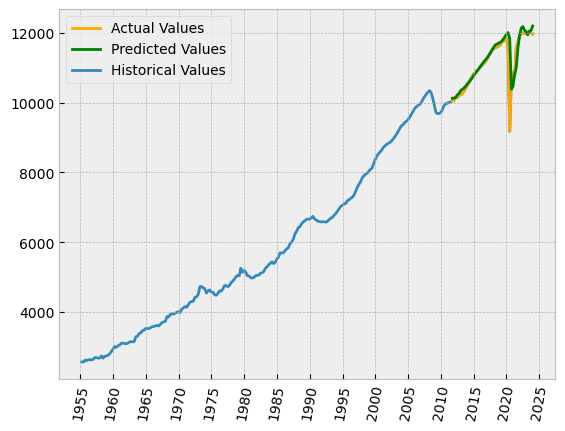

R²= 0.659
MAPE=1.374%
MAE=142.477


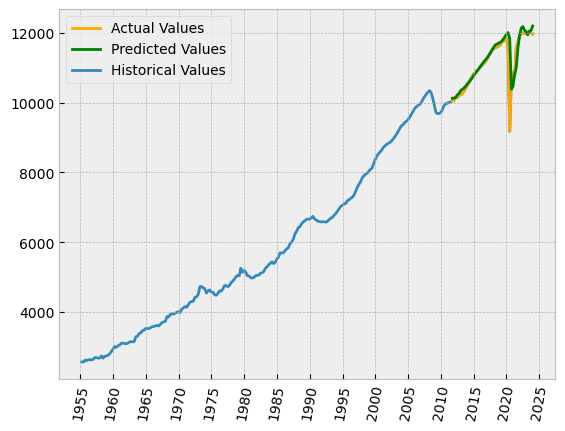

R²= 0.659
MAPE=1.374%
MAE=142.477


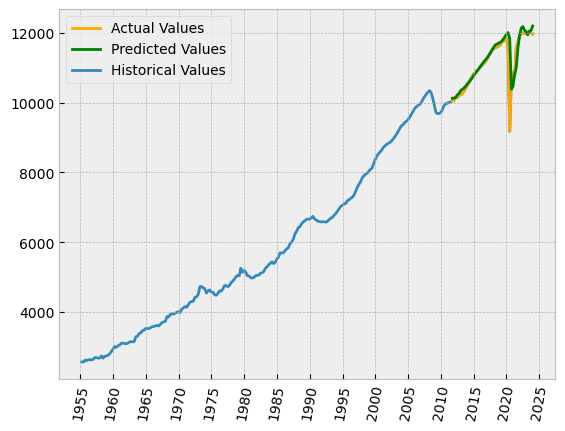

R²= 0.659
MAPE=1.374%
MAE=142.477


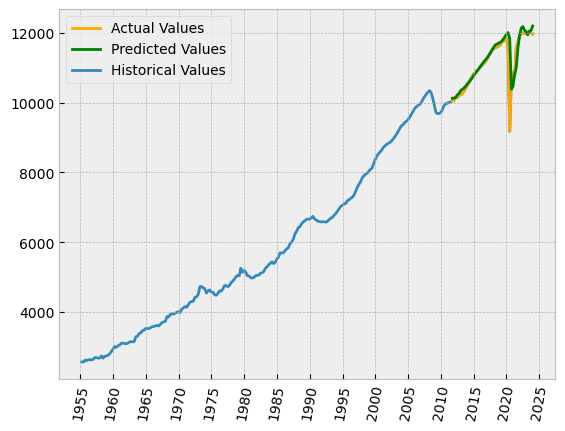

R²= 0.659
MAPE=1.374%
MAE=142.477


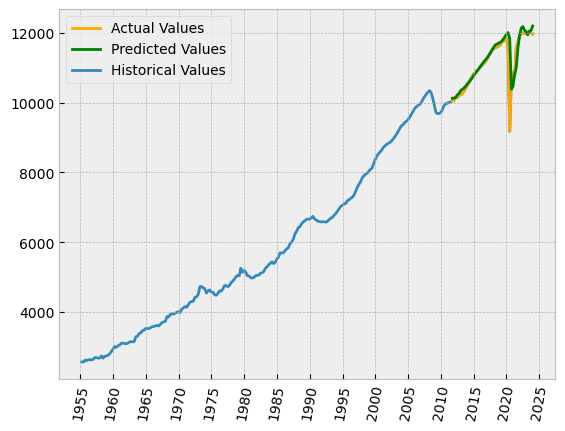

R²= 0.659
MAPE=1.374%
MAE=142.477


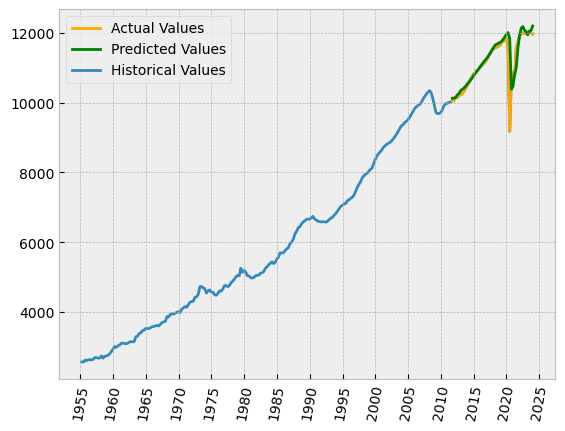

R²= 0.659
MAPE=1.374%
MAE=142.477


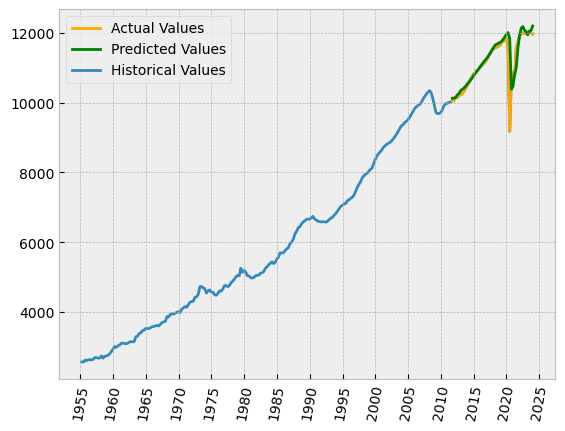

R²= 0.609
MAPE=1.638%
MAE=1201.270


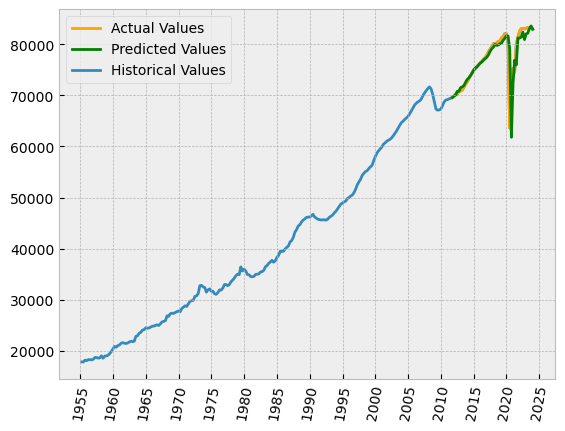

R²= 0.609
MAPE=1.638%
MAE=1201.270


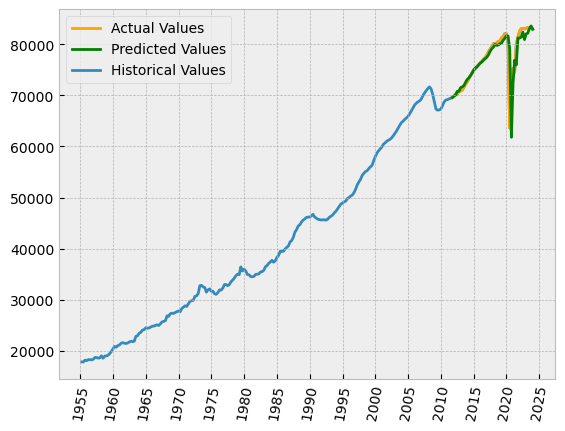

R²= 0.609
MAPE=1.638%
MAE=1201.270


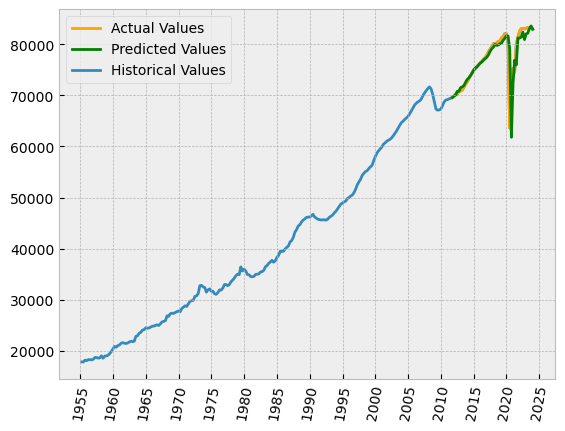

R²= 0.609
MAPE=1.638%
MAE=1201.270


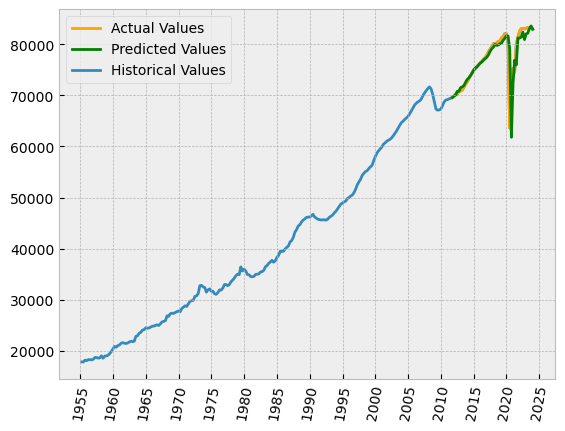

R²= 0.609
MAPE=1.638%
MAE=1201.270


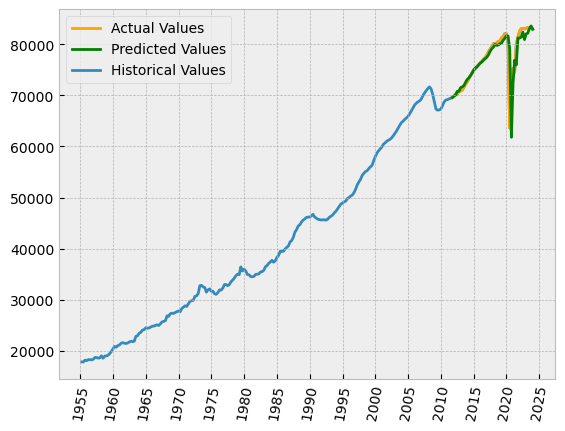

R²= 0.609
MAPE=1.638%
MAE=1201.270


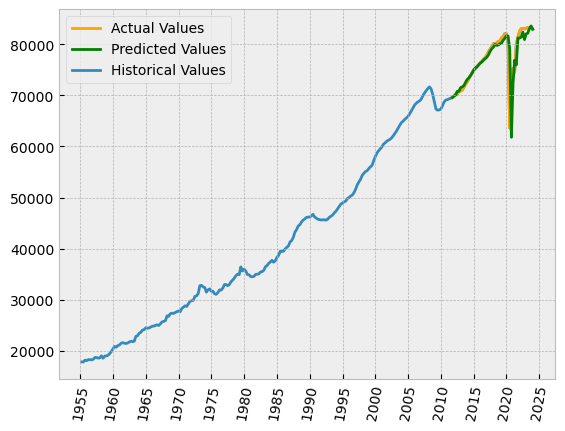

R²= 0.609
MAPE=1.638%
MAE=1201.270


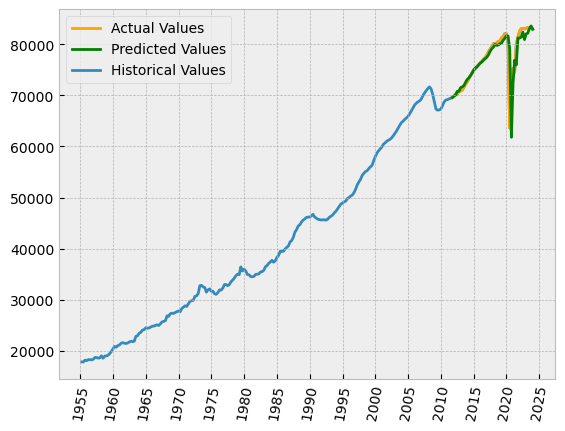

R²= 0.609
MAPE=1.638%
MAE=1201.270


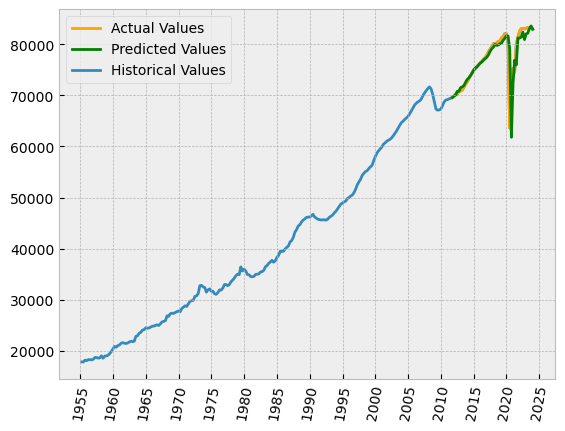

R²= 0.609
MAPE=1.638%
MAE=1201.270


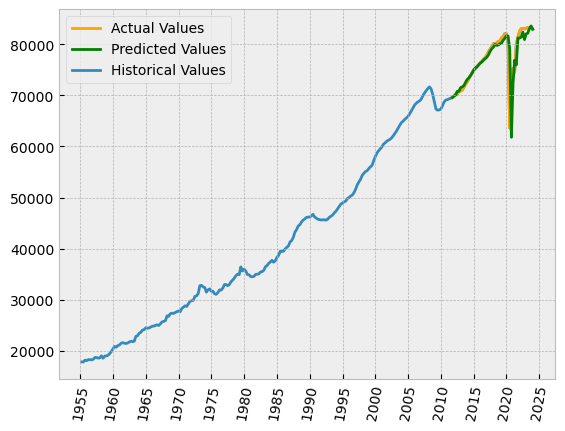

R²= 0.609
MAPE=1.638%
MAE=1201.270


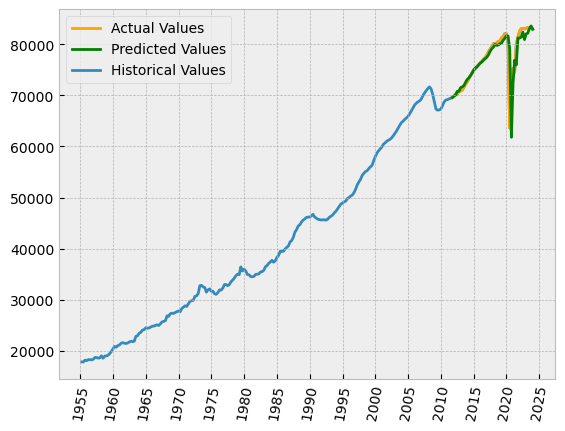

R²= 0.637
MAPE=1.484%
MAE=595.004


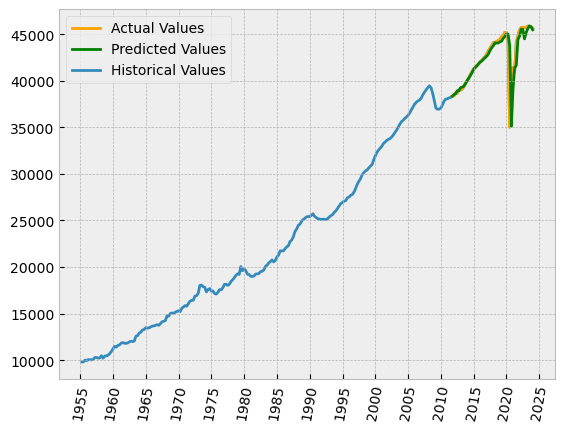

R²= 0.637
MAPE=1.484%
MAE=595.004


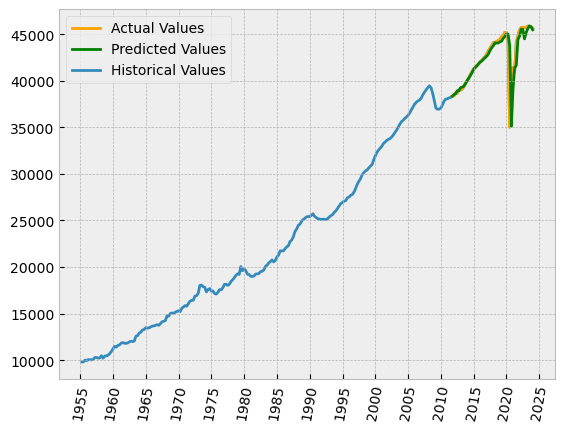

R²= 0.637
MAPE=1.484%
MAE=595.004


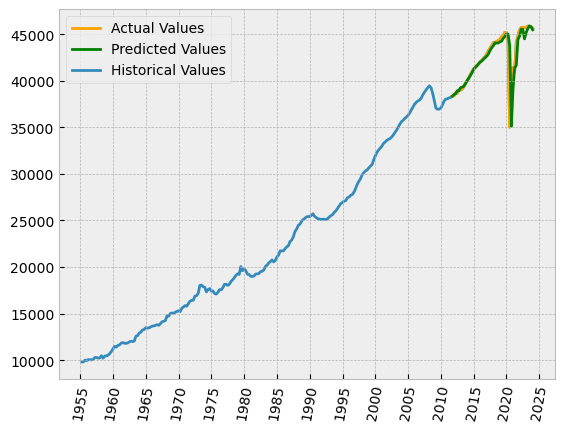

R²= 0.637
MAPE=1.484%
MAE=595.004


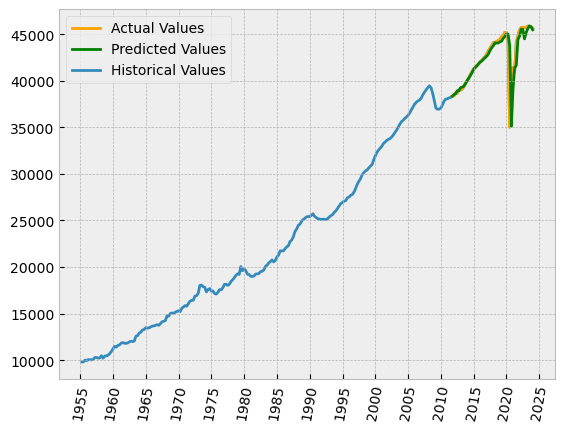

R²= 0.637
MAPE=1.484%
MAE=595.004


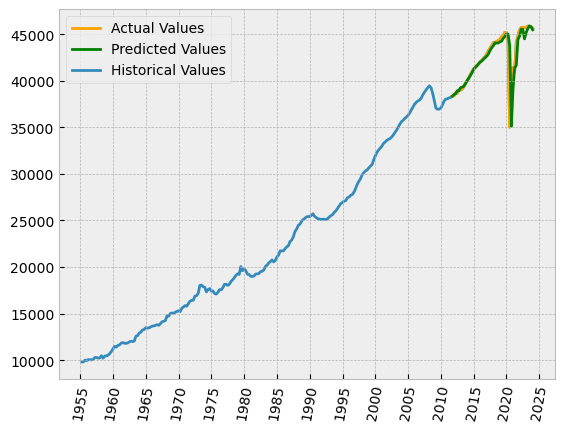

R²= 0.637
MAPE=1.484%
MAE=595.004


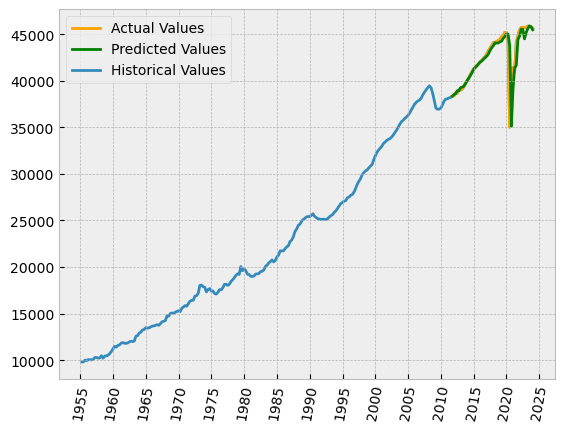

R²= 0.637
MAPE=1.484%
MAE=595.004


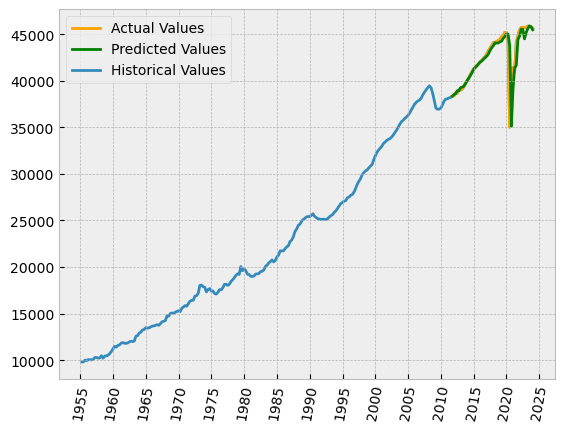

R²= 0.637
MAPE=1.484%
MAE=595.004


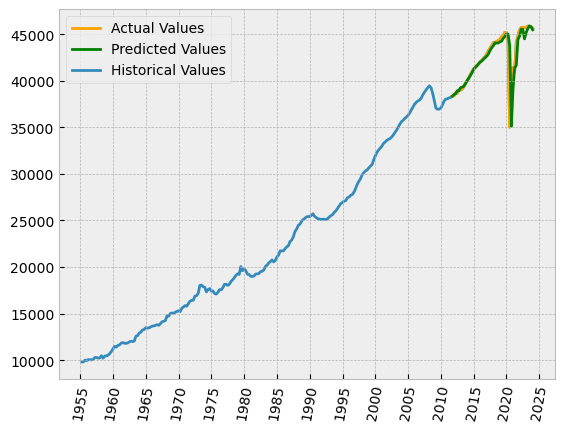

R²= 0.637
MAPE=1.484%
MAE=595.004


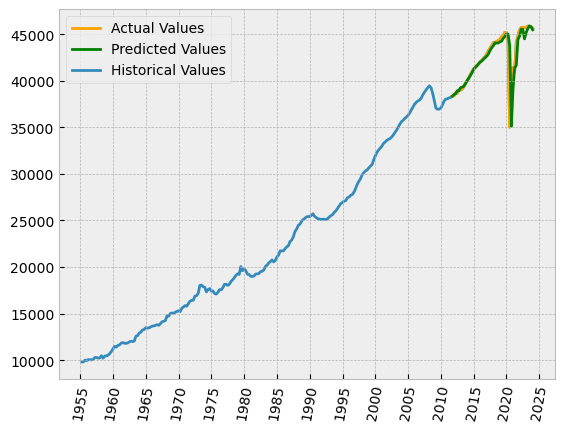

R²= 0.637
MAPE=1.484%
MAE=595.004


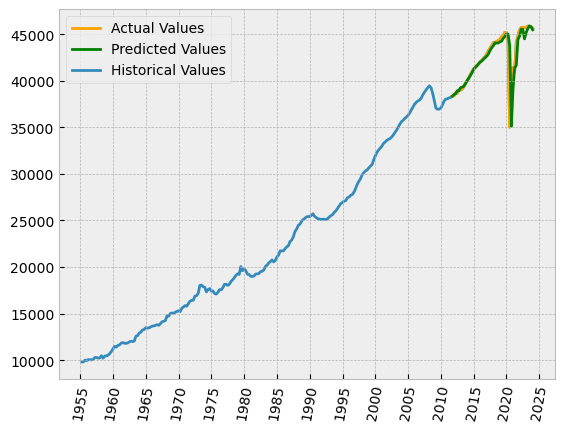

R²= 0.647
MAPE=2.172%
MAE=71.197


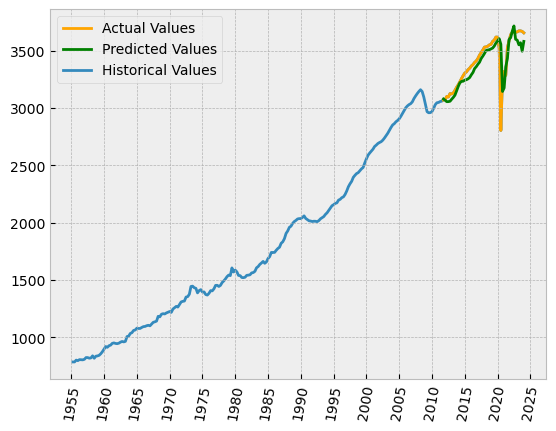

R²= 0.647
MAPE=2.172%
MAE=71.197


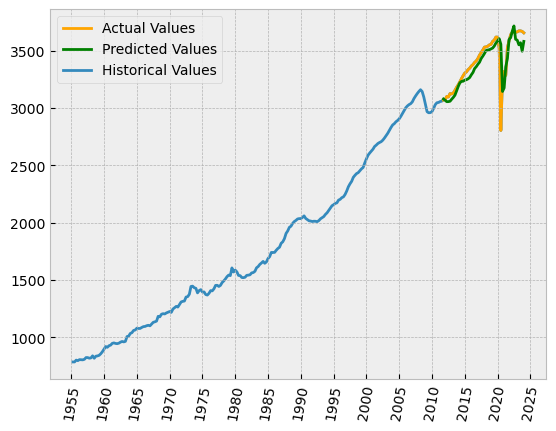

R²= 0.647
MAPE=2.172%
MAE=71.197


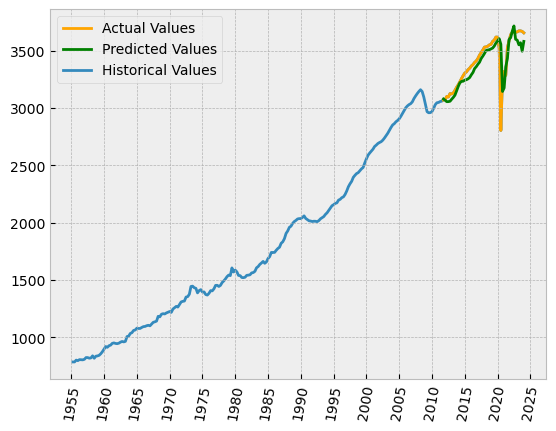

R²= 0.647
MAPE=2.172%
MAE=71.197


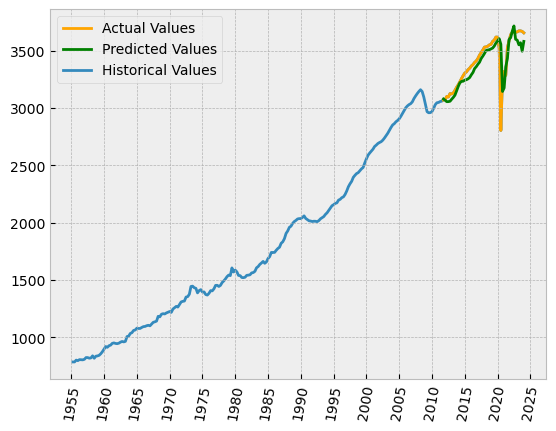

R²= 0.647
MAPE=2.172%
MAE=71.197


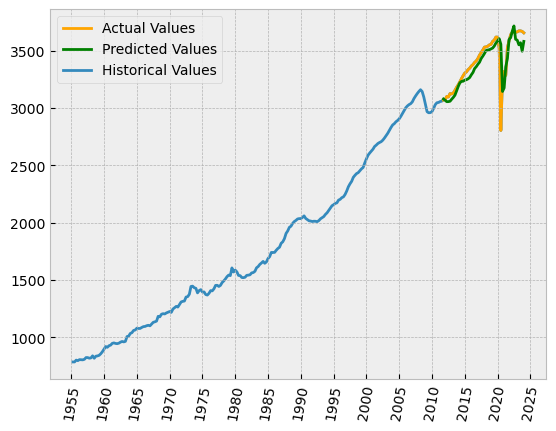

R²= 0.647
MAPE=2.172%
MAE=71.197


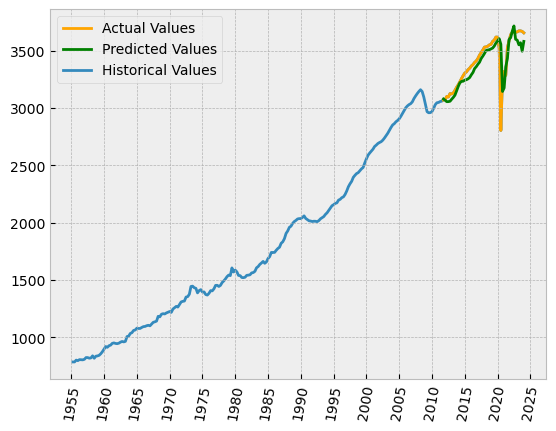

R²= 0.647
MAPE=2.172%
MAE=71.197


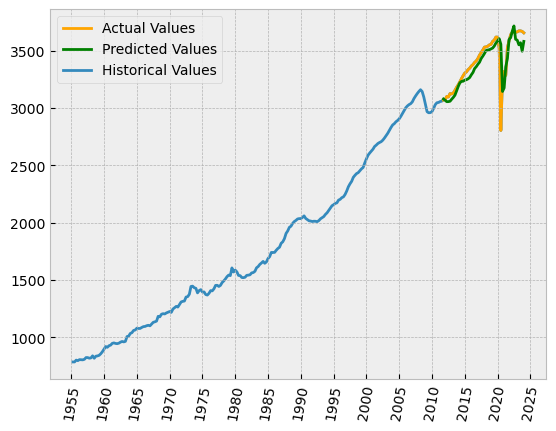

R²= 0.647
MAPE=2.172%
MAE=71.197


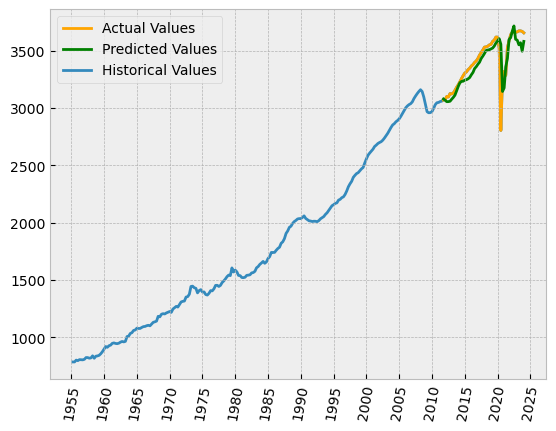

R²= 0.647
MAPE=2.172%
MAE=71.197


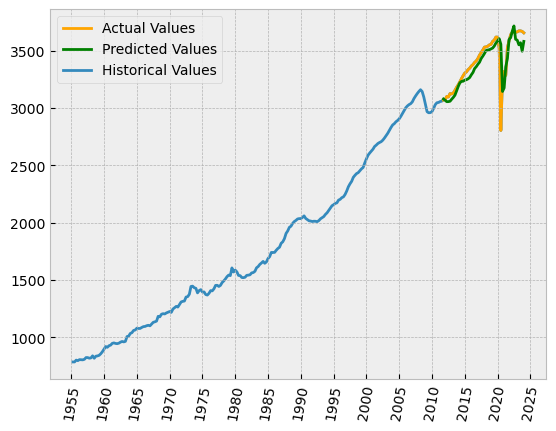

R²= 0.647
MAPE=2.172%
MAE=71.197


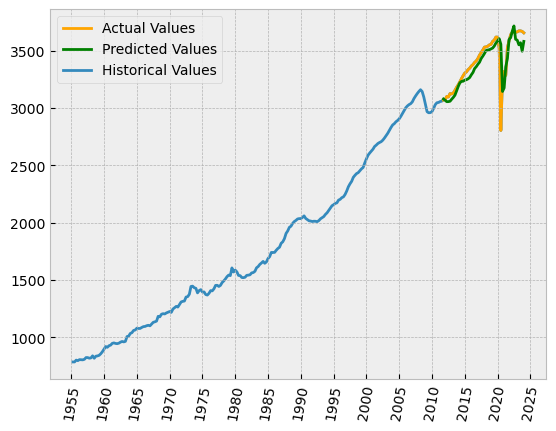

R²= 0.653
MAPE=1.404%
MAE=131.342


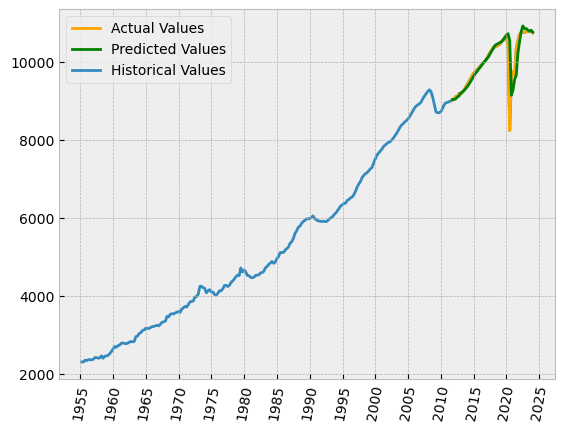

R²= 0.653
MAPE=1.404%
MAE=131.342


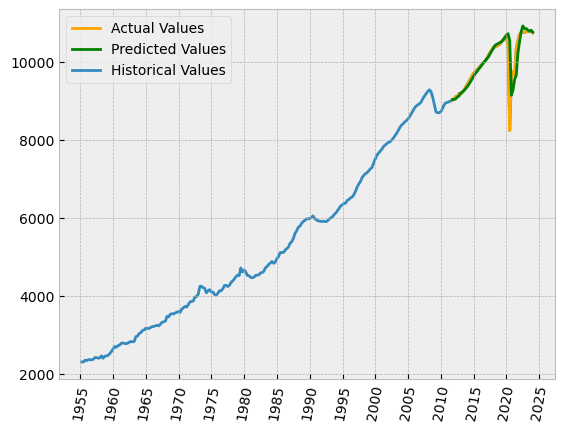

R²= 0.653
MAPE=1.404%
MAE=131.342


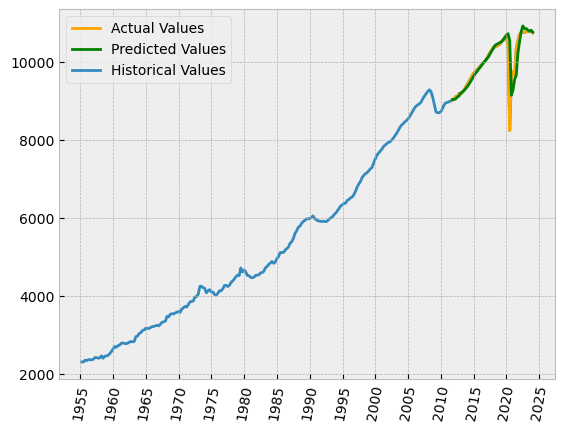

R²= 0.653
MAPE=1.404%
MAE=131.342


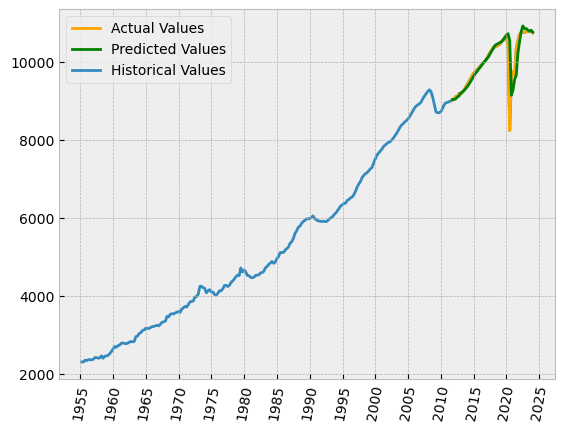

R²= 0.653
MAPE=1.404%
MAE=131.342


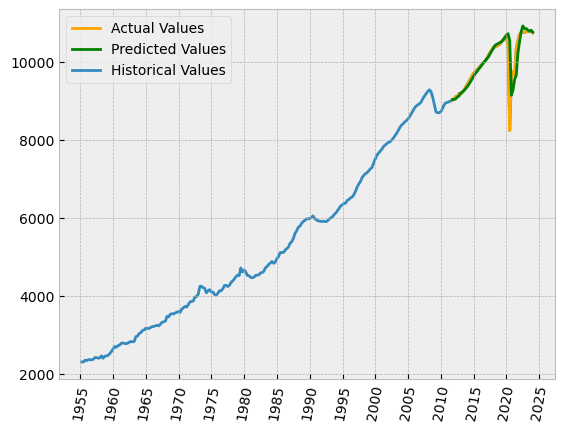

R²= 0.653
MAPE=1.404%
MAE=131.342


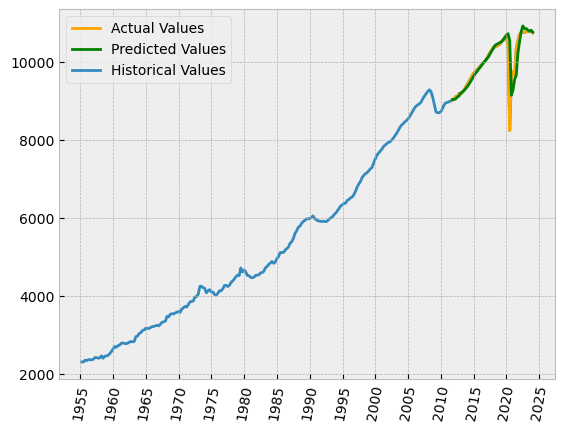

R²= 0.653
MAPE=1.404%
MAE=131.342


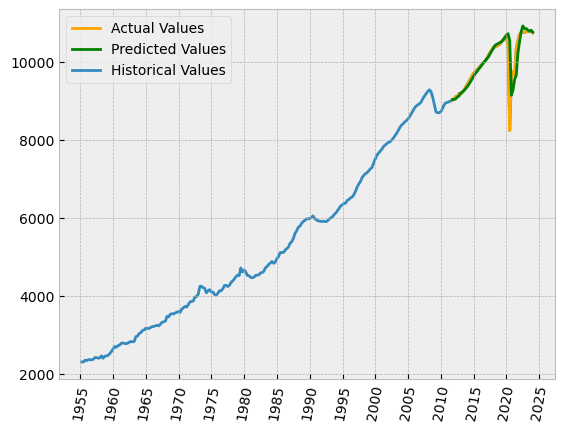

R²= 0.653
MAPE=1.404%
MAE=131.342


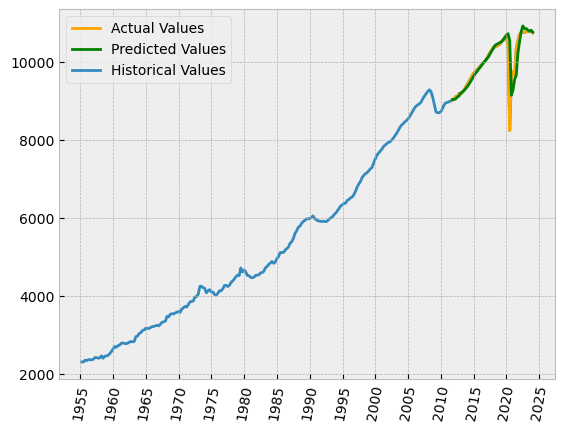

R²= 0.653
MAPE=1.404%
MAE=131.342


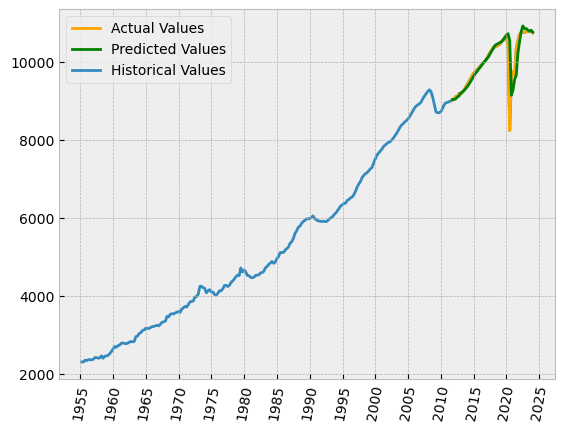

R²= 0.653
MAPE=1.404%
MAE=131.342


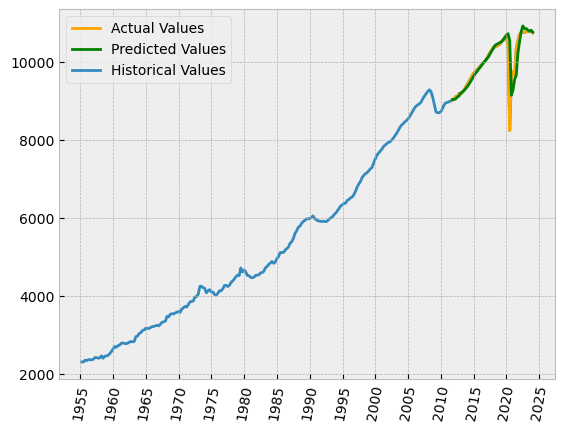

R²= 0.659
MAPE=1.420%
MAE=165.273


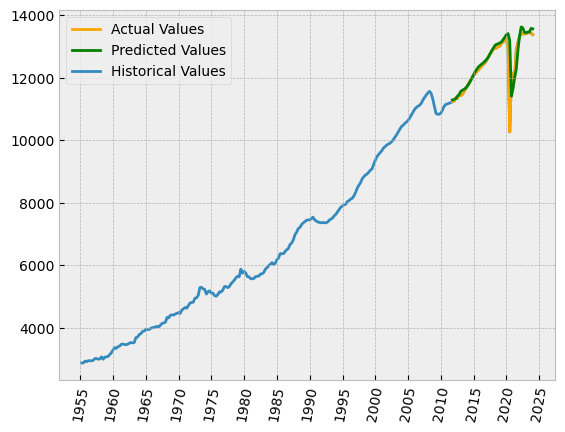

R²= 0.659
MAPE=1.420%
MAE=165.273


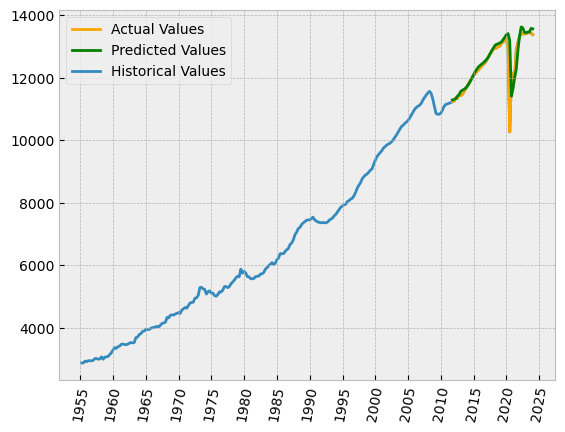

R²= 0.659
MAPE=1.420%
MAE=165.273


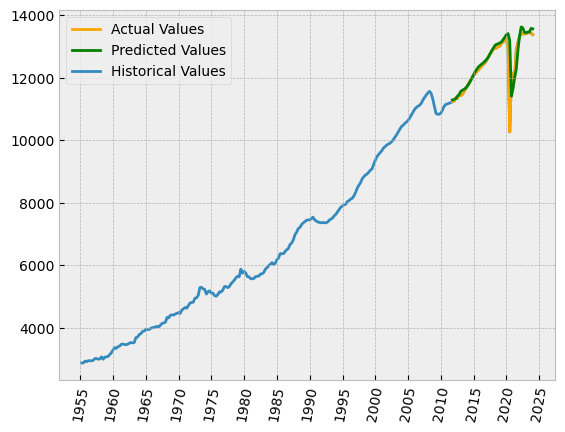

R²= 0.659
MAPE=1.420%
MAE=165.273


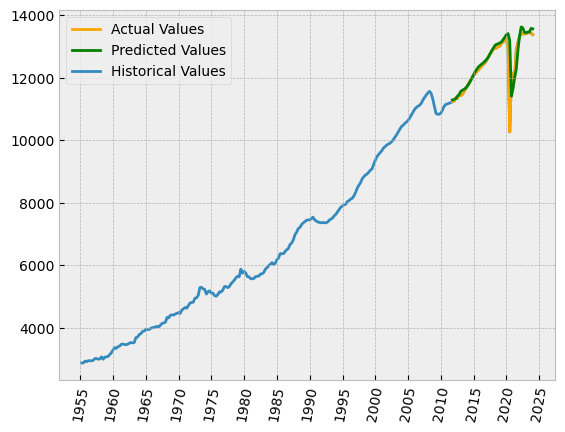

R²= 0.659
MAPE=1.420%
MAE=165.273


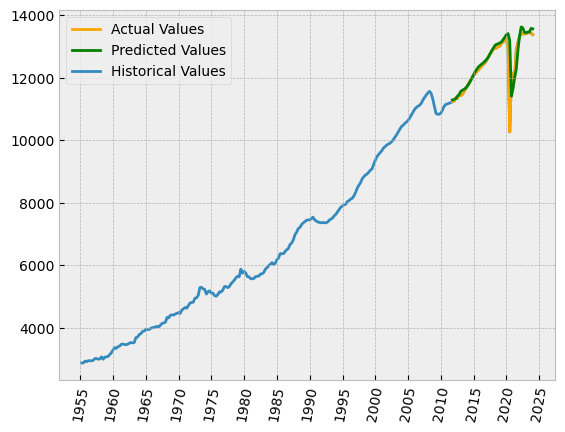

R²= 0.659
MAPE=1.420%
MAE=165.273


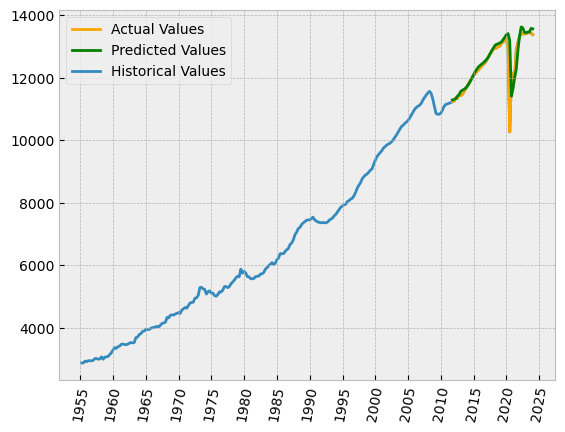

R²= 0.659
MAPE=1.420%
MAE=165.273


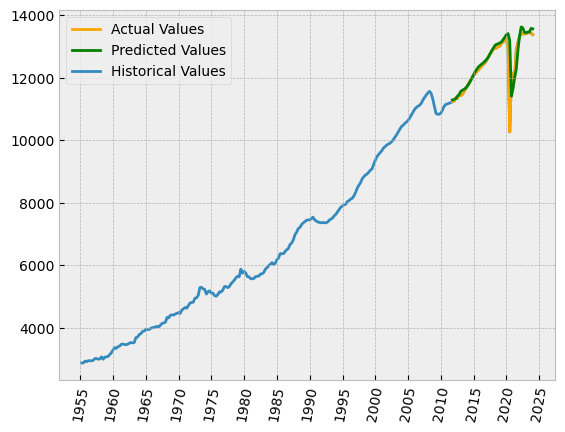

R²= 0.659
MAPE=1.420%
MAE=165.273


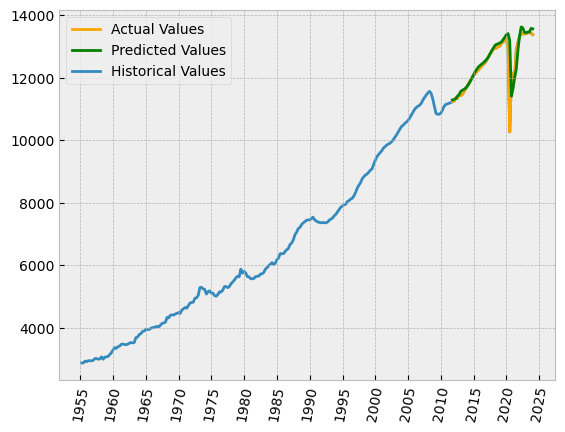

R²= 0.659
MAPE=1.420%
MAE=165.273


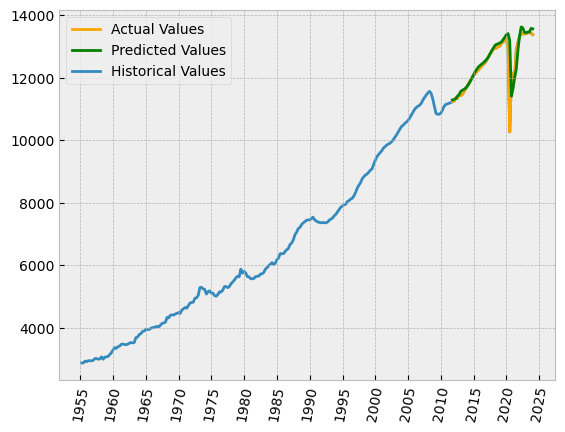

R²= 0.659
MAPE=1.420%
MAE=165.273


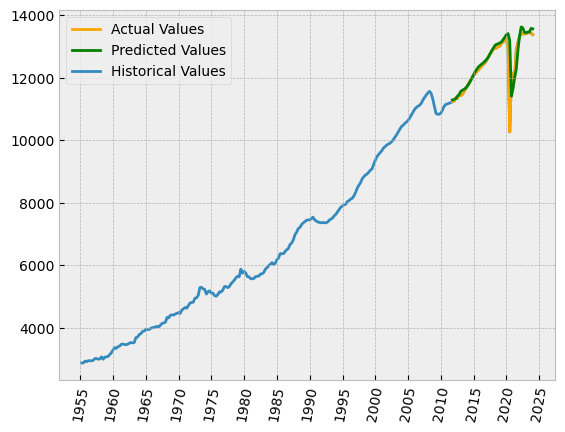

In [300]:
findFolder = ["A","B","C","D","E","F","G","H","I","J","K","L","M","N","O","P","Q","R","S"]

parameters = {
    "kernel": ["rbf"],
    "C": [0.1,1,10,100,1000],
    "gamma": [1e-8, 1e-7, 1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1],
    "epsilon": [0.1,0.01,0.001,0.0001,0.00001]
    }

for fideration in range(0,13):
    for iteration in range(0,10):
        svre = GridSearchCV(svm.SVR(), parameters, cv=5, verbose=0)
        svre.fit(splitData[fideration]["x_train"].reshape(197,29),splitData[fideration]["y_train"].reshape(197))

        y_pred = svre.predict(splitData[fideration]["x_test"].reshape(50,29))
        old_pred = svre.predict(splitData[fideration]["x_train"].reshape(197,29))

        y_test_orig = scaler.inverse_transform(splitData[fideration]["y_test"].reshape(-1,1))
        y_pred_orig = scaler.inverse_transform(y_pred.reshape(-1,1))
        old_pred_orig = scaler.inverse_transform(old_pred.reshape(-1,1))

        plt.style.use('bmh')

        # make a prediction
        mse = mean_squared_error(y_test_orig,y_pred_orig)
        mae = mean_absolute_error(y_test_orig,y_pred_orig)
        mape = mean_absolute_percentage_error(y_test_orig,y_pred_orig)*100
        r2 = r2_score(y_test_orig,y_pred_orig)
        print("R²= {:.3f}\nMAPE={:.3f}%\nMAE={:.3f}".format(r2,mape,mae))

        fig,ax = plt.subplots()

        historical = df.iloc[fideration,:]

        ax.plot(historical.tail(50).index, y_test_orig, color='orange', label='Actual Values',zorder=0)
        ax.plot(historical.tail(50).index, y_pred_orig, color='green', label='Predicted Values',zorder=1)
        #ax.plot(historical.iloc[-20:-4].index, old_pred_orig, color='red', label='Testing Values',zorder=1)

        ax.xaxis.set_major_locator(mdates.YearLocator(5))
        ax.tick_params(axis='x', rotation=80)

        ax.plot(historical.index,historical.values,zorder=-1,label="Historical Values")
        ax.legend()
        plt.show()

        dump(svre,f'savedModels/zTurnoverSvm/{findFolder[fideration]}/Trial{iteration}/model.joblib')